In [1]:
# !pip install unidecode ydata-profiling 

In [2]:
from unidecode import unidecode
import joblib
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime
import os
import re
import os
# from ydata_profiling import ProfileReport
# from mlxtend.preprocessing import TransactionEncoder
import re
import seaborn as sns

In [3]:
# df = pd.read_csv("/kaggle/input/violencia-intrafamiliar-en-guatemala-ine-2008-2023/violenciaIntrafamiliarGuatemala2008_2023_v3.csv")
df = pd.read_csv('./dataset/violenciaIntrafamiliarGuatemala2008_2023_v3.csv')

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\2252845826.py:2: DtypeWarning: Columns (52) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('./dataset/violenciaIntrafamiliarGuatemala2008_2023_v3.csv')


## Generar las entidades
- Víctima
- Agresor
- Hecho
- Institución

In [4]:
vic_columns = ["VIC_SEXO", "VIC_EDAD", "TOTAL_HIJOS", "NUM_HIJ_HOM", "NUM_HIJ_MUJ", "VIC_ALFAB", "VIC_ESCOLARIDAD", "VIC_EST_CIV", "VIC_GRUPET", "VIC_NACIONAL", "VIC_TRABAJA","VIC_OFICIO", "VIC_SALARIO", "VIC_DISC", "TIPO_DISCAQ", "VIC_REL_AGR"]
agr_columns = ["AGR_SEXO", "AGR_EDAD", "AGR_ALFAB", "AGR_ESCOLARIDAD", "AGR_EST_CIV", "AGR_GRUPET", "AGR_NACIONAL", "AGR_TRABAJA", "AGR_OFICIO", "AGR_SALARIO", "VIC_REL_AGR"]
hecho_columns = ["HEC_DIA", "HEC_MES", "HEC_ANO", "HEC_DEPTO", "HEC_DEPTOMCPIO", "HEC_TIPAGRE", "HEC_RECUR_DENUN", "INST_DONDE_DENUNCIO", "HEC_AREA", "OTRAS_VICTIMAS", "VIC_OTRAS_HOM", "VIC_OTRAS_MUJ", "VIC_OTRAS_N_OS", "VIC_OTRAS_N_AS", "AGRESORES_OTROS_TOTAL", "AGR_OTROS_HOM", "AGR_OTRAS_MUJ", "AGR_OTROS_N_OS", "AGR_OTRAS_N_AS", "LEY_APLICABLE", "ARTICULOVIF", "ARTICULOVCM", "ARTICULOCODPEN", "ARTICULOTRAS","MEDIDAS_SEGURIDAD", "TIPO_MEDIDA", "ORGANISMO_REMITE", 'ESTACIONES_DE_BOMBEROS_POR_DEPARTAMENTO','CANTIDAD_PNC_POR_DEPARTAMENTO','CANTIDAD_ORGANISMO_JUDICIAL_POR_DEPARTAMENTO','CANTIDAD_IDDP_POR_DEPARTAMENTO', 'CANTIDAD_SALAS_MIXTAS','CANTIDAD_TRIBUNALES_DE_SENTENCIA','CANTIDAD_JUZGADOS_PRIMERA_INSTANCIA_PENAL','CANTIDAD_JUZGADOS_PRIMERA_INSTANCIA_PENAL_NARCOACTIVIDAD_DELITOS_AMBIENTE', 'CANTIDAD_JUZGADOS_ADOLESCENTES_Y_NINEZ', 'CANTIDAD_JUZGADOS_EJECUCION','CANTIDAD_JUZGADOS_PAZ_PENAL_COMUNITARIOS','CANTIDAD_JUZGADOS_VIOLENCIA_CONTRA_MUJ_FEMINICIDIO','CANTIDAD_TRIBUNALES_SENTENCIA_VIOLENCIA_CONTRA_MUJ_FEMINICIDIO','CANTIDAD_JUZGADOS_TRIBUNALES_MAYOR_RIESGO','CANTIDAD_FISCALIAS_REGIONALES', 'CANTIDAD_FISCALIAS_DISTRITALES','CANTIDAD_FISCALIAS_MUNICIPALES', 'CANTIDAD_AGENCIAS_FISCALES','CANTIDAD_COORDINADORA_DEPARTAMENTAL','CANTIDAD_COORDINADORA_MUNICIPAL', 'CANTIDAD_SECCIONES_ESPECIALES','CANTIDAD_COMISARIAS', 'CANTIDAD_ESTACIONES', 'CANTIDAD_SUBESTACIONES','CANTIDAD_DIVISION_INVESTIGACION_CRIMINAL', 'CANTIDAD_CEMENTERIO','CANTIDAD_CENTRO_COMUNITARIO', 'CANTIDAD_CENTRO_ATENCION_PERMANENTE','CANTIDAD_CENTRO_SALUD', 'CANTIDAD_DIRECCION', 'CANTIDAD_ESCUELA','CANTIDAD_HOSPITAL', 'CANTIDAD_OTRO', 'CANTIDAD_PUESTO_SALUD',]
institucion_columns = ["INST_DENUN_HECHO", "ORGANISMO_JURISDICCIONAL", "CONDUCENTE"]

In [5]:
victimas = df[vic_columns]
agresores = df[agr_columns]
hechos = df[hecho_columns]
institucion = df[institucion_columns]

## Generar un reporte de los datos

In [6]:
# profile = ProfileReport(df, title="Profiling Report")
# profile.to_file("violenciaIntrafamiliarGuatemala2008_2023.html")

In [7]:
# del profile

In [8]:
# profile.to_notebook_iframe()

## Grupos Mayoritarios

### Ancianos

In [9]:
print(df[(df["VIC_EDAD"]>64)].shape[0])

26309


### Niños

In [10]:
print(df[(df["VIC_EDAD"]<=18)].shape[0])

36800


### Mujeres

In [11]:
print(df[(df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<=64) & (df["VIC_SEXO"]=="mujeres")].shape[0])

472868


### Discapacitados

In [12]:
print(df[(df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<=64) & (df["VIC_SEXO"]!="mujeres") & (df["VIC_DISC"]=="con discapacidad")].shape[0])


791


### Hombres

In [13]:
print(df[(df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<=64) & (df["VIC_SEXO"]!="mujeres") & (df["VIC_DISC"]=="sin discapacidad")].shape[0])

50850


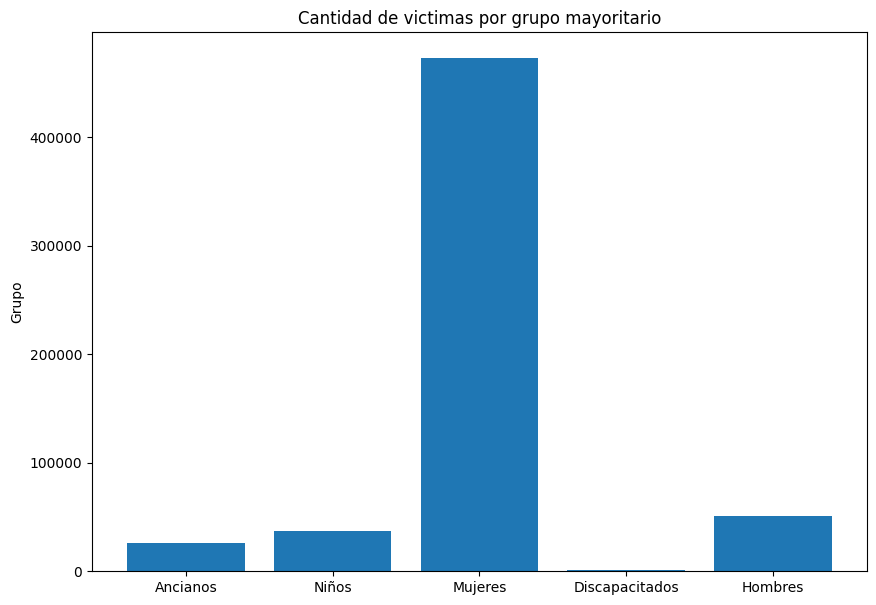

In [14]:
plt.figure(figsize=(10,7))
x = ['Ancianos', 'Niños', 'Mujeres', 'Discapacitados', 'Hombres']
y = [
    df[(df["VIC_EDAD"]>64)].shape[0], 
    df[(df["VIC_EDAD"]<=18)].shape[0], 
    df[(df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<=64) & (df["VIC_SEXO"]=="mujeres")].shape[0],
    df[(df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<=64) & (df["VIC_SEXO"]!="mujeres") & (df["VIC_DISC"]=="con discapacidad")].shape[0],
    df[(df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<=64) & (df["VIC_SEXO"]!="mujeres") & (df["VIC_DISC"]=="sin discapacidad")].shape[0]
]
plt.bar(x, y)
plt.title("Cantidad de victimas por grupo mayoritario")
plt.ylabel("Cantidad de victimas")
plt.ylabel("Grupo")
plt.show()

In [15]:
df = df[(df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<=64) & (df["VIC_SEXO"]=="mujeres")]

Basado en esto, se define que la investigación será enfocada en mujeres

## Conteos de columnas
Esto sirve para explorar brevemente los datos

### Sexo de las víctimas y agresores

AGR_SEXO
hombres    445737
mujeres     27131
Name: count, dtype: int64
AGR_SEXO
hombres    94.262458
mujeres     5.737542
Name: count, dtype: float64
AGR_SEXO  hombres  mujeres
VIC_SEXO                  
mujeres    445737    27131
AGR_SEXO    hombres   mujeres
VIC_SEXO                     
mujeres   94.262458  5.737542


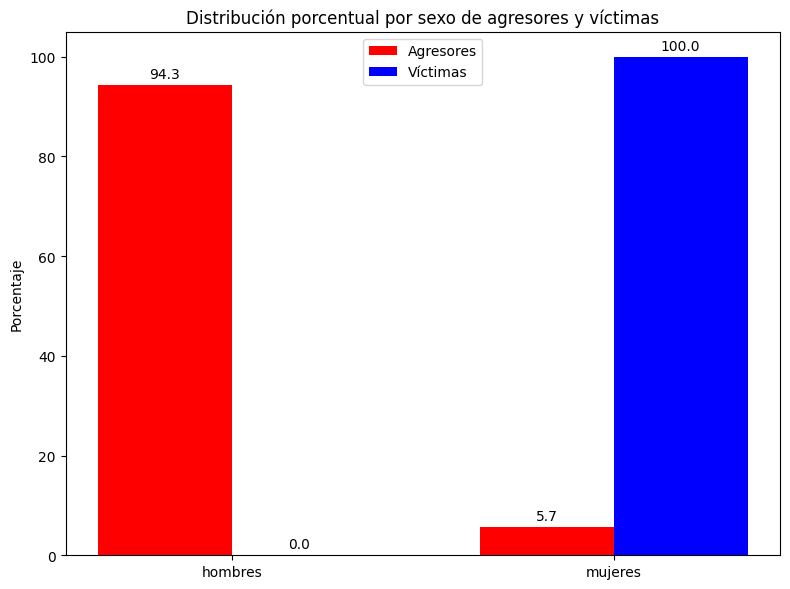

In [16]:
print(df["AGR_SEXO"].value_counts())
print(df["AGR_SEXO"].value_counts()/df.shape[0]*100)
# Suele haber una brecha significativa entre los casos en dónde el agresor es mujer contra los casos dónde el agresor es hombre.
print(pd.crosstab(df["VIC_SEXO"], df["AGR_SEXO"]))
print(pd.crosstab(df["VIC_SEXO"], df["AGR_SEXO"])*100/df.shape[0])
# Se puede observar que existe una brecha significativa y una tendencia ya que casi el 85% de los casos se dan cuando la víctima es mujer y el agresor es hombre.
# Así mismo, se observa que en relaciones homosexuales no suele haber violencia intrafamiliar, o al menos casi no se reporta.


# Cálculo de porcentajes por sexo
oficio_agresores = df["AGR_SEXO"].value_counts(normalize=True) * 100
oficio_victimas = df["VIC_SEXO"].value_counts(normalize=True) * 100

# Unificamos los índices (sexos)
ocupaciones = sorted(set(oficio_agresores.index).union(set(oficio_victimas.index)))

# Preparamos los valores, rellenando con 0 si falta alguna categoría
agresores_vals = [oficio_agresores.get(sexo, 0) for sexo in ocupaciones]
victimas_vals = [oficio_victimas.get(sexo, 0) for sexo in ocupaciones]

# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(8, 6))

# Barras
rects1 = ax.bar(x - width/2, agresores_vals, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, victimas_vals, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje')
ax.set_title('Distribución porcentual por sexo de agresores y víctimas')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=0)
ax.set_ylim(0, max(max(agresores_vals), max(victimas_vals)) + 5)
ax.legend()

plt.tight_layout()
plt.show()


# La mayoría de casos es entre agresores hombres y víctimas mujeres 83%

## Restringir los datos
Se restringen los datos ya que realmente los grupos que no son mujeres, y que no pertenecen a la edad de un adulto joven/medio realmente son grupos vulnerables que merecen ser estudiados en su propio trabajo de graduación, sin embargo, por la cantidad de casos que representan las víctimas mujeres con edades de 19-60 años se prefiere evaluar los patrones y perfiles dentro de este grupo vulnerable.
- Solo deben de ser casos de víctimas mujeres
- Deben ser mujeres adultas (mayores de 18 años y menores de 60 años)

In [17]:
df = df[(df["VIC_SEXO"]=="mujeres") & (df["VIC_EDAD"]>18) & (df["VIC_EDAD"]<60)]

## Seleccion de caracteristicas relevantes
Estas son las características relevantes para el análisis exploratorio, se excluyen encodings para esta primera parte

In [18]:
relevant_cols = ['AGR_ALFAB', 'AGR_EDAD', 'AGR_ESCOLARIDAD', 'AGR_EST_CIV',
       'AGR_GRUPET', 'AGR_NACIONAL', 'AGR_SEXO', 'AGR_TRABAJA',
       'ANO_EMISION', 'DEPTO_MCPIO', 'DIA_EMISION', 'HEC_ANO', 'HEC_AREA',
       'HEC_DEPTOMCPIO', 'HEC_DIA', 'HEC_MES', 'HEC_RECUR_DENUN',
       'HEC_TIPAGRE', 'INST_DENUN_HECHO', 'INST_DONDE_DENUNCIO', 'MES_EMISION',
       'NUM_HIJ_HOM', 'NUM_HIJ_MUJ', 'OTRAS_VICTIMAS', 'QUIEN_REPORTA',
       'TIPO_DISCAQ', 'TOTAL_HIJOS', 'VIC_ALFAB', 'VIC_DISC',
       'VIC_EDAD', 'VIC_ESCOLARIDAD', 'VIC_EST_CIV', 'VIC_GRUPET',
       'VIC_NACIONAL', 'VIC_OTRAS_HOM', 'VIC_OTRAS_MUJ',
       'VIC_OTRAS_N_AS', 'VIC_OTRAS_N_OS', 'VIC_REL_AGR', 'VIC_SEXO',
       'VIC_TRABAJA', 'DEPTO', 'HEC_DEPTO', 'AGR_OTRAS_N_AS', 'AGRESORES_OTROS_TOTAL',
       'CONDUCENTE', 'MEDIDAS_SEGURIDAD', 'AGR_OTROS_HOM', 'TIPO_MEDIDA',
       'AGR_OTRAS_MUJ', 'AGR_OTROS_N_OS',
       'ESTACIONES_DE_BOMBEROS_POR_DEPARTAMENTO',
       'CANTIDAD_PNC_POR_DEPARTAMENTO',
       'CANTIDAD_ORGANISMO_JUDICIAL_POR_DEPARTAMENTO',
       'CANTIDAD_IDDP_POR_DEPARTAMENTO', 'CANTIDAD_SALAS_MIXTAS',
       'CANTIDAD_TRIBUNALES_DE_SENTENCIA',
       'CANTIDAD_JUZGADOS_PRIMERA_INSTANCIA_PENAL',
       'CANTIDAD_JUZGADOS_PRIMERA_INSTANCIA_PENAL_NARCOACTIVIDAD_DELITOS_AMBIENTE',
       'CANTIDAD_JUZGADOS_ADOLESCENTES_Y_NINEZ', 'CANTIDAD_JUZGADOS_EJECUCION',
       'CANTIDAD_JUZGADOS_PAZ_PENAL_COMUNITARIOS',
       'CANTIDAD_JUZGADOS_VIOLENCIA_CONTRA_MUJ_FEMINICIDIO',
       'CANTIDAD_TRIBUNALES_SENTENCIA_VIOLENCIA_CONTRA_MUJ_FEMINICIDIO',
       'CANTIDAD_JUZGADOS_TRIBUNALES_MAYOR_RIESGO',
       'CANTIDAD_FISCALIAS_REGIONALES', 'CANTIDAD_FISCALIAS_DISTRITALES',
       'CANTIDAD_FISCALIAS_MUNICIPALES', 'CANTIDAD_AGENCIAS_FISCALES',
       'CANTIDAD_COORDINADORA_DEPARTAMENTAL',
       'CANTIDAD_COORDINADORA_MUNICIPAL', 'CANTIDAD_SECCIONES_ESPECIALES',
       'CANTIDAD_COMISARIAS', 'CANTIDAD_ESTACIONES', 'CANTIDAD_SUBESTACIONES',
       'CANTIDAD_DIVISION_INVESTIGACION_CRIMINAL', 'CANTIDAD_CEMENTERIO',
       'CANTIDAD_CENTRO_COMUNITARIO', 'CANTIDAD_CENTRO_ATENCION_PERMANENTE',
       'CANTIDAD_CENTRO_SALUD', 'CANTIDAD_DIRECCION', 'CANTIDAD_ESCUELA',
       'CANTIDAD_HOSPITAL', 'CANTIDAD_OTRO', 'CANTIDAD_PUESTO_SALUD',
       'VIC_OFICIO', 'AGR_OFICIO', 'VIC_SALARIO', 'AGR_SALARIO',
       'CANTIDAD_HIJOS', 'CON_HIJ_HOM', 'CON_HIJ_MUJ', 'VIC_RANGO_EDAD',
       'AGR_RANGO_EDAD', 'VIC_NIV_ESCOLARIDAD', 'AGR_NIV_ESCOLARIDAD',
       'OTROS_AGRESORES', 'OTROS_AGRESORES_N_AS', 'OTROS_AGRESORES_N_OS',
       'OTROS_AGRESORES_MUJ', 'OTROS_AGRESORES_HOM', 'VIC_OTRAS_VICTIMAS',
       'VIC_OTRAS_VICTIMAS_HOM', 'VIC_OTRAS_VICTIMAS_MUJ',
       'VIC_OTRAS_VICTIMAS_N_OS', 'VIC_OTRAS_VICTIMAS_N_AS',
       'VIOLENCIA_FISICA', 'VIOLENCIA_PSICOLOGICA', 'VIOLENCIA_SEXUAL',
       'VIOLENCIA_PATRIMONIAL', 'DIF_EDAD_VIC_AGR', 'QUIEN_ES_MAYOR',
       'DIF_ALFAB', 'DIF_TIEMPO_REGISTRO_HECHO', 'DIF_SEXO', 'DIF_GRUPET',
       'VIC_ES_INDIGENA', 'AGR_ES_INDIGENA', 'DIF_ESCOLARIDAD_AGR_VIC',
       'DIF_ESCOLARIDAD_DETALLADA'
]

In [19]:
df.dropna(how='any',axis=0).shape

(401905, 200)

In [20]:
df['VIC_OTRAS_VICTIMAS'].value_counts()

VIC_OTRAS_VICTIMAS
ignorado    176333
no          149390
si          140299
Name: count, dtype: int64

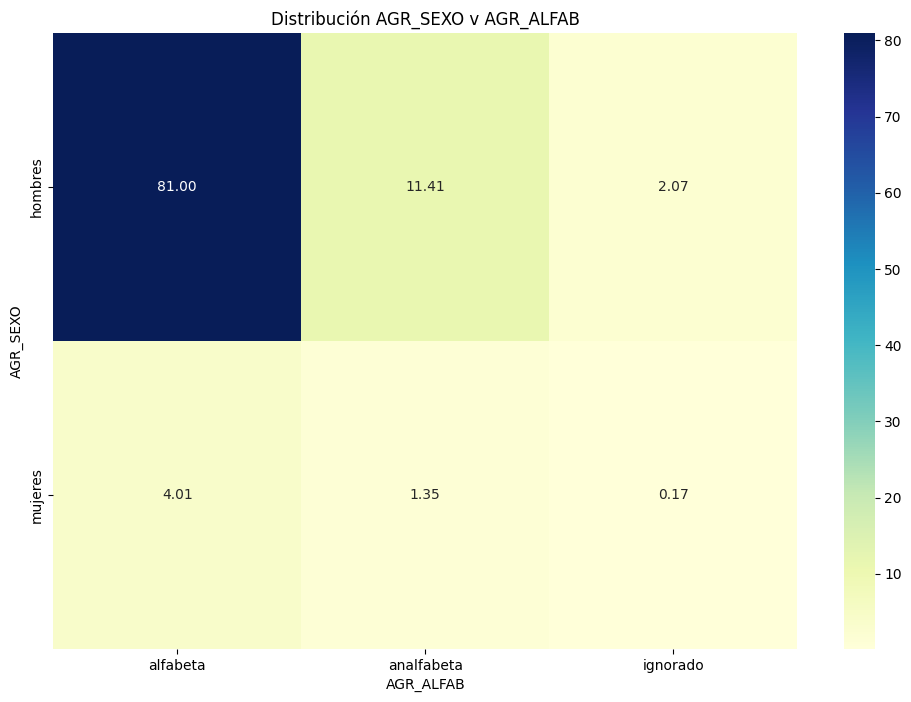

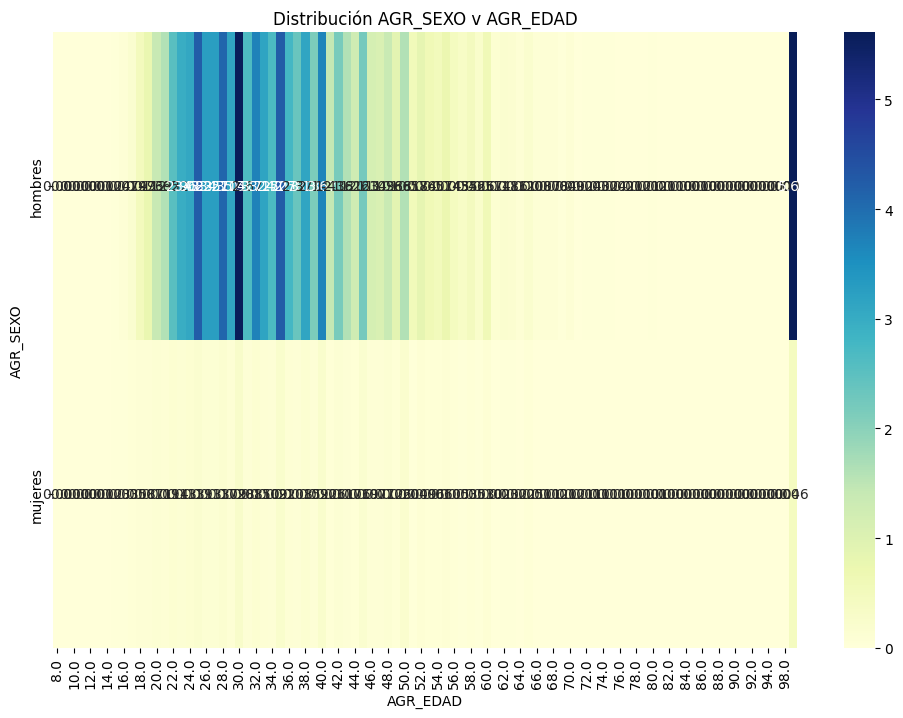

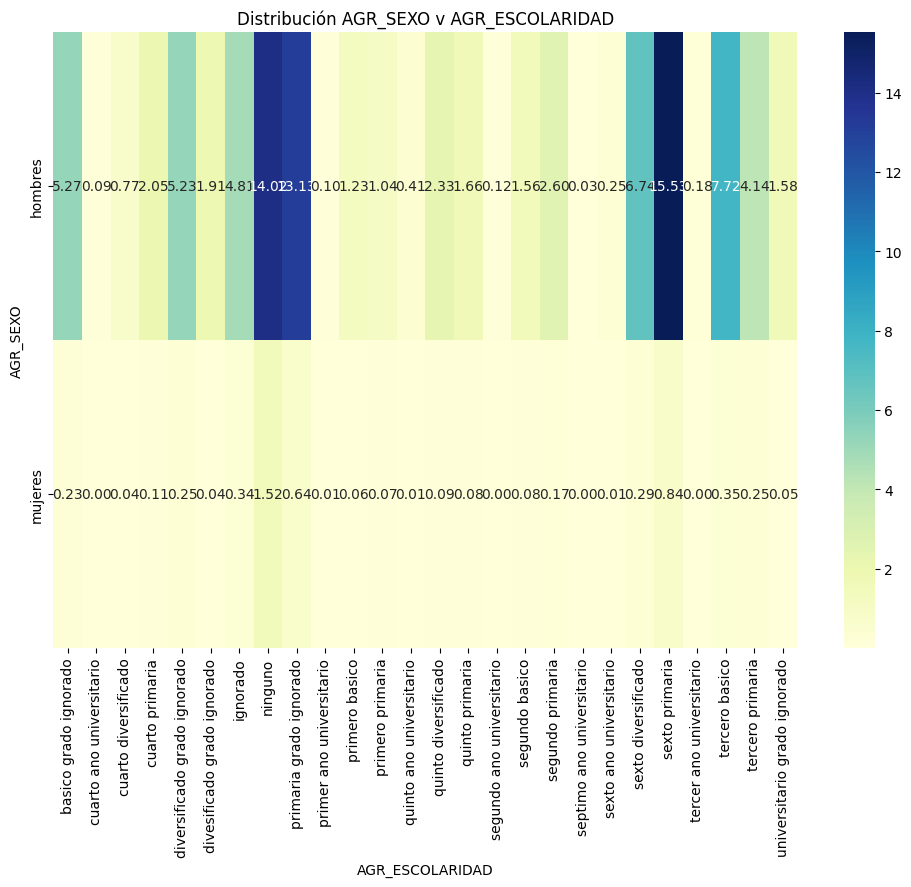

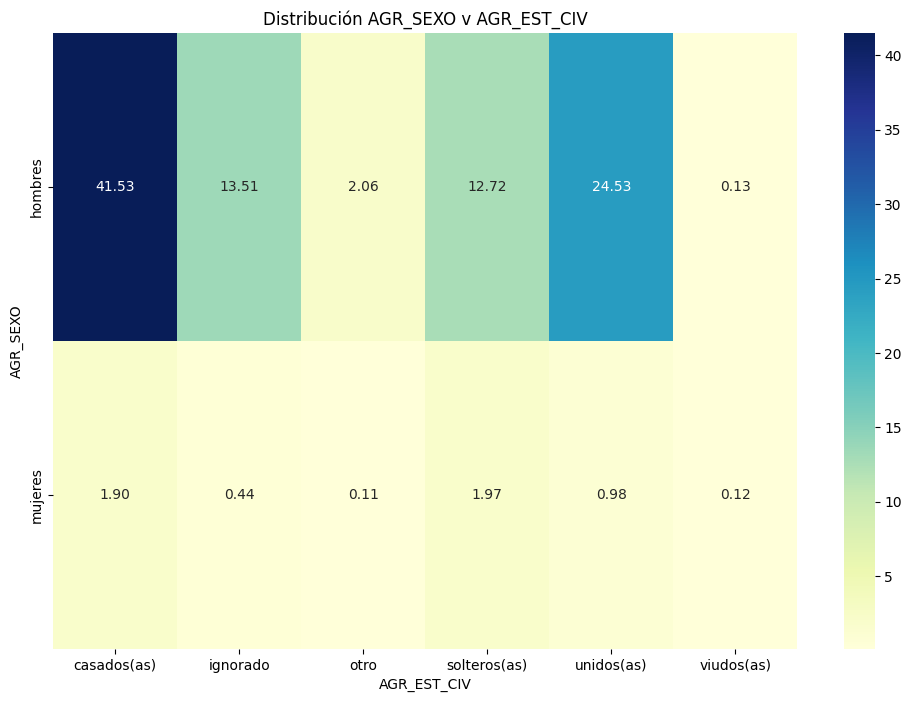

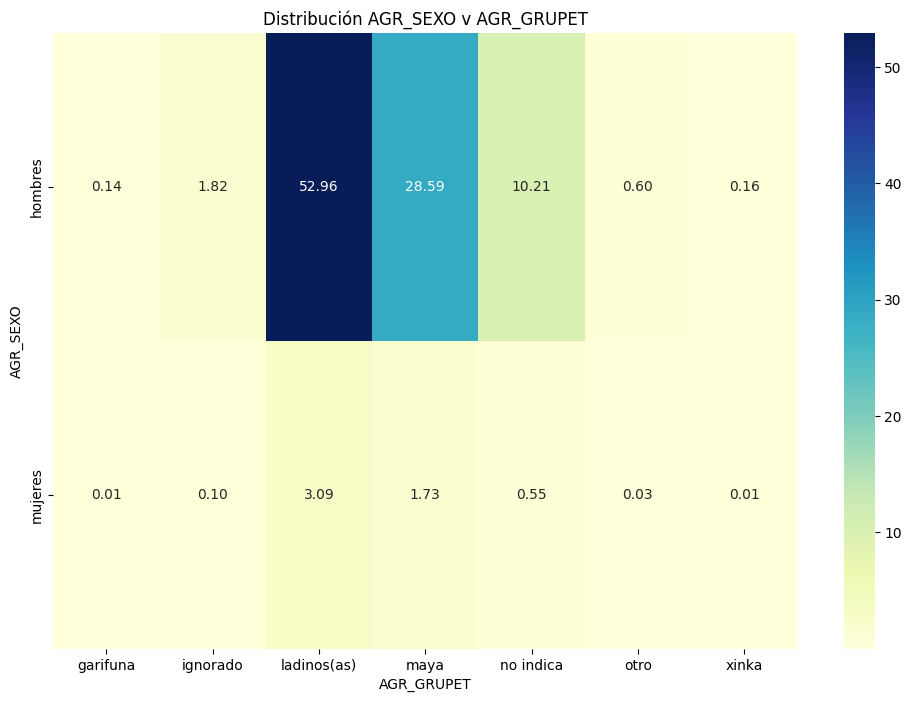

...

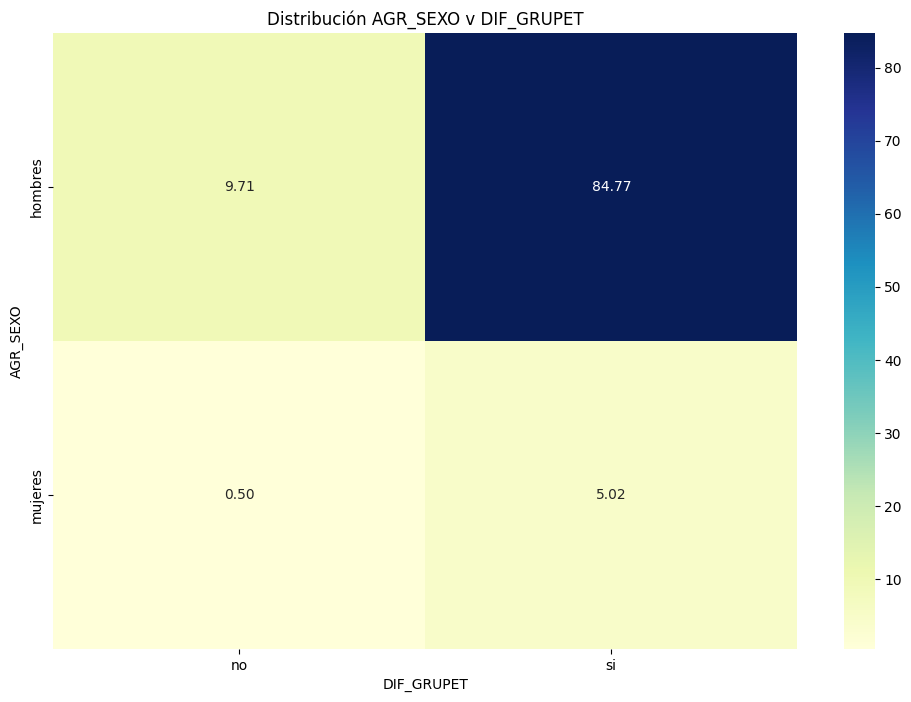

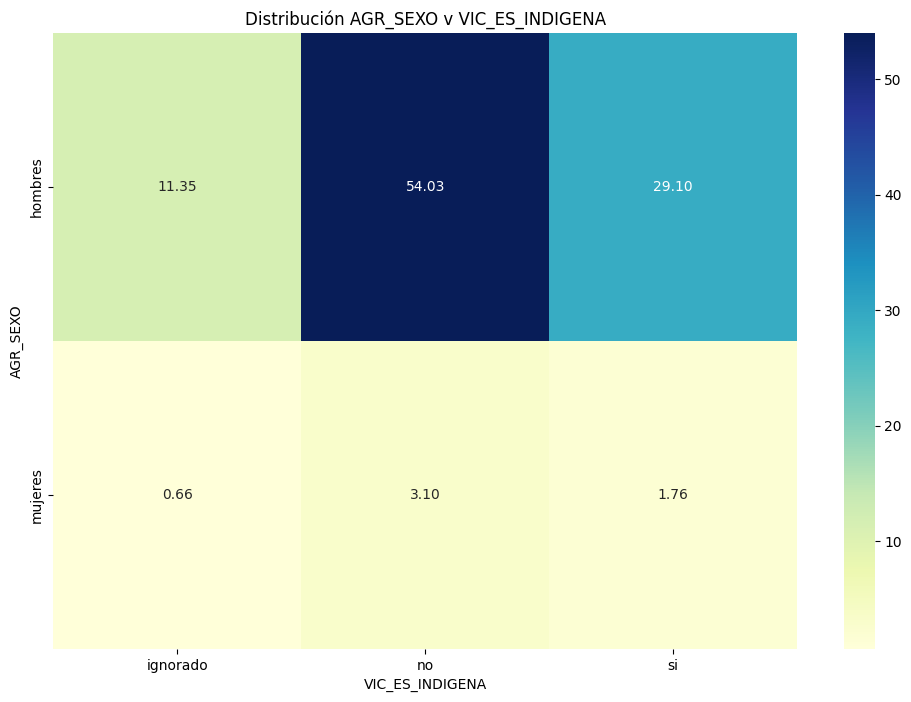

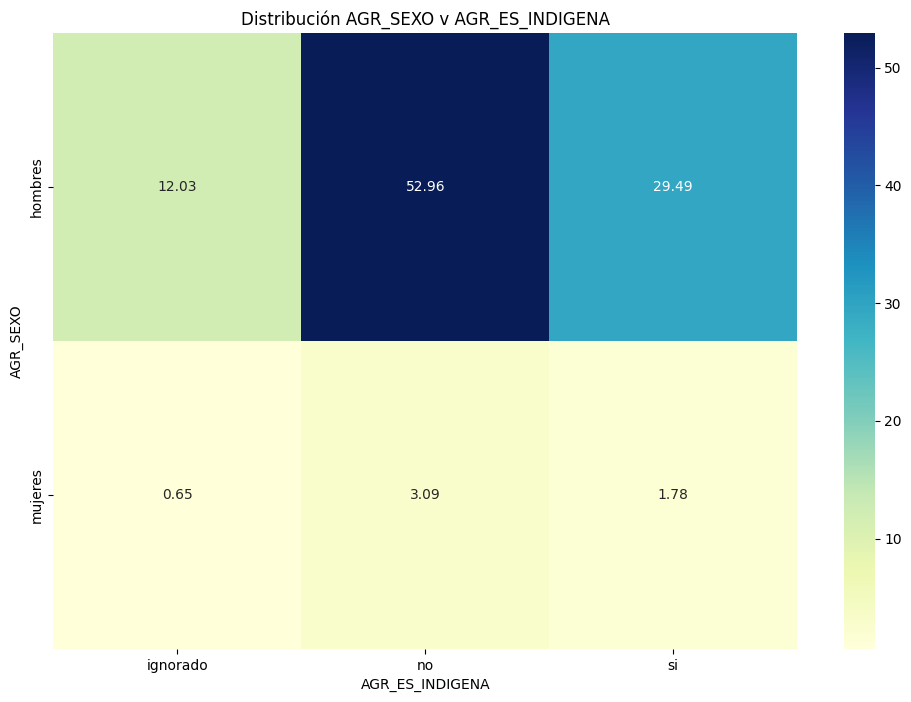

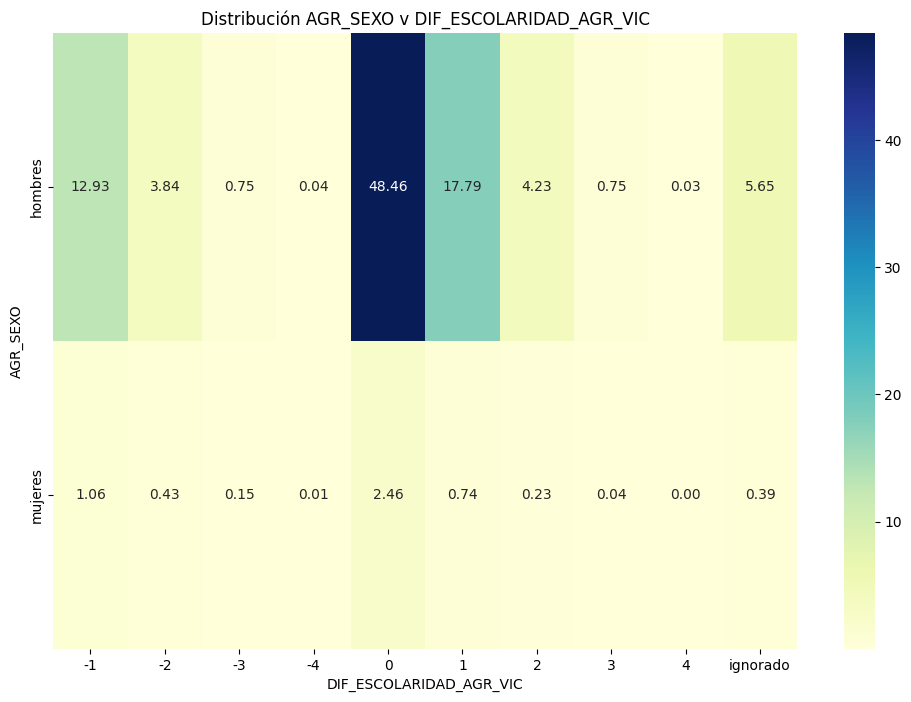

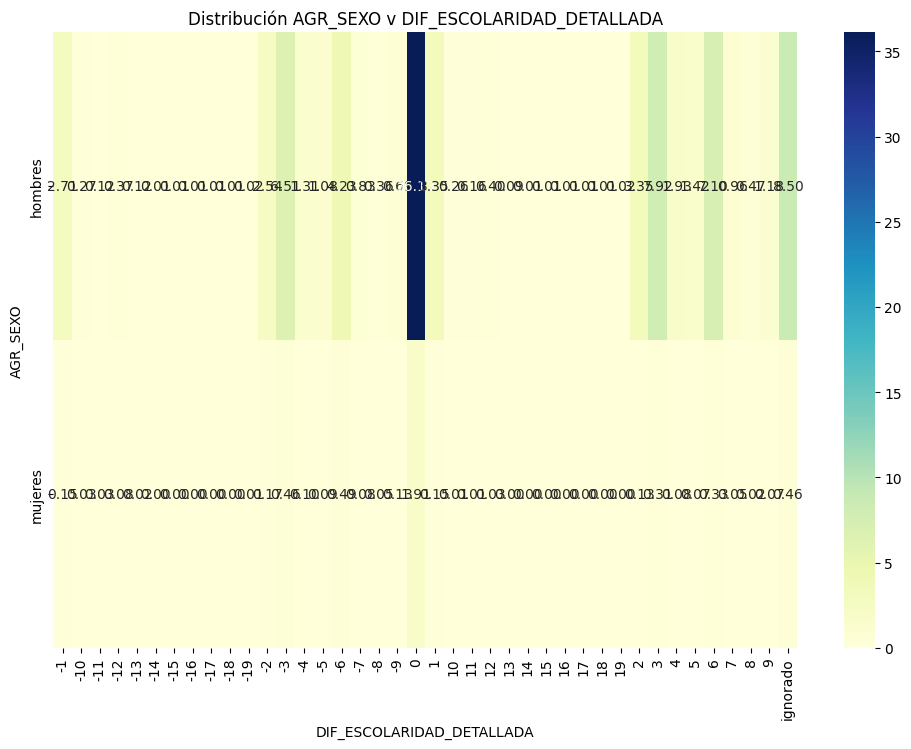

In [21]:
for col2 in relevant_cols:
        tabla = pd.crosstab(df['AGR_SEXO'], df[col2], normalize='all')*100  # o sin normalize para frecuencias
        plt.figure(figsize=(12,8))
        sns.heatmap(tabla, annot=True, cmap="YlGnBu", fmt=".2f")
        plt.title(f"Distribución AGR_SEXO v {col2}")
        plt.show()

### Alfabetismo en víctimas y agresores

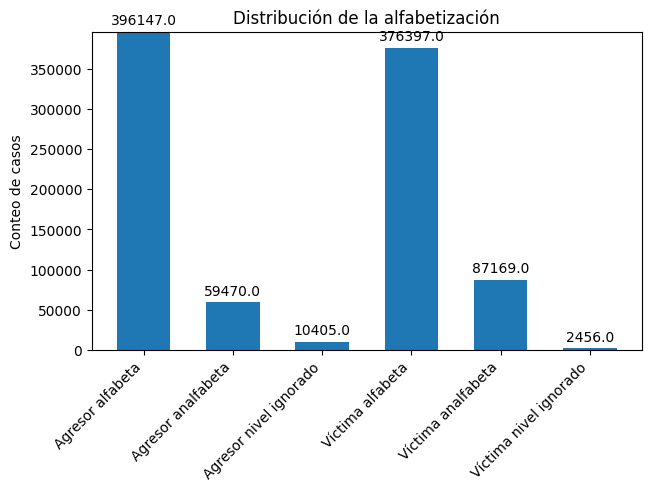

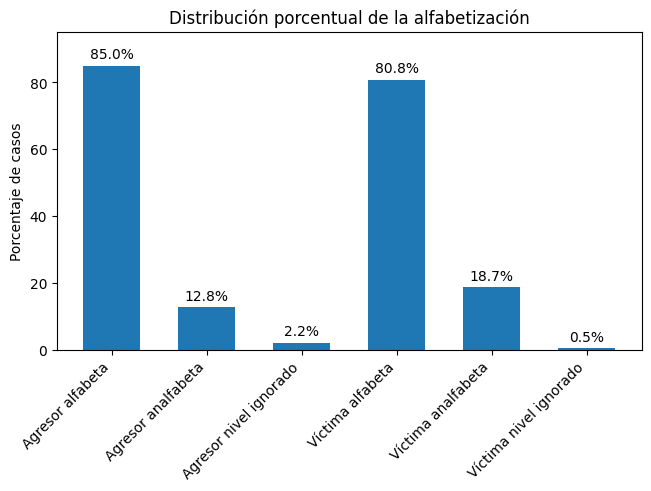

In [22]:
# Cálculo de porcentajes
alfabetismo_agresores = (
    (df["AGR_ALFAB"].value_counts())
    .rename({"alfabeta": "Agresor alfabeta", "analfabeta": "Agresor analfabeta", "ignorado": "Agresor nivel ignorado"})
)

alfabetismo_victimas = (
    (df["VIC_ALFAB"].value_counts())
    .rename({"alfabeta": "Víctima alfabeta", "analfabeta": "Víctima analfabeta", "ignorado": "Víctima nivel ignorado"})
)

# Unimos ambas series
alfabetismo = pd.concat([alfabetismo_agresores, alfabetismo_victimas])
alfabetismo = alfabetismo.reindex([
    "Agresor alfabeta", "Agresor analfabeta", "Agresor nivel ignorado",
    "Víctima alfabeta", "Víctima analfabeta", "Víctima nivel ignorado"
])

# Preparar gráfica
x = np.arange(len(alfabetismo))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, alfabetismo.values, width)
ax.bar_label(rects, padding=3, fmt='%.1f')

# Configuración del gráfico
ax.set_ylabel('Conteo de casos')
ax.set_title('Distribución de la alfabetización')
ax.set_xticks(x)
ax.set_xticklabels(alfabetismo.index, rotation=45, ha='right')
ax.set_ylim(0, alfabetismo.max() + 10)

plt.show()


# Cálculo de porcentajes
alfabetismo_agresores = (
    (df["AGR_ALFAB"].value_counts(normalize=True) * 100)
    .rename({"alfabeta": "Agresor alfabeta", "analfabeta": "Agresor analfabeta", "ignorado": "Agresor nivel ignorado"})
)

alfabetismo_victimas = (
    (df["VIC_ALFAB"].value_counts(normalize=True) * 100)
    .rename({"alfabeta": "Víctima alfabeta", "analfabeta": "Víctima analfabeta", "ignorado": "Víctima nivel ignorado"})
)

# Unimos ambas series
alfabetismo = pd.concat([alfabetismo_agresores, alfabetismo_victimas])
alfabetismo = alfabetismo.reindex([
    "Agresor alfabeta", "Agresor analfabeta", "Agresor nivel ignorado",
    "Víctima alfabeta", "Víctima analfabeta", "Víctima nivel ignorado"
])

# Preparar gráfica
x = np.arange(len(alfabetismo))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, alfabetismo.values, width)
ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos')
ax.set_title('Distribución porcentual de la alfabetización')
ax.set_xticks(x)
ax.set_xticklabels(alfabetismo.index, rotation=45, ha='right')
ax.set_ylim(0, alfabetismo.max() + 10)

plt.show()
# Se observa que realmente las víctimas son personas alfabetas por lo que cierto nivel de estudio mínimo suelen tener, ya que el 80% de las víctimas son alfabetas
# y solo un 19% son analfabetas y un 1% son ignorados si son o no alfabetas
# Así mismo, también se observa que los agresores también tienen un mínimo de estudio ya que casi el 85% es alfabeta mientras que el 13% son analfabetas y un 2% se desconoce
# Esto permite saber que al menos poseen con un mínimo de preparación.

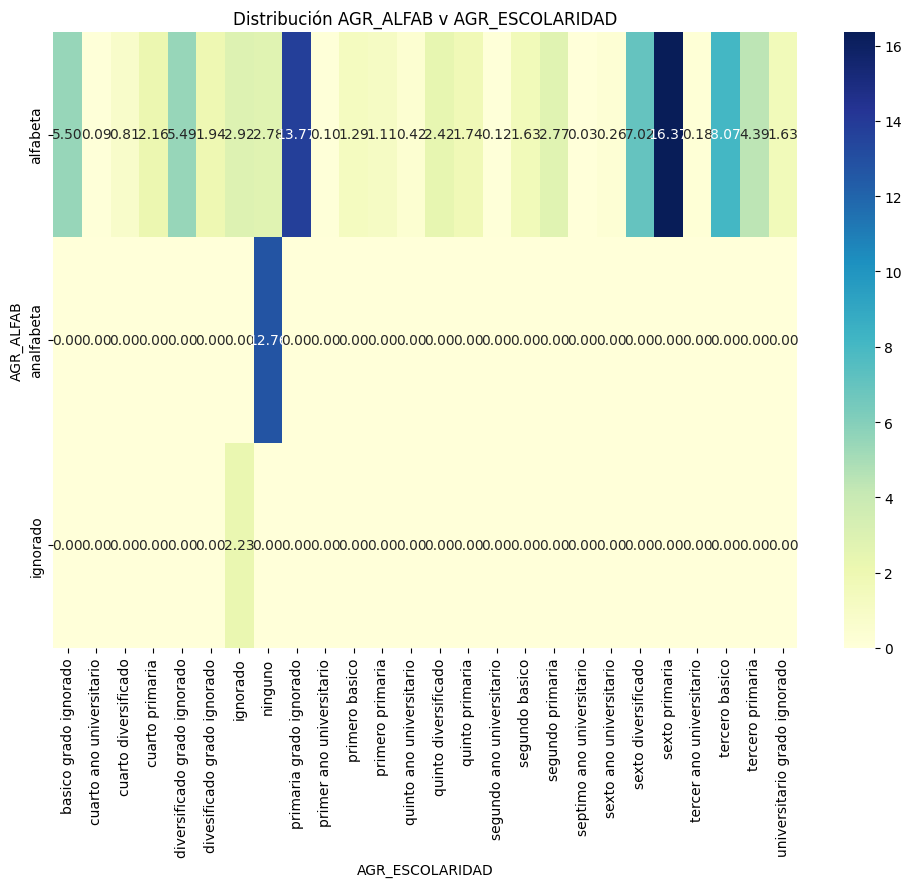

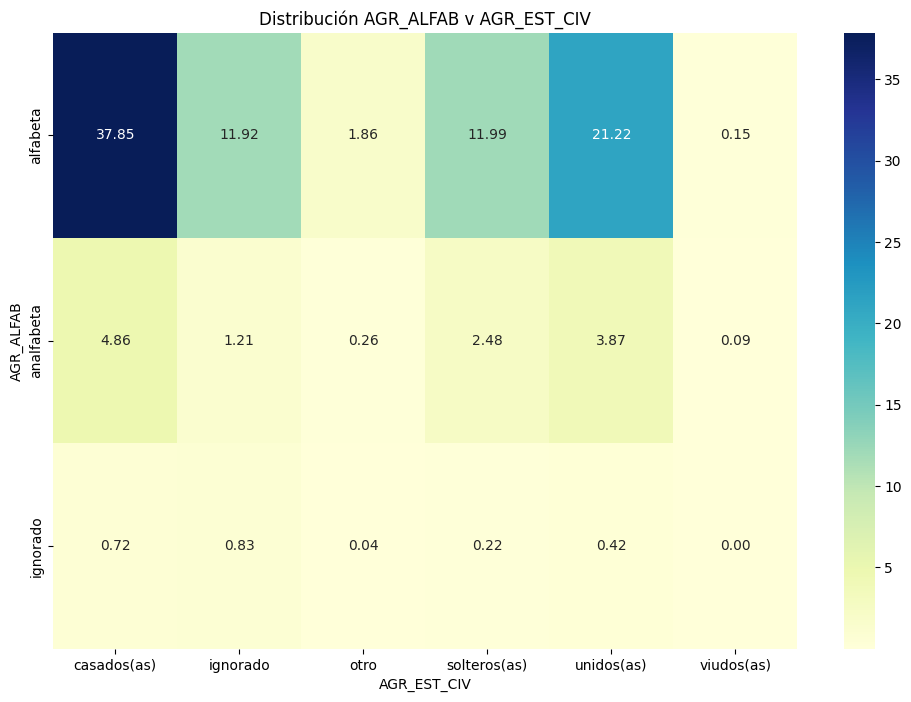

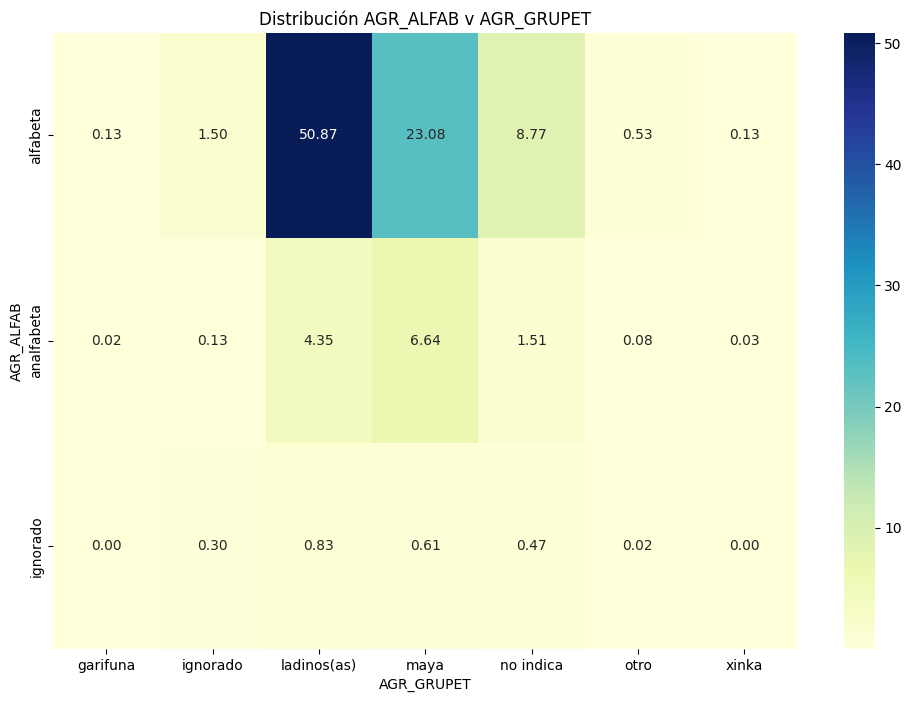

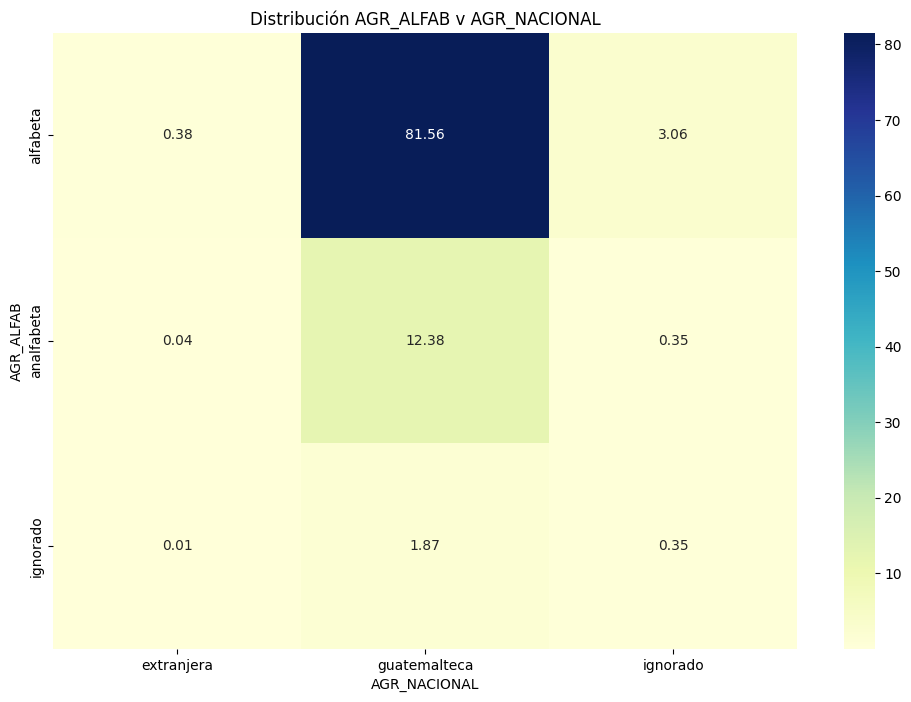

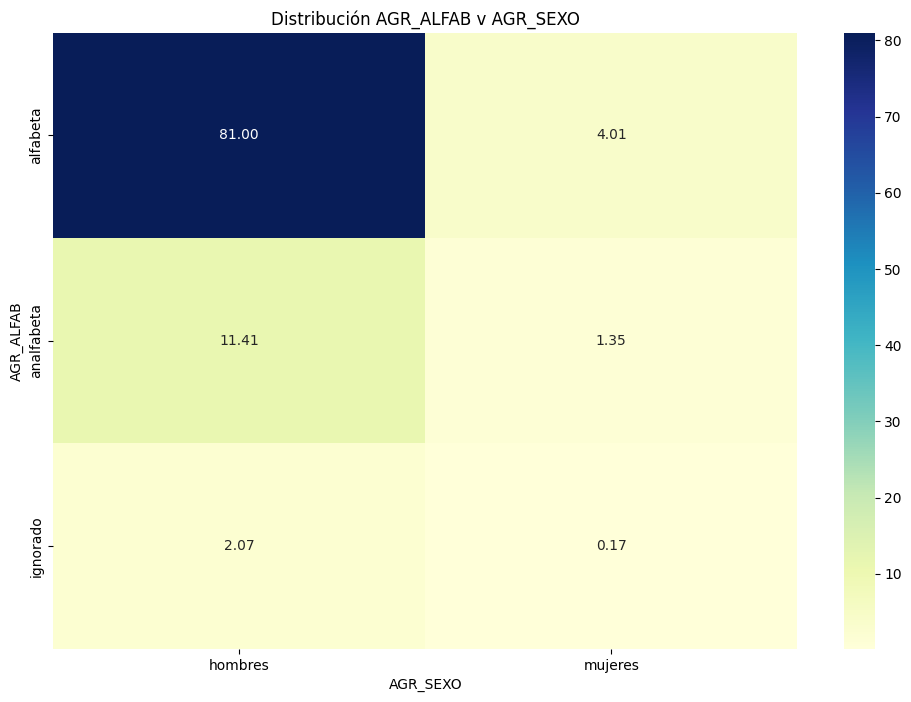

...

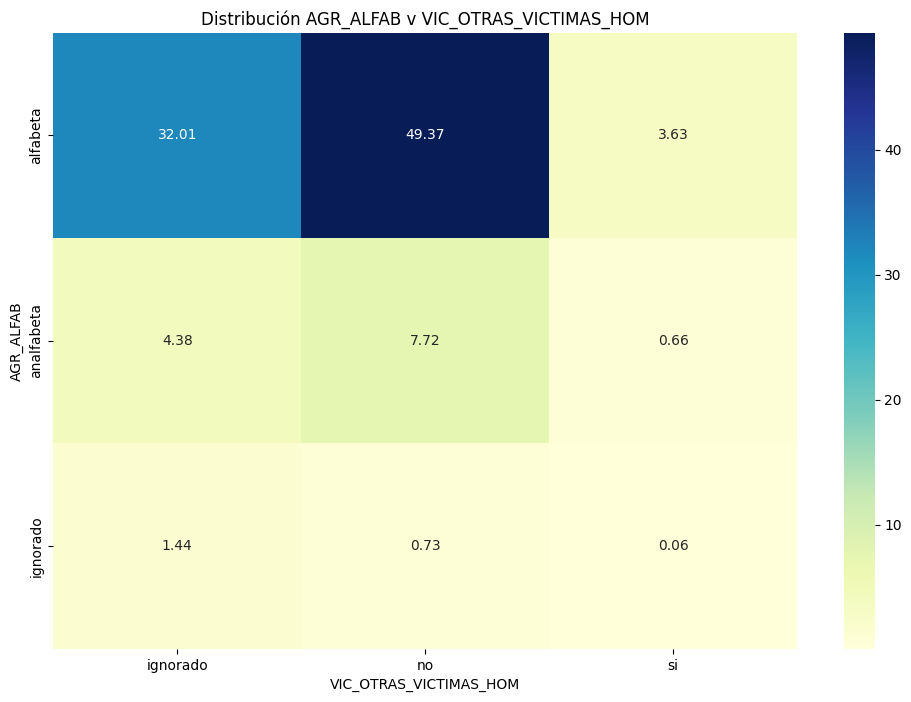

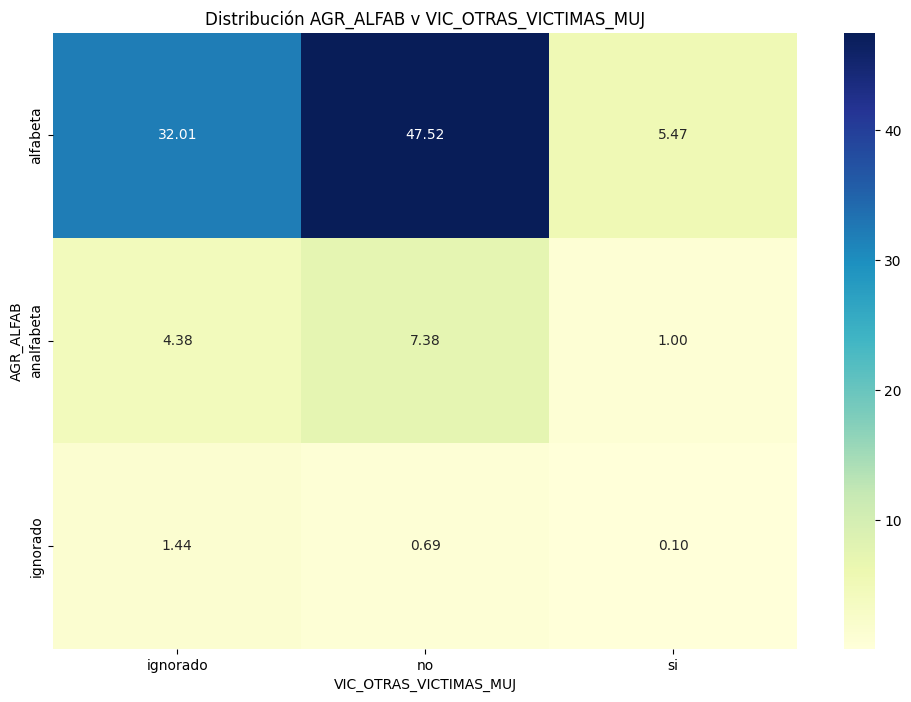

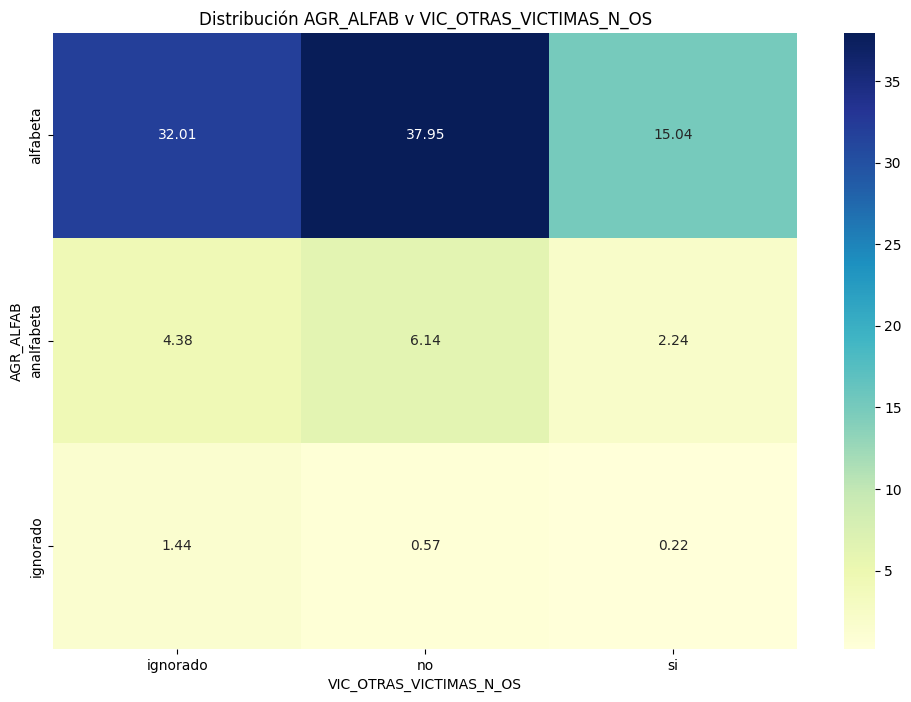

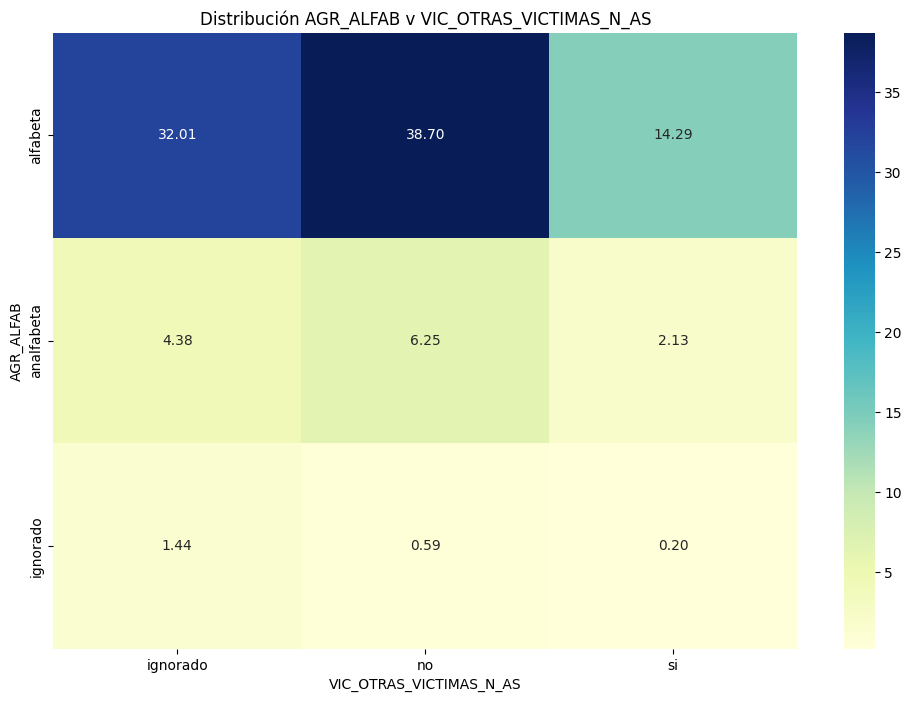

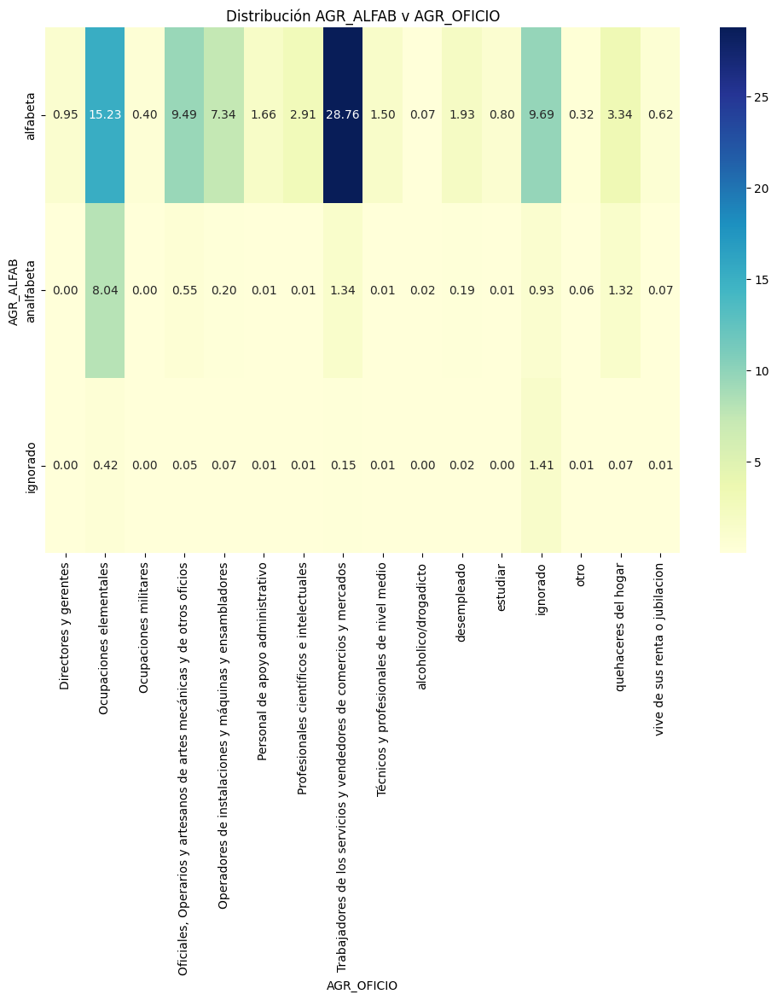

In [23]:
lista_v = ['AGR_ESCOLARIDAD', 'AGR_EST_CIV','AGR_GRUPET', 
        'AGR_NACIONAL', 'AGR_SEXO', 'AGR_TRABAJA','HEC_AREA', 'HEC_TIPAGRE', 'INST_DENUN_HECHO', 'VIC_ALFAB', 'VIC_REL_AGR',
        'AGR_RANGO_EDAD', 'AGR_NIV_ESCOLARIDAD', 'OTROS_AGRESORES',
       'OTROS_AGRESORES_N_AS', 'OTROS_AGRESORES_N_OS', 'OTROS_AGRESORES_MUJ',
       'OTROS_AGRESORES_HOM', 'VIC_OTRAS_VICTIMAS', 'VIC_OTRAS_VICTIMAS_HOM',
       'VIC_OTRAS_VICTIMAS_MUJ', 'VIC_OTRAS_VICTIMAS_N_OS',
       'VIC_OTRAS_VICTIMAS_N_AS','AGR_OFICIO']
for col2 in lista_v:
        tabla = pd.crosstab(df['AGR_ALFAB'], df[col2], normalize='all')*100  # o sin normalize para frecuencias
        plt.figure(figsize=(12,8))
        sns.heatmap(tabla, annot=True, cmap="YlGnBu", fmt=".2f")
        plt.title(f"Distribución AGR_ALFAB v {col2}")
        plt.show()

### Oficios a los que se dedican las víctimas y los agresores
Con oficios se refiere a tanto el trabajo o si se dedica a algo dentro del hogar.

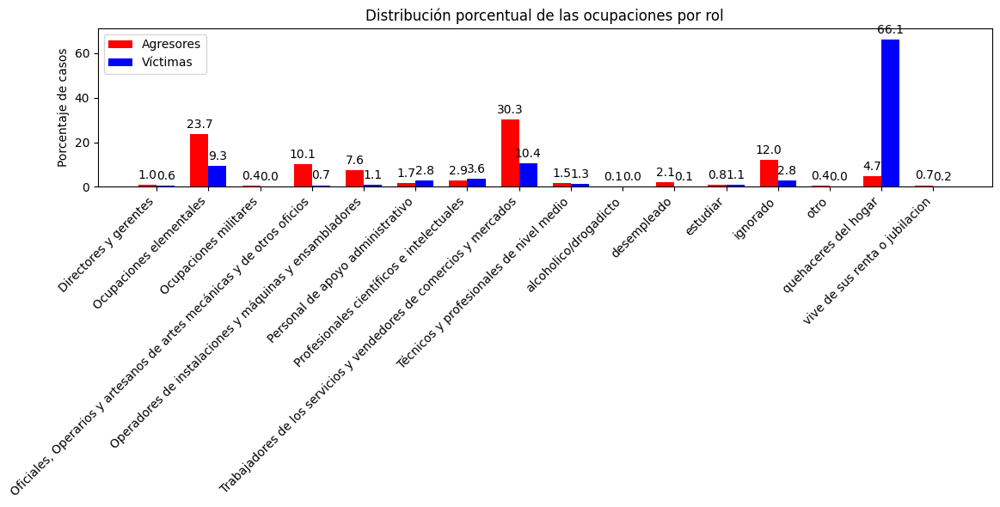

In [24]:
# Cálculo de porcentajes por ocupación
oficio_agresores = (df["AGR_OFICIO"].value_counts(normalize=True) * 100)
oficio_victimas = (df["VIC_OFICIO"].value_counts(normalize=True) * 100)

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = sorted(set(oficio_agresores.index).union(oficio_victimas.index))

# Alineamos las series al índice común
oficio_agresores = oficio_agresores.reindex(ocupaciones, fill_value=0)
oficio_victimas = oficio_victimas.reindex(ocupaciones, fill_value=0)
# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))

# Barras
rects1 = ax.bar(x - width/2, oficio_agresores.values, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, oficio_victimas.values, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje de casos')




ax.set_title('Distribución porcentual de las ocupaciones por rol')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=45, ha='right')
ax.set_ylim(0, max(oficio_agresores.max(), oficio_victimas.max()) + 5)
ax.legend()

plt.tight_layout()
plt.show()


## Salarios

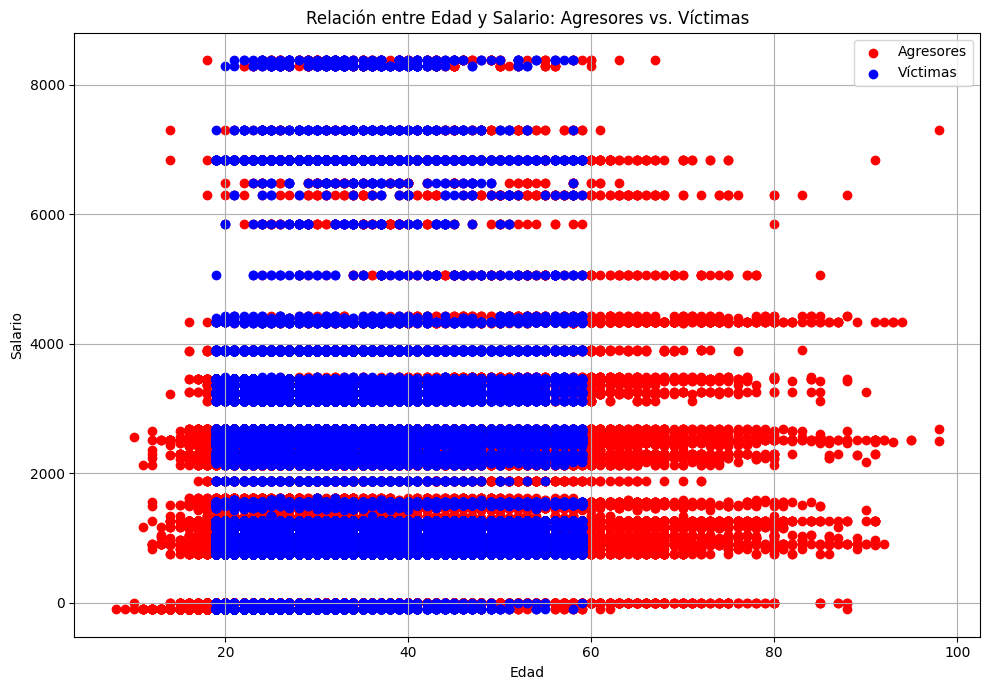

In [25]:
plt.figure(figsize=(10, 7))
age = df[(df['AGR_EDAD']!=9999.0) & (df['VIC_EDAD']!=9999.0)]
# Plot aggressor data
plt.scatter(age['AGR_EDAD'], age['AGR_SALARIO'], color='red', label='Agresores')

# Plot victim data
plt.scatter(age['VIC_EDAD'], age['VIC_SALARIO'], color='blue', label='Víctimas')

# Add labels and legend
plt.xlabel('Edad')
plt.ylabel('Salario')
plt.title('Relación entre Edad y Salario: Agresores vs. Víctimas')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\2717268996.py:4: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


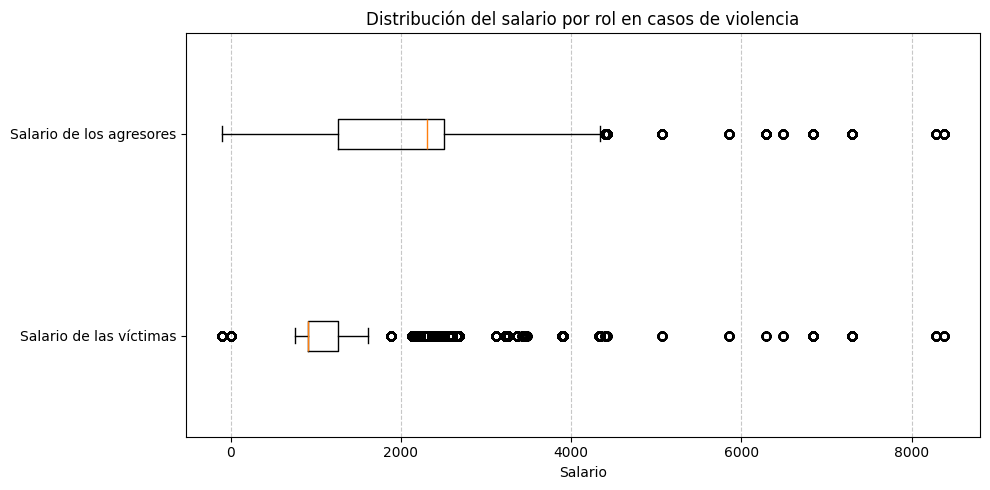

In [26]:
plt.figure(figsize=(10, 5))

# Plot boxplot with corrected label order
plt.boxplot(
    [
        df['VIC_SALARIO'].dropna(),  # Victims first
        df['AGR_SALARIO'].dropna()   # Aggressors second
    ],
    vert=False,
    labels=["Salario de las víctimas", "Salario de los agresores"]
)

plt.xlabel('Salario')
plt.title('Distribución del salario por rol en casos de violencia')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


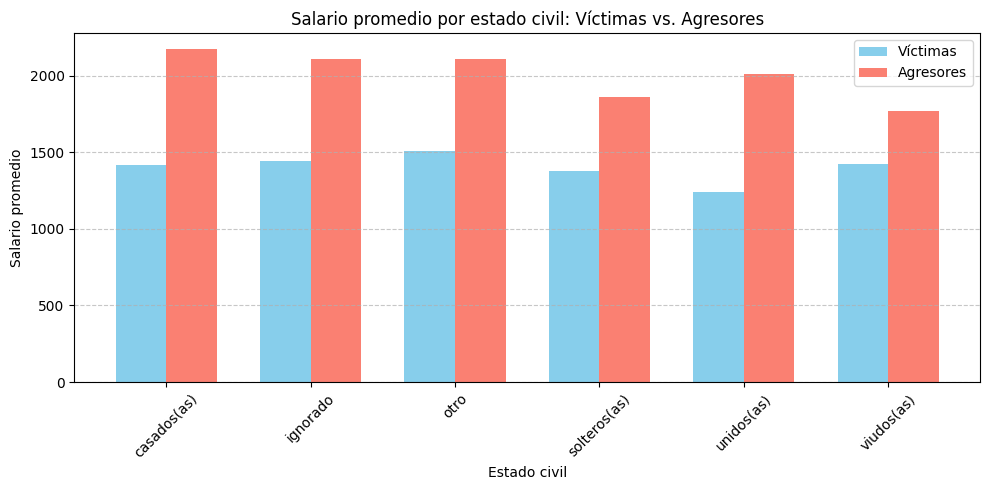

In [27]:
# Get unique civil status categories
categories = sorted(df['VIC_EST_CIV'].dropna().unique())

# Get mean salaries
y1 = df.groupby('VIC_EST_CIV')['VIC_SALARIO'].mean()
y2 = df.groupby('AGR_EST_CIV')['AGR_SALARIO'].mean()

# Align both series to the same category order
y1 = y1.reindex(categories)
y2 = y2.reindex(categories)

# Set bar positions
x = np.arange(len(categories))
width = 0.35  # Width of each bar

# Plot
plt.figure(figsize=(10, 5))
plt.bar(x - width/2, y1, width, label='Víctimas', color='skyblue')
plt.bar(x + width/2, y2, width, label='Agresores', color='salmon')

# Labels and formatting
plt.xticks(x, categories, rotation=45)
plt.xlabel('Estado civil')
plt.ylabel('Salario promedio')
plt.title('Salario promedio por estado civil: Víctimas vs. Agresores')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\2330059911.py:5: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


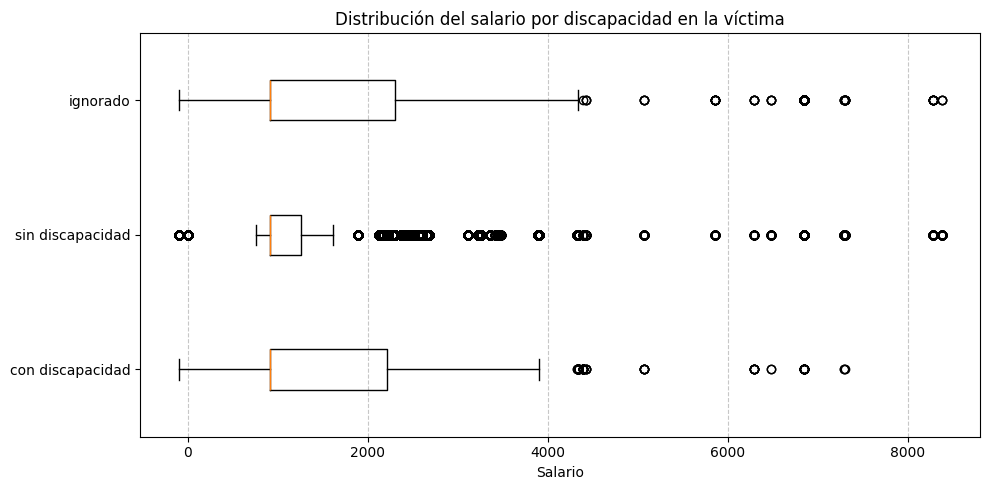

In [28]:
plt.figure(figsize=(10, 5))
labels = df['VIC_DISC'].unique()
vic_disc = [df[df['VIC_DISC']==disc]['VIC_SALARIO'].dropna() for disc in labels]
# Plot boxplot with corrected label order
plt.boxplot(
    vic_disc,
    vert=False,
    labels=labels
)

plt.xlabel('Salario')
plt.title('Distribución del salario por discapacidad en la víctima')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


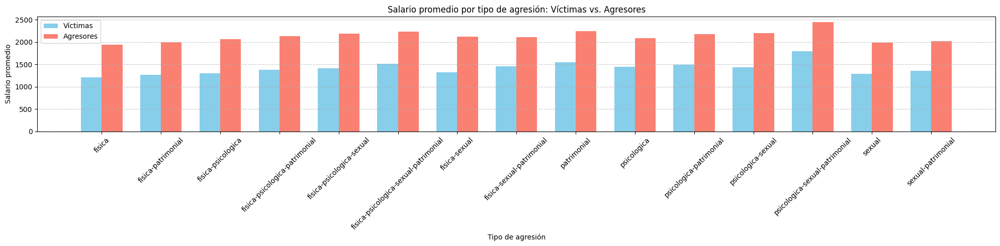

In [29]:
# Drop missing values and ensure consistent categories
df_clean = df.dropna(subset=['HEC_TIPAGRE', 'VIC_SALARIO', 'AGR_SALARIO'])

# Get sorted unique categories
categories = sorted(df_clean['HEC_TIPAGRE'].unique())

# Compute mean salaries per category
vic_means = df_clean.groupby('HEC_TIPAGRE')['VIC_SALARIO'].mean().reindex(categories)
agr_means = df_clean.groupby('HEC_TIPAGRE')['AGR_SALARIO'].mean().reindex(categories)

# Set bar positions
x = np.arange(len(categories))
width = 0.35

# Plot
plt.figure(figsize=(20, 5))
plt.bar(x - width/2, vic_means, width, label='Víctimas', color='skyblue')
plt.bar(x + width/2, agr_means, width, label='Agresores', color='salmon')

# Labels and formatting
plt.xticks(x, categories, rotation=45)
plt.xlabel('Tipo de agresión')
plt.ylabel('Salario promedio')
plt.title('Salario promedio por tipo de agresión: Víctimas vs. Agresores')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [30]:
df['VIC_ES_INDIGENA'].value_counts()

VIC_ES_INDIGENA
no          266251
si          143792
ignorado     55979
Name: count, dtype: int64

In [31]:
df['VIC_RANGO_EDAD'].value_counts()

VIC_RANGO_EDAD
adulto joven    379524
adulto medio     86498
Name: count, dtype: int64

In [32]:
df.columns[:50]

Index(['AGR_ALFAB', 'AGR_EDAD', 'AGR_ESCOLARIDAD', 'AGR_EST_CIV', 'AGR_GRUPET',
       'AGR_NACIONAL', 'AGR_SEXO', 'AGR_TRABAJA', 'ANO_EMISION', 'DEPTO_MCPIO',
       'DIA_EMISION', 'HEC_ANO', 'HEC_AREA', 'HEC_DEPTOMCPIO', 'HEC_DIA',
       'HEC_MES', 'HEC_RECUR_DENUN', 'HEC_TIPAGRE', 'INST_DENUN_HECHO',
       'INST_DONDE_DENUNCIO', 'MES_EMISION', 'NUM_HIJ_HOM', 'NUM_HIJ_MUJ',
       'OTRAS_VICTIMAS', 'QUIEN_REPORTA', 'TIPO_DISCAQ', 'TOTAL_HIJOS',
       'VIC_ALFAB', 'VIC_DISC', 'VIC_EDAD', 'VIC_ESCOLARIDAD', 'VIC_EST_CIV',
       'VIC_GRUPET', 'VIC_NACIONAL', 'VIC_OTRAS_HOM', 'VIC_OTRAS_MUJ',
       'VIC_OTRAS_N_AS', 'VIC_OTRAS_N_OS', 'VIC_REL_AGR', 'VIC_SEXO',
       'VIC_TRABAJA', 'DEPTO', 'HEC_DEPTO', 'AGR_OTRAS_MUJ', 'AGR_OTROS_N_OS',
       'MEDIDAS_SEGURIDAD', 'ORGANISMO_JURISDICCIONAL', 'CONDUCENTE',
       'ORGANISMO_REMITE', 'AGRESORES_OTROS_TOTAL'],
      dtype='object')

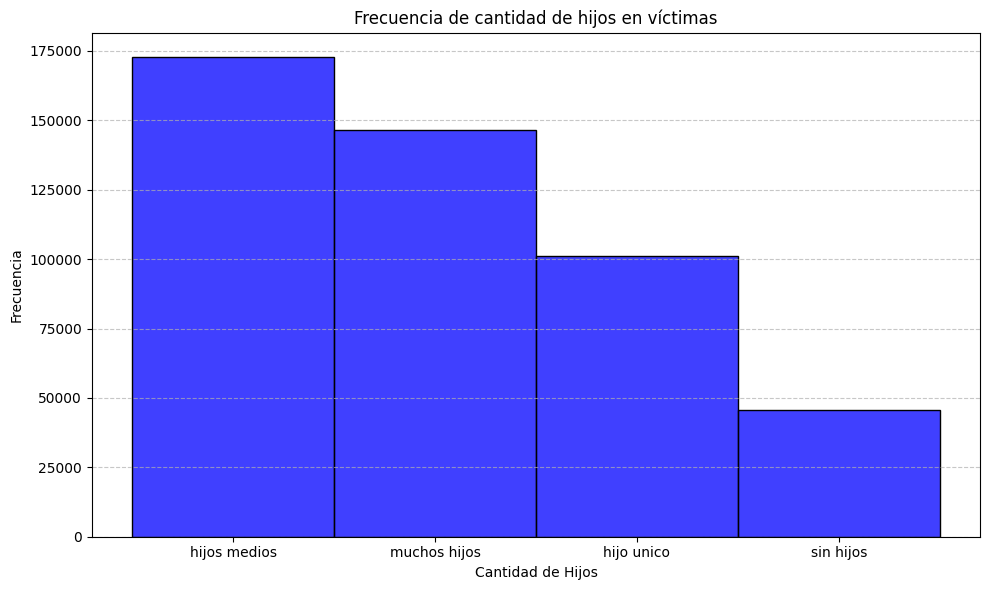

In [33]:
# Preparar datos de víctimas
vic_df = df[['CANTIDAD_HIJOS']].dropna()
vic_df.columns = ['Cantidad de Hijos']

# Graficar histograma
plt.figure(figsize=(10, 6))
sns.histplot(data=vic_df, x='Cantidad de Hijos', bins=10, color='blue', kde=False)

plt.title('Frecuencia de cantidad de hijos en víctimas')
plt.xlabel('Cantidad de Hijos')
plt.ylabel('Frecuencia')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


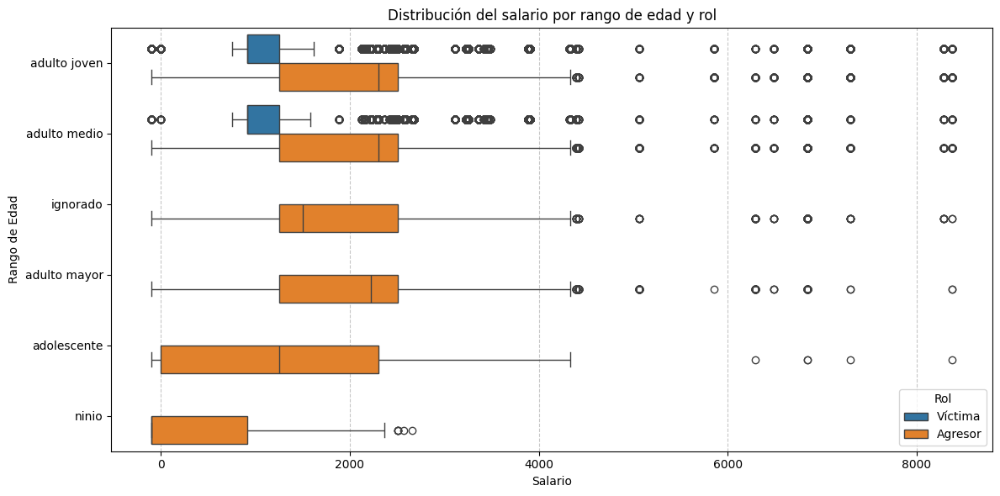

In [34]:
vic_df = df[['VIC_RANGO_EDAD', 'VIC_SALARIO']].dropna()
vic_df.columns = ['Edad', 'Salario']
vic_df['Rol'] = 'Víctima'

agr_df = df[['AGR_RANGO_EDAD', 'AGR_SALARIO']].dropna()
agr_df.columns = ['Edad', 'Salario']
agr_df['Rol'] = 'Agresor'

combined_df = pd.concat([vic_df, agr_df], ignore_index=True)

plt.figure(figsize=(12, 6))
sns.boxplot(data=combined_df, x='Salario', y='Edad', hue='Rol', orient='h')

plt.title('Distribución del salario por rango de edad y rol')
plt.xlabel('Salario')
plt.ylabel('Rango de Edad')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.legend(title='Rol')
plt.tight_layout()
plt.show()


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1301677377.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_salaries, x='Rol', y='Salario', palette={'Víctima': 'blue', 'Agresor': 'red'})


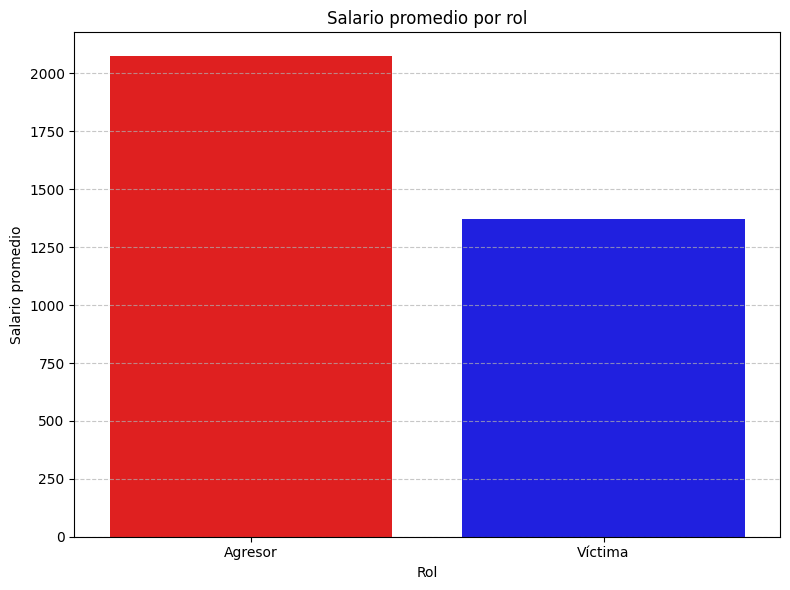

In [35]:
# Preparar datos de víctimas
vic_df = df[['VIC_SALARIO']].dropna()
vic_df.columns = ['Salario']
vic_df['Rol'] = 'Víctima'

# Preparar datos de agresores
agr_df = df[['AGR_SALARIO']].dropna()
agr_df.columns = ['Salario']
agr_df['Rol'] = 'Agresor'

# Combinar ambos
combined_df = pd.concat([vic_df, agr_df], ignore_index=True)

# Calcular salario promedio por rol
mean_salaries = combined_df.groupby('Rol')['Salario'].mean().reset_index()

# Graficar barplot
plt.figure(figsize=(8, 6))
sns.barplot(data=mean_salaries, x='Rol', y='Salario', palette={'Víctima': 'blue', 'Agresor': 'red'})

plt.title('Salario promedio por rol')
plt.xlabel('Rol')
plt.ylabel('Salario promedio')
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


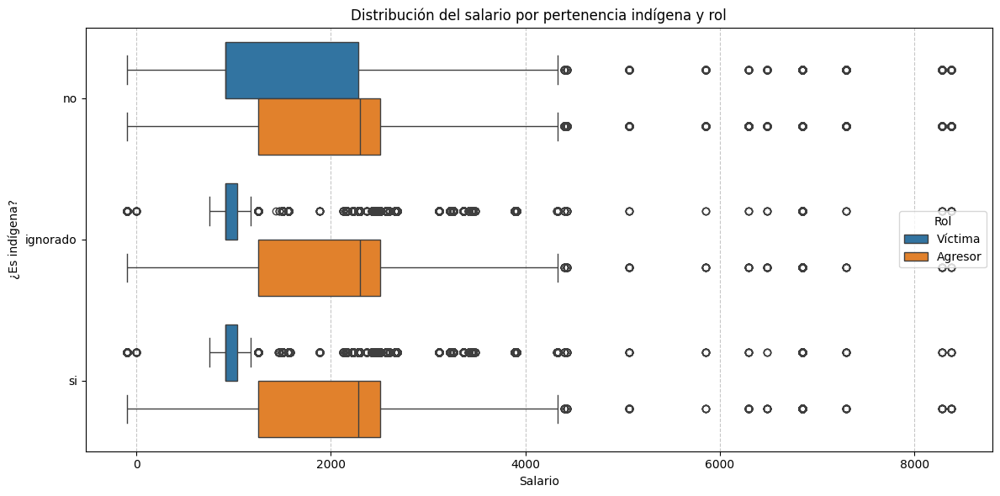

In [36]:
vic_df = df[['VIC_ES_INDIGENA', 'VIC_SALARIO']].dropna()
vic_df.columns = ['Indigena', 'Salario']
vic_df['Rol'] = 'Víctima'

agr_df = df[['AGR_ES_INDIGENA', 'AGR_SALARIO']].dropna()
agr_df.columns = ['Indigena', 'Salario']
agr_df['Rol'] = 'Agresor'

combined_df = pd.concat([vic_df, agr_df], ignore_index=True)

plt.figure(figsize=(12, 6))
sns.boxplot(data=combined_df, x='Salario', y='Indigena', hue='Rol', orient='h')

plt.title('Distribución del salario por pertenencia indígena y rol')
plt.xlabel('Salario')
plt.ylabel('¿Es indígena?')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.legend(title='Rol')
plt.tight_layout()
plt.show()


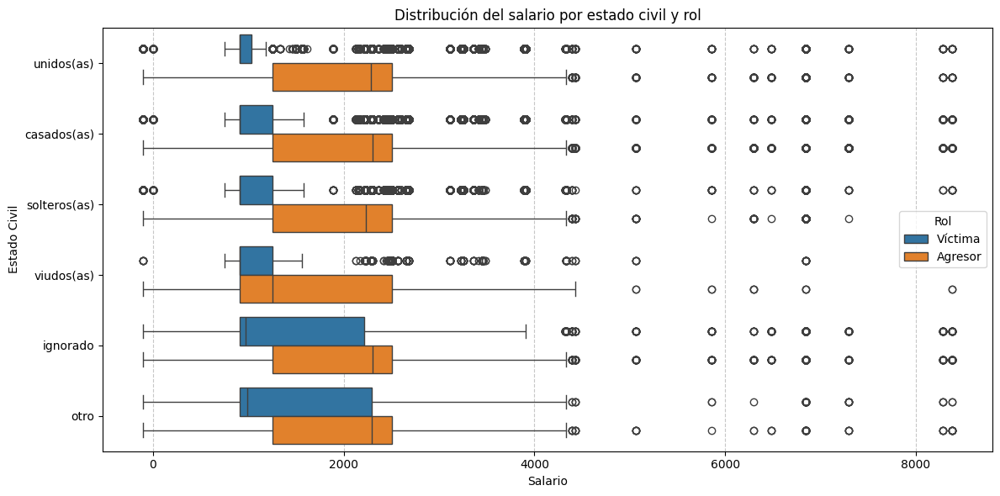

In [37]:
vic_df = df[['VIC_EST_CIV', 'VIC_SALARIO']].dropna()
vic_df.columns = ['Estado Civil', 'Salario']
vic_df['Rol'] = 'Víctima'

agr_df = df[['AGR_EST_CIV', 'AGR_SALARIO']].dropna()
agr_df.columns = ['Estado Civil', 'Salario']
agr_df['Rol'] = 'Agresor'

combined_df = pd.concat([vic_df, agr_df], ignore_index=True)

plt.figure(figsize=(12, 6))
sns.boxplot(data=combined_df, x='Salario', y='Estado Civil', hue='Rol', orient='h')

plt.title('Distribución del salario por estado civil y rol')
plt.xlabel('Salario')
plt.ylabel('Estado Civil')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.legend(title='Rol')
plt.show()



C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3978306226.py:5: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


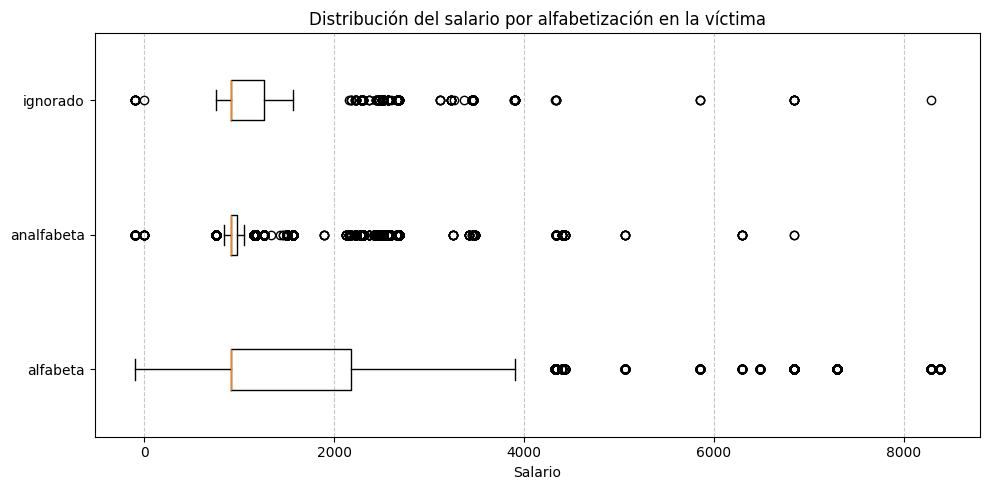

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3978306226.py:20: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


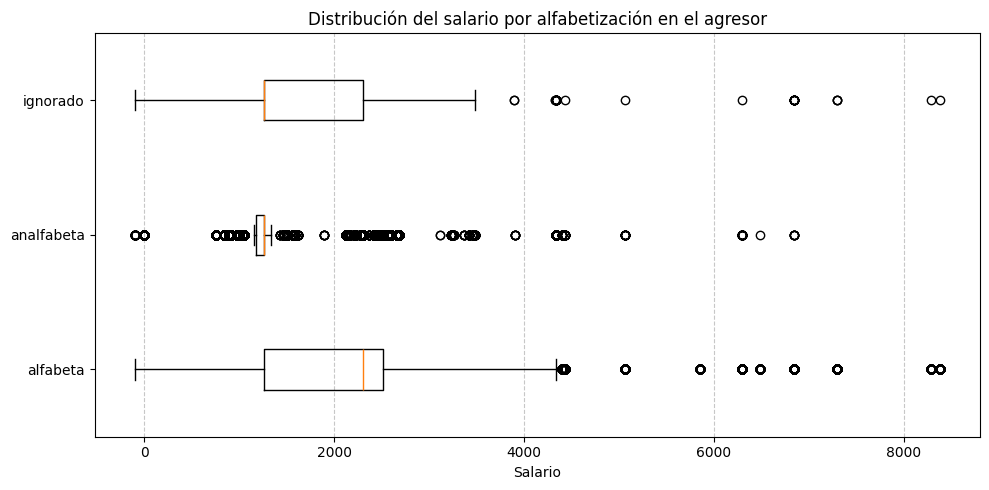

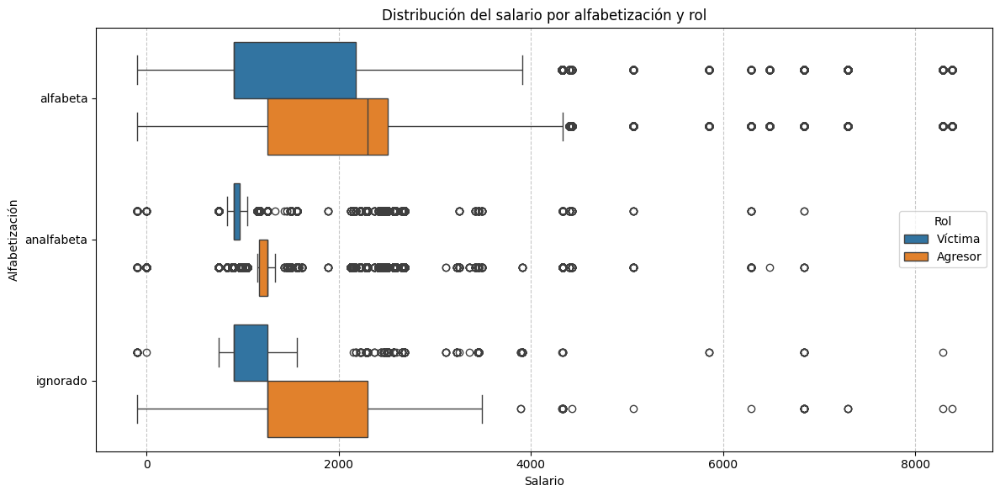

In [38]:
plt.figure(figsize=(10, 5))
labels = df['VIC_ALFAB'].unique()
vic_disc = [df[df['VIC_ALFAB']==disc]['VIC_SALARIO'].dropna() for disc in labels]

plt.boxplot(
    vic_disc,
    vert=False,
    labels=labels
)

plt.xlabel('Salario')
plt.title('Distribución del salario por alfabetización en la víctima')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
plt.figure(figsize=(10, 5))
labels = df['AGR_ALFAB'].unique()
agr_disc = [df[df['AGR_ALFAB']==disc]['AGR_SALARIO'].dropna() for disc in labels]
# Plot boxplot with corrected label order
plt.boxplot(
    agr_disc,
    vert=False,
    labels=labels
)

plt.xlabel('Salario')
plt.title('Distribución del salario por alfabetización en el agresor')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Prepare victim data
vic_df = df[['VIC_ALFAB', 'VIC_SALARIO']].dropna()
vic_df.columns = ['Alfabetización', 'Salario']
vic_df['Rol'] = 'Víctima'

# Prepare aggressor data
agr_df = df[['AGR_ALFAB', 'AGR_SALARIO']].dropna()
agr_df.columns = ['Alfabetización', 'Salario']
agr_df['Rol'] = 'Agresor'

# Combine both
combined_df = pd.concat([vic_df, agr_df], ignore_index=True)

# Plot
plt.figure(figsize=(12, 6))
sns.boxplot(data=combined_df, x='Salario', y='Alfabetización', hue='Rol', orient='h')

plt.title('Distribución del salario por alfabetización y rol')
plt.xlabel('Salario')
plt.ylabel('Alfabetización')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.legend(title='Rol')
plt.show()



### Rangos de edades de las víctimas y de los agresores

VIC_RANGO_EDAD
adulto joven    379524
adulto medio     86498
Name: count, dtype: int64
VIC_RANGO_EDAD
adulto joven    81.439074
adulto medio    18.560926
Name: count, dtype: float64
AGR_RANGO_EDAD
adulto joven    323467
adulto medio    101452
ignorado         28307
adulto mayor      7937
adolescente       4742
ninio              117
Name: count, dtype: int64
AGR_RANGO_EDAD
adulto joven    69.410242
adulto medio    21.769788
ignorado         6.074177
adulto mayor     1.703138
adolescente      1.017549
ninio            0.025106
Name: count, dtype: float64
AGR_RANGO_EDAD  adolescente  adulto joven  adulto mayor  adulto medio  \
VIC_RANGO_EDAD                                                          
adulto joven           3563        297776          3850         51411   
adulto medio           1179         25691          4087         50041   

AGR_RANGO_EDAD  ignorado  ninio  
VIC_RANGO_EDAD                   
adulto joven       22833     91  
adulto medio        5474     26  
AGR_RANGO_E

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\103788255.py:16: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([df[df["VIC_EDAD"]<101]["VIC_EDAD"], df[df["AGR_EDAD"]<101]["AGR_EDAD"] ], vert=False, labels=["Víctimas", "Agresores"])


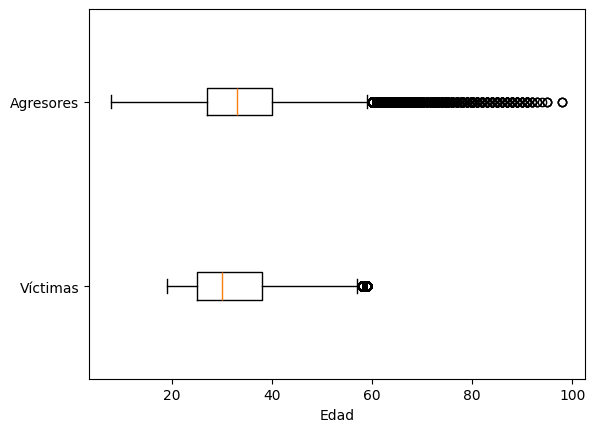

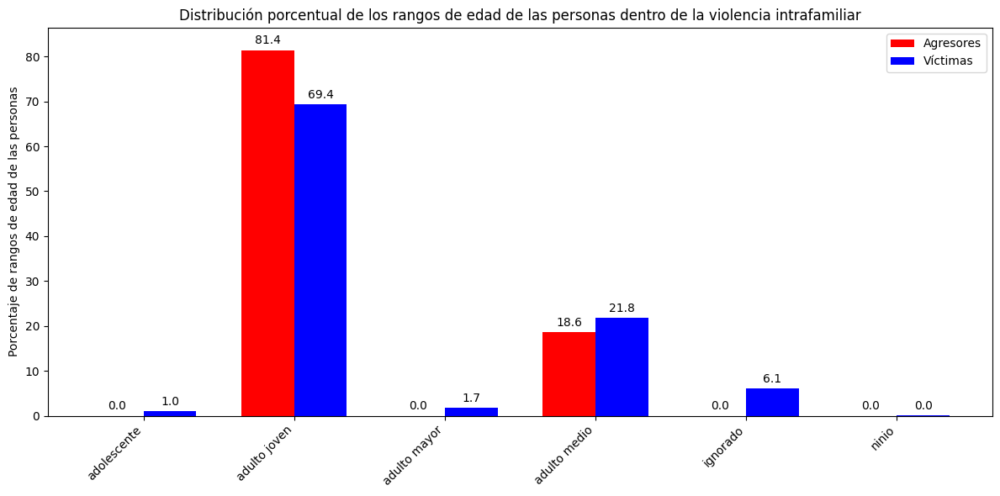

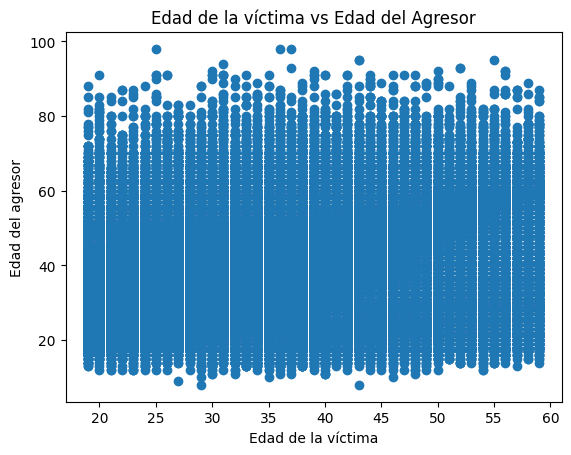

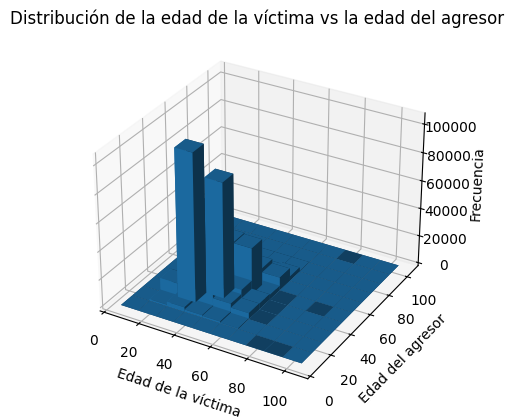

In [39]:
print(df["VIC_RANGO_EDAD"].value_counts())
print(df["VIC_RANGO_EDAD"].value_counts()/df["VIC_RANGO_EDAD"].shape[0]*100)
# Aquí se observa que el adulto joven suele ser el más afectado como víctima por lo que se comprende desde los 20 hasta los 40 años, sin embargo, también el adulto medio, esto indica que el rango es desde los 20 hasta los 64 años.
# Mientras que los niños, probablemente porque no suelen ser los que reportan los abusos ni nada ya que se toma como violencia infantil se toma como casi un 0%.
# Es llamativo que el adulto mayor como tal no suele sufrir la violencia intrafamiliar tan presente como se supondría
# A su vez el adolescente tampoco suele reportar que sufre violencia intrafamiliar, probablemnte porque no suelen ser los que reportan.
# Así mismo se observa que normalmente no se ignora cuál es la edad de las víctimas ya que solo es el 1%
print(df["AGR_RANGO_EDAD"].value_counts())
print(df["AGR_RANGO_EDAD"].value_counts()/df["AGR_RANGO_EDAD"].shape[0]*100)
# Así mismo, se observa que los agresores también abarcan mayoritariamente el rango de adulto joven y adulto medio.
# A su vez, se observan distribuciones similares de adolescentes y de niños que casi no suelen ser los agresores 
# Increíblemente si parece existir una diferencia significativa entre los casos de adultos mayores que son agresores ya que son significativamente menos que las víctimas.
print(pd.crosstab(df["VIC_RANGO_EDAD"], df["AGR_RANGO_EDAD"]))
print(pd.crosstab(df["VIC_RANGO_EDAD"], df["AGR_RANGO_EDAD"])/df.shape[0]*100)
# Así mismo, se observa que dónde más suelen haber casos es entre los rangos de 20-64 años lo que comprende adulto medio y adulto joven, pero sobre todo entre adultos jovenes.
plt.boxplot([df[df["VIC_EDAD"]<101]["VIC_EDAD"], df[df["AGR_EDAD"]<101]["AGR_EDAD"] ], vert=False, labels=["Víctimas", "Agresores"])
plt.xlabel('Edad')
plt.show()

# Cálculo de porcentajes por ocupación
oficio_agresores = (df["VIC_RANGO_EDAD"].value_counts(normalize=True) * 100)
oficio_victimas = (df["AGR_RANGO_EDAD"].value_counts(normalize=True) * 100)

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = sorted(set(oficio_agresores.index).union(oficio_victimas.index))

# Alineamos las series al índice común
oficio_agresores = oficio_agresores.reindex(ocupaciones, fill_value=0)
oficio_victimas = oficio_victimas.reindex(ocupaciones, fill_value=0)

# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))

# Barras
rects1 = ax.bar(x - width/2, oficio_agresores.values, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, oficio_victimas.values, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje de rangos de edad de las personas')
ax.set_title('Distribución porcentual de los rangos de edad de las personas dentro de la violencia intrafamiliar')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=45, ha='right')
ax.set_ylim(0, max(oficio_agresores.max(), oficio_victimas.max()) + 5)
ax.legend()

plt.tight_layout()
plt.show()

plt.scatter(df[(df["VIC_EDAD"]<101) & (df["AGR_EDAD"]<101)]["VIC_EDAD"], df[(df["VIC_EDAD"]<101) & (df["AGR_EDAD"]<101)]["AGR_EDAD"] )
plt.title("Edad de la víctima vs Edad del Agresor")
plt.xlabel("Edad de la víctima")
plt.ylabel("Edad del agresor")
plt.show()
# De los casos que se conoce la edad de ambos, realmente no se puede distinguir alguna tendencia o algo por el estilo
x = df[(df["VIC_EDAD"] < 101) & (df["AGR_EDAD"] < 101)]["VIC_EDAD"]
y = df[(df["VIC_EDAD"] < 101) & (df["AGR_EDAD"] < 101)]["AGR_EDAD"]

fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# Use realistic range and bins
bins = 10  # adjust as needed for resolution
hist, xedges, yedges = np.histogram2d(x, y, bins=bins, range=[[0, 100], [0, 100]])

# Prepare positions
xpos, ypos = np.meshgrid(xedges[:-1] + (xedges[1] - xedges[0])/2,
                         yedges[:-1] + (yedges[1] - yedges[0])/2, indexing="ij")
xpos = xpos.ravel()
ypos = ypos.ravel()
zpos = np.zeros_like(xpos)

# Prepare bar sizes
dx = dy = (xedges[1] - xedges[0]) * np.ones_like(zpos)
dz = hist.ravel()

# Plot
ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
ax.set_title("Distribución de la edad de la víctima vs la edad del agresor")
ax.set_xlabel("Edad de la víctima")
ax.set_ylabel("Edad del agresor")
ax.set_zlabel("Frecuencia")
plt.show()

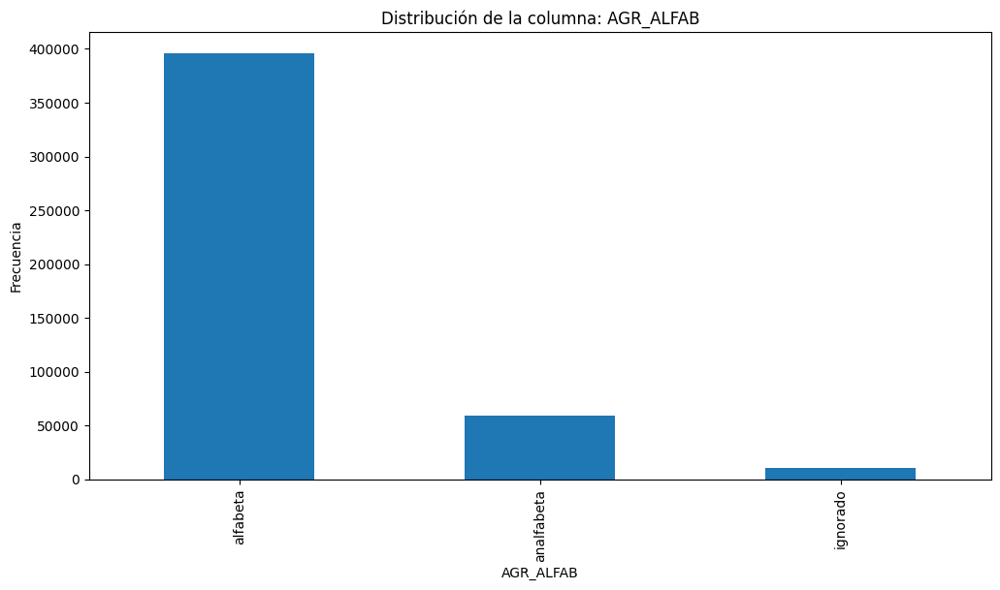

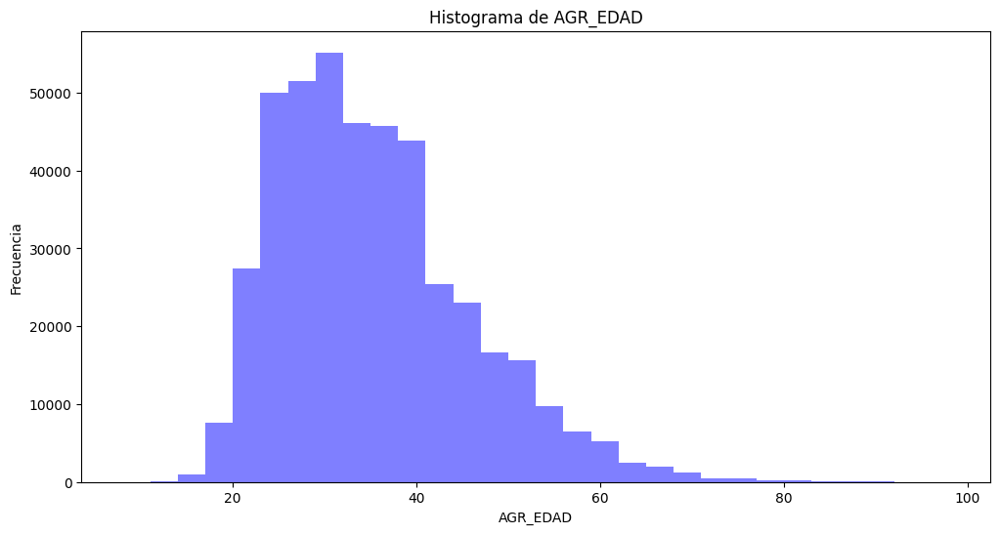

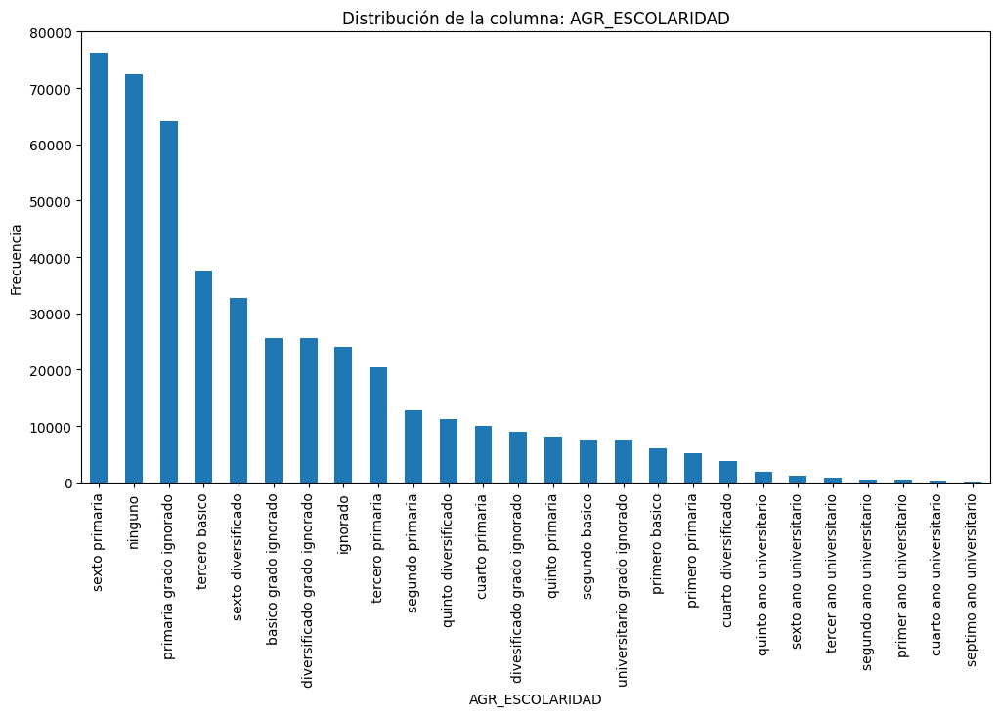

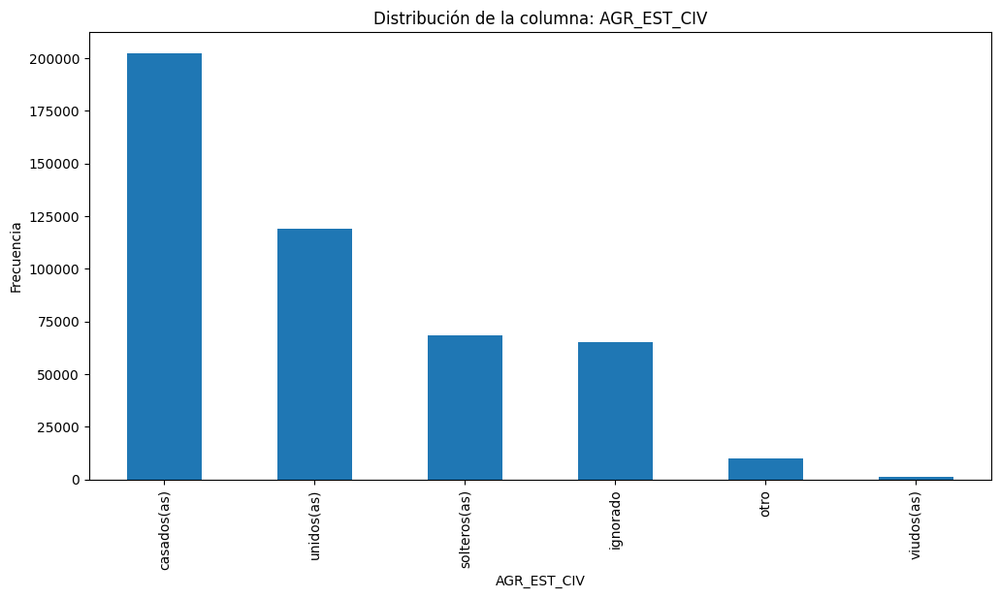

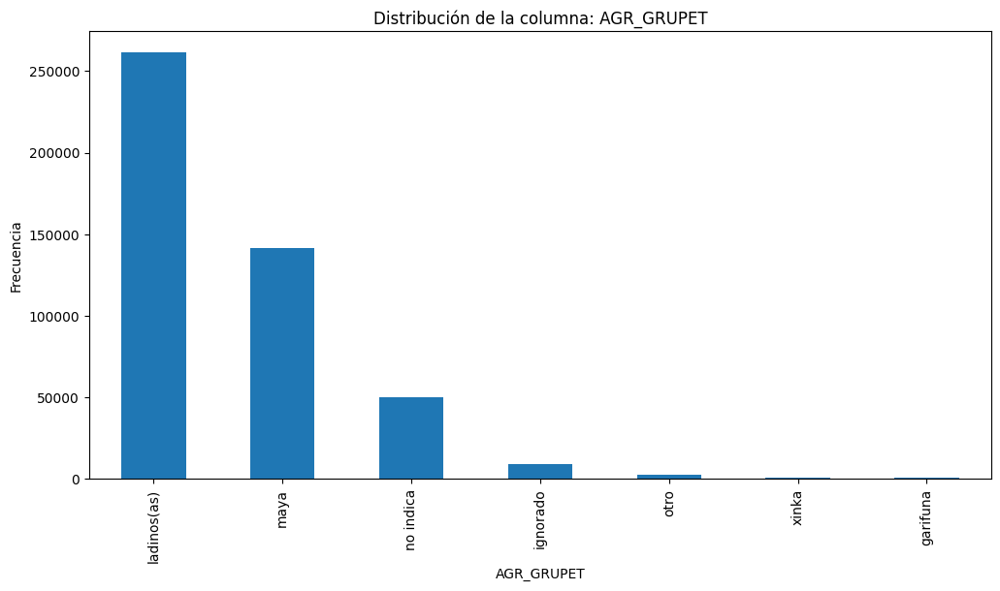

...

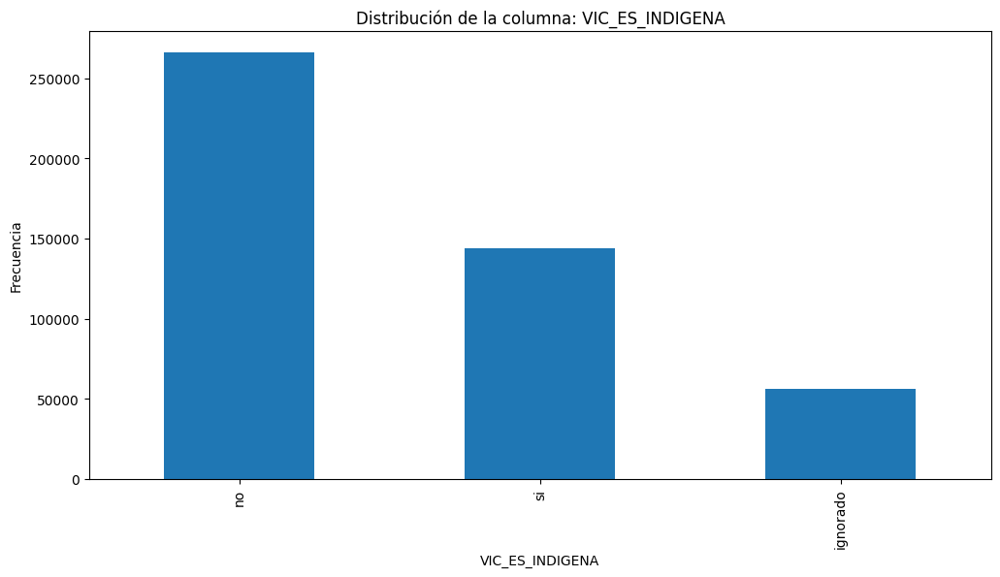

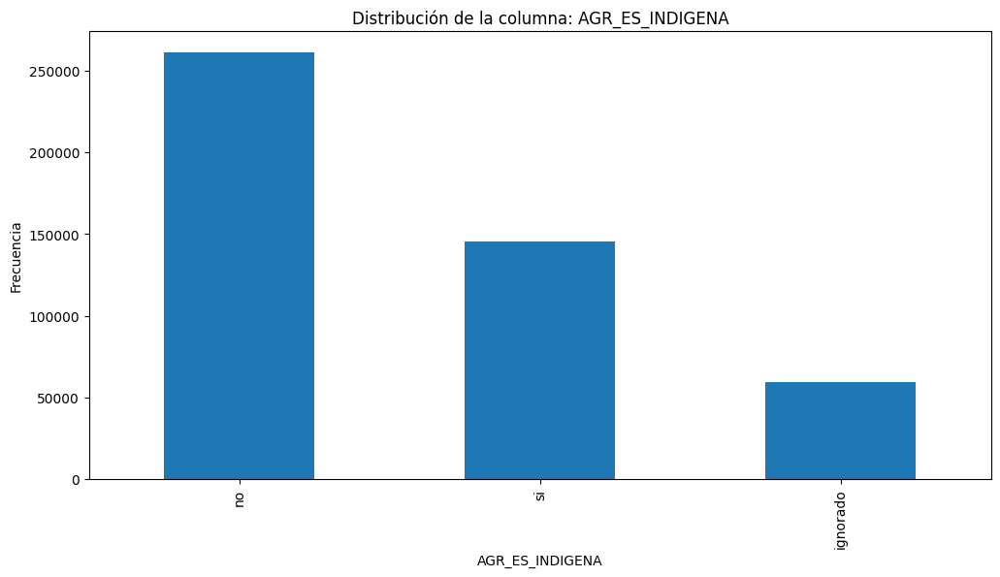

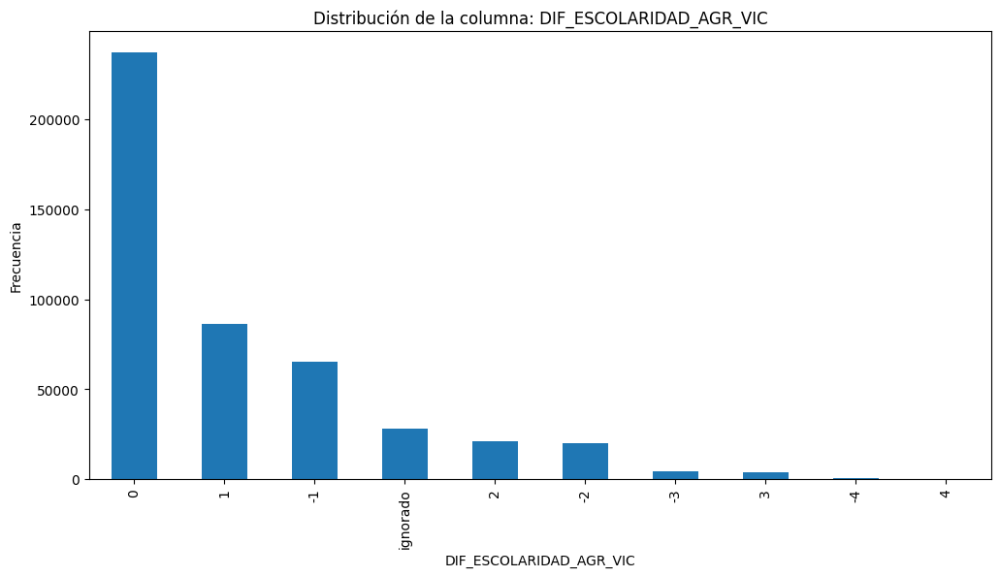

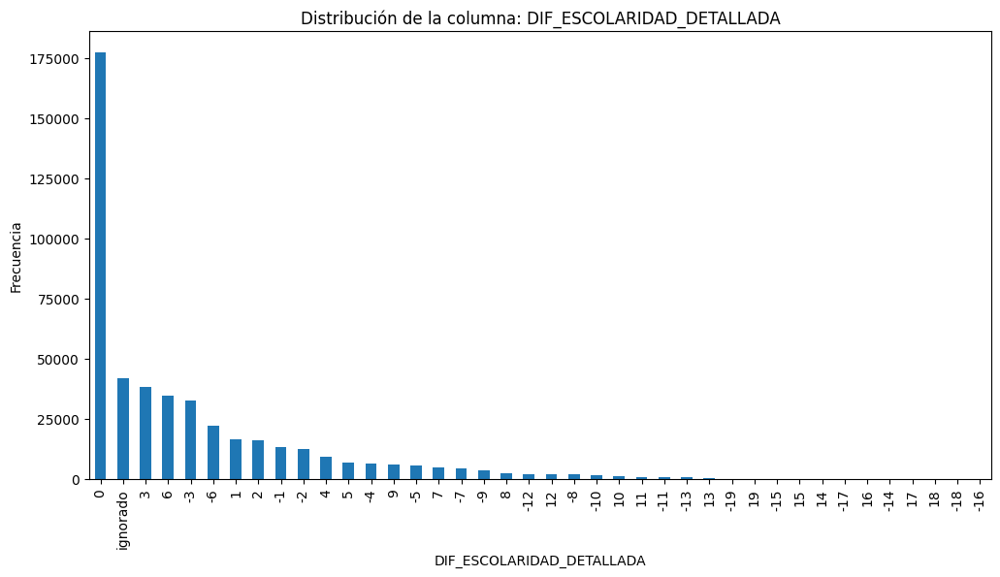

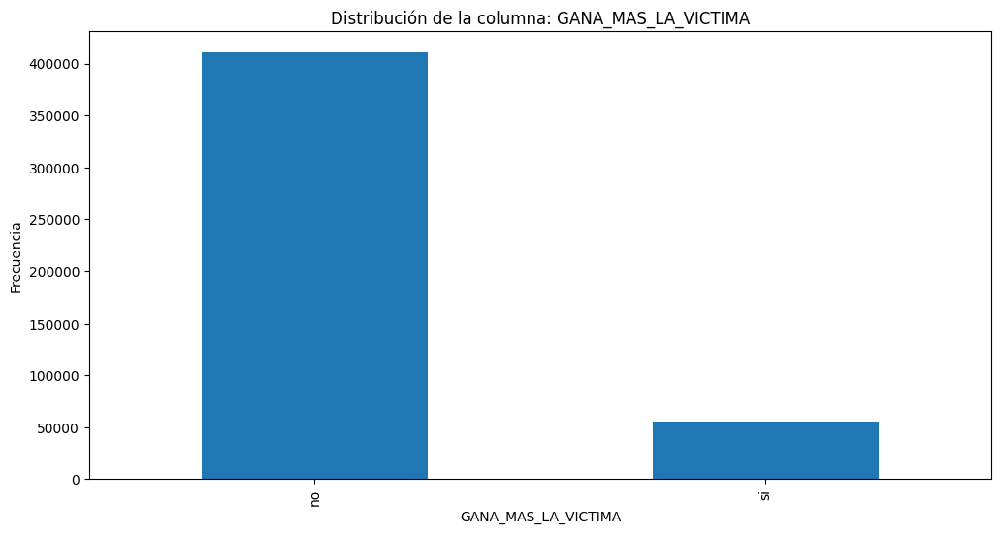

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\2551262076.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  figure = plt.figure(figsize=(12,6))


<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

In [40]:
generate_latex_figure = ""
for col in df.columns:
    figure = plt.figure(figsize=(12,6))
    frecuencia = 'Frecuencia'
    if re.search(r'_ENC', col)==None:
        if df[col].dtype == 'object':
            plt.title(f'Distribución de la columna: {col}')
            df[col].value_counts().plot(kind='bar')
            plt.xlabel(col)
            plt.ylabel('Frecuencia')
            plt.show()
        else:
            df_filtered = df[df[col] < 9999]
            x = df_filtered[col]
            plt.hist(df_filtered[col], bins=30, alpha=0.5, label='Víctimas', color='blue')
            plt.xlabel(col)
            plt.ylabel('Frecuencia')
            plt.title(f'Histograma de {col}')
            plt.show()
#     col2 = col.replace("_", "")
#     path = f'documento/plantilla/results_eda_img/distribuciones/{col2}_distribution.png'
#     path_2 = path.replace('documento/','')
#     generate_latex_figure += f'''
# \\begin{{figure}}[H]
#     \\centering
#     \\includegraphics[width=5in]{{{path_2}}}
#     \\caption{{{frecuencia} de la columna {col2}}}
#     \\label{{fig:frecuencia-{col2}}}
# \\end{{figure}}
    # '''
#     figure.savefig(path)
# open('documento/plantilla/results_eda_img/distribuciones/generated_latex_figures.tex', 'w').write(generate_latex_figure)
    

In [41]:
df[(df["VIC_EDAD"]<101) & (df["AGR_EDAD"]<101)]["VIC_EDAD"].value_counts()

VIC_EDAD
25.0    20347
30.0    20137
23.0    20128
28.0    19655
22.0    19500
24.0    19271
27.0    18711
26.0    18405
29.0    17911
32.0    17414
21.0    16574
20.0    16417
33.0    15669
35.0    14979
31.0    14952
34.0    14230
19.0    13808
38.0    12476
36.0    12465
37.0    12036
40.0    11431
39.0    10175
42.0     8824
43.0     7731
41.0     7370
45.0     6803
44.0     6065
46.0     4981
48.0     4951
47.0     4918
50.0     4440
49.0     3934
52.0     3344
51.0     2812
53.0     2756
54.0     2491
55.0     2414
56.0     1950
58.0     1881
57.0     1849
59.0     1510
Name: count, dtype: int64

No se observa ninguna tendencia a que la edad de la víctima sea directamente proporcional a la edad del agresor

### Escolaridad

In [42]:
df.select_dtypes(exclude=np.number).columns

Index(['AGR_ALFAB', 'AGR_ESCOLARIDAD', 'AGR_EST_CIV', 'AGR_GRUPET',
       'AGR_NACIONAL', 'AGR_SEXO', 'AGR_TRABAJA', 'DEPTO_MCPIO', 'HEC_AREA',
       'HEC_DEPTOMCPIO', 'HEC_MES', 'HEC_RECUR_DENUN', 'HEC_TIPAGRE',
       'INST_DENUN_HECHO', 'INST_DONDE_DENUNCIO', 'MES_EMISION',
       'QUIEN_REPORTA', 'TIPO_DISCAQ', 'VIC_ALFAB', 'VIC_DISC',
       'VIC_ESCOLARIDAD', 'VIC_EST_CIV', 'VIC_GRUPET', 'VIC_NACIONAL',
       'VIC_REL_AGR', 'VIC_SEXO', 'VIC_TRABAJA', 'DEPTO', 'HEC_DEPTO',
       'MEDIDAS_SEGURIDAD', 'ORGANISMO_JURISDICCIONAL', 'CONDUCENTE',
       'ORGANISMO_REMITE', 'LEY_APLICABLE', 'TIPO_MEDIDA', 'ARTICULOVIF',
       'ARTICULOCODPEN', 'ARTICULOTRAS', 'ARTICULOVCM', 'VIC_OFICIO',
       'AGR_OFICIO', 'CANTIDAD_HIJOS', 'CON_HIJ_HOM', 'CON_HIJ_MUJ',
       'VIC_RANGO_EDAD', 'AGR_RANGO_EDAD', 'VIC_NIV_ESCOLARIDAD',
       'AGR_NIV_ESCOLARIDAD', 'OTROS_AGRESORES', 'OTROS_AGRESORES_N_AS',
       'OTROS_AGRESORES_N_OS', 'OTROS_AGRESORES_MUJ', 'OTROS_AGRESORES_HOM',
       'VIC_OTR

VIC_NIV_ESCOLARIDAD
primaria         185476
ninguno           98358
diversificado     87767
basicos           67095
universidad       15538
ignorado          11788
Name: count, dtype: int64
VIC_NIV_ESCOLARIDAD
primaria         39.799838
ninguno          21.105871
diversificado    18.833231
basicos          14.397389
universidad       3.334177
ignorado          2.529494
Name: count, dtype: float64


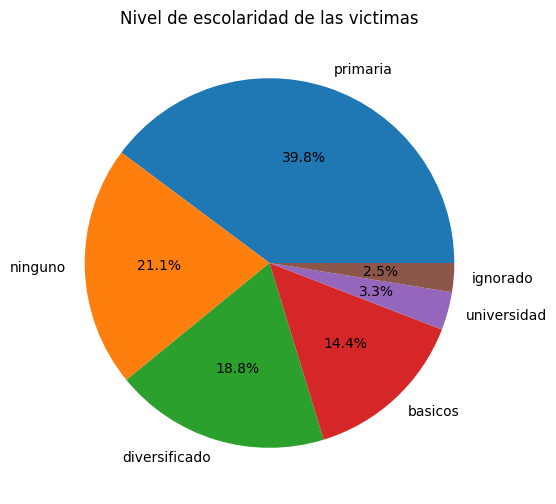

AGR_NIV_ESCOLARIDAD
primaria         197111
diversificado     82397
basicos           76861
ninguno           72425
ignorado          23996
universidad       13232
Name: count, dtype: int64
AGR_NIV_ESCOLARIDAD
primaria         42.296501
diversificado    17.680925
basicos          16.492998
ninguno          15.541112
ignorado          5.149113
universidad       2.839351
Name: count, dtype: float64


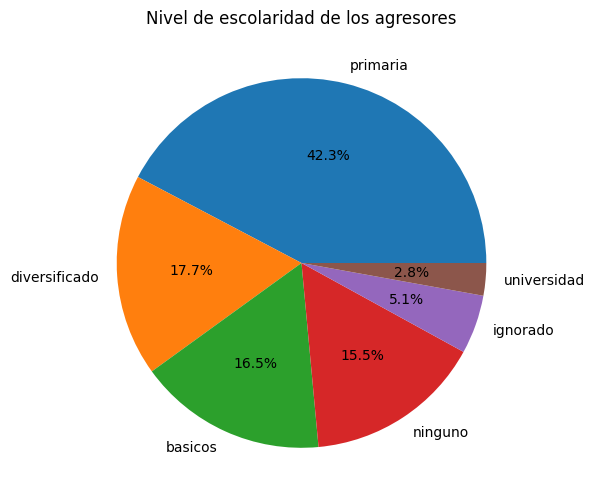

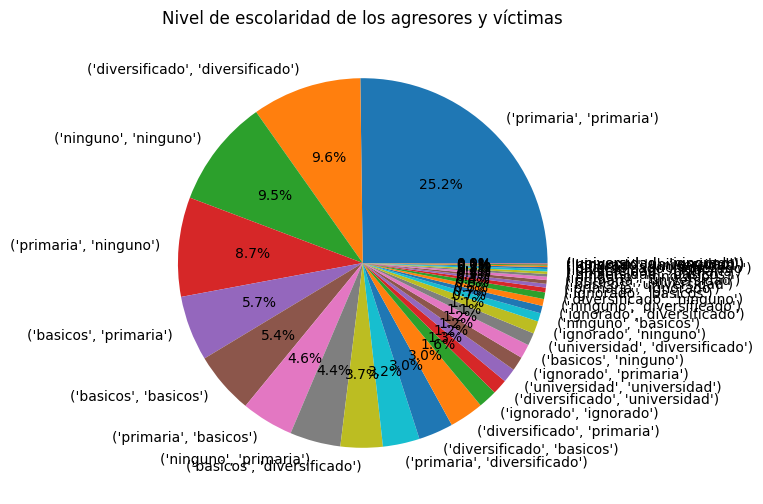

AGR_NIV_ESCOLARIDAD  basicos  diversificado  ignorado  ninguno  primaria  \
VIC_NIV_ESCOLARIDAD                                                        
basicos                25284          14172      1933     3434     21238   
diversificado          17164          44622      3034     2826     14986   
ignorado                 580            769      7645     1085      1546   
ninguno                 5763           2710      5128    44114     40485   
primaria               26562          14002      5764    20701    117483   
universidad             1508           6122       492      265      1373   

AGR_NIV_ESCOLARIDAD  universidad  
VIC_NIV_ESCOLARIDAD               
basicos                     1034  
diversificado               5135  
ignorado                     163  
ninguno                      158  
primaria                     964  
universidad                 5778  
AGR_NIV_ESCOLARIDAD   basicos  diversificado  ignorado   ninguno   primaria  \
VIC_NIV_ESCOLARIDAD             

In [43]:
print(df["VIC_NIV_ESCOLARIDAD"].value_counts())
print(df["VIC_NIV_ESCOLARIDAD"].value_counts()/df["VIC_NIV_ESCOLARIDAD"].shape[0]*100)
vic_niv_escolaridad = (df["VIC_NIV_ESCOLARIDAD"].value_counts()/df["VIC_NIV_ESCOLARIDAD"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Nivel de escolaridad de las victimas")
plt.show()
# Así mismo se observa que las víctimas suelen llegar mayoritariamente a primaria o a ningún nivel de escolaridad, así mismo le sigue diversificado y básicos.
# Esto demuestra que realmente las víctimas suelen ser personas muy poco preparadas.

print(df["AGR_NIV_ESCOLARIDAD"].value_counts())
print(df["AGR_NIV_ESCOLARIDAD"].value_counts()/df["AGR_NIV_ESCOLARIDAD"].shape[0]*100)
# En el caso de los agresores un 40% llega a primaria pero no pasan de allí
# Aunque le sigue diversificado por lo que están algo más preparados pero están por debajo del porcentaje de casos de las víctimas que están preparadas.
# Esto puede implicar que realmente la escolaridad no suele ser un factor tan clave al momento de ser agresor o víctima de violencia.
vic_niv_escolaridad = (df["AGR_NIV_ESCOLARIDAD"].value_counts()/df["AGR_NIV_ESCOLARIDAD"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Nivel de escolaridad de los agresores")
plt.show()


vic_niv_escolaridad = (df[["AGR_NIV_ESCOLARIDAD", "VIC_NIV_ESCOLARIDAD"]].value_counts()/df["AGR_NIV_ESCOLARIDAD"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Nivel de escolaridad de los agresores y víctimas")
plt.show()
# La mayoría de casos se dan entre los agresores y víctimas con un nivel de escolaridad bajo (ninguno, primaria)
print(pd.crosstab(df["VIC_NIV_ESCOLARIDAD"], df["AGR_NIV_ESCOLARIDAD"]))
print(pd.crosstab(df["VIC_NIV_ESCOLARIDAD"], df["AGR_NIV_ESCOLARIDAD"])/df.shape[0]*100)
# Contrario a lo que se podría pensar la mayoría de casos se dan cuándo están en un nivel similar de escolaridad y no cuándo existe una brecha.
# Esto se demuestra al momento de aplicar una matriz de identidad para saber cómo se concentran los casos
matriz = pd.crosstab(df["VIC_NIV_ESCOLARIDAD"], df["AGR_NIV_ESCOLARIDAD"]) / df.shape[0] * 100
matriz = matriz.reindex(index=matriz.columns, columns=matriz.columns, fill_value=0)
identidad = np.identity(len(matriz))
diagonal = matriz.values * identidad
solo_diagonal = pd.DataFrame(diagonal, index=matriz.index, columns=matriz.columns)
print(solo_diagonal)
# Y como se puede observar el más del 50% de los casos se concentran cuándo comparten el mismo nivel educativo lo que es realmente interesante.


## Cantidad de hijos de víctima

NUM_HIJ_HOM
1.0     146052
0.0     124206
2.0      76872
3.0      26416
4.0       9093
5.0       3286
6.0       1146
7.0        493
8.0        196
9.0         65
10.0        36
12.0        14
11.0         9
13.0         2
Name: count, dtype: int64
NUM_HIJ_MUJ
1.0     141351
0.0     136304
2.0      71917
3.0      25035
4.0       8311
5.0       3055
6.0       1195
7.0        469
8.0        184
9.0         50
10.0        21
11.0         3
12.0         1
13.0         1
Name: count, dtype: int64
TOTAL_HIJOS
2.0     103169
1.0     100997
3.0      69689
0.0      45530
4.0      33211
5.0      16788
6.0       8235
7.0       4614
8.0       2616
9.0       1378
10.0       802
11.0       410
12.0       268
13.0       103
14.0        37
15.0        24
16.0        11
17.0         3
18.0         1
Name: count, dtype: int64


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\2966392457.py:6: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([df[df["NUM_HIJ_HOM"]!=9999.0]["NUM_HIJ_HOM"], df[df["NUM_HIJ_MUJ"]!=9999.0]["NUM_HIJ_MUJ"], df[df["TOTAL_HIJOS"]!=9999.0]["TOTAL_HIJOS"] ], vert=False, labels=["Víctimas con hijos", "Víctimas con hijas", "Victimas con total de hijos"])


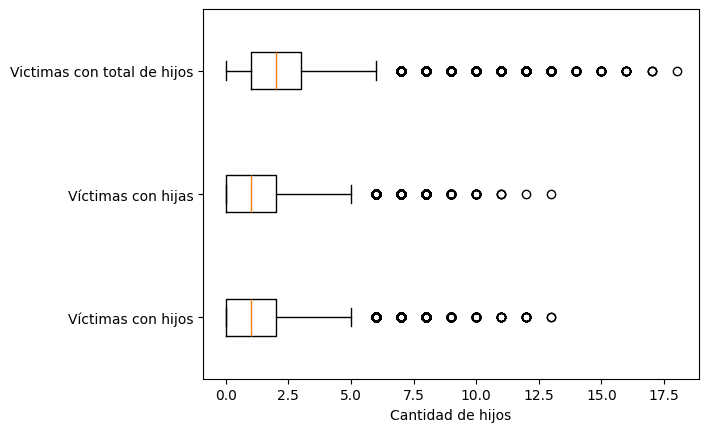

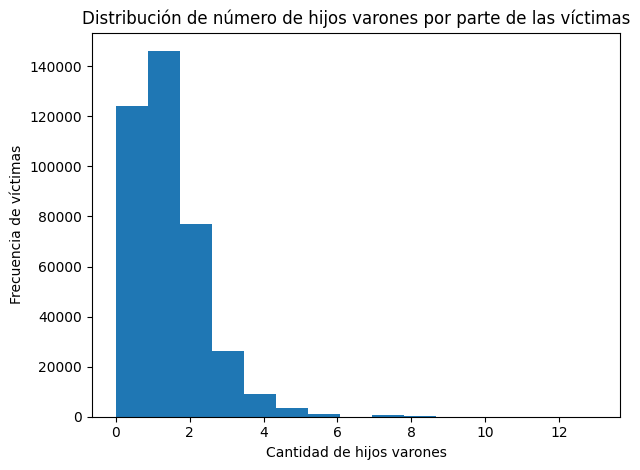

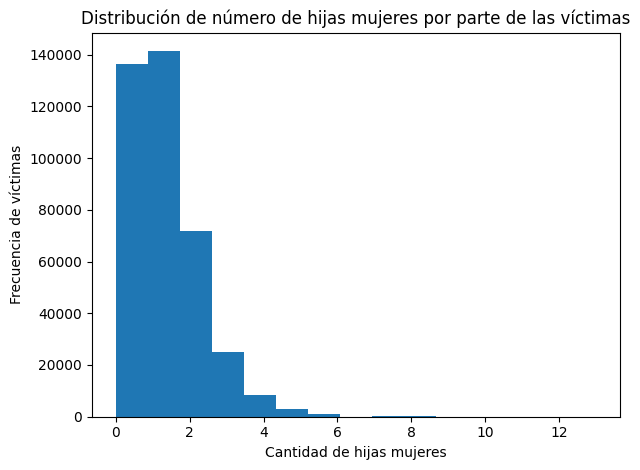

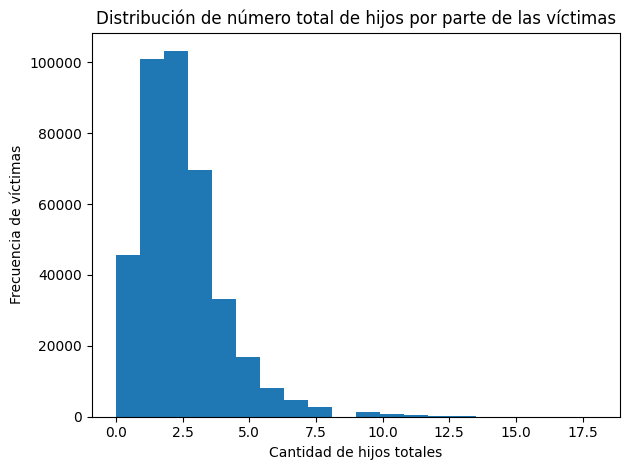

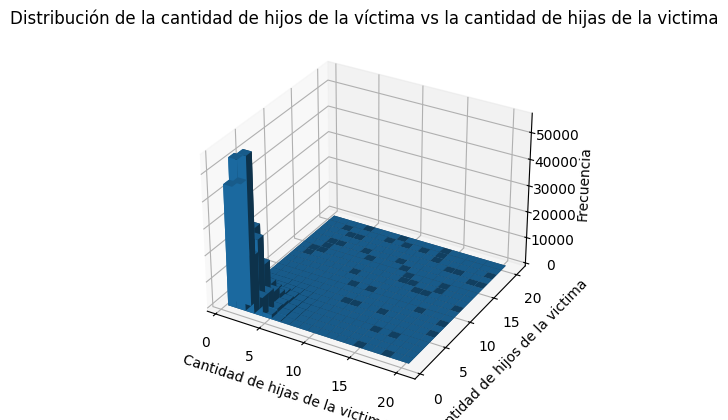

In [44]:
print(df[df["NUM_HIJ_HOM"]!=9999.0]["NUM_HIJ_HOM"].value_counts())
print(df[df["NUM_HIJ_MUJ"]!=9999.0]["NUM_HIJ_MUJ"].value_counts())
print(df[df["TOTAL_HIJOS"]!=9999.0]["TOTAL_HIJOS"].value_counts())


plt.boxplot([df[df["NUM_HIJ_HOM"]!=9999.0]["NUM_HIJ_HOM"], df[df["NUM_HIJ_MUJ"]!=9999.0]["NUM_HIJ_MUJ"], df[df["TOTAL_HIJOS"]!=9999.0]["TOTAL_HIJOS"] ], vert=False, labels=["Víctimas con hijos", "Víctimas con hijas", "Victimas con total de hijos"])
plt.xlabel('Cantidad de hijos')
plt.show()

fig, axs = plt.subplots(1, 1, sharey=True, tight_layout=True)

# We can set the number of bins with the *bins* keyword argument.
axs.hist(df[df["NUM_HIJ_HOM"]!=9999.0]["NUM_HIJ_HOM"], bins=15)
axs.set_title("Distribución de número de hijos varones por parte de las víctimas")
axs.set_ylabel("Frecuencia de víctimas")
axs.set_xlabel("Cantidad de hijos varones")
plt.show()
fig, axs = plt.subplots(1, 1, sharey=True, tight_layout=True)
axs.hist(df[df["NUM_HIJ_MUJ"]!=9999.0]["NUM_HIJ_MUJ"], bins=15)
axs.set_title("Distribución de número de hijas mujeres por parte de las víctimas")
axs.set_ylabel("Frecuencia de víctimas")
axs.set_xlabel("Cantidad de hijas mujeres")
plt.show()
fig, axs = plt.subplots(1, 1, sharey=True, tight_layout=True)
axs.hist(df[df["TOTAL_HIJOS"]!=9999.0]["TOTAL_HIJOS"], bins=20)
axs.set_title("Distribución de número total de hijos por parte de las víctimas")
axs.set_ylabel("Frecuencia de víctimas")
axs.set_xlabel("Cantidad de hijos totales")

plt.show()

# De los casos que se conoce la edad de ambos, realmente no se puede distinguir alguna tendencia o algo por el estilo
x = df[(df["NUM_HIJ_MUJ"] !=9999.0) & (df["NUM_HIJ_HOM"] !=9999.0)]["NUM_HIJ_MUJ"]
y = df[(df["NUM_HIJ_MUJ"] !=9999.0) & (df["NUM_HIJ_HOM"] !=9999.0)]["NUM_HIJ_HOM"]

fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# Use realistic range and bins
bins = 20  # adjust as needed for resolution
hist, xedges, yedges = np.histogram2d(x, y, bins=bins, range=[[0, 20], [0, 20]])

# Prepare positions
xpos, ypos = np.meshgrid(xedges[:-1] + (xedges[1] - xedges[0])/2,
                         yedges[:-1] + (yedges[1] - yedges[0])/2, indexing="ij")
xpos = xpos.ravel()
ypos = ypos.ravel()
zpos = np.zeros_like(xpos)

# Prepare bar sizes
dx = dy = (xedges[1] - xedges[0]) * np.ones_like(zpos)
dz = hist.ravel()

# Plot
ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
ax.set_title("Distribución de la cantidad de hijos de la víctima vs la cantidad de hijas de la victima")
ax.set_xlabel("Cantidad de hijas de la victima")
ax.set_ylabel("Cantidad de hijos de la victima")
ax.set_zlabel("Frecuencia")
plt.show()

# Se puede observar de que las víctimas disponen en su mayoría de hijos de ambos sexos, tanto varones como mujeres.
# Asimismo, se observa que la mayoría de los casos se dan con una cantidad de hijos media de alrededor de 2 hijos por sexo, mientras que en cantidad total aumenta la cantidad de hijos reportados.
# Finalmente se observa que la mayor cantidad de casos se dan cuando la víctima tiene un hijo ya sea mujer u hombre.

## Estado civil del agresor y de la víctima y la relación entre ambos

VIC_EST_CIV
casados(as)     202033
unidos(as)      117967
solteros(as)     72482
ignorado         62035
otro              9553
viudos(as)        1952
Name: count, dtype: int64
VIC_EST_CIV
casados(as)     43.352674
unidos(as)      25.313612
solteros(as)    15.553343
ignorado        13.311603
otro             2.049903
viudos(as)       0.418864
Name: count, dtype: float64
AGR_EST_CIV
casados(as)     202401
unidos(as)      118888
solteros(as)     68475
ignorado         65037
otro             10089
viudos(as)        1132
Name: count, dtype: int64
AGR_EST_CIV
casados(as)     43.431641
unidos(as)      25.511242
solteros(as)    14.693512
ignorado        13.955779
otro             2.164919
viudos(as)       0.242907
Name: count, dtype: float64
AGR_EST_CIV   casados(as)  ignorado  otro  solteros(as)  unidos(as)  \
VIC_EST_CIV                                                           
casados(as)        180792      3744   573         11058        5483   
ignorado             3552     54863   237  

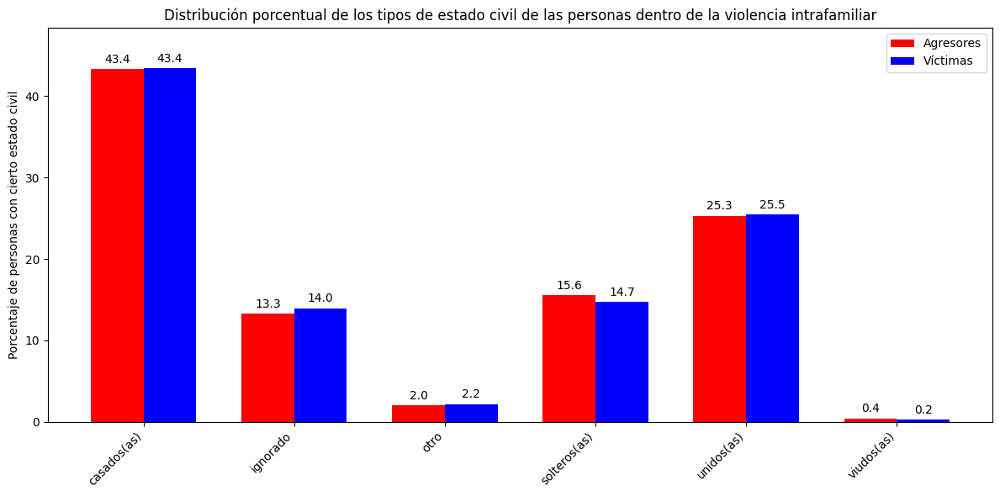

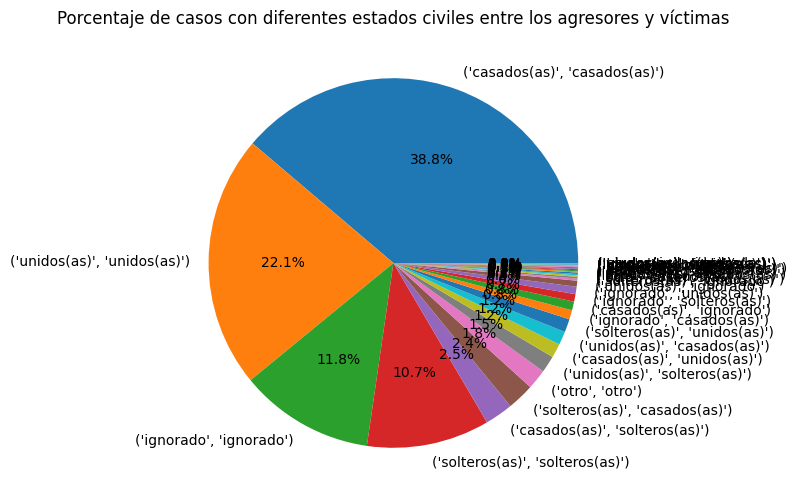

In [45]:
print(df["VIC_EST_CIV"].value_counts())
print(df["VIC_EST_CIV"].value_counts()/df["VIC_EST_CIV"].shape[0]*100)
# Aquí se observa que la mayoría de víctimas están casadas o unidas, sin embargo, eso no implica que sea con el agresor
print(df["AGR_EST_CIV"].value_counts())
print(df["AGR_EST_CIV"].value_counts()/df["AGR_EST_CIV"].shape[0]*100)
# Aquí se observa que la mayoría de agresores están casados o unidos, sin embargo, eso no implica que sea con la víctima
print(pd.crosstab(df["VIC_EST_CIV"], df["AGR_EST_CIV"]))
print(pd.crosstab(df["VIC_EST_CIV"], df["AGR_EST_CIV"])/df.shape[0]*100)
# En este caso se observa que mayormente se encuentran casados o unidos ambas personas, sin embargo, esto nos significa que estén unidos o casados el agresor y la víctima, si no que su estado civil coincide muchas veces.

# Cálculo de porcentajes por ocupación
oficio_agresores = (df["VIC_EST_CIV"].value_counts(normalize=True) * 100)
oficio_victimas = (df["AGR_EST_CIV"].value_counts(normalize=True) * 100)

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = sorted(set(oficio_agresores.index).union(oficio_victimas.index))

# Alineamos las series al índice común
oficio_agresores = oficio_agresores.reindex(ocupaciones, fill_value=0)
oficio_victimas = oficio_victimas.reindex(ocupaciones, fill_value=0)

# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))

# Barras
rects1 = ax.bar(x - width/2, oficio_agresores.values, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, oficio_victimas.values, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje de personas con cierto estado civil')
ax.set_title('Distribución porcentual de los tipos de estado civil de las personas dentro de la violencia intrafamiliar')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=45, ha='right')
ax.set_ylim(0, max(oficio_agresores.max(), oficio_victimas.max()) + 5)
ax.legend()

plt.tight_layout()
plt.show()
# La mayoría de los casos disponen de víctimas y agresores casadas

vic_niv_escolaridad = (df[["AGR_EST_CIV", "VIC_EST_CIV"]].value_counts()/df["AGR_EST_CIV"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes estados civiles entre los agresores y víctimas")
plt.show()
# La mayoría de casos se dan entre personas que disponen de un igual estado civil

In [46]:
df['VIC_EST_CIV'] = df['VIC_EST_CIV'].replace('viudos(as)', 'otro')
df['AGR_EST_CIV'] = df['AGR_EST_CIV'].replace('viudos(as)', 'otro')

VIC_EST_CIV
casados(as)     202033
unidos(as)      117967
solteros(as)     72482
ignorado         62035
otro             11505
Name: count, dtype: int64
VIC_EST_CIV
casados(as)     43.352674
unidos(as)      25.313612
solteros(as)    15.553343
ignorado        13.311603
otro             2.468768
Name: count, dtype: float64
AGR_EST_CIV
casados(as)     202401
unidos(as)      118888
solteros(as)     68475
ignorado         65037
otro             11221
Name: count, dtype: int64
AGR_EST_CIV
casados(as)     43.431641
unidos(as)      25.511242
solteros(as)    14.693512
ignorado        13.955779
otro             2.407826
Name: count, dtype: float64
AGR_EST_CIV   casados(as)  ignorado  otro  solteros(as)  unidos(as)
VIC_EST_CIV                                                        
casados(as)        180792      3744   956         11058        5483
ignorado             3552     54863   315           878        2427
otro                  904       361  8303          1038         899
solteros(as)  

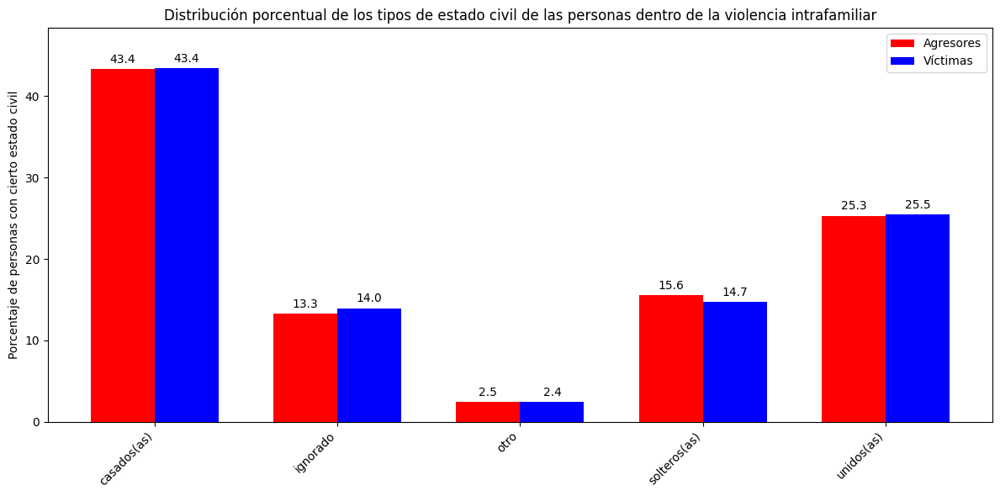

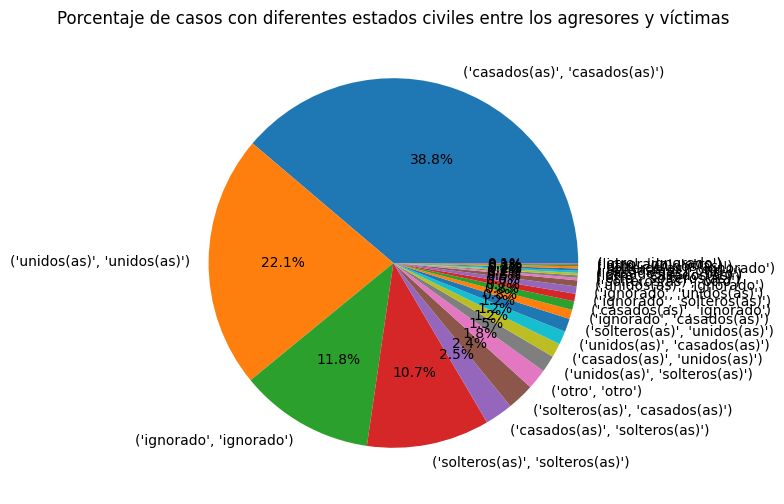

In [47]:
print(df["VIC_EST_CIV"].value_counts())
print(df["VIC_EST_CIV"].value_counts()/df["VIC_EST_CIV"].shape[0]*100)
# Aquí se observa que la mayoría de víctimas están casadas o unidas, sin embargo, eso no implica que sea con el agresor
print(df["AGR_EST_CIV"].value_counts())
print(df["AGR_EST_CIV"].value_counts()/df["AGR_EST_CIV"].shape[0]*100)
# Aquí se observa que la mayoría de agresores están casados o unidos, sin embargo, eso no implica que sea con la víctima
print(pd.crosstab(df["VIC_EST_CIV"], df["AGR_EST_CIV"]))
print(pd.crosstab(df["VIC_EST_CIV"], df["AGR_EST_CIV"])/df.shape[0]*100)
# En este caso se observa que mayormente se encuentran casados o unidos ambas personas, sin embargo, esto nos significa que estén unidos o casados el agresor y la víctima, si no que su estado civil coincide muchas veces.

# Cálculo de porcentajes por ocupación
oficio_agresores = (df["VIC_EST_CIV"].value_counts(normalize=True) * 100)
oficio_victimas = (df["AGR_EST_CIV"].value_counts(normalize=True) * 100)

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = sorted(set(oficio_agresores.index).union(oficio_victimas.index))

# Alineamos las series al índice común
oficio_agresores = oficio_agresores.reindex(ocupaciones, fill_value=0)
oficio_victimas = oficio_victimas.reindex(ocupaciones, fill_value=0)

# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))

# Barras
rects1 = ax.bar(x - width/2, oficio_agresores.values, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, oficio_victimas.values, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje de personas con cierto estado civil')
ax.set_title('Distribución porcentual de los tipos de estado civil de las personas dentro de la violencia intrafamiliar')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=45, ha='right')
ax.set_ylim(0, max(oficio_agresores.max(), oficio_victimas.max()) + 5)
ax.legend()

plt.tight_layout()
plt.show()
# La mayoría de los casos disponen de víctimas y agresores casadas

vic_niv_escolaridad = (df[["AGR_EST_CIV", "VIC_EST_CIV"]].value_counts()/df["AGR_EST_CIV"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes estados civiles entre los agresores y víctimas")
plt.show()
# La mayoría de casos se dan entre personas que disponen de un igual estado civil

VIC_REL_AGR
esposos(as)      165805
conviviente      148675
ex-conyuges       74080
otro pariente     36513
hermanos(as)      19392
padres/madres     10391
hijos(as)          5878
suegros(as)        4039
hijastros(as)       942
nietos(as)          307
Name: count, dtype: int64
VIC_REL_AGR
esposos(as)      35.578792
conviviente      31.903000
ex-conyuges      15.896245
otro pariente     7.835038
hermanos(as)      4.161177
padres/madres     2.229723
hijos(as)         1.261314
suegros(as)       0.866697
hijastros(as)     0.202136
nietos(as)        0.065877
Name: count, dtype: float64


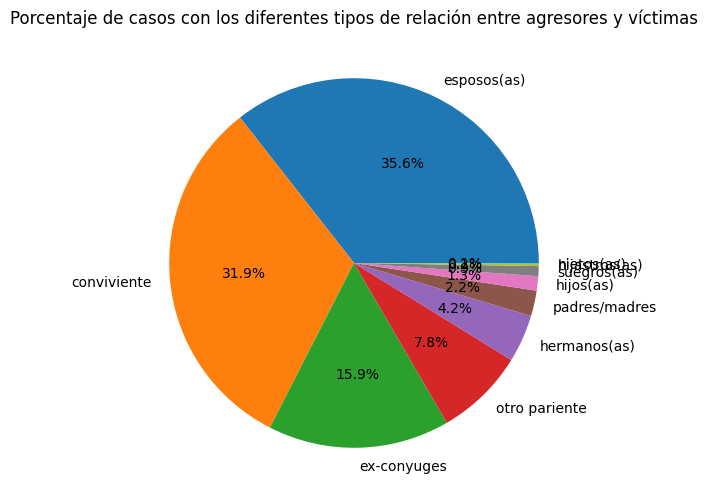

In [48]:
print(df["VIC_REL_AGR"].value_counts())
print(df["VIC_REL_AGR"].value_counts()/df.shape[0]*100)
# Se observa que la mayoría de casos se dan con personas que son o fueron parejas sentimentales y casi no se suele dar en otro tipo de relaciones.
# Sin embargo, este otro tipo de relaciones de caracter no sentimental, se supone, abarcan entre todos un 22% más un quinto de los casos por lo que no hay que hacer de menos.
# Primero porque la mayor cantidad de casos es con personas que conviven juntas pero que no están casadas.
# Luego están los casados.
# Y finalmente los que estuvieron casados en algún momento siguen aplicando cierto abuso, esto puede deberse a que estén divorciados pero por los hijos deben seguirse viendo.
vic_niv_escolaridad = (df["VIC_REL_AGR"].value_counts()/df["VIC_REL_AGR"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con los diferentes tipos de relación entre agresores y víctimas")
plt.show()


In [49]:
df['VIC_REL_AGR'] = df['VIC_REL_AGR'].replace('otro pariente', 'otros').replace('hermanos(as)', 'otros').replace('padres/madres', 'otros').replace('hijos(as)', 'otros').replace('suegros(as)', 'otros').replace('nietos(as)', 'otros').replace('hijastros(as)', 'otros')

VIC_REL_AGR
esposos(as)    165805
conviviente    148675
otros           77462
ex-conyuges     74080
Name: count, dtype: int64
VIC_REL_AGR
esposos(as)    35.578792
conviviente    31.903000
otros          16.621962
ex-conyuges    15.896245
Name: count, dtype: float64


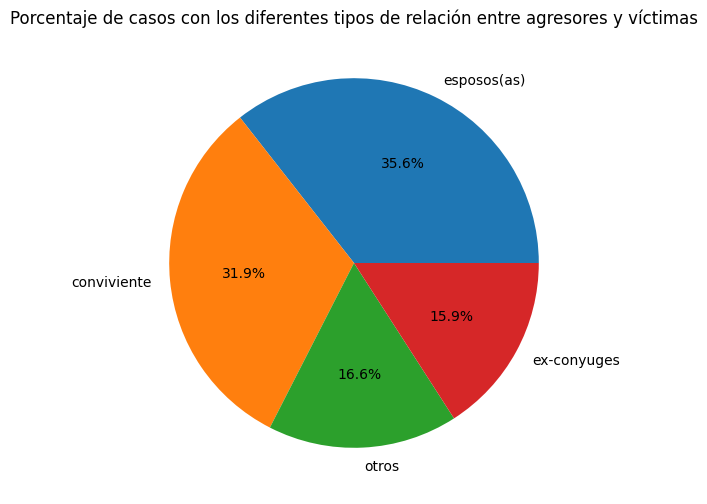

In [50]:
print(df["VIC_REL_AGR"].value_counts())
print(df["VIC_REL_AGR"].value_counts()/df.shape[0]*100)
# Se observa que la mayoría de casos se dan con personas que son o fueron parejas sentimentales y casi no se suele dar en otro tipo de relaciones.
# Sin embargo, este otro tipo de relaciones de caracter no sentimental, se supone, abarcan entre todos un 22% más un quinto de los casos por lo que no hay que hacer de menos.
# Primero porque la mayor cantidad de casos es con personas que conviven juntas pero que no están casadas.
# Luego están los casados.
# Y finalmente los que estuvieron casados en algún momento siguen aplicando cierto abuso, esto puede deberse a que estén divorciados pero por los hijos deben seguirse viendo.
vic_niv_escolaridad = (df["VIC_REL_AGR"].value_counts()/df["VIC_REL_AGR"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con los diferentes tipos de relación entre agresores y víctimas")
plt.show()


VIC_REL_AGR   conviviente  esposos(as)  ex-conyuges  otros
VIC_EST_CIV                                               
casados(as)          6310       159943         6974  28806
ignorado            27193          842        30349   3651
otro                  264           60         8305   2876
solteros(as)        23111         1933        17240  30198
unidos(as)          91797         3027        11212  11931
VIC_REL_AGR   conviviente  esposos(as)  ex-conyuges     otros
VIC_EST_CIV                                                  
casados(as)      1.354013    34.320912     1.496496  6.181253
ignorado         5.835132     0.180678     6.512353  0.783439
otro             0.056650     0.012875     1.782105  0.617138
solteros(as)     4.959208     0.414787     3.699396  6.479952
unidos(as)      19.697997     0.649540     2.405895  2.560180
VIC_REL_AGR   conviviente  esposos(as)  ex-conyuges  otros
AGR_EST_CIV                                               
casados(as)          7976       161

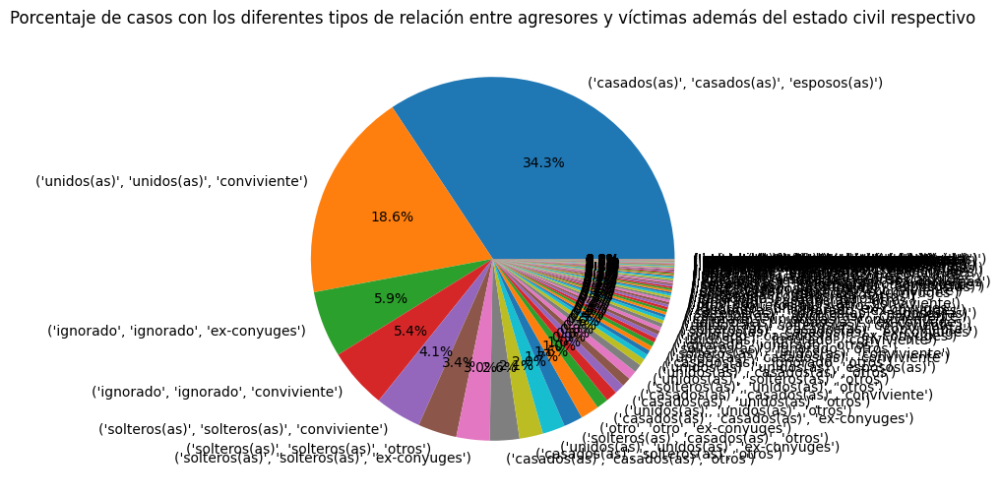

In [51]:
print(pd.crosstab(df["VIC_EST_CIV"], df["VIC_REL_AGR"]))
print(pd.crosstab(df["VIC_EST_CIV"], df["VIC_REL_AGR"])/df.shape[0]*100)
# La violencia intrafamiliar sobretodo se da cuándo la relación entre la víctima y agresor es de esposos
# Así mismo, se observa que cuando conviven juntos a pesar del estado civil sea que esté casado no con el agresor sigue siendo realmente problemático para la persona.
# Se sugeriría contacto 0.
print(pd.crosstab(df["AGR_EST_CIV"], df["VIC_REL_AGR"]))
print(pd.crosstab(df["AGR_EST_CIV"], df["VIC_REL_AGR"])/df.shape[0]*100)
# Se observan los mismos resultados en esta comparativa.
vic_niv_escolaridad = (df[["VIC_EST_CIV","AGR_EST_CIV","VIC_REL_AGR"]].value_counts()/df["VIC_REL_AGR"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con los diferentes tipos de relación entre agresores y víctimas además del estado civil respectivo")
plt.show()

# Se puede observar que la mayoría de casos se dan entre esposos, unidos,y en general de personas que tienen una relación amorosa

### Etnia y nacionalidad del agresor y de la víctima

VIC_GRUPET
ladinos(as)    266251
maya           139490
no indica       48604
ignorado         7375
otro             3030
garifuna          656
xinka             616
Name: count, dtype: int64
VIC_GRUPET
ladinos(as)    57.132710
maya           29.932063
no indica      10.429551
ignorado        1.582543
otro            0.650184
garifuna        0.140766
xinka           0.132183
Name: count, dtype: float64
AGR_GRUPET
ladinos(as)    261207
maya           141320
no indica       50157
ignorado         8953
otro             2921
xinka             775
garifuna          689
Name: count, dtype: int64
AGR_GRUPET
ladinos(as)    56.050358
maya           30.324749
no indica      10.762797
ignorado        1.921154
otro            0.626794
xinka           0.166301
garifuna        0.147847
Name: count, dtype: float64
AGR_GRUPET   garifuna  ignorado  ladinos(as)    maya  no indica  otro  xinka
VIC_GRUPET                                                                  
garifuna          318         9     

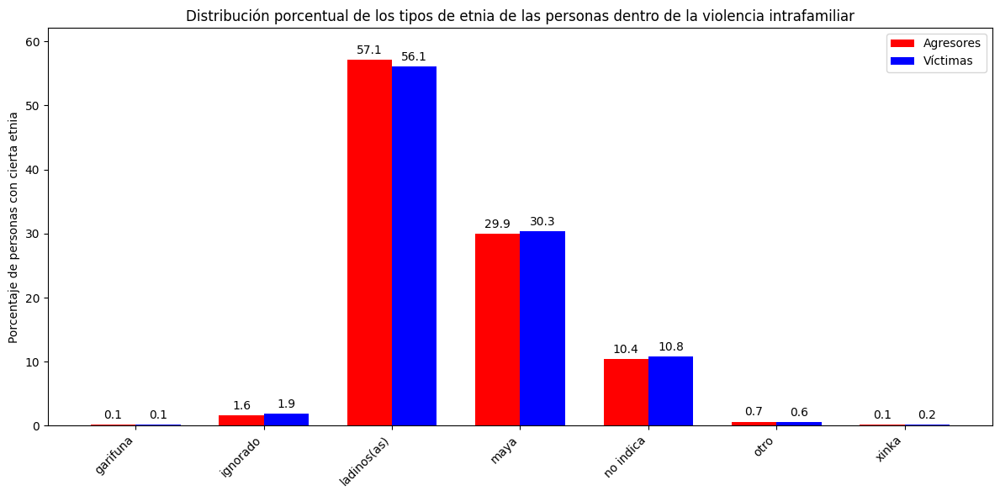

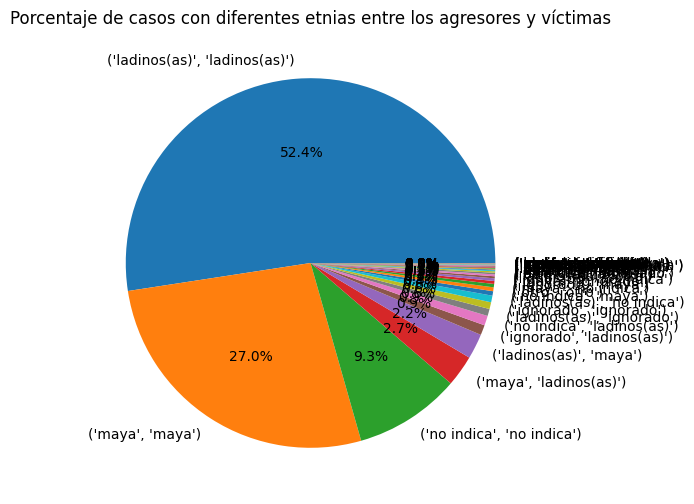

In [52]:
print(df["VIC_GRUPET"].value_counts())
print(df["VIC_GRUPET"].value_counts()/df.shape[0]*100)
# Se observa que la etnia latina suele ser la más afectada, probablemente porque es la mayoría de la etnia en Guatemala, así mismo, le sigue la maya, 
# muchos prefieren no decir cuál es su etnia, otros ignoran cuál es su etnia, para después otra etnia, garifuna o xinka.
print(df["AGR_GRUPET"].value_counts())
print(df["AGR_GRUPET"].value_counts()/df.shape[0]*100)
# A su vez la proporción de los agresores igual suele darse en la etnia mayoritaria, ladina, y en la maya así mismo se observa distribuciones similares para los demás.
# Cálculo de porcentajes por ocupación

print(pd.crosstab(df["VIC_GRUPET"], df["AGR_GRUPET"]))
print(pd.crosstab(df["VIC_GRUPET"], df["AGR_GRUPET"])/df.shape[0]*100)
# Se observa que la mayoría de casos reportados se dan cuando pertenecen a la misma etnia, ya que los ladinos con ladinos son un 52% mientras que cuando es ladino con maya baja a tan solo un 2%.
# Esto podría implicar que la diversidad ayuda a que no se den casos de violencia en el hogar.
# Esto se demuestra al momento de aplicar una matriz de identidad para saber cómo se concentran los casos
matriz = pd.crosstab(df["VIC_GRUPET"], df["VIC_GRUPET"]) / df.shape[0] * 100
matriz = matriz.reindex(index=matriz.columns, columns=matriz.columns, fill_value=0)
identidad = np.identity(len(matriz))
diagonal = matriz.values * identidad
solo_diagonal = pd.DataFrame(diagonal, index=matriz.index, columns=matriz.columns)
print(solo_diagonal)
# Esto a su vez refuerza el hecho de que mientras más diversidad menores son las chances que surja la violencia intrafamiliar ya que se concentra más del 99% de los casos cuando pertenecen al mismo grupo. 
oficio_agresores = (df["VIC_GRUPET"].value_counts(normalize=True) * 100)
oficio_victimas = (df["AGR_GRUPET"].value_counts(normalize=True) * 100)

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = sorted(set(oficio_agresores.index).union(oficio_victimas.index))

# Alineamos las series al índice común
oficio_agresores = oficio_agresores.reindex(ocupaciones, fill_value=0)
oficio_victimas = oficio_victimas.reindex(ocupaciones, fill_value=0)

# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))

# Barras
rects1 = ax.bar(x - width/2, oficio_agresores.values, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, oficio_victimas.values, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje de personas con cierta etnia')
ax.set_title('Distribución porcentual de los tipos de etnia de las personas dentro de la violencia intrafamiliar')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=45, ha='right')
ax.set_ylim(0, max(oficio_agresores.max(), oficio_victimas.max()) + 5)
ax.legend()

plt.tight_layout()
plt.show()
# La mayoría de los casos disponen de víctimas y agresores que son ladinos

vic_niv_escolaridad = (df[["AGR_GRUPET", "VIC_GRUPET"]].value_counts()/df["AGR_GRUPET"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes etnias entre los agresores y víctimas")
plt.show()
# La mayoría de casos se dan entre personas que son ladinos o mayas

AGR_ES_INDIGENA  ignorado      no      si
VIC_ES_INDIGENA                          
ignorado            47478    5585    2916
no                   8060  244310   13881
si                   3572   11312  128908
AGR_ES_INDIGENA   ignorado         no         si
VIC_ES_INDIGENA                                 
ignorado         10.187931   1.198441   0.625722
no                1.729532  52.424564   2.978615
si                0.766487   2.427353  27.661355
VIC_ES_INDIGENA   ignorado        no         si
VIC_ES_INDIGENA                                
ignorado         12.012094   0.00000   0.000000
no                0.000000  57.13271   0.000000
si                0.000000   0.00000  30.855196


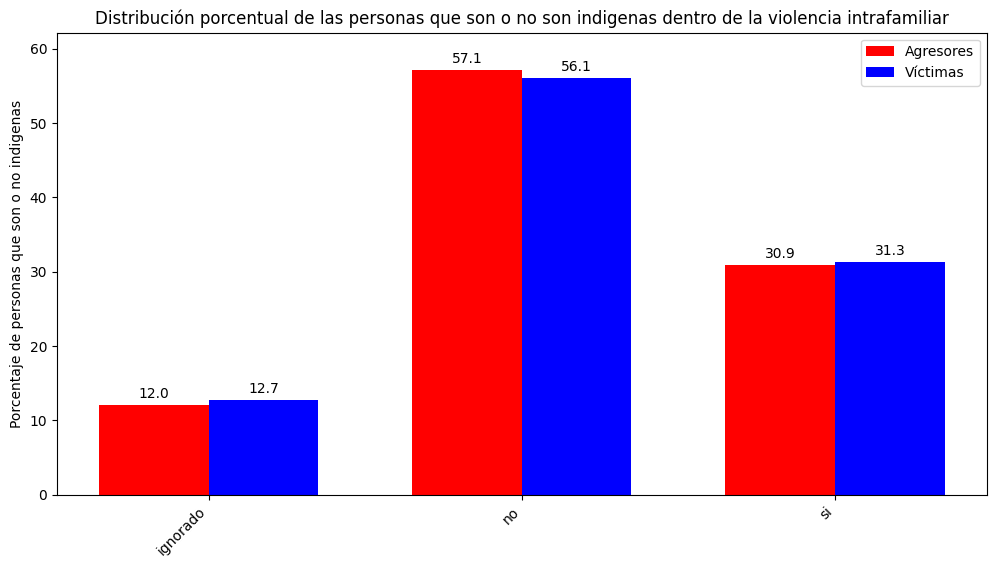

In [53]:
print(pd.crosstab(df["VIC_ES_INDIGENA"], df["AGR_ES_INDIGENA"]))
print(pd.crosstab(df["VIC_ES_INDIGENA"], df["AGR_ES_INDIGENA"])/df.shape[0]*100)
# Se observa que la mayoría de casos reportados se dan cuando pertenecen a la misma etnia, ya que los ladinos con ladinos son un 52% mientras que cuando es ladino con maya baja a tan solo un 2%.
# Esto podría implicar que la diversidad ayuda a que no se den casos de violencia en el hogar.
# Esto se demuestra al momento de aplicar una matriz de identidad para saber cómo se concentran los casos
matriz = pd.crosstab(df["VIC_ES_INDIGENA"], df["VIC_ES_INDIGENA"]) / df.shape[0] * 100
matriz = matriz.reindex(index=matriz.columns, columns=matriz.columns, fill_value=0)
identidad = np.identity(len(matriz))
diagonal = matriz.values * identidad
solo_diagonal = pd.DataFrame(diagonal, index=matriz.index, columns=matriz.columns)
print(solo_diagonal)
# Esto a su vez refuerza el hecho de que mientras más diversidad menores son las chances que surja la violencia intrafamiliar ya que se concentra más del 99% de los casos cuando pertenecen al mismo grupo. 
# Esto a su vez refuerza el hecho de que mientras más diversidad menores son las chances que surja la violencia intrafamiliar ya que se concentra más del 99% de los casos cuando pertenecen al mismo grupo. 
oficio_agresores = (df["VIC_ES_INDIGENA"].value_counts(normalize=True) * 100)
oficio_victimas = (df["AGR_ES_INDIGENA"].value_counts(normalize=True) * 100)

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = sorted(set(oficio_agresores.index).union(oficio_victimas.index))

# Alineamos las series al índice común
oficio_agresores = oficio_agresores.reindex(ocupaciones, fill_value=0)
oficio_victimas = oficio_victimas.reindex(ocupaciones, fill_value=0)

# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))

# Barras
rects1 = ax.bar(x - width/2, oficio_agresores.values, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, oficio_victimas.values, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje de personas que son o no indigenas')
ax.set_title('Distribución porcentual de las personas que son o no son indigenas dentro de la violencia intrafamiliar')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=45, ha='right')
ax.set_ylim(0, max(oficio_agresores.max(), oficio_victimas.max()) + 5)
ax.legend()
# A pesar de que la mayoría de casos son de personas que no son indígenas, la étnia indígena en total representa un 30% lo que es bastante

VIC_NACIONAL
guatemalteca    458901
ignorado          3933
extranjera        3188
Name: count, dtype: int64
VIC_NACIONAL
guatemalteca    98.471961
ignorado         0.843952
extranjera       0.684088
Name: count, dtype: float64
AGR_NACIONAL
guatemalteca    446461
ignorado         17524
extranjera        2037
Name: count, dtype: int64
AGR_NACIONAL
guatemalteca    95.802559
ignorado         3.760337
extranjera       0.437104
Name: count, dtype: float64
AGR_NACIONAL  extranjera  guatemalteca  ignorado
VIC_NACIONAL                                    
extranjera           325          2684       179
guatemalteca        1682        441136     16083
ignorado              30          2641      1262
AGR_NACIONAL  extranjera  guatemalteca  ignorado
VIC_NACIONAL                                    
extranjera      0.069739      0.575938  0.038410
guatemalteca    0.360927     94.659909  3.451125
ignorado        0.006437      0.566711  0.270803
VIC_NACIONAL  extranjera  guatemalteca  ignorado
VIC_GRU

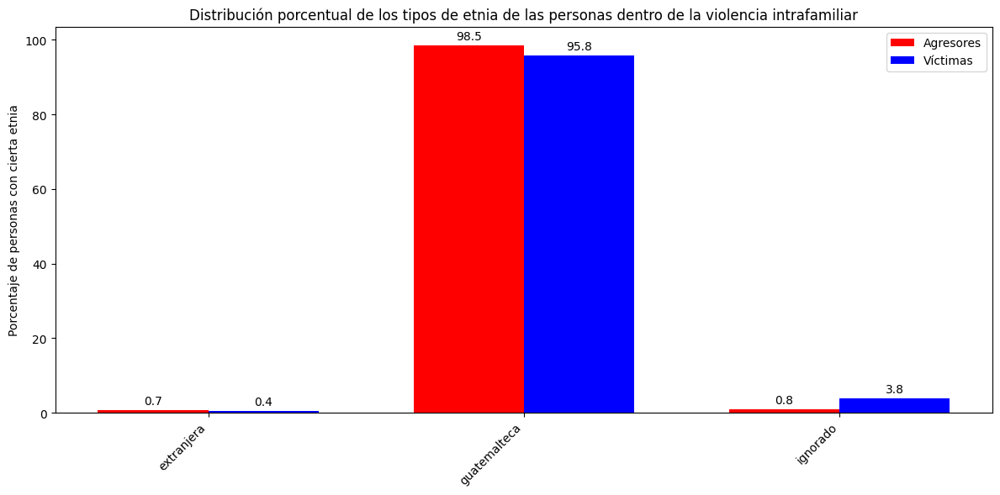

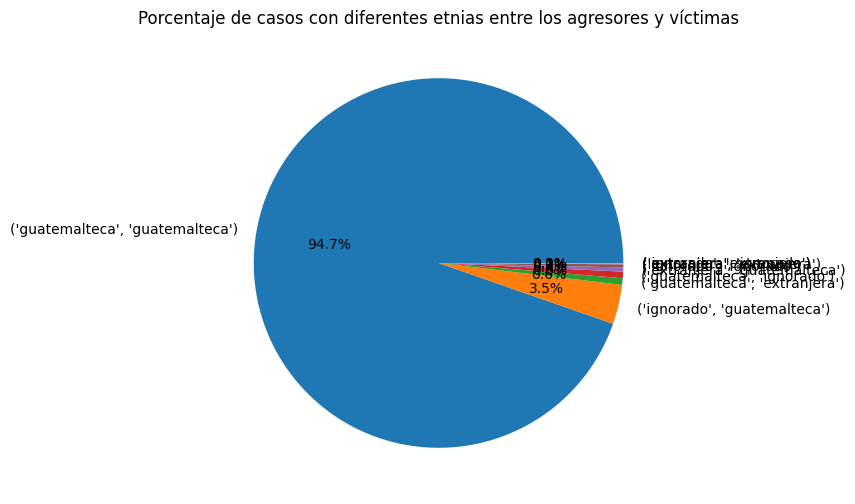

In [54]:
print(df["VIC_NACIONAL"].value_counts())
print(df["VIC_NACIONAL"].value_counts()/df.shape[0]*100)
# Dado que es territorio guatemalteco pues la mayoría de casos resportados son de guatemaltecos.
# Esto a su vez refuerza el hecho de que mientras más diversidad menores son las chances que surja la violencia intrafamiliar ya que se concentra más del 99% de los casos cuando pertenecen al mismo grupo. 

print(df["AGR_NACIONAL"].value_counts())
print(df["AGR_NACIONAL"].value_counts()/df.shape[0]*100)
# Dado que es territorio guatemalteco pues la mayoría de casos resportados son de guatemaltecos.
print(pd.crosstab(df["VIC_NACIONAL"], df["AGR_NACIONAL"]))
print(pd.crosstab(df["VIC_NACIONAL"], df["AGR_NACIONAL"])/df.shape[0]*100)
# Y pues la mayoría de casos se dan entre guatemaltecos, aunque hay varios casos dónde se ignora la nacionalidad de los implicados
print(pd.crosstab(df["VIC_GRUPET"], df["VIC_NACIONAL"]))
print(pd.crosstab(df["VIC_GRUPET"], df["VIC_NACIONAL"])/df.shape[0]*100)
print(pd.crosstab(df["AGR_GRUPET"], df["AGR_NACIONAL"]))
print(pd.crosstab(df["AGR_GRUPET"], df["AGR_NACIONAL"])/df.shape[0]*100)
# Así mismo, las personas sí suelen reportar bien su nacionalidad ya que el 98% de las personas que pertenece a una etnia nativa afirma ser guatemaltecos.
oficio_agresores = (df["VIC_NACIONAL"].value_counts(normalize=True) * 100)
oficio_victimas = (df["AGR_NACIONAL"].value_counts(normalize=True) * 100)

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = sorted(set(oficio_agresores.index).union(oficio_victimas.index))

# Alineamos las series al índice común
oficio_agresores = oficio_agresores.reindex(ocupaciones, fill_value=0)
oficio_victimas = oficio_victimas.reindex(ocupaciones, fill_value=0)

# Datos para graficar
x = np.arange(len(ocupaciones))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))

# Barras
rects1 = ax.bar(x - width/2, oficio_agresores.values, width, label='Agresores', color='red')
rects2 = ax.bar(x + width/2, oficio_victimas.values, width, label='Víctimas', color='blue')

# Etiquetas
ax.bar_label(rects1, padding=3, fmt='%.1f')
ax.bar_label(rects2, padding=3, fmt='%.1f')

# Configuración
ax.set_ylabel('Porcentaje de personas con cierta etnia')
ax.set_title('Distribución porcentual de los tipos de etnia de las personas dentro de la violencia intrafamiliar')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones, rotation=45, ha='right')
ax.set_ylim(0, max(oficio_agresores.max(), oficio_victimas.max()) + 5)
ax.legend()

plt.tight_layout()
plt.show()
# La mayoría de los casos disponen de víctimas y agresores que son ladinos

vic_niv_escolaridad = (df[["AGR_NACIONAL", "VIC_NACIONAL"]].value_counts()/df["AGR_NACIONAL"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes etnias entre los agresores y víctimas")
plt.show()
# Obviamente casi todos los casos se dan con personas que son guatemaltecas.

### Discapacidad en las víctimas

In [55]:
df.select_dtypes(include=[np.number]).columns

Index(['AGR_EDAD', 'ANO_EMISION', 'DIA_EMISION', 'HEC_ANO', 'HEC_DIA',
       'NUM_HIJ_HOM', 'NUM_HIJ_MUJ', 'OTRAS_VICTIMAS', 'TOTAL_HIJOS',
       'VIC_EDAD',
       ...
       'QUIEN_ES_MAYOR_ENC', 'DIF_ALFAB_ENC', 'DIF_TIEMPO_REGISTRO_HECHO_ENC',
       'DIF_SEXO_ENC', 'DIF_GRUPET_ENC', 'VIC_ES_INDIGENA_ENC',
       'AGR_ES_INDIGENA_ENC', 'DIF_ESCOLARIDAD_AGR_VIC_ENC',
       'DIF_ESCOLARIDAD_DETALLADA_ENC', 'GANA_MAS_LA_VICTIMA_ENC'],
      dtype='object', length=128)

TIPO_DISCAQ
no aplica                                                439114
ignorado                                                  25189
otra discapacidad                                           526
sordera                                                     434
ceguera                                                     336
perdida o discapacidad de las extremidades inferiores       189
perdida o discapacidad de las extremidades superiores       179
deficiencia mental                                           55
Name: count, dtype: int64
TIPO_DISCAQ
no aplica                                                94.226024
ignorado                                                  5.405110
otra discapacidad                                         0.112870
sordera                                                   0.093129
ceguera                                                   0.072100
perdida o discapacidad de las extremidades inferiores     0.040556
perdida o discapacidad de las extrem

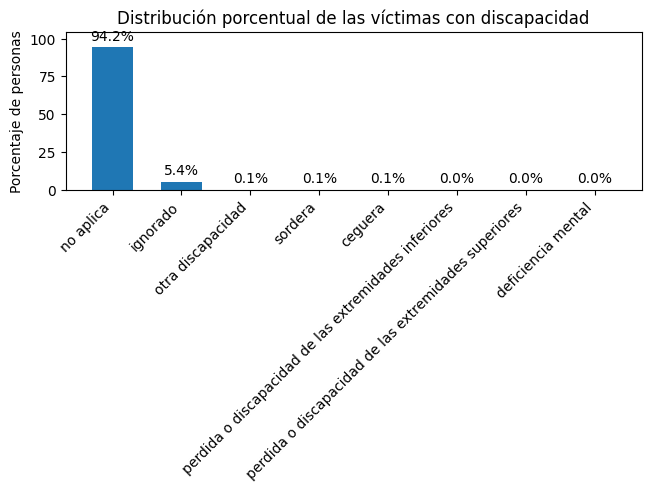

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3692611510.py:27: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plt.boxplot([df[df["TIPO_DISCAQ"]==tipo_discapacidad][df["VIC_EDAD"]!=9999.0]["VIC_EDAD"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3692611510.py:27: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plt.boxplot([df[df["TIPO_DISCAQ"]==tipo_discapacidad][df["VIC_EDAD"]!=9999.0]["VIC_EDAD"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3692611510.py:27: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plt.boxplot([df[df["TIPO_DISCAQ"]==tipo_discapacidad][df["VIC_EDAD"]!=9999.0]["VIC_EDAD"] 

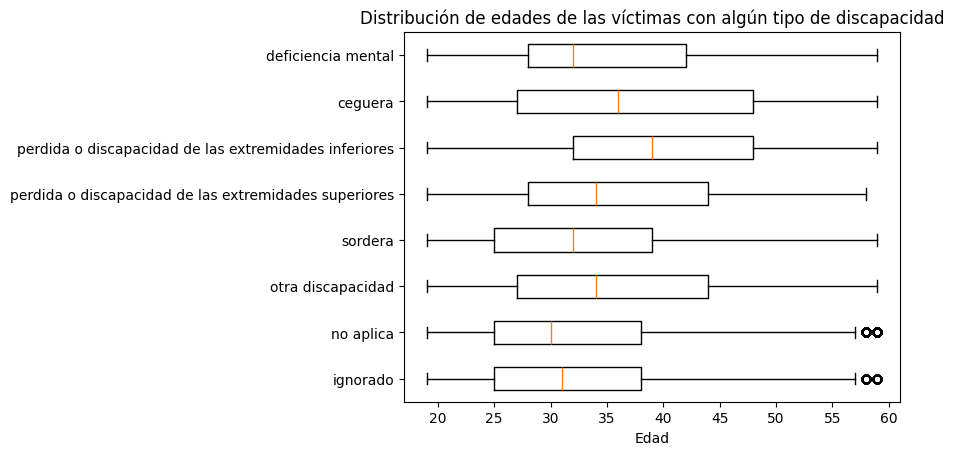

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3692611510.py:32: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([df[(df["TIPO_DISCAQ"]==tipo_discapacidad) & (df["TOTAL_HIJOS"]!=9999.0)]["TOTAL_HIJOS"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])


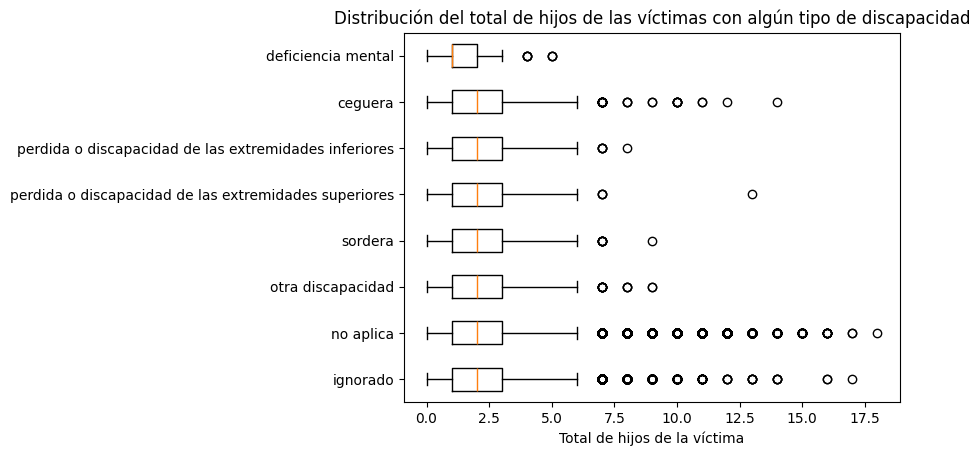

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3692611510.py:37: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([df[(df["TIPO_DISCAQ"]==tipo_discapacidad) & (df["NUM_HIJ_HOM"]!=9999.0)]["NUM_HIJ_HOM"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])


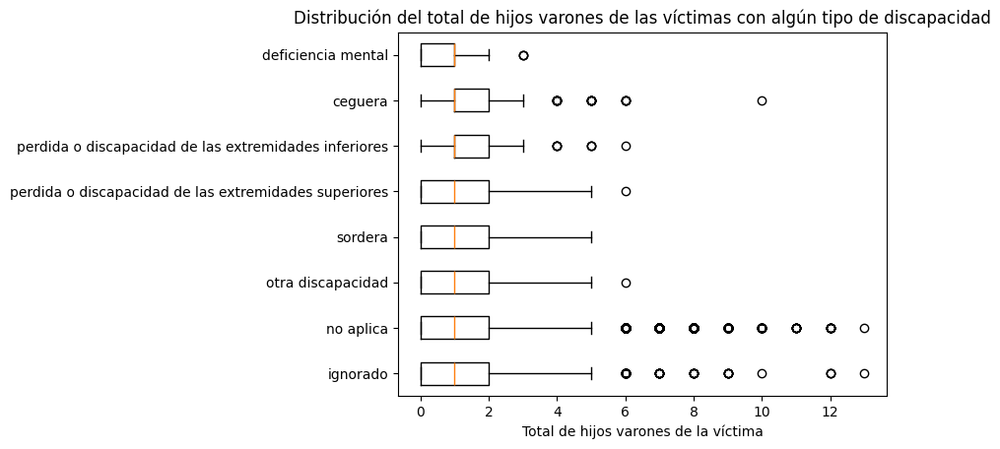

C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3692611510.py:42: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([df[(df["TIPO_DISCAQ"]==tipo_discapacidad) & (df["NUM_HIJ_MUJ"]!=9999.0)]["NUM_HIJ_MUJ"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])


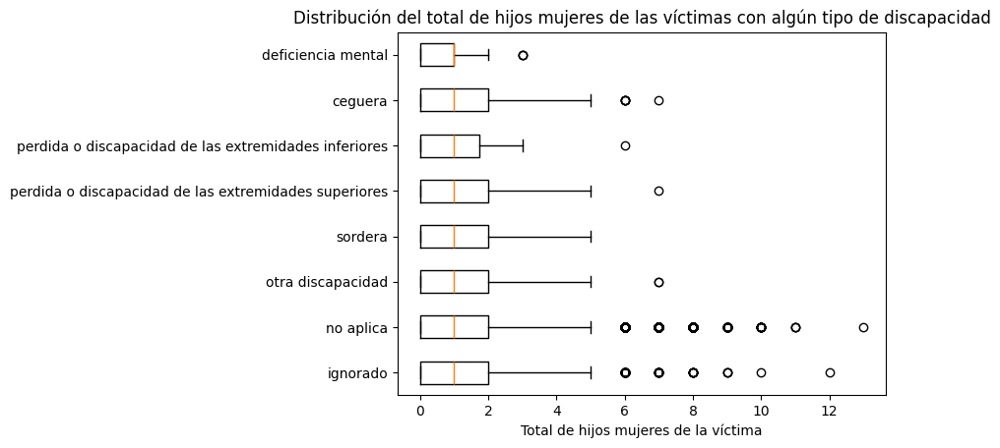

TOTAL_HIJOS
2.0       103169
1.0       100997
9999.0     78136
3.0        69689
0.0        45530
4.0        33211
5.0        16788
6.0         8235
7.0         4614
8.0         2616
9.0         1378
10.0         802
11.0         410
12.0         268
13.0         103
14.0          37
15.0          24
16.0          11
17.0           3
18.0           1
Name: count, dtype: int64
TOTAL_HIJOS
2.0       22.138225
1.0       21.672153
9999.0    16.766590
3.0       14.954015
0.0        9.769925
4.0        7.126488
5.0        3.602405
6.0        1.767084
7.0        0.990082
8.0        0.561347
9.0        0.295694
10.0       0.172095
11.0       0.087979
12.0       0.057508
13.0       0.022102
14.0       0.007940
15.0       0.005150
16.0       0.002360
17.0       0.000644
18.0       0.000215
Name: count, dtype: float64
CANTIDAD_HIJOS
hijos medios    172858
muchos hijos    146637
hijo unico      100997
sin hijos        45530
Name: count, dtype: int64
CANTIDAD_HIJOS
hijos medios    37.092240
muchos h

In [56]:
print(df["TIPO_DISCAQ"].value_counts())
print(df["TIPO_DISCAQ"].value_counts()/df.shape[0]*100)
# De los reportados se puede observar que normalmente la víctima no suele tener algún tipo de discapacidad. Un 5% se ignora si la posee o no, y el restante 2% es diferentes tipos de discapacidad.
# Por lo que la discapacidad no es un factor clave ya que no suelen haber tantas víctimas de este tipo de violencia que son discapacitadas de alguna forma.

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["TIPO_DISCAQ"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de personas')
ax.set_title('Distribución porcentual de las víctimas con discapacidad')
ax.set_xticks(x)
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()

# Casi no hay víctimas reportadas con discapacidades

plt.boxplot([df[df["TIPO_DISCAQ"]==tipo_discapacidad][df["VIC_EDAD"]!=9999.0]["VIC_EDAD"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])
plt.title("Distribución de edades de las víctimas con algún tipo de discapacidad")
plt.xlabel('Edad')
plt.show()

plt.boxplot([df[(df["TIPO_DISCAQ"]==tipo_discapacidad) & (df["TOTAL_HIJOS"]!=9999.0)]["TOTAL_HIJOS"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])
plt.title("Distribución del total de hijos de las víctimas con algún tipo de discapacidad")
plt.xlabel('Total de hijos de la víctima')
plt.show()

plt.boxplot([df[(df["TIPO_DISCAQ"]==tipo_discapacidad) & (df["NUM_HIJ_HOM"]!=9999.0)]["NUM_HIJ_HOM"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])
plt.title("Distribución del total de hijos varones de las víctimas con algún tipo de discapacidad")
plt.xlabel('Total de hijos varones de la víctima')
plt.show()

plt.boxplot([df[(df["TIPO_DISCAQ"]==tipo_discapacidad) & (df["NUM_HIJ_MUJ"]!=9999.0)]["NUM_HIJ_MUJ"] for tipo_discapacidad in df["TIPO_DISCAQ"].unique()], vert=False, labels=[tipo_discapacidad for tipo_discapacidad in df["TIPO_DISCAQ"].unique()])
plt.title("Distribución del total de hijos mujeres de las víctimas con algún tipo de discapacidad")
plt.xlabel('Total de hijos mujeres de la víctima')
plt.show()

print(df["TOTAL_HIJOS"].value_counts())
print(df["TOTAL_HIJOS"].value_counts()/df.shape[0]*100)
print(df["CANTIDAD_HIJOS"].value_counts())
print(df["CANTIDAD_HIJOS"].value_counts()/df.shape[0]*100)
# Se puede observar que normalmente las víctimas más afectadas son aquellas que tienen una cantidad poca, nula o mediana de hijos por lo que están entre 0-4 hijos.
# Se debe de denotar que esto puede ser debido a que esto es de solo aquellos casos dónde se haya reportado el caso.



Esto se ignora dados porcentajes muy bajos

### Posibles otras victimas o factores que pueden afectar como los hijos de la víctima

### Otras víctimas

In [57]:
print(df["VIC_OTRAS_VICTIMAS"].value_counts())
print(df["VIC_OTRAS_VICTIMAS"].value_counts()/df.shape[0]*100)
# Es preocupante que la mayoría de veces se ignore si hubo o no otras víctimas.
# A su vez, suelen no haber otras víctimas lo que hasta cierto punto es positivo.

VIC_OTRAS_VICTIMAS
ignorado    176333
no          149390
si          140299
Name: count, dtype: int64
VIC_OTRAS_VICTIMAS
ignorado    37.837913
no          32.056427
si          30.105660
Name: count, dtype: float64


In [58]:
print(df["VIC_OTRAS_VICTIMAS_HOM"].value_counts())
print(df["VIC_OTRAS_VICTIMAS_HOM"].value_counts()/df.shape[0]*100)
# Casi no suelen haber otras víctimas hombres lo que tiene sentido dado que son más fuertes y se pueden defender mejor, 4%
print(df["VIC_OTRAS_VICTIMAS_MUJ"].value_counts())
print(df["VIC_OTRAS_VICTIMAS_MUJ"].value_counts()/df.shape[0]*100)
# Pueden haber otras víctimas mujeres, sin embargo, es menor que los niños ya que es 7% aunqeu sigue siendo bastante.
print(df["VIC_OTRAS_VICTIMAS_N_OS"].value_counts())
print(df["VIC_OTRAS_VICTIMAS_N_OS"].value_counts()/df.shape[0]*100)
# Es preocupante que un 16% de los casos niños varones hayan sido afectados
print(df["VIC_OTRAS_VICTIMAS_N_AS"].value_counts())
print(df["VIC_OTRAS_VICTIMAS_N_AS"].value_counts()/df.shape[0]*100)
# Es preocupante que un 15% de los casos niños mujeres hayan sido afectados

VIC_OTRAS_VICTIMAS_HOM
no          269414
ignorado    176333
si           20275
Name: count, dtype: int64
VIC_OTRAS_VICTIMAS_HOM
no          57.811434
ignorado    37.837913
si           4.350653
Name: count, dtype: float64
VIC_OTRAS_VICTIMAS_MUJ
no          259060
ignorado    176333
si           30629
Name: count, dtype: int64
VIC_OTRAS_VICTIMAS_MUJ
no          55.589650
ignorado    37.837913
si           6.572436
Name: count, dtype: float64
VIC_OTRAS_VICTIMAS_N_OS
no          208165
ignorado    176333
si           81524
Name: count, dtype: int64
VIC_OTRAS_VICTIMAS_N_OS
no          44.668492
ignorado    37.837913
si          17.493595
Name: count, dtype: float64
VIC_OTRAS_VICTIMAS_N_AS
no          212240
ignorado    176333
si           77449
Name: count, dtype: int64
VIC_OTRAS_VICTIMAS_N_AS
no          45.542914
ignorado    37.837913
si          16.619172
Name: count, dtype: float64


### Otros agresores

AGRESORES_OTROS_TOTAL
99.0    320824
0.0     128230
1.0      10511
2.0       3845
3.0       1596
4.0        571
5.0        239
6.0         95
7.0         62
8.0         24
9.0          5
10.0         5
13.0         5
11.0         4
12.0         3
15.0         2
14.0         1
Name: count, dtype: int64
AGRESORES_OTROS_TOTAL
99.0    68.843102
0.0     27.515868
1.0      2.255473
2.0      0.825068
3.0      0.342473
4.0      0.122526
5.0      0.051285
6.0      0.020385
7.0      0.013304
8.0      0.005150
9.0      0.001073
10.0     0.001073
13.0     0.001073
11.0     0.000858
12.0     0.000644
15.0     0.000429
14.0     0.000215
Name: count, dtype: float64
OTROS_AGRESORES
ignorado    320824
no          128230
si           16968
Name: count, dtype: int64
OTROS_AGRESORES
ignorado    68.843102
no          27.515868
si           3.641030
Name: count, dtype: float64


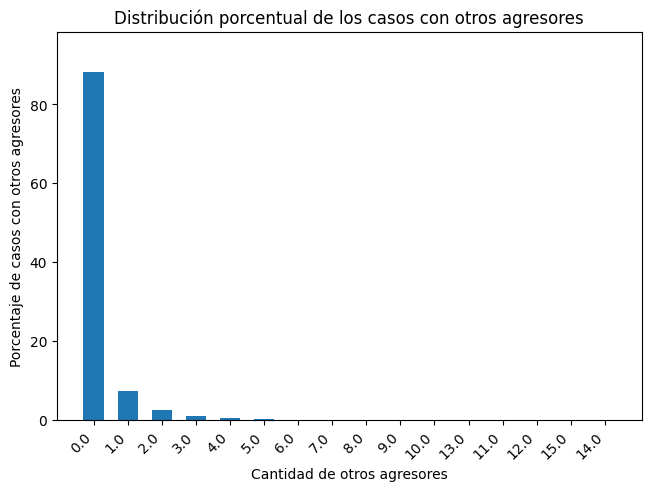

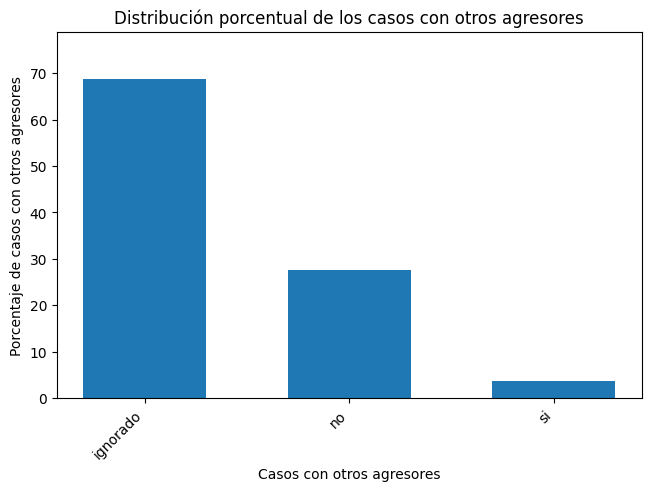

AGR_OTRAS_MUJ
99.0    320825
0.0     134669
1.0       8014
2.0       1888
3.0        439
4.0        127
5.0         36
6.0         16
7.0          6
8.0          2
Name: count, dtype: int64
AGR_OTRAS_MUJ
99.0    68.843316
0.0     28.897563
1.0      1.719661
2.0      0.405131
3.0      0.094202
4.0      0.027252
5.0      0.007725
6.0      0.003433
7.0      0.001287
8.0      0.000429
Name: count, dtype: float64


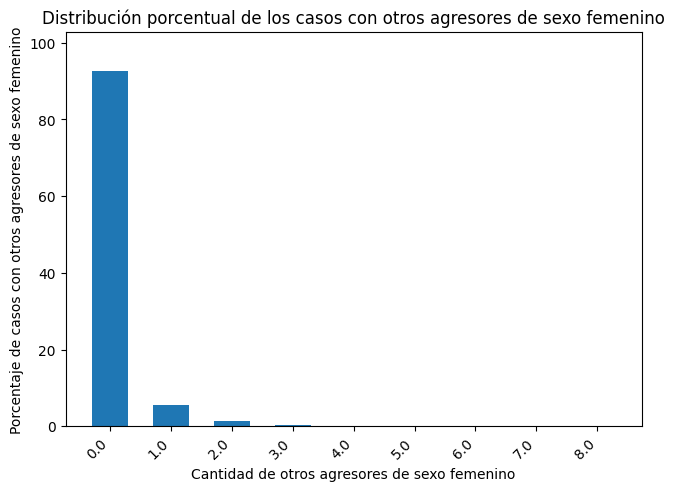

OTROS_AGRESORES_MUJ
ignorado    320825
no          134669
si           10528
Name: count, dtype: int64
OTROS_AGRESORES_MUJ
ignorado    68.843316
no          28.897563
si           2.259121
Name: count, dtype: float64


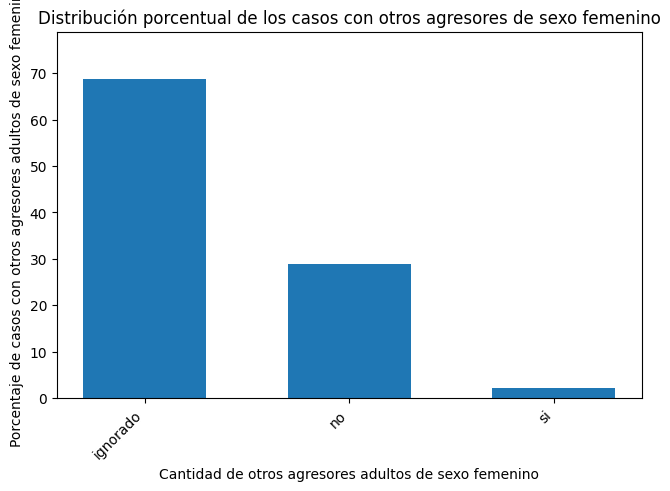

AGR_OTROS_HOM
99.0    320825
0.0     137994
1.0       5816
2.0       1031
3.0        235
4.0         78
5.0         24
6.0         14
7.0          3
9.0          1
8.0          1
Name: count, dtype: int64
AGR_OTROS_HOM
99.0    68.843316
0.0     29.611048
1.0      1.248010
2.0      0.221234
3.0      0.050427
4.0      0.016737
5.0      0.005150
6.0      0.003004
7.0      0.000644
9.0      0.000215
8.0      0.000215
Name: count, dtype: float64


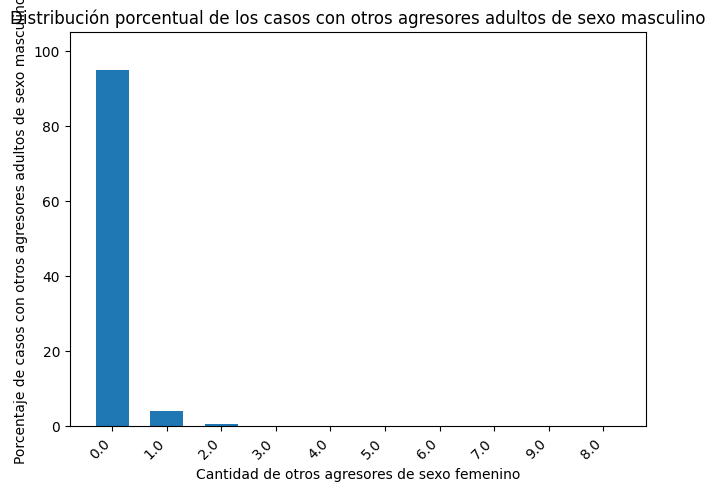

OTROS_AGRESORES_HOM
ignorado    320825
no          137994
si            7203
Name: count, dtype: int64
OTROS_AGRESORES_HOM
ignorado    68.843316
no          29.611048
si           1.545635
Name: count, dtype: float64


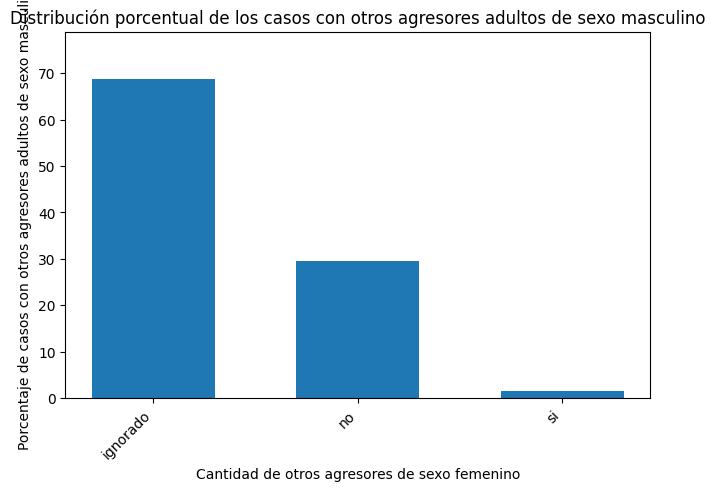

AGR_OTRAS_N_AS
99.0    320825
0.0     143582
1.0       1140
2.0        353
3.0         89
4.0         28
5.0          3
6.0          2
Name: count, dtype: int64
AGR_OTRAS_N_AS
99.0    68.843316
0.0     30.810133
1.0      0.244624
2.0      0.075747
3.0      0.019098
4.0      0.006008
5.0      0.000644
6.0      0.000429
Name: count, dtype: float64


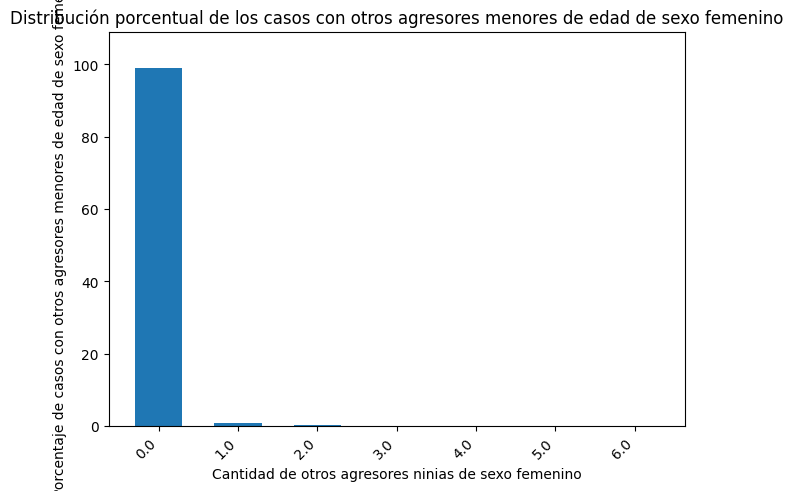

OTROS_AGRESORES_N_AS
ignorado    320825
no          143582
si            1615
Name: count, dtype: int64
OTROS_AGRESORES_N_AS
ignorado    68.843316
no          30.810133
si           0.346550
Name: count, dtype: float64


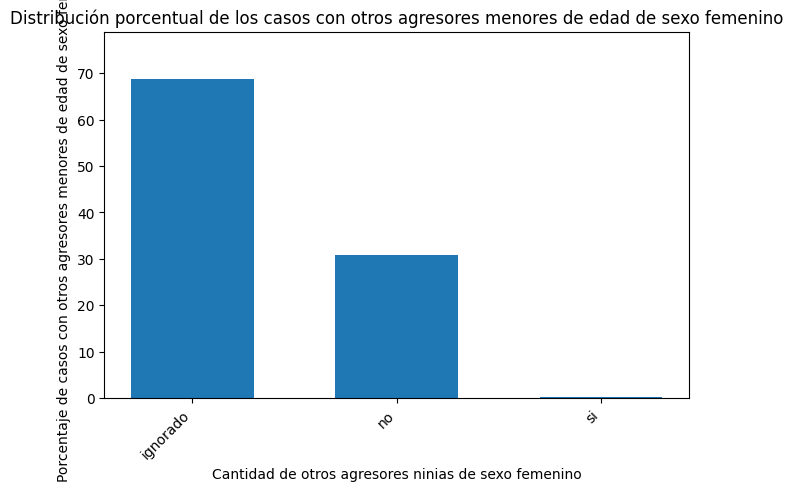

AGR_OTROS_N_OS
99.0    320825
0.0     143378
1.0       1237
2.0        432
3.0        117
4.0         24
5.0          4
6.0          3
7.0          2
Name: count, dtype: int64
AGR_OTROS_N_OS
99.0    68.843316
0.0     30.766359
1.0      0.265438
2.0      0.092699
3.0      0.025106
4.0      0.005150
5.0      0.000858
6.0      0.000644
7.0      0.000429
Name: count, dtype: float64


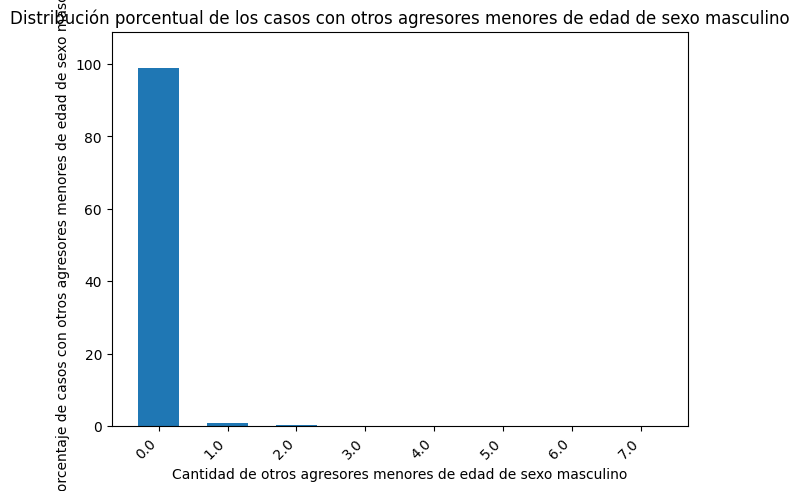

OTROS_AGRESORES_N_OS
ignorado    320825
no          143378
si            1819
Name: count, dtype: int64
OTROS_AGRESORES_N_OS
ignorado    68.843316
no          30.766359
si           0.390325
Name: count, dtype: float64


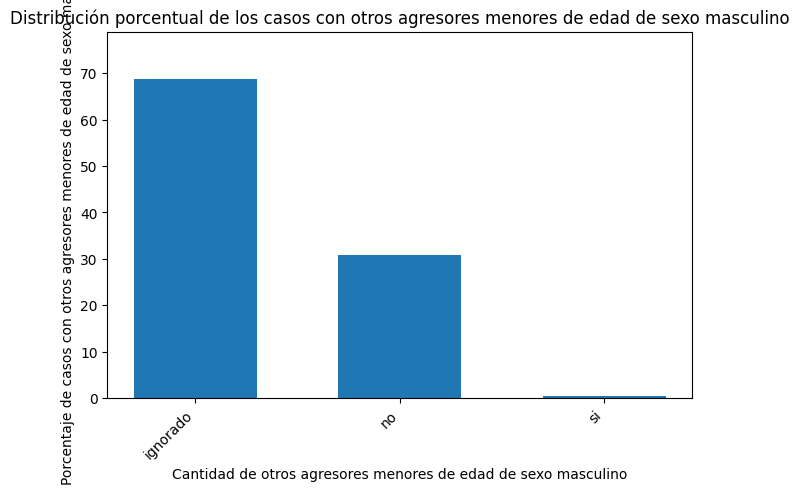

In [59]:
print(df["AGRESORES_OTROS_TOTAL"].value_counts())
print(df["AGRESORES_OTROS_TOTAL"].value_counts()/df.shape[0]*100)
print(df["OTROS_AGRESORES"].value_counts())
print(df["OTROS_AGRESORES"].value_counts()/df.shape[0]*100)
# Es preocupante que realmente se desconozca si dentro de los casos hubieron o no más agresores en la mayoría de casos se desconoce. Sin embargo, se puede ver que normalmente no hay agresores extra implicados.
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df[df["AGRESORES_OTROS_TOTAL"]<99.0]["AGRESORES_OTROS_TOTAL"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores')
ax.set_title('Distribución porcentual de los casos con otros agresores')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()

# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["OTROS_AGRESORES"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores')
ax.set_title('Distribución porcentual de los casos con otros agresores')
ax.set_xticks(x)
ax.set_xlabel('Casos con otros agresores')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
print(df["AGR_OTRAS_MUJ"].value_counts())
print(df["AGR_OTRAS_MUJ"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df[df["AGR_OTRAS_MUJ"]<99.0]["AGR_OTRAS_MUJ"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores de sexo femenino')
ax.set_title('Distribución porcentual de los casos con otros agresores de sexo femenino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
print(df["OTROS_AGRESORES_MUJ"].value_counts())
print(df["OTROS_AGRESORES_MUJ"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["OTROS_AGRESORES_MUJ"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores adultos de sexo femenino')
ax.set_title('Distribución porcentual de los casos con otros agresores de sexo femenino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores adultos de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
print(df["AGR_OTROS_HOM"].value_counts())
print(df["AGR_OTROS_HOM"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df[df["AGR_OTROS_HOM"]<99.0]["AGR_OTROS_HOM"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores adultos de sexo masculino')
ax.set_title('Distribución porcentual de los casos con otros agresores adultos de sexo masculino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
print(df["OTROS_AGRESORES_HOM"].value_counts())
print(df["OTROS_AGRESORES_HOM"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["OTROS_AGRESORES_HOM"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores adultos de sexo masculino')
ax.set_title('Distribución porcentual de los casos con otros agresores adultos de sexo masculino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
print(df["AGR_OTRAS_N_AS"].value_counts())
print(df["AGR_OTRAS_N_AS"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df[df["AGR_OTRAS_N_AS"]<99]["AGR_OTRAS_N_AS"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores menores de edad de sexo femenino')
ax.set_title('Distribución porcentual de los casos con otros agresores menores de edad de sexo femenino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores ninias de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
print(df["OTROS_AGRESORES_N_AS"].value_counts())
print(df["OTROS_AGRESORES_N_AS"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["OTROS_AGRESORES_N_AS"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores menores de edad de sexo femenino')
ax.set_title('Distribución porcentual de los casos con otros agresores menores de edad de sexo femenino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores ninias de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
print(df["AGR_OTROS_N_OS"].value_counts())
print(df["AGR_OTROS_N_OS"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df[df["AGR_OTROS_N_OS"]<99]["AGR_OTROS_N_OS"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores menores de edad de sexo masculino')
ax.set_title('Distribución porcentual de los casos con otros agresores menores de edad de sexo masculino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores menores de edad de sexo masculino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()

print(df["OTROS_AGRESORES_N_OS"].value_counts())
print(df["OTROS_AGRESORES_N_OS"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["OTROS_AGRESORES_N_OS"].value_counts(normalize=True) * 100
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores menores de edad de sexo masculino')
ax.set_title('Distribución porcentual de los casos con otros agresores menores de edad de sexo masculino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores menores de edad de sexo masculino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
# El hecho de que haya agresores niños independiente del sexo es una llamada de atención a servicios infantiles y también a la educación.

## Otras victimas vs hijos

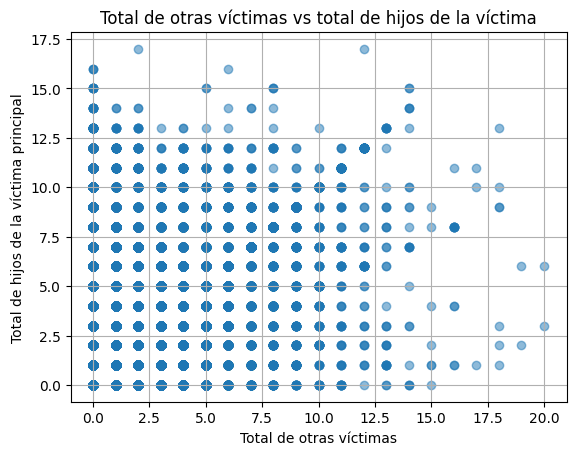

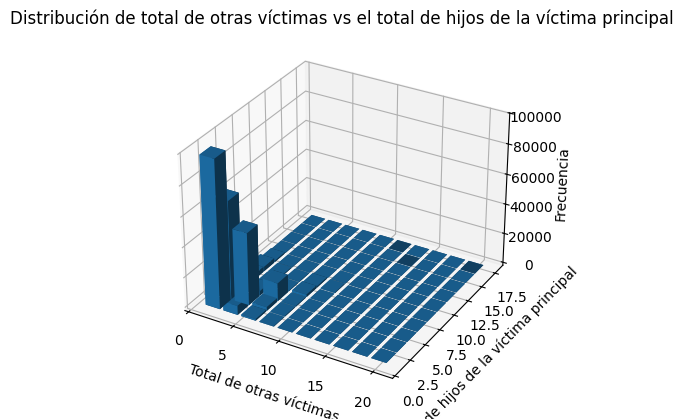

In [60]:
# Filter invalid entries
mask = (df["OTRAS_VICTIMAS"] != 9999.0) & (df["TOTAL_HIJOS"] != 9999.0)
x = df.loc[mask, "OTRAS_VICTIMAS"]
y = df.loc[mask, "TOTAL_HIJOS"]

# 2D scatter plot
plt.scatter(x, y, alpha=0.5)
plt.title("Total de otras víctimas vs total de hijos de la víctima")
plt.xlabel("Total de otras víctimas")
plt.ylabel("Total de hijos de la víctima principal")
plt.grid(True)
plt.show()

# 3D histogram
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# Dynamically determine bin ranges and counts
x_max = int(np.ceil(x.max()))
y_max = int(np.ceil(y.max()))
bins = [min(10, x_max + 1), min(10, y_max + 1)]  # adjust number of bins to data scale

hist, xedges, yedges = np.histogram2d(x, y, bins=bins, range=[[0, x_max], [0, y_max]])

# Meshgrid for bar positions
xpos, ypos = np.meshgrid(
    xedges[:-1] + (xedges[1] - xedges[0]) / 2,
    yedges[:-1] + (yedges[1] - yedges[0]) / 2,
    indexing="ij"
)
xpos = xpos.ravel()
ypos = ypos.ravel()
zpos = np.zeros_like(xpos)

# Bar dimensions
dx = dy = (xedges[1] - xedges[0]) * 0.8  # 80% of bin width
dz = hist.ravel()

# Plot 3D bars
ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average', shade=True)

ax.set_title("Distribución de total de otras víctimas vs el total de hijos de la víctima principal")
ax.set_xlabel("Total de otras víctimas")
ax.set_ylabel("Total de hijos de la víctima principal")
ax.set_zlabel("Frecuencia")
plt.show()


No parece que haya correlación entre la cantidad de víctimas extra que hayan en casos y la totalidad de hijos de la víctima principal, al menos en el reporte, además se observa que la mayoría de casos se dan cuando se tiene al menos un hijo y 0 víctimas extra. Esto no muestra alguna correlación entre que a mayor cantidad de hijos mayor será la cantidad de víctimas totales.

### Distribución geográfica

HEC_AREA
urbana      256207
rural       186384
ignorado     23431
Name: count, dtype: int64
HEC_AREA
urbana      54.977447
rural       39.994678
ignorado     5.027874
Name: count, dtype: float64


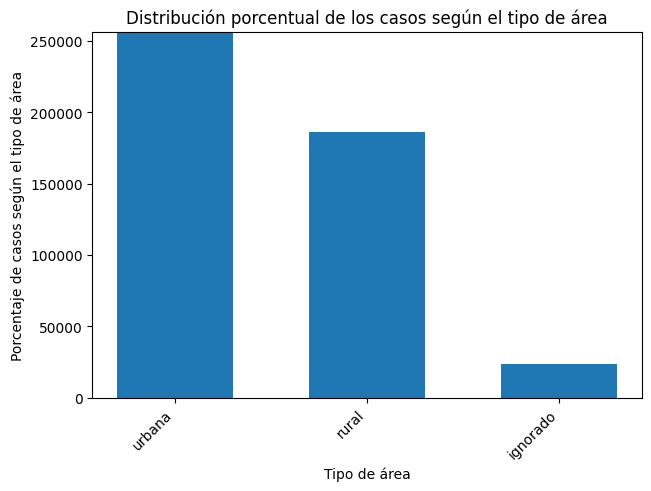

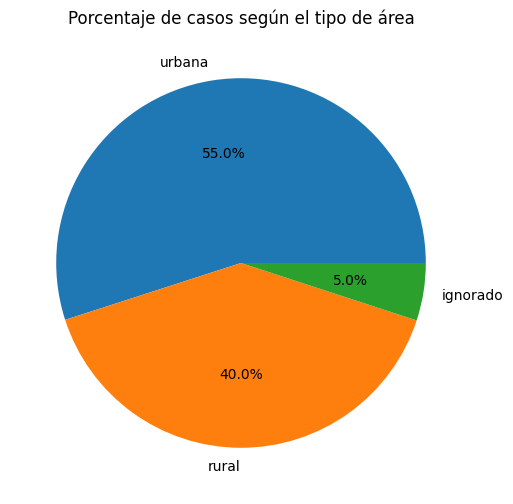

HEC_DEPTO
suchitepequez     106152
guatemala          80163
alta verapaz       33506
san marcos         21490
chimaltenango      19669
quetzaltenango     19433
sacatepequez       18398
retalhuleu         17372
huehuetenango      14725
escuintla          14479
santa rosa         13930
baja verapaz       12777
jutiapa            12008
peten              11584
el progreso        11372
izabal              9846
jalapa              9368
zacapa              8959
quiche              8861
solola              8751
totonicapan         6097
chiquimula          5015
ignorado            2067
Name: count, dtype: int64
HEC_DEPTO
suchitepequez     22.778324
guatemala         17.201548
alta verapaz       7.189789
san marcos         4.611370
chimaltenango      4.220616
quetzaltenango     4.169975
sacatepequez       3.947882
retalhuleu         3.727721
huehuetenango      3.159722
escuintla          3.106935
santa rosa         2.989129
baja verapaz       2.741716
jutiapa            2.576702
peten          

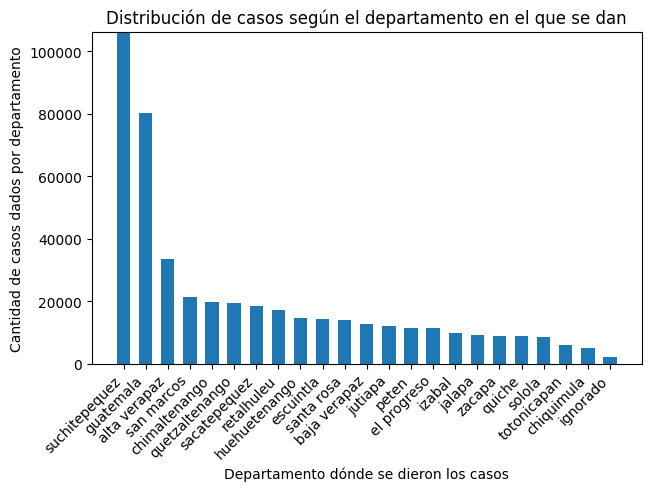

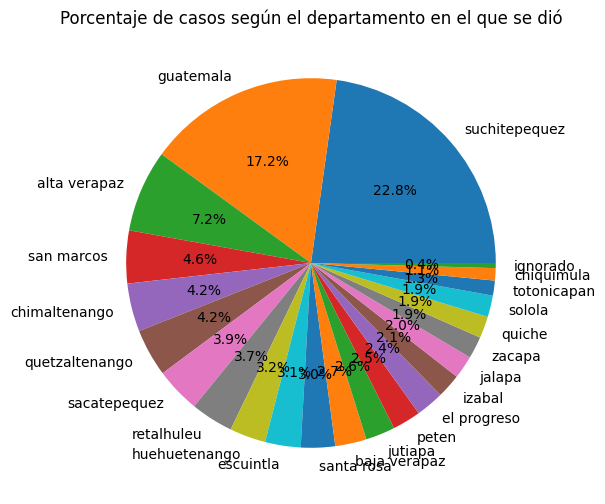

HEC_AREA        ignorado  rural  urbana
HEC_DEPTO                              
alta verapaz        1458  14893   17155
baja verapaz         771   6574    5432
chimaltenango        581   6033   13055
chiquimula           361   1609    3045
el progreso          372   5374    5626
escuintla            167   4052   10260
guatemala           7151   8438   64574
huehuetenango        422   8970    5333
ignorado             879    264     924
izabal               405   3287    6154
jalapa                12   4934    4422
jutiapa             1085   7121    3802
peten                362   3134    8088
quetzaltenango      1025   7158   11250
quiche               392   4850    3619
retalhuleu            19  10018    7335
sacatepequez        1474   4182   12742
san marcos           717  14865    5908
santa rosa           244   8925    4761
solola              1020   4347    3384
suchitepequez       4215  48930   53007
totonicapan           61   4689    1347
zacapa               238   3737    4984


DEPTO,alta verapaz,baja verapaz,chimaltenango,chiquimula,el progreso,escuintla,guatemala,huehuetenango,izabal,jalapa,...,quetzaltenango,quiche,retalhuleu,sacatepequez,san marcos,santa rosa,solola,suchitepequez,totonicapan,zacapa
HEC_DEPTO,,,,,,,,,,,,,,,,,,,,,
alta verapaz,7.113183,0.007510,0.000215,0.000429,0.000215,0.000000,0.004935,0.001073,0.001287,0.000215,...,0.000215,0.001073,0.000000,0.000000,0.000000,0.001931,0.000000,0.046993,0.000858,0.007296
baja verapaz,0.007296,2.711460,0.000000,0.000000,0.001931,0.000429,0.001287,0.002575,0.002146,0.000000,...,0.000000,0.004721,0.000429,0.000215,0.000215,0.000000,0.000429,0.006437,0.000000,0.001931
chimaltenango,0.000000,0.000000,4.170404,0.000000,0.000644,0.001931,0.013948,0.000000,0.000429,0.000000,...,0.002146,0.000858,0.000215,0.010944,0.000000,0.001502,0.003219,0.013948,0.000215,0.000215
chiquimula,0.001287,0.000215,0.000215,1.049736,0.001502,0.000429,0.002360,0.000429,0.001502,0.003004,...,0.000000,0.000000,0.000000,0.000429,0.000215,0.000429,0.000000,0.009656,0.000000,0.002360
el progreso,0.000858,0.000858,0.000000,0.000429,2.411260,0.000215,0.009656,0.000000,0.000429,0.002146,...,0.000215,0.000000,0.000215,0.007296,0.000858,0.000215,0.000429,0.001931,0.000215,0.001931
escuintla,0.000429,0.001287,0.004292,0.000644,0.000644,3.032689,0.023175,0.006223,0.000429,0.000429,...,0.001931,0.001931,0.001717,0.006867,0.000000,0.003648,0.000644,0.007940,0.000858,0.001073
guatemala,0.004506,0.006652,0.008798,0.003004,0.015879,0.005150,16.860577,0.002790,0.003004,0.006223,...,0.006867,0.005579,0.008369,0.006867,0.188189,0.012017,0.004077,0.037766,0.001717,0.001931
huehuetenango,0.000429,0.003862,0.000215,0.000215,0.000215,0.007725,0.004077,3.101999,0.000429,0.000000,...,0.002575,0.001717,0.000858,0.002360,0.004292,0.000858,0.000000,0.011158,0.000858,0.000000
ignorado,0.006867,0.007510,0.002790,0.009227,0.005794,0.001287,0.275738,0.006223,0.009227,0.000000,...,0.018454,0.005794,0.000000,0.008154,0.001287,0.000858,0.000000,0.028110,0.000000,0.001073


In [61]:
print(df["HEC_AREA"].value_counts())
print(df["HEC_AREA"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["HEC_AREA"].value_counts()
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_title('Distribución porcentual de los casos según el tipo de área')
ax.set_xticks(x)
ax.set_ylabel('Porcentaje de casos según el tipo de área')
ax.set_xlabel('Tipo de área')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
# Se puede observar que se reportan más en el casco urbano pero realmente también existen muchos reportes en el casco rural.
vic_niv_escolaridad = (df["HEC_AREA"].value_counts()/df["HEC_AREA"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos según el tipo de área")
plt.show()
print(df["HEC_DEPTO"].value_counts())
print(df["HEC_DEPTO"].value_counts()/df.shape[0]*100)
# Unificamos los índices (ocupaciones) para evitar problemas con ocupaciones que no estén en ambos
ocupaciones = df["HEC_DEPTO"].value_counts()
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Cantidad de casos dados por departamento')
ax.set_title('Distribución de casos según el departamento en el que se dan')
ax.set_xticks(x)
ax.set_xlabel('Departamento dónde se dieron los casos')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
vic_niv_escolaridad = (df["HEC_DEPTO"].value_counts()/df["HEC_DEPTO"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos según el departamento en el que se dió")
plt.show()
# Aquí se observa que la mayoría de reportes pueden darse principalmente en las dos grandes ciudades, la ciudad capital y cobán, ya que en los demás departamentos, QUE HAYAN SIDO REPORTADOS OJO, está más distribuído.
print(pd.crosstab(df["HEC_DEPTO"], df["HEC_AREA"]))
print(pd.crosstab(df["HEC_DEPTO"], df["HEC_AREA"])/df.shape[0]*100)
# Al momento de comparar los cascos urbanos donde se dieron los hechos se denota que únicamente en Guatemala se presenta una diferencia grande en los cascos
# ya que es un 2% de casos en el área rural vs 16% de casos en área urbana, mientras que en los demás departamentos se observa que son distribucion de casos similares
pd.crosstab(df["HEC_DEPTO"], df["DEPTO"])/df.shape[0]*100
# A pesar de que sí se suelen reportar los hechos en el mismo departamento en dónde ocurrieron, hay casos en dónde se tienen que reportar en otro departamento

### Institución que han sido partícipes en el caso

INST_DENUN_HECHO
organismo judicial                      265635
policia nacional civil                  159009
ministerio publico                       31700
procuraduria de los derechos humanos      5043
procuraduria general de la nacion         4488
bufete popular                             147
Name: count, dtype: int64
INST_DENUN_HECHO
organismo judicial                      57.000528
policia nacional civil                  34.120492
ministerio publico                       6.802254
procuraduria de los derechos humanos     1.082138
procuraduria general de la nacion        0.963045
bufete popular                           0.031544
Name: count, dtype: float64


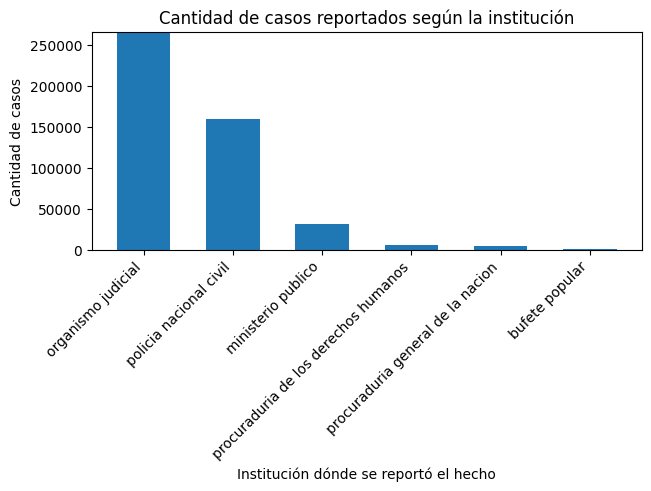

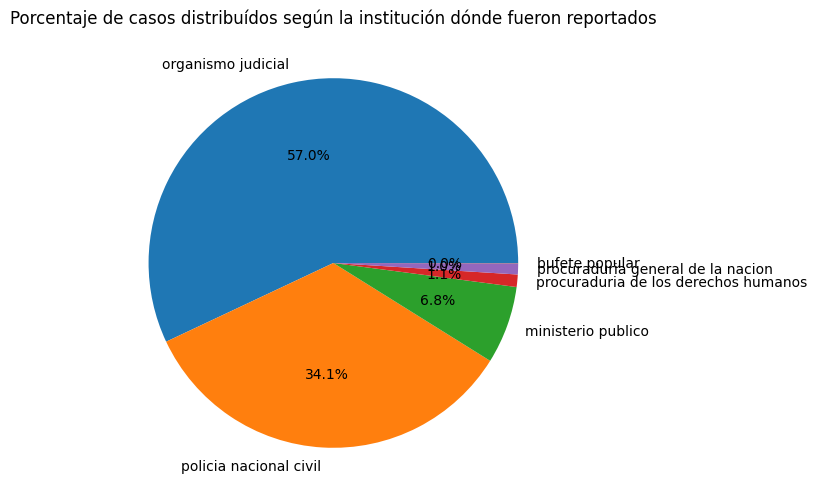

ORGANISMO_JURISDICCIONAL
Ignorado                                                                                                                                                                         363788
Juzgados de Paz                                                                                                                                                                   67074
Juzgados de Primera Instancia de Familia                                                                                                                                          25373
Juzgado de Paz con Competencia Específica para la Protección en Materia de Violencia Intrafamiliar, y de Niñez y Adolescencia Amenazada o Violada en sus Derechos (de turno)       5547
Juzgados de Paz Penal                                                                                                                                                              1222
Juzgados de Paz Penal de Turno/24horas                 

c:\Users\diego\Downloads\UVG\CODING\Semestre9\Tesis\Tesis\ViolenciaIntrafamiliar\.venv\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


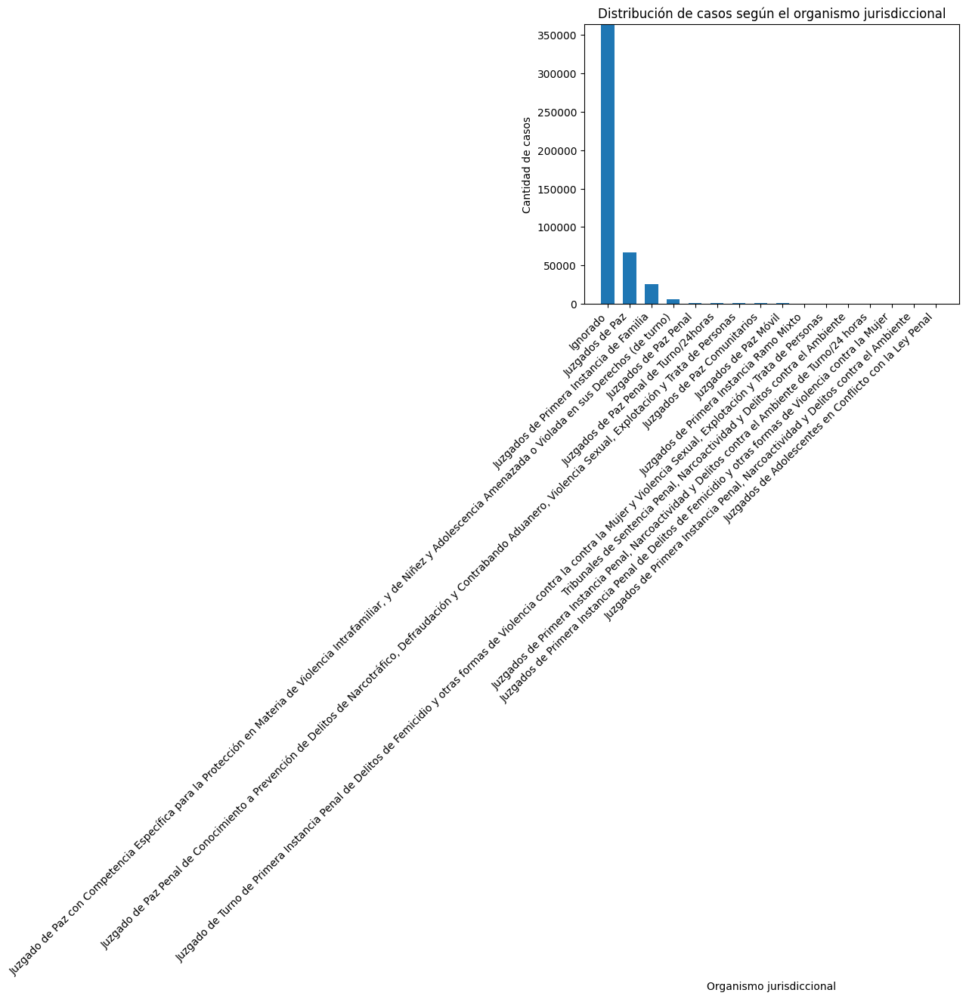

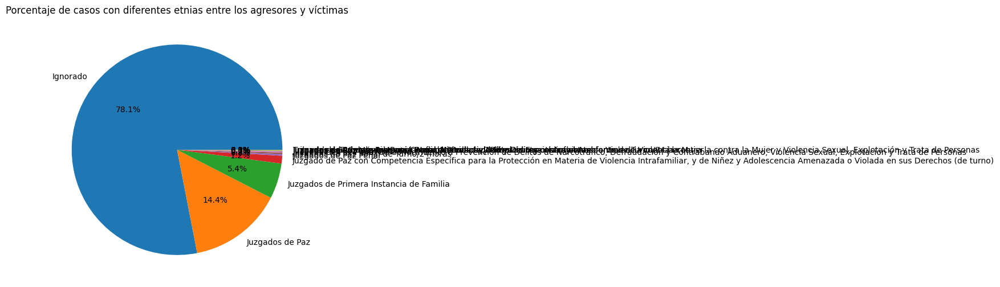

CONDUCENTE
ignorado    371066
si           62248
no           32708
Name: count, dtype: int64
CONDUCENTE
ignorado    79.624138
si          13.357309
no           7.018553
Name: count, dtype: float64


c:\Users\diego\Downloads\UVG\CODING\Semestre9\Tesis\Tesis\ViolenciaIntrafamiliar\.venv\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


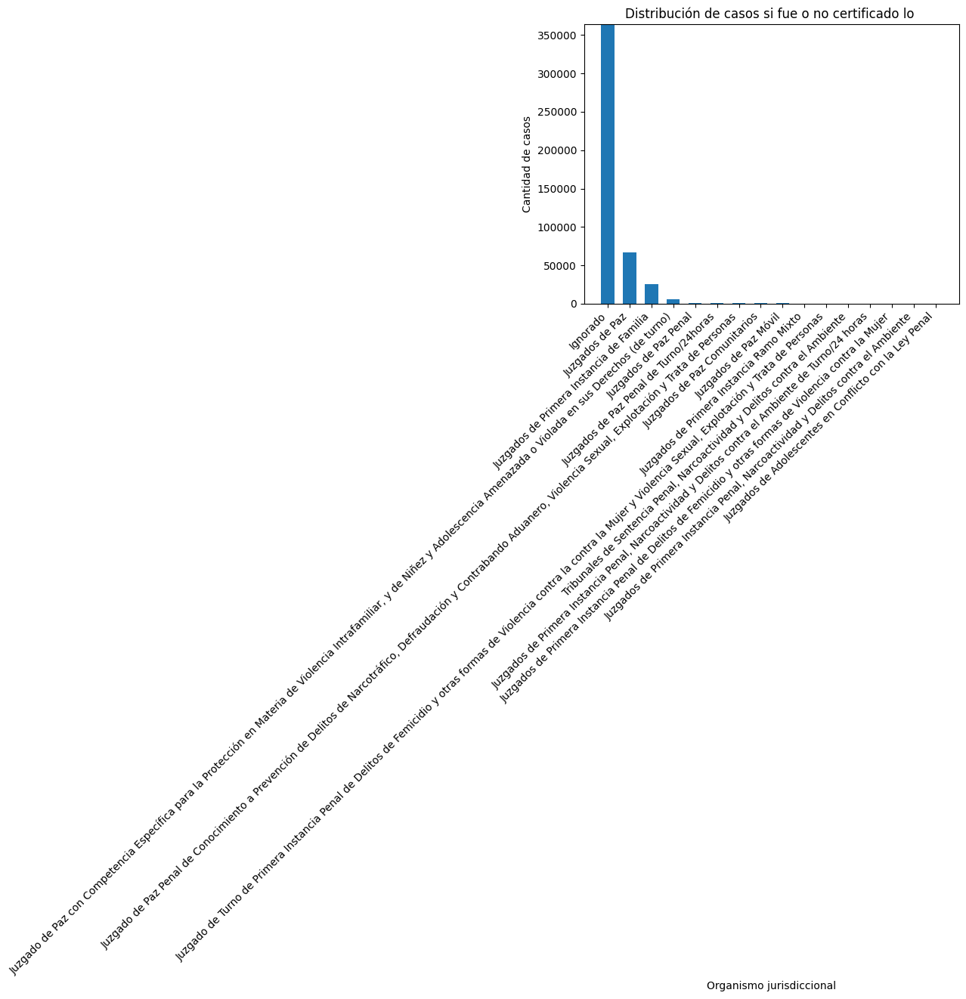

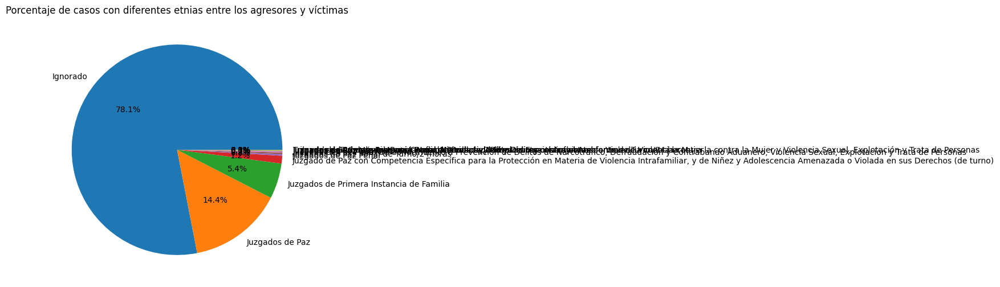

In [62]:
print(df["INST_DENUN_HECHO"].value_counts())
print(df["INST_DENUN_HECHO"].value_counts()/df.shape[0]*100)
# Por lo que normalmente se registra en un organismo judicial y la policía nacional civil
ocupaciones = df["INST_DENUN_HECHO"].value_counts()
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Cantidad de casos')
ax.set_title('Cantidad de casos reportados según la institución')
ax.set_xticks(x)
ax.set_xlabel('Institución dónde se reportó el hecho')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
vic_niv_escolaridad = (df["INST_DENUN_HECHO"].value_counts()/df["INST_DENUN_HECHO"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos distribuídos según la institución dónde fueron reportados")
plt.show()
print(df["ORGANISMO_JURISDICCIONAL"].value_counts())
print(df["ORGANISMO_JURISDICCIONAL"].value_counts()/df.shape[0]*100)
# Es preocupante que no suela llevarse la cuenta de en dónde es que se registró la denuncia.
# En el que más se registran es en los juzgados de paz.
# Por lo que normalmente se registra en un organismo judicial y la policía nacional civil
ocupaciones = df["ORGANISMO_JURISDICCIONAL"].value_counts()
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Cantidad de casos')
ax.set_title('Distribución de casos según el organismo jurisdiccional')
ax.set_xticks(x)
ax.set_xlabel('Organismo jurisdiccional')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
vic_niv_escolaridad = (df[df["ORGANISMO_JURISDICCIONAL"]!=99]["ORGANISMO_JURISDICCIONAL"].value_counts()/df[df["ORGANISMO_JURISDICCIONAL"]!=99]["ORGANISMO_JURISDICCIONAL"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes etnias entre los agresores y víctimas")
plt.show()
print(df["CONDUCENTE"].value_counts())
print(df["CONDUCENTE"].value_counts()/df.shape[0]*100)
ocupaciones = df["ORGANISMO_JURISDICCIONAL"].value_counts()
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Cantidad de casos')
ax.set_title('Distribución de casos si fue o no certificado lo ')
ax.set_xticks(x)
ax.set_xlabel('Organismo jurisdiccional')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
vic_niv_escolaridad = (df[df["ORGANISMO_JURISDICCIONAL"]!=99]["ORGANISMO_JURISDICCIONAL"].value_counts()/df[df["ORGANISMO_JURISDICCIONAL"]!=99]["ORGANISMO_JURISDICCIONAL"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes etnias entre los agresores y víctimas")
plt.show()
# Esto es preocupante, ya que se suelen ignorar los reportes de violencia intrafamiliar.

Hay que ignorarlo dado que no nos dice en su mayoría en dónde han sido registrados

In [63]:
print(pd.crosstab(df["INST_DENUN_HECHO"], df["CONDUCENTE"]))
print(pd.crosstab(df["INST_DENUN_HECHO"], df["CONDUCENTE"])/df.shape[0]*100)
# Únicamente en el organismo judicial no se ignora el registro, en las demás instituciones siempre se ignoran los registros.
# En el caso de que solo el organismo judicial lo pueda procesar deberían de pasarle los registros al organismo judicial los registros y no hacer ese bochorno.
# No puede ser que la PNC no haga nada ante los registros.
print(pd.crosstab(df["ORGANISMO_JURISDICCIONAL"], df["CONDUCENTE"]))
print(pd.crosstab(df["ORGANISMO_JURISDICCIONAL"], df["CONDUCENTE"])/df.shape[0]*100)

CONDUCENTE                            ignorado     no     si
INST_DENUN_HECHO                                            
bufete popular                             147      0      0
ministerio publico                       31700      0      0
organismo judicial                      170679  32708  62248
policia nacional civil                  159009      0      0
procuraduria de los derechos humanos      5043      0      0
procuraduria general de la nacion         4488      0      0
CONDUCENTE                             ignorado        no         si
INST_DENUN_HECHO                                                    
bufete popular                         0.031544  0.000000   0.000000
ministerio publico                     6.802254  0.000000   0.000000
organismo judicial                    36.624666  7.018553  13.357309
policia nacional civil                34.120492  0.000000   0.000000
procuraduria de los derechos humanos   1.082138  0.000000   0.000000
procuraduria general de la na

### Denuncia anterior

HEC_RECUR_DENUN
no          385102
si           59823
ignorado     21097
Name: count, dtype: int64
HEC_RECUR_DENUN
no          0.826360
si          0.128369
ignorado    0.045270
Name: count, dtype: float64


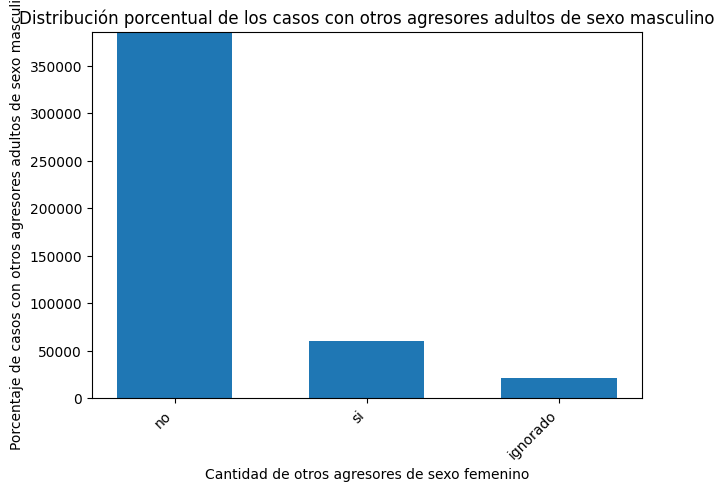

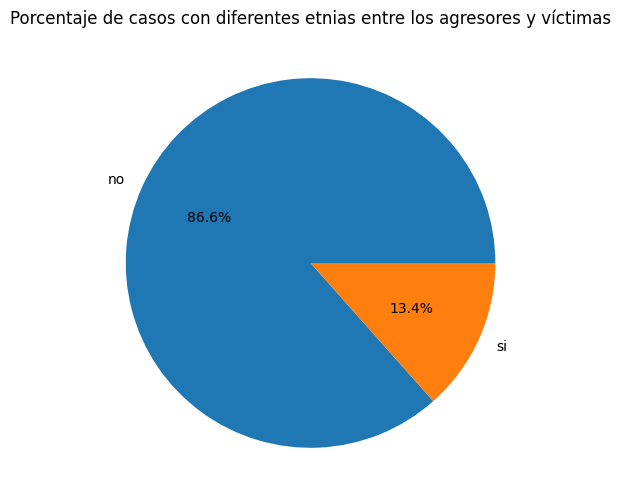

INST_DONDE_DENUNCIO
ignorado                                414006
organismo judicial                       28120
policia nacional civil                   13382
ministerio publico                        9578
procuraduria general de la nacion          510
procuraduria de los derechos humanos       332
bufete popular                              94
Name: count, dtype: int64
INST_DONDE_DENUNCIO
ignorado                                88.838295
organismo judicial                       6.034050
policia nacional civil                   2.871538
ministerio publico                       2.055268
procuraduria general de la nacion        0.109437
procuraduria de los derechos humanos     0.071241
bufete popular                           0.020171
Name: count, dtype: float64


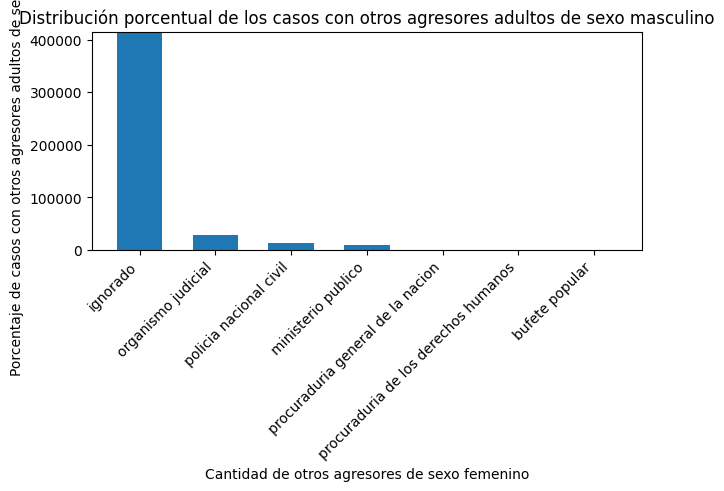

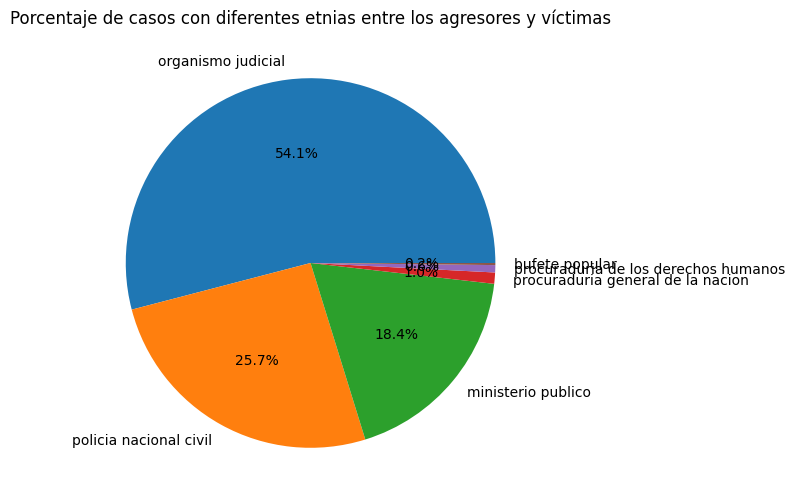

In [64]:
print(df["HEC_RECUR_DENUN"].value_counts())
print(df["HEC_RECUR_DENUN"].value_counts()/df.shape[0])
ocupaciones = df["HEC_RECUR_DENUN"].value_counts()
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores adultos de sexo masculino')
ax.set_title('Distribución porcentual de los casos con otros agresores adultos de sexo masculino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
vic_niv_escolaridad = (df[df["HEC_RECUR_DENUN"]!="ignorado"]["HEC_RECUR_DENUN"].value_counts()/df[df["INST_DONDE_DENUNCIO"]!="ignorado"]["HEC_RECUR_DENUN"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes etnias entre los agresores y víctimas")
plt.show()
# Se debe de denotar que normalmente las denuncias se reportan por primera vez, aunqeu a veces lo ignoran si ya lo reportaron pero es una mínima proporción.
print(df["INST_DONDE_DENUNCIO"].value_counts())
print(df["INST_DONDE_DENUNCIO"].value_counts()/df.shape[0]*100)
# En este caso ignorado significa tanto que no se sabe dónde se denuncio con anterioridad como que no aplica
ocupaciones = df["INST_DONDE_DENUNCIO"].value_counts()
# Preparar gráfica
x = np.arange(len(ocupaciones))
width = 0.6

fig, ax = plt.subplots(layout='constrained')
rects = ax.bar(x, ocupaciones.values, width)
# ax.bar_label(rects, padding=3, fmt='%.1f%%')

# Configuración del gráfico
ax.set_ylabel('Porcentaje de casos con otros agresores adultos de sexo masculino')
ax.set_title('Distribución porcentual de los casos con otros agresores adultos de sexo masculino')
ax.set_xticks(x)
ax.set_xlabel('Cantidad de otros agresores de sexo femenino')
ax.set_xticklabels(ocupaciones.index, rotation=45, ha='right')
ax.set_ylim(0, ocupaciones.max() + 10)

plt.show()
vic_niv_escolaridad = (df[df["INST_DONDE_DENUNCIO"]!="ignorado"]["INST_DONDE_DENUNCIO"].value_counts()/df[df["INST_DONDE_DENUNCIO"]!="ignorado"]["INST_DONDE_DENUNCIO"].shape[0]*100)
plt.subplots(figsize=(10,6))
plt.pie(vic_niv_escolaridad.values, labels=vic_niv_escolaridad.index, autopct='%1.1f%%')
plt.title("Porcentaje de casos con diferentes etnias entre los agresores y víctimas")
plt.show()

In [65]:
print(pd.crosstab(df["INST_DONDE_DENUNCIO"], df["HEC_RECUR_DENUN"]))
print(pd.crosstab(df["INST_DONDE_DENUNCIO"], df["HEC_RECUR_DENUN"])/df.shape[0]*100)
# Por lo que muchas veces las personas ignoran si denunciaron o no, aunque las personas que denuncian también olvidan en dónde fue la denuncia.

HEC_RECUR_DENUN                       ignorado      no     si
INST_DONDE_DENUNCIO                                          
bufete popular                               0       0     94
ignorado                                 21097  385102   7807
ministerio publico                           0       0   9578
organismo judicial                           0       0  28120
policia nacional civil                       0       0  13382
procuraduria de los derechos humanos         0       0    332
procuraduria general de la nacion            0       0    510
HEC_RECUR_DENUN                       ignorado         no        si
INST_DONDE_DENUNCIO                                                
bufete popular                        0.000000   0.000000  0.020171
ignorado                              4.527039  82.636013  1.675243
ministerio publico                    0.000000   0.000000  2.055268
organismo judicial                    0.000000   0.000000  6.034050
policia nacional civil            

### Quien reporta
Para saber si es la víctima o alguien más.

In [66]:
print(df["QUIEN_REPORTA"].value_counts())
print(df["QUIEN_REPORTA"].value_counts()/df.shape[0]*100)
# Normalmente suele ser la víctima quién reporta aunque también pueden haber casos dónde no lo es, pero prácticamente siempre es la víctima.

QUIEN_REPORTA
victima                   454769
ignorado                    5139
familiar de la victima      5085
otro                        1029
Name: count, dtype: int64
QUIEN_REPORTA
victima                   97.585307
ignorado                   1.102738
familiar de la victima     1.091150
otro                       0.220805
Name: count, dtype: float64


In [67]:
print(pd.crosstab(df["QUIEN_REPORTA"], df["CONDUCENTE"]))
print(pd.crosstab(df["QUIEN_REPORTA"], df["CONDUCENTE"])/df.shape[0]*100)
# Relamente no importa quién reporte, normalmente se ignorará el registro.
# Se pensó que tal vez había más chances si reportaba alguien más, una mayor tasa de éxito pero no.

CONDUCENTE              ignorado     no     si
QUIEN_REPORTA                                 
familiar de la victima      4081    372    632
ignorado                    3997    351    791
otro                         647    253    129
victima                   362341  31732  60696
CONDUCENTE               ignorado        no         si
QUIEN_REPORTA                                         
familiar de la victima   0.875710  0.079825   0.135616
ignorado                 0.857685  0.075318   0.169734
otro                     0.138835  0.054289   0.027681
victima                 77.751909  6.809121  13.024278


### Tiempo en el que se reporta y se realiza el hecho

In [68]:
print(df["HEC_ANO"].value_counts())
print(df["HEC_ANO"].value_counts()/df.shape[0]*100)

HEC_ANO
2010.0    36557
2009.0    35429
2011.0    33872
2013.0    31290
2012.0    31231
2022.0    29601
2021.0    29542
2014.0    28908
2023.0    28643
2015.0    26812
2019.0    26203
2016.0    26178
2017.0    25086
2018.0    25054
2020.0    23256
2008.0    22413
9999.0     5120
2007.0      486
2006.0       86
2005.0       74
2001.0       56
2004.0       42
2000.0       34
2003.0       29
2002.0       19
200.0         1
Name: count, dtype: int64
HEC_ANO
2010.0    7.844479
2009.0    7.602431
2011.0    7.268326
2013.0    6.714275
2012.0    6.701615
2022.0    6.351846
2021.0    6.339186
2014.0    6.203141
2023.0    6.146276
2015.0    5.753376
2019.0    5.622696
2016.0    5.617331
2017.0    5.383008
2018.0    5.376141
2020.0    4.990322
2008.0    4.809430
9999.0    1.098661
2007.0    0.104287
2006.0    0.018454
2005.0    0.015879
2001.0    0.012017
2004.0    0.009012
2000.0    0.007296
2003.0    0.006223
2002.0    0.004077
200.0     0.000215
Name: count, dtype: float64


In [69]:
print(df["ANO_EMISION"].value_counts())
print(df["ANO_EMISION"].value_counts()/df.shape[0]*100)

ANO_EMISION
2010.0    36804
2009.0    36009
2011.0    34345
2013.0    31765
2012.0    31631
2022.0    30017
2023.0    29779
2021.0    29624
2014.0    29499
2015.0    27320
2019.0    26519
2016.0    26489
2017.0    25467
2018.0    25135
2020.0    23238
2008.0    22381
Name: count, dtype: int64
ANO_EMISION
2010.0    7.897481
2009.0    7.726888
2011.0    7.369824
2013.0    6.816202
2012.0    6.787448
2022.0    6.441112
2023.0    6.390042
2021.0    6.356781
2014.0    6.329959
2015.0    5.862384
2019.0    5.690504
2016.0    5.684066
2017.0    5.464763
2018.0    5.393522
2020.0    4.986460
2008.0    4.802563
Name: count, dtype: float64


In [70]:
print(pd.crosstab(df["HEC_ANO"], df["ANO_EMISION"]))
print(pd.crosstab(df["HEC_ANO"], df["ANO_EMISION"])/df.shape[0]*100)
# Se observa que normalmente los hechos se suelen reportar el mismo año que sucedieron por lo que se reitera que no se deberían de ignorar como normalmente se hace.

ANO_EMISION  2008.0  2009.0  2010.0  2011.0  2012.0  2013.0  2014.0  2015.0  \
HEC_ANO                                                                       
200.0             1       0       0       0       0       0       0       0   
2000.0           11      13       1       4       1       2       2       0   
2001.0            8      15       0      16       1       3       2       3   
2002.0            5       1       3       3       1       2       0       0   
2003.0            7       7       2       3       0       4       4       0   
2004.0           16       5       1       1       3       1       9       1   
2005.0           25      26       7       3       2       1       5       3   
2006.0           35      25       1       2       2       4       5       2   
2007.0          405      53       7       5       6       3       3       1   
2008.0        21781     571      29       6       3       5       7       1   
2009.0            0   34840     506      34      11 

In [71]:
df["DIF_TIEMPO_REGISTRO_HECHO"].value_counts()
# Se observa que se registra el hecho normalmente una semana luego de haber sucedido

DIF_TIEMPO_REGISTRO_HECHO
una semana                409817
un mes                     31102
3 meses                    11268
ignorado                    5120
6 meses                     3338
1 año                       2741
5 años                      2128
10 años                      304
más de 10 años               104
fecha futura                  69
fecha hecho inválida          30
fecha emisión inválida         1
Name: count, dtype: int64

### Tipo de agresión

In [72]:
print(df["HEC_TIPAGRE"].value_counts())
print(df["HEC_TIPAGRE"].value_counts()/df.shape[0]*100)
# Se observa que la mayor cantidad de casos se dan sobre violencia física y psicológica luego le sigue la patrimonial y la sexual en comparación no se suele dar.
print(df["VIOLENCIA_FISICA"].value_counts())
print(df["VIOLENCIA_FISICA"].value_counts()/df.shape[0]*100)
# Y se confirma ya que la violencia física suele darse en un 57.7% de los casos
print(df["VIOLENCIA_PSICOLOGICA"].value_counts())
print(df["VIOLENCIA_PSICOLOGICA"].value_counts()/df.shape[0]*100)
# Sin embargo, la violencia más presente es la violencia psicológica ya que se da en un 86% de los casos de violencia intrafamiliar
print(df["VIOLENCIA_SEXUAL"].value_counts())
print(df["VIOLENCIA_SEXUAL"].value_counts()/df.shape[0]*100)
# La violencia sexual es la que menos se suele dar con un 2% de casos
print(df["VIOLENCIA_PATRIMONIAL"].value_counts())
print(df["VIOLENCIA_PATRIMONIAL"].value_counts()/df.shape[0]*100)
# Y la violencia patrimonial no se suele dar al ser únicamente un 13% de los casos

# Nótese que estas afirmaciones son contando el hecho de que se incluye la cuenta de la violencia en la cuál se mezclan distintos tipos de agresiones.

HEC_TIPAGRE
fisica-psicologica                       181917
psicologica                              157613
fisica                                    55541
fisica-psicologica-patrimonial            31750
psicologica-patrimonial                   21287
patrimonial                                5120
fisica-psicologica-sexual                  4735
fisica-psicologica-sexual-patrimonial      2981
psicologica-sexual                         1600
fisica-patrimonial                         1382
fisica-sexual                               822
sexual                                      739
psicologica-sexual-patrimonial              348
fisica-sexual-patrimonial                   109
sexual-patrimonial                           78
Name: count, dtype: int64
HEC_TIPAGRE
fisica-psicologica                       39.036140
psicologica                              33.820935
fisica                                   11.918107
fisica-psicologica-patrimonial            6.812983
psicologica-patrimonial   

#### Tipo de agresion y sexo

In [73]:
df_vic_hom = df[df["VIC_SEXO"]=="hombres"]
df_vic_muj = df[df["VIC_SEXO"]=="mujeres"]
df_ag_hom = df[df["AGR_SEXO"]=="hombres"]
df_ag_muj = df[df["AGR_SEXO"]=="mujeres"]

In [74]:
print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_SEXO"]))
print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_SEXO"])/df.shape[0]*100)
# Aquí se observa que igualmente existe sobretodo una mayor violencia física y psicológica independientemente de que la víctima sea mujer u hombre.
# Sin embargo, se observa que en el caso de las mujeres suelen sufrir más violencia física y psicológica si se une tanto la violencia física-psicológica con la física y la violencia física-psicológica-patrimonial, y sus respectivas formas individuales.
# Por el contrario en el caso de los hombres el mayor porcentaje se encuentra en violencia psicológica y tiene sentido dado que suelen ser más parejas hombre-mujer por lo que realmente los hombres tienen las de ganar en una disputa física. A su vez, es seguido por violencia física-psicológica y violencia física.

VIC_SEXO                               mujeres
HEC_TIPAGRE                                   
fisica                                   55541
fisica-patrimonial                        1382
fisica-psicologica                      181917
fisica-psicologica-patrimonial           31750
fisica-psicologica-sexual                 4735
fisica-psicologica-sexual-patrimonial     2981
fisica-sexual                              822
fisica-sexual-patrimonial                  109
patrimonial                               5120
psicologica                             157613
psicologica-patrimonial                  21287
psicologica-sexual                        1600
psicologica-sexual-patrimonial             348
sexual                                     739
sexual-patrimonial                          78
VIC_SEXO                                 mujeres
HEC_TIPAGRE                                     
fisica                                 11.918107
fisica-patrimonial                      0.296553
fisic

VIC_SEXO          mujeres
VIOLENCIA_FISICA         
no presente        186785
presente           279237
VIC_SEXO            mujeres
VIOLENCIA_FISICA           
no presente       40.080726
presente          59.919274
AGR_SEXO          hombres  mujeres
VIOLENCIA_FISICA                  
no presente        172387    14398
presente           267892    11345
AGR_SEXO            hombres   mujeres
VIOLENCIA_FISICA                     
no presente       36.991172  3.089554
presente          57.484840  2.434434
VIC_SEXO            mujeres
VIOLENCIA_FISICA           
no presente       39.154036
presente          60.845964
AGR_SEXO            hombres   mujeres
VIOLENCIA_FISICA                     
no presente       36.991172  3.089554
presente          57.484840  2.434434
AGR_SEXO            mujeres
VIOLENCIA_FISICA           
no presente       55.929767
presente          44.070233


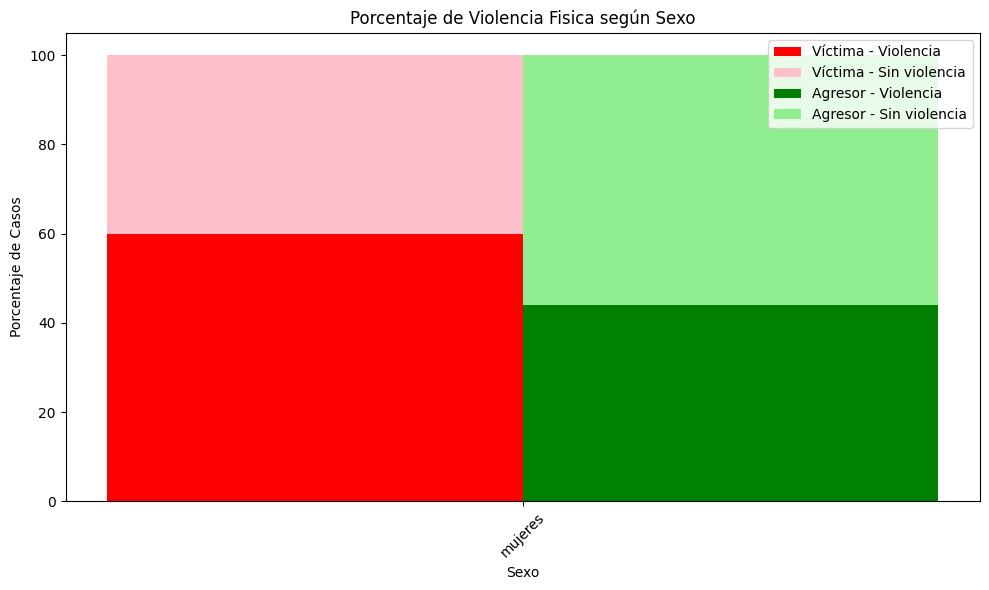

VIC_SEXO               mujeres
VIOLENCIA_PSICOLOGICA         
no presente              63791
presente                402231
VIC_SEXO                mujeres
VIOLENCIA_PSICOLOGICA          
no presente            13.68841
presente               86.31159
AGR_SEXO               hombres  mujeres
VIOLENCIA_PSICOLOGICA                  
no presente              61274     2517
presente                379005    23226
AGR_SEXO                 hombres   mujeres
VIOLENCIA_PSICOLOGICA                     
no presente            13.148306  0.540103
presente               81.327706  4.983885
VIC_SEXO                 mujeres
VIOLENCIA_PSICOLOGICA           
no presente            13.917084
presente               86.082916
AGR_SEXO                 hombres   mujeres
VIOLENCIA_PSICOLOGICA                     
no presente            13.148306  0.540103
presente               81.327706  4.983885
AGR_SEXO                 mujeres
VIOLENCIA_PSICOLOGICA           
no presente             9.777415
presente     

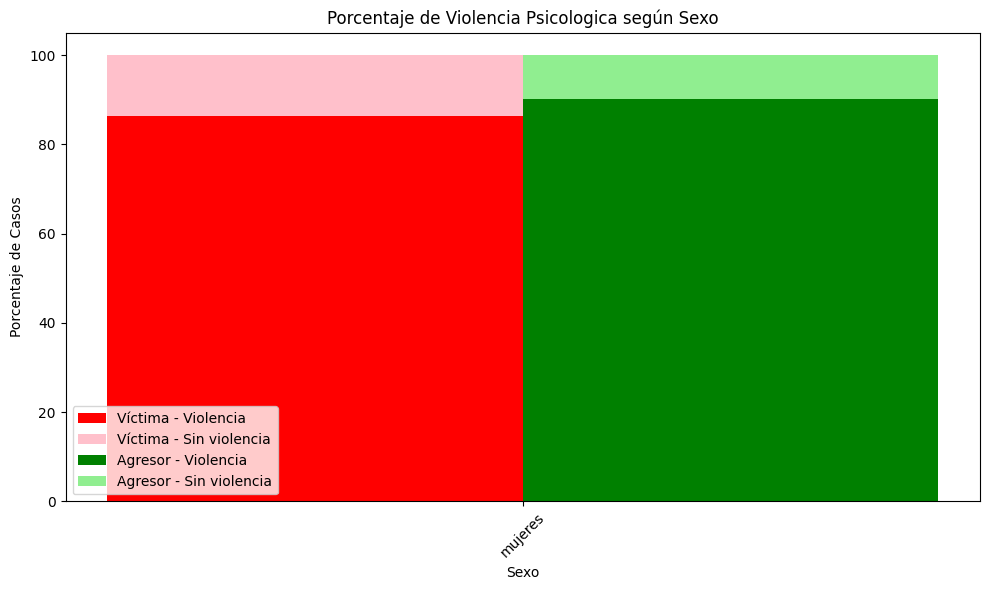

VIC_SEXO          mujeres
VIOLENCIA_SEXUAL         
no presente        454610
presente            11412
VIC_SEXO            mujeres
VIOLENCIA_SEXUAL           
no presente       97.551189
presente           2.448811
AGR_SEXO          hombres  mujeres
VIOLENCIA_SEXUAL                  
no presente        428937    25673
presente            11342       70
AGR_SEXO            hombres   mujeres
VIOLENCIA_SEXUAL                     
no presente       92.042221  5.508967
presente           2.433791  0.015021
VIC_SEXO            mujeres
VIOLENCIA_SEXUAL           
no presente       97.423906
presente           2.576094
AGR_SEXO            hombres   mujeres
VIOLENCIA_SEXUAL                     
no presente       92.042221  5.508967
presente           2.433791  0.015021
AGR_SEXO            mujeres
VIOLENCIA_SEXUAL           
no presente       99.728081
presente           0.271919


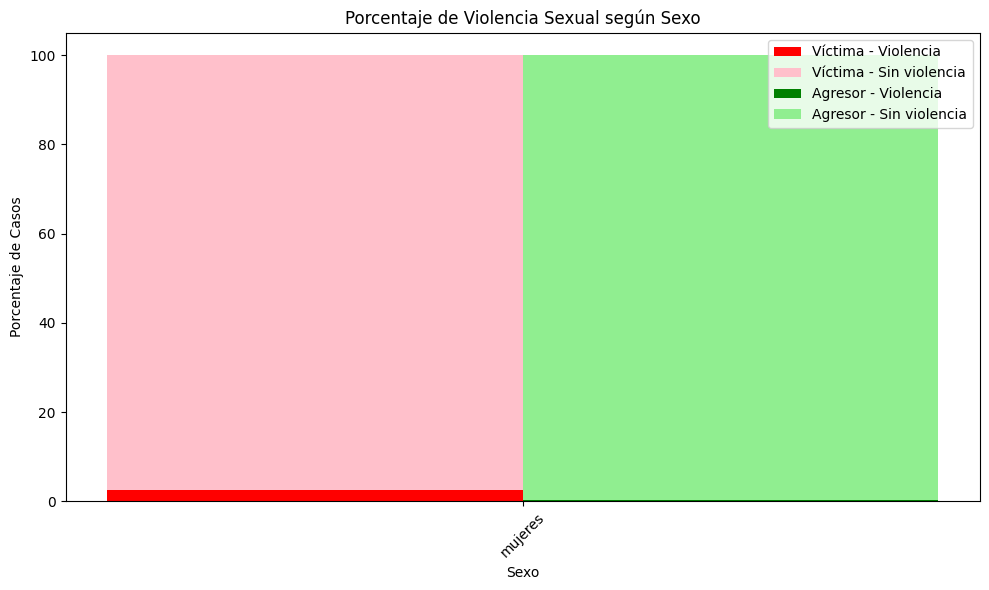

VIC_SEXO               mujeres
VIOLENCIA_PATRIMONIAL         
no presente             402967
presente                 63055
VIC_SEXO                 mujeres
VIOLENCIA_PATRIMONIAL           
no presente            86.469523
presente               13.530477
AGR_SEXO               hombres  mujeres
VIOLENCIA_PATRIMONIAL                  
no presente             379524    23443
presente                 60755     2300
AGR_SEXO                 hombres   mujeres
VIOLENCIA_PATRIMONIAL                     
no presente            81.439074  5.030449
presente               13.036938  0.493539
VIC_SEXO                 mujeres
VIOLENCIA_PATRIMONIAL           
no presente            86.200795
presente               13.799205
AGR_SEXO                 hombres   mujeres
VIOLENCIA_PATRIMONIAL                     
no presente            81.439074  5.030449
presente               13.036938  0.493539
AGR_SEXO                 mujeres
VIOLENCIA_PATRIMONIAL           
no presente            91.065532
presente 

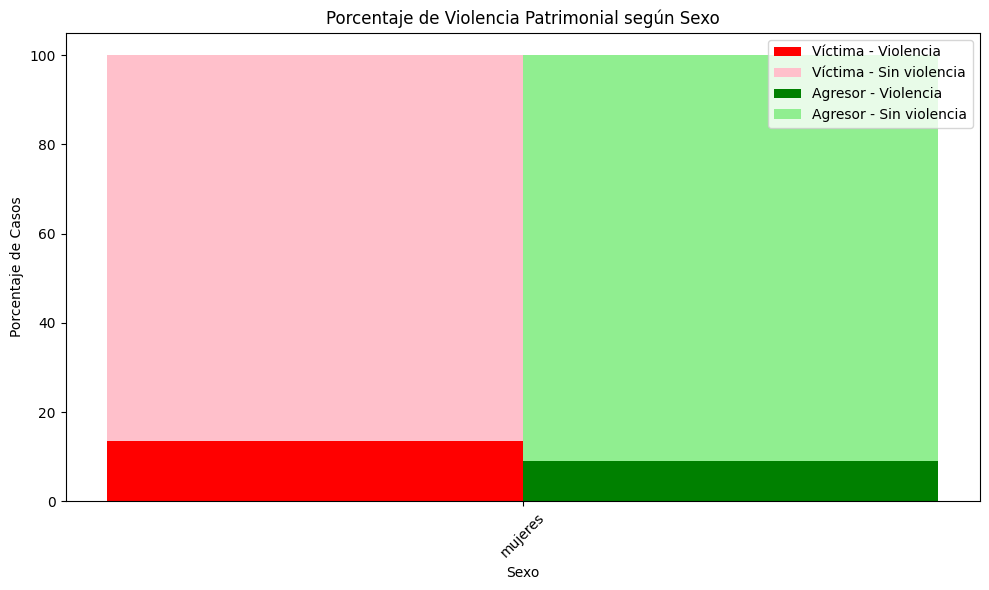

In [75]:
alfabeta_map = {
    # "hombres": 0,
    "mujeres": 1
}

# Función para calcular porcentaje de violencia
def get_percentage(df, col_esc, name, tipo_violencia):
    ct = pd.crosstab(df[col_esc], df[tipo_violencia]) / df.shape[0] * 100
    return [ct.values[0][1], ct.values[0][0], name]  # [% violencia, % no violencia, persona]

# Recorremos cada tipo de violencia
for violence_type in ['VIOLENCIA_FISICA', 'VIOLENCIA_PSICOLOGICA', 'VIOLENCIA_SEXUAL','VIOLENCIA_PATRIMONIAL']:
    print(pd.crosstab(df[violence_type], df["VIC_SEXO"]))
    print(pd.crosstab(df[violence_type], df["VIC_SEXO"])/df.shape[0]*100)
    # La violencia patrimonial y que la victima sea alfabeta se presenta en un 10.54% de los casos
    print(pd.crosstab(df[violence_type], df["AGR_SEXO"]))
    print(pd.crosstab(df[violence_type], df["AGR_SEXO"])/df.shape[0]*100)
    # La violencia patrimonial y que la victima sea analfabeta se presenta en un 2.58% de los casos
    # print(pd.crosstab(df_vic_hom[violence_type], df_vic_hom["VIC_SEXO"])/df_vic_hom.shape[0]*100)
    # Dado que la victima es alfabeta la violencia patrimonial se presenta en un 13.11% de los casos
    print(pd.crosstab(df_ag_hom[violence_type], df_ag_hom["VIC_SEXO"])/df_ag_hom.shape[0]*100)
    # Dado que la victima es analfabeta la violencia patrimonial se presenta en un 13.76% de los casos
    print(pd.crosstab(df_vic_muj[violence_type], df_vic_muj["AGR_SEXO"])/df_vic_muj.shape[0]*100)
    # Dado que el agresor es alfabeta la violencia patrimonial se presenta en un 13.46% de los casos
    print(pd.crosstab(df_ag_muj[violence_type], df_ag_muj["AGR_SEXO"])/df_ag_muj.shape[0]*100)
    # Dado que el agresor es analfabeta la violencia patrimonial se presenta en un 12.45% de los casos
    # Recolectar datos
    data = []
    # data += [["hombres"] + get_percentage(df_vic_hom, "VIC_SEXO", "víctima", violence_type)]
    data += [["mujeres"] + get_percentage(df_vic_muj, "VIC_SEXO", "víctima", violence_type)]
    # data += [["hombres"] + get_percentage(df_ag_hom, "AGR_SEXO", "agresor", violence_type)]
    data += [["mujeres"] + get_percentage(df_ag_muj, "AGR_SEXO", "agresor", violence_type)]

    # Crear DataFrame
    plot_df = pd.DataFrame(data, columns=[
        "alfabetizacion_nivel",
        "porcentaje_violencia_presente", 
        "porcentaje_violencia_no_presente", 
        "persona"
    ])
    
    # Parámetros de posición
    alfabetos = list(alfabeta_map.keys())
    x = np.arange(len(alfabetos))  # Posiciones base para alfabeta/analfabeta
    width = 0.3  # Ancho de barras

    # Separar víctimas y agresores
    vic_df = plot_df[plot_df["persona"] == "víctima"].set_index("alfabetizacion_nivel").loc[alfabetos]
    ag_df = plot_df[plot_df["persona"] == "agresor"].set_index("alfabetizacion_nivel").loc[alfabetos]

    # Crear gráfico
    plt.figure(figsize=(10, 6))
    plt.bar(x - width/2, vic_df["porcentaje_violencia_presente"], width, label="Víctima - Violencia", color='red')
    plt.bar(x - width/2, vic_df["porcentaje_violencia_no_presente"], width,
            bottom=vic_df["porcentaje_violencia_presente"], label="Víctima - Sin violencia", color='pink')

    plt.bar(x + width/2, ag_df["porcentaje_violencia_presente"], width, label="Agresor - Violencia", color='green')
    plt.bar(x + width/2, ag_df["porcentaje_violencia_no_presente"], width,
            bottom=ag_df["porcentaje_violencia_presente"], label="Agresor - Sin violencia", color='lightgreen')

    # Etiquetas y diseño
    plt.xticks(x, alfabetos, rotation=45)
    plt.xlabel("Sexo")
    plt.ylabel("Porcentaje de Casos")
    plt.title(f"Porcentaje de Violencia {violence_type.replace('VIOLENCIA_', '').capitalize()} según Sexo")
    plt.legend()
    plt.tight_layout()
    plt.show()


Lo que indica es que es casi una moneda al aire de que hayan mujeres que sufran violencia fisica, ademas, no sufren violencia sexual si el agresor es una mujer

DIF_SEXO
si    440279
no     25743
Name: count, dtype: int64
DIF_SEXO
si    94.476012
no     5.523988
Name: count, dtype: float64


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\3665698266.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


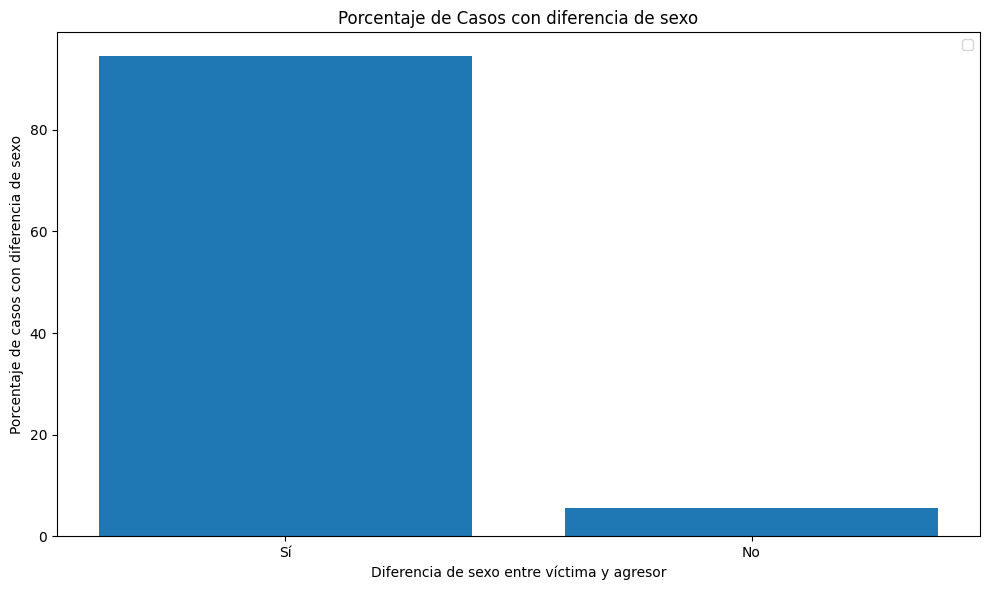

In [76]:
print(df["DIF_SEXO"].value_counts())
print(df["DIF_SEXO"].value_counts()/df.shape[0]*100)
plt.figure(figsize=(10, 6))
plt.bar(["Sí", "No"],df["DIF_SEXO"].value_counts()/df.shape[0]*100)
plt.xlabel("Diferencia de sexo entre víctima y agresor")
plt.ylabel("Porcentaje de casos con diferencia de sexo")
plt.title(f"Porcentaje de Casos con diferencia de sexo")
plt.legend()
plt.tight_layout()
plt.show()

Practicamente siempre habra violencia por parte de los hombres a mujeres y no al revés, suele ser muy raro


Tabla de frecuencia para VIOLENCIA_FISICA:
DIF_SEXO             no      si
VIOLENCIA_FISICA               
no presente       14398  172387
presente          11345  267892

Porcentajes sobre el total de casos para VIOLENCIA_FISICA:
DIF_SEXO                no         si
VIOLENCIA_FISICA                     
no presente       3.089554  36.991172
presente          2.434434  57.484840


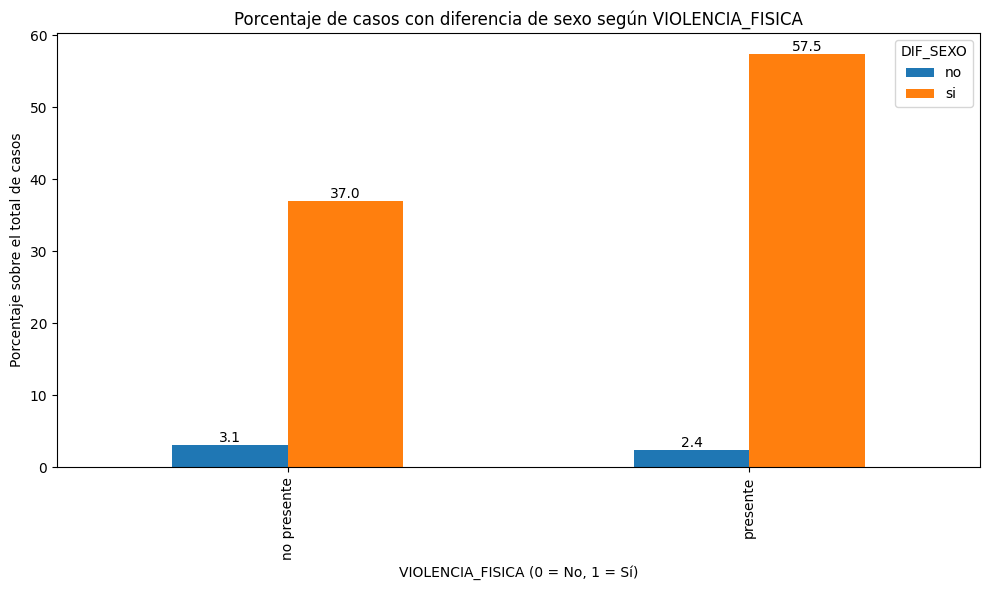


Porcentajes dentro de cada valor de VIOLENCIA_FISICA (por fila):
DIF_SEXO                no         si
VIOLENCIA_FISICA                     
no presente       7.708328  92.291672
presente          4.062857  95.937143


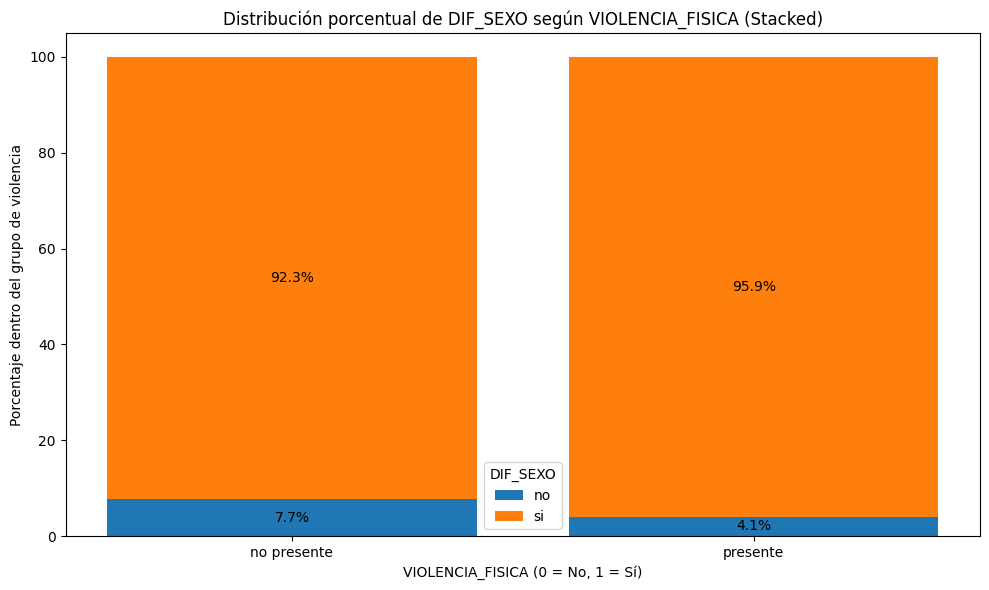


Tabla de frecuencia para VIOLENCIA_PSICOLOGICA:
DIF_SEXO                  no      si
VIOLENCIA_PSICOLOGICA               
no presente             2517   61274
presente               23226  379005

Porcentajes sobre el total de casos para VIOLENCIA_PSICOLOGICA:
DIF_SEXO                     no         si
VIOLENCIA_PSICOLOGICA                     
no presente            0.540103  13.148306
presente               4.983885  81.327706


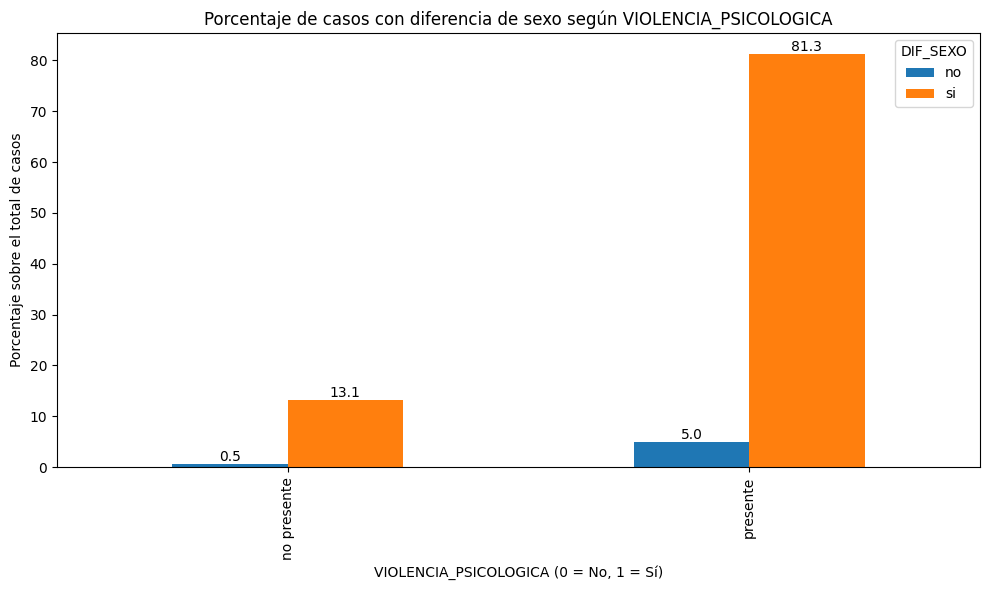


Porcentajes dentro de cada valor de VIOLENCIA_PSICOLOGICA (por fila):
DIF_SEXO                     no         si
VIOLENCIA_PSICOLOGICA                     
no presente            3.945698  96.054302
presente               5.774294  94.225706


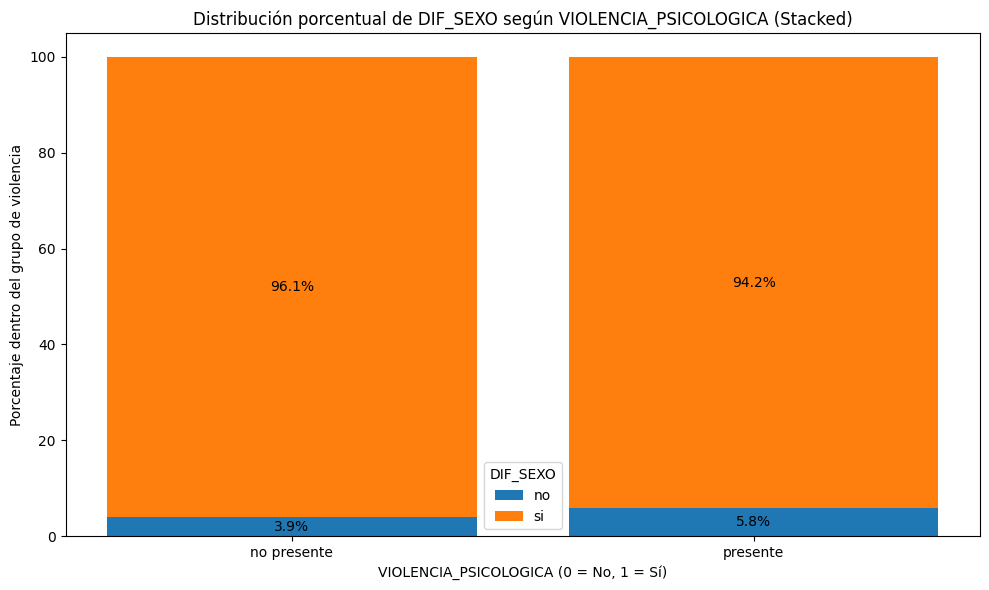


Tabla de frecuencia para VIOLENCIA_SEXUAL:
DIF_SEXO             no      si
VIOLENCIA_SEXUAL               
no presente       25673  428937
presente             70   11342

Porcentajes sobre el total de casos para VIOLENCIA_SEXUAL:
DIF_SEXO                no         si
VIOLENCIA_SEXUAL                     
no presente       5.508967  92.042221
presente          0.015021   2.433791


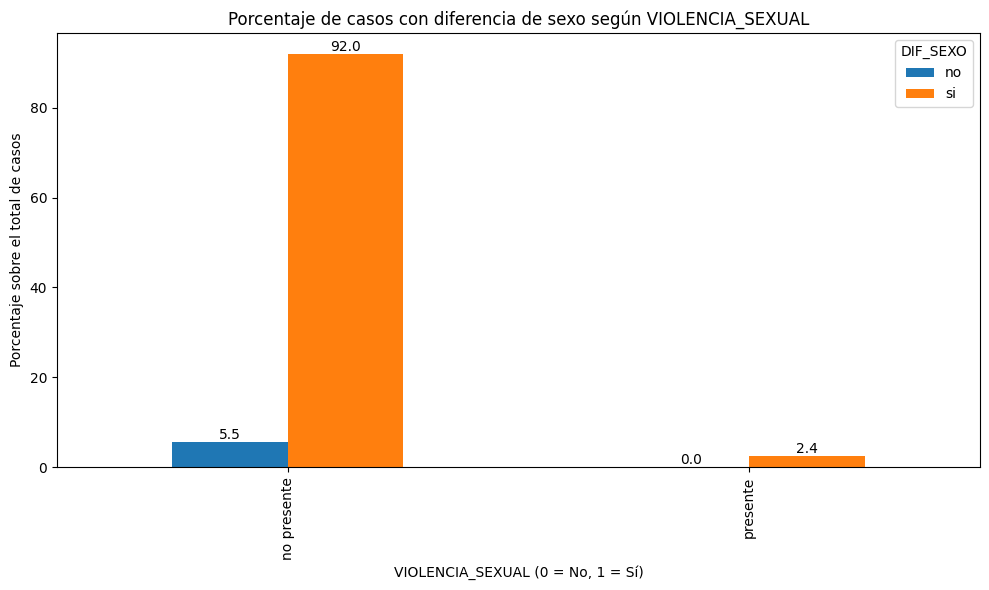


Porcentajes dentro de cada valor de VIOLENCIA_SEXUAL (por fila):
DIF_SEXO                no         si
VIOLENCIA_SEXUAL                     
no presente       5.647258  94.352742
presente          0.613389  99.386611


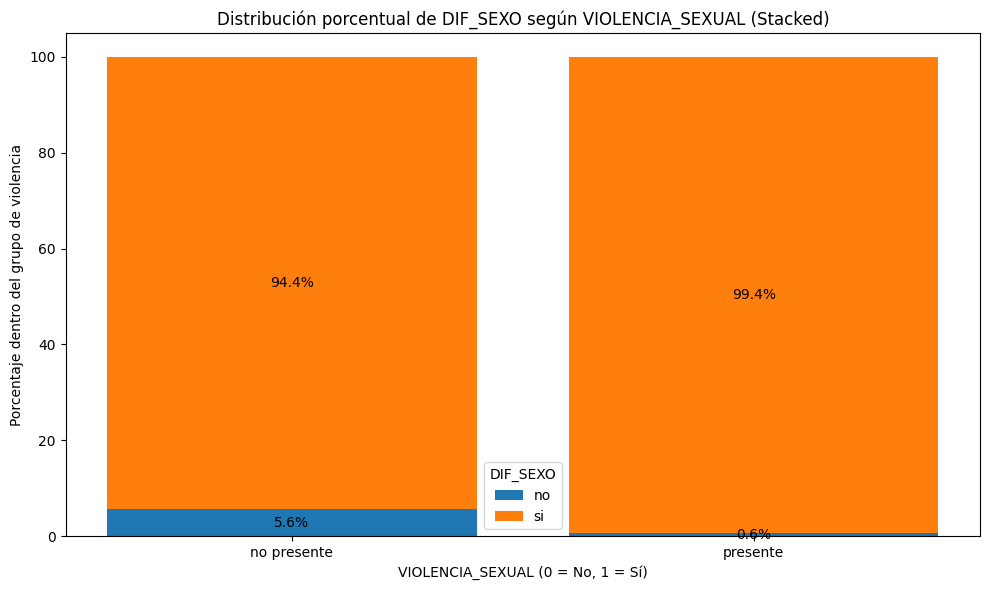


Tabla de frecuencia para VIOLENCIA_PATRIMONIAL:
DIF_SEXO                  no      si
VIOLENCIA_PATRIMONIAL               
no presente            23443  379524
presente                2300   60755

Porcentajes sobre el total de casos para VIOLENCIA_PATRIMONIAL:
DIF_SEXO                     no         si
VIOLENCIA_PATRIMONIAL                     
no presente            5.030449  81.439074
presente               0.493539  13.036938


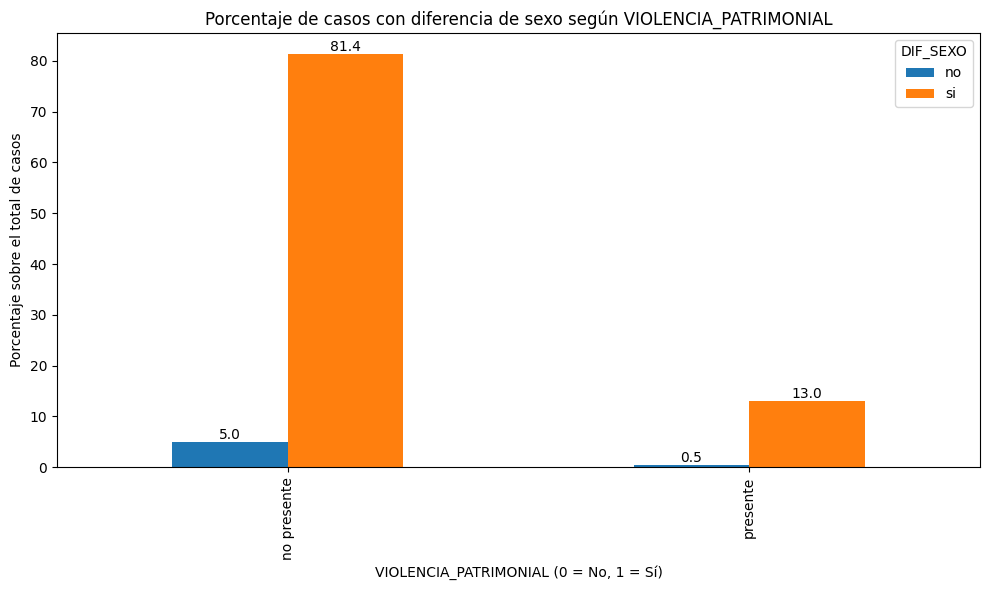


Porcentajes dentro de cada valor de VIOLENCIA_PATRIMONIAL (por fila):
DIF_SEXO                     no         si
VIOLENCIA_PATRIMONIAL                     
no presente            5.817598  94.182402
presente               3.647609  96.352391


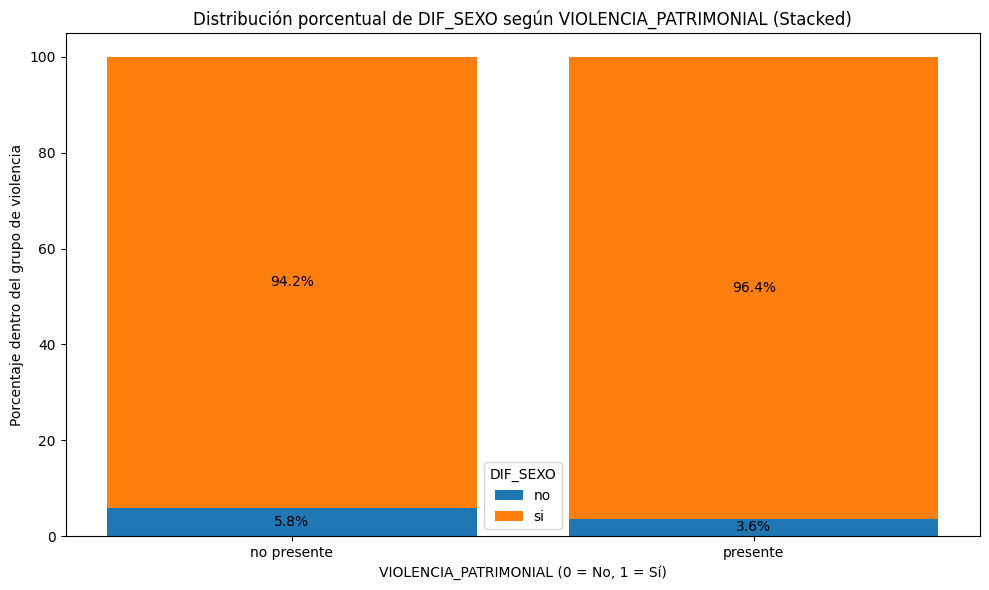

In [77]:
for violence_type in ['VIOLENCIA_FISICA', 'VIOLENCIA_PSICOLOGICA', 'VIOLENCIA_SEXUAL','VIOLENCIA_PATRIMONIAL']:
    print(f"\nTabla de frecuencia para {violence_type}:")
    crosstab = pd.crosstab(df[violence_type], df["DIF_SEXO"])
    print(crosstab)

    # Porcentaje sobre total
    crosstab_percent = crosstab / df.shape[0] * 100
    print(f"\nPorcentajes sobre el total de casos para {violence_type}:")
    print(crosstab_percent)

    # Gráfico de barras normales con etiquetas
    fig, ax = plt.subplots(figsize=(10, 6))
    crosstab_percent.plot(kind='bar', ax=ax)
    plt.xlabel(f"{violence_type} (0 = No, 1 = Sí)")
    plt.ylabel("Porcentaje sobre el total de casos")
    plt.title(f"Porcentaje de casos con diferencia de sexo según {violence_type}")
    plt.legend(title="DIF_SEXO")

    # Añadir etiquetas
    for bars in ax.containers:
        ax.bar_label(bars, fmt='%.1f', label_type='edge')

    plt.tight_layout()
    plt.show()

    # Gráfico de barras apiladas (stacked) con porcentajes por fila
    crosstab_stacked = crosstab.div(crosstab.sum(axis=1), axis=0) * 100
    print(f"\nPorcentajes dentro de cada valor de {violence_type} (por fila):")
    print(crosstab_stacked)

    fig, ax = plt.subplots(figsize=(10, 6))
    bottom = [0] * len(crosstab_stacked)
    x = range(len(crosstab_stacked))

    for col in crosstab_stacked.columns:
        values = crosstab_stacked[col].values
        bars = ax.bar(x, values, bottom=bottom, label=col)
        ax.bar_label(bars, labels=[f'{v:.1f}%' if v > 0 else '' for v in values], label_type='center')
        bottom = [i + j for i, j in zip(bottom, values)]

    ax.set_xticks(x)
    ax.set_xticklabels(crosstab_stacked.index)
    ax.set_xlabel(f"{violence_type} (0 = No, 1 = Sí)")
    ax.set_ylabel("Porcentaje dentro del grupo de violencia")
    ax.set_title(f"Distribución porcentual de DIF_SEXO según {violence_type} (Stacked)")
    ax.legend(title="DIF_SEXO")
    plt.tight_layout()
    plt.show()


No suele ocurrir ni violencia sexual ni patrimonial por lo que se ignorará

In [78]:
print(pd.crosstab(df["VIOLENCIA_PSICOLOGICA"], df["VIC_SEXO"]))
print(pd.crosstab(df["VIOLENCIA_PSICOLOGICA"], df["VIC_SEXO"])/df.shape[0]*100)
# Se obtiene que la violencia psicologica y que sea mujer sucede un 76.37% de los casos mientras que lo mismo pero para hombres sucede en un 9.88% de los casos
print(pd.crosstab(df_vic_hom["VIOLENCIA_PSICOLOGICA"], df_vic_hom["VIC_SEXO"])/df_vic_hom.shape[0]*100)
# Dado que la victima es hombre se estima que sufre un 88.29% de las veces de violencia psicologica
print(pd.crosstab(df_ag_hom["VIOLENCIA_PSICOLOGICA"], df_ag_hom["AGR_SEXO"])/df_ag_hom.shape[0]*100)
# Dado que el agresor es hombre se estima que ejerce un 88.63% de las veces de violencia psicologica
print(pd.crosstab(df_vic_muj["VIOLENCIA_PSICOLOGICA"], df_vic_muj["VIC_SEXO"])/df_vic_muj.shape[0]*100)
# Dado que la victima es mujer se estima que sufre un 85.99% de las veces de violencia psicologica
print(pd.crosstab(df_ag_muj["VIOLENCIA_PSICOLOGICA"], df_ag_muj["AGR_SEXO"])/df_ag_muj.shape[0]*100)
# Dado que el agresor es mujer se estima que ejerce un 90.22% de las veces de violencia psicologica

VIC_SEXO               mujeres
VIOLENCIA_PSICOLOGICA         
no presente              63791
presente                402231
VIC_SEXO                mujeres
VIOLENCIA_PSICOLOGICA          
no presente            13.68841
presente               86.31159
Empty DataFrame
Columns: []
Index: []
AGR_SEXO                 hombres
VIOLENCIA_PSICOLOGICA           
no presente            13.917084
presente               86.082916
VIC_SEXO                mujeres
VIOLENCIA_PSICOLOGICA          
no presente            13.68841
presente               86.31159
AGR_SEXO                 mujeres
VIOLENCIA_PSICOLOGICA           
no presente             9.777415
presente               90.222585


In [79]:
del df_vic_hom
del df_vic_muj
del df_ag_hom
del df_ag_muj

#### Tipo de agresion y alfabetismo

In [80]:
df_vic_alfab = df[df["VIC_ALFAB"]=="alfabeta"]
df_vic_analfab = df[df["VIC_ALFAB"]=="analfabeta"]
df_ag_alfab = df[df["AGR_ALFAB"]=="alfabeta"]
df_ag_analfab = df[df["AGR_ALFAB"]=="analfabeta"]

In [81]:
print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_ALFAB"]))
print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_ALFAB"])/df.shape[0]*100)
# En este caso se observa que la mayoría de casos se dan cuando la víctima es alfabeta que tiene una preparación mínima, aunque también está el porcentaje dónde la persona es analfabeta pero en menor medida.
print("____TIPO DE AGRESION DADO QUE LA VICTIMA ES ALFABETA_____")
print(pd.crosstab(df_vic_alfab["HEC_TIPAGRE"], df_vic_alfab["VIC_ALFAB"])/df_vic_alfab.shape[0]*100)
# En este caso se observa que dado que es alfabeta se dan casos principalmente de agresion psicologica y fisica
print("____TIPO DE AGRESION DADO QUE LA VICTIMA ES ANALFABETA_____")
print(pd.crosstab(df_vic_analfab["HEC_TIPAGRE"], df_vic_analfab["VIC_ALFAB"])/df_vic_analfab.shape[0]*100)
# En este caso se observa que dado que es analfabeta se dan casos igualmente de agresion psicologica y fisica

VIC_ALFAB                              alfabeta  analfabeta  ignorado
HEC_TIPAGRE                                                          
fisica                                    41339       13799       403
fisica-patrimonial                         1007         370         5
fisica-psicologica                       145001       36064       852
fisica-psicologica-patrimonial            24718        6961        71
fisica-psicologica-sexual                  3989         726        20
fisica-psicologica-sexual-patrimonial      2425         543        13
fisica-sexual                               647         162        13
fisica-sexual-patrimonial                    89          20         0
patrimonial                                4458         642        20
psicologica                              132694       23956       963
psicologica-patrimonial                   17773        3430        84
psicologica-sexual                         1329         265         6
psicologica-sexual-p

In [82]:
print(pd.crosstab(df["HEC_TIPAGRE"], df["AGR_ALFAB"]))
print(pd.crosstab(df["HEC_TIPAGRE"], df["AGR_ALFAB"])/df.shape[0]*100)
# Así mismo, se tiene un porcentaje similar cuando el agresor es alfabeta, dónde se dan la mayoría de casos y sobretodo físicos y psicológicos.
print("____TIPO DE AGRESION DADO QUE EL AGRESOR ES ALFABETA_____")
print(pd.crosstab(df_ag_alfab["HEC_TIPAGRE"], df_ag_alfab["AGR_ALFAB"])/df_ag_alfab.shape[0]*100)
# Así mismo, se confirma dado que cuando es alfabeta es probable que también sufra de un abuso físico o psicológico
print("____TIPO DE AGRESION DADO QUE EL AGRESOR ES ANALFABETA_____")
print(pd.crosstab(df_ag_analfab["HEC_TIPAGRE"], df_ag_analfab["AGR_ALFAB"])/df_ag_analfab.shape[0]*100)
# Así mismo, se confirma dado que cuando es analfabeta es probable que también sufra de un abuso físico o psicológico

AGR_ALFAB                              alfabeta  analfabeta  ignorado
HEC_TIPAGRE                                                          
fisica                                    43969        9538      2034
fisica-patrimonial                         1126         227        29
fisica-psicologica                       154314       23820      3783
fisica-psicologica-patrimonial            27149        4286       315
fisica-psicologica-sexual                  4120         535        80
fisica-psicologica-sexual-patrimonial      2657         295        29
fisica-sexual                               679         113        30
fisica-sexual-patrimonial                    92          13         4
patrimonial                                4576         441       103
psicologica                              136374       17594      3645
psicologica-patrimonial                   18763        2252       272
psicologica-sexual                         1374         187        39
psicologica-sexual-p

In [83]:
print(pd.crosstab(df["HEC_TIPAGRE"], [df["VIC_ALFAB"], df["AGR_ALFAB"]]))
print(pd.crosstab(df["HEC_TIPAGRE"], [df["VIC_ALFAB"], df["AGR_ALFAB"]])/df.shape[0]*100)
# Cuando ambos son alfabetas se dan principalmente casos de violencia psicológica y física. Así mismo, se observa una tendencia similar cuando ambos son analfabetas. Y cuando uno es alfabeta y el otro es analfabeta igual, los porcentajes más altos de casos siguen siendo la de abusos psicológicos o físicos.

VIC_ALFAB                             alfabeta                     analfabeta  \
AGR_ALFAB                             alfabeta analfabeta ignorado   alfabeta   
HEC_TIPAGRE                                                                     
fisica                                   36914       3247     1178       6870   
fisica-patrimonial                         922         73       12        201   
fisica-psicologica                      133446       9143     2412      20523   
fisica-psicologica-patrimonial           23099       1413      206       4002   
fisica-psicologica-sexual                 3683        251       55        430   
fisica-psicologica-sexual-patrimonial     2285        124       16        361   
fisica-sexual                              577         50       20         93   
fisica-sexual-patrimonial                   82          3        4         10   
patrimonial                               4187        190       81        378   
psicologica                 

VIC_ALFAB         alfabeta  analfabeta  ignorado
VIOLENCIA_FISICA                                
no presente         157182       28524      1079
presente            219215       58645      1377
VIC_ALFAB          alfabeta  analfabeta  ignorado
VIOLENCIA_FISICA                                 
no presente       33.728451    6.120741  0.231534
presente          47.039625   12.584170  0.295480
AGR_ALFAB         alfabeta  analfabeta  ignorado
VIOLENCIA_FISICA                                
no presente         162041       20643      4101
presente            234106       38827      6304
AGR_ALFAB          alfabeta  analfabeta  ignorado
VIOLENCIA_FISICA                                 
no presente       34.771105    4.429619  0.880001
presente          50.234967    8.331581  1.352726
VIC_ALFAB          alfabeta
VIOLENCIA_FISICA           
no presente       41.759631
presente          58.240369
VIC_ALFAB         analfabeta
VIOLENCIA_FISICA            
no presente        32.722642
presente 

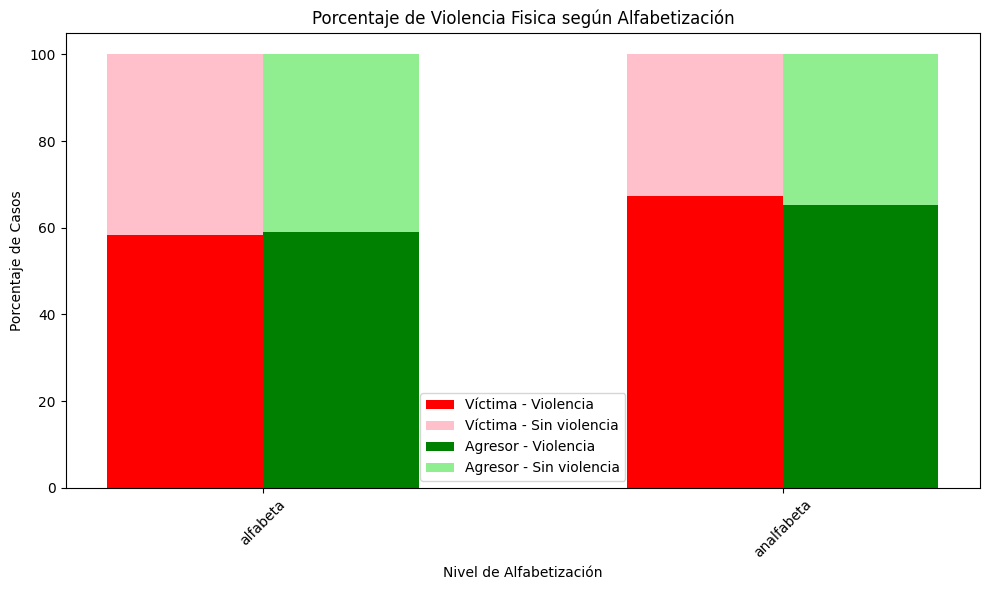

VIC_ALFAB              alfabeta  analfabeta  ignorado
VIOLENCIA_PSICOLOGICA                                
no presente               48180       15169       442
presente                 328217       72000      2014
VIC_ALFAB               alfabeta  analfabeta  ignorado
VIOLENCIA_PSICOLOGICA                                 
no presente            10.338568    3.254997  0.094845
presente               70.429508   15.449914  0.432168
AGR_ALFAB              alfabeta  analfabeta  ignorado
VIOLENCIA_PSICOLOGICA                                
no presente               51076       10479      2236
presente                 345071       48991      8169
AGR_ALFAB               alfabeta  analfabeta  ignorado
VIOLENCIA_PSICOLOGICA                                 
no presente            10.959998    2.248606  0.479806
presente               74.046075   10.512594  1.752922
VIC_ALFAB               alfabeta
VIOLENCIA_PSICOLOGICA           
no presente            12.800315
presente               87.199

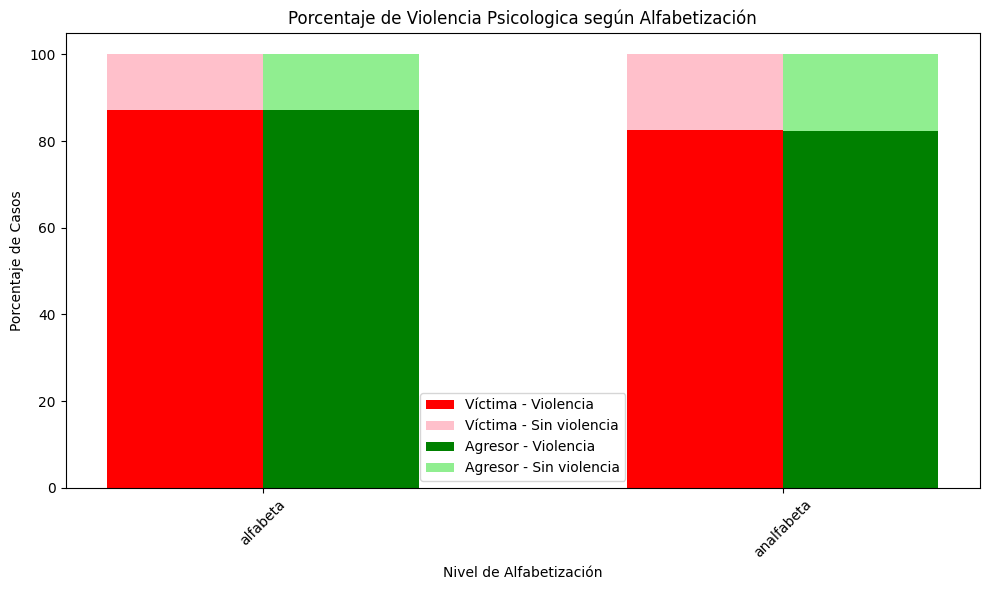

VIC_ALFAB         alfabeta  analfabeta  ignorado
VIOLENCIA_SEXUAL                                
no presente         366990       85222      2398
presente              9407        1947        58
VIC_ALFAB          alfabeta  analfabeta  ignorado
VIOLENCIA_SEXUAL                                 
no presente       78.749501   18.287119  0.514568
presente           2.018574    0.417791  0.012446
AGR_ALFAB         alfabeta  analfabeta  ignorado
VIOLENCIA_SEXUAL                                
no presente         386271       58158     10181
presente              9876        1312       224
AGR_ALFAB          alfabeta  analfabeta  ignorado
VIOLENCIA_SEXUAL                                 
no presente       82.886859   12.479668  2.184661
presente           2.119213    0.281532  0.048066
VIC_ALFAB          alfabeta
VIOLENCIA_SEXUAL           
no presente       97.500777
presente           2.499223
VIC_ALFAB         analfabeta
VIOLENCIA_SEXUAL            
no presente        97.766408
presente 

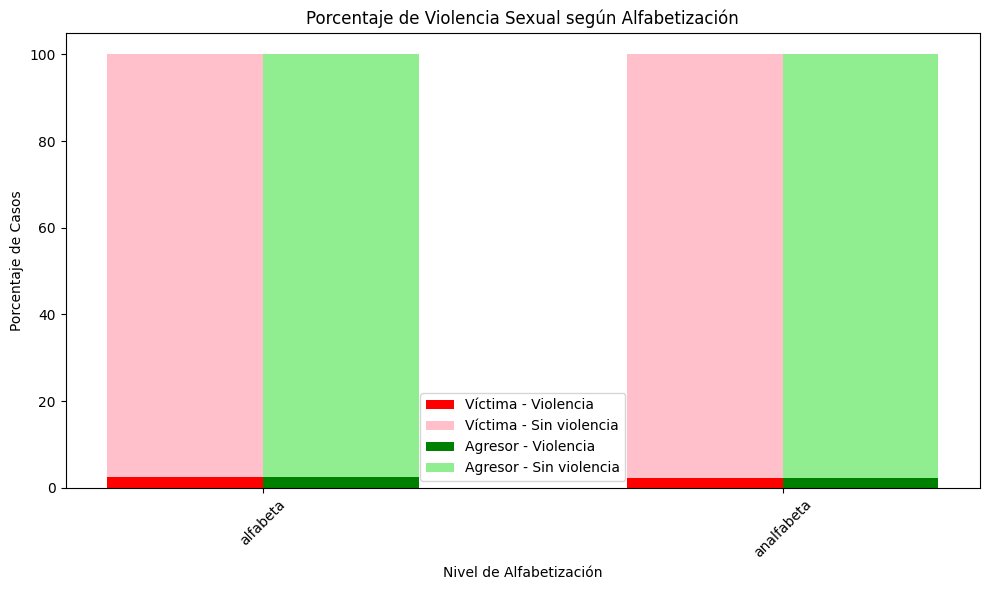

VIC_ALFAB              alfabeta  analfabeta  ignorado
VIOLENCIA_PATRIMONIAL                                
no presente              325577       75132      2258
presente                  50820       12037       198
VIC_ALFAB               alfabeta  analfabeta  ignorado
VIOLENCIA_PATRIMONIAL                                 
no presente            69.863011   16.121986  0.484526
presente               10.905065    2.582925  0.042487
AGR_ALFAB              alfabeta  analfabeta  ignorado
VIOLENCIA_PATRIMONIAL                                
no presente              341398       51923      9646
presente                  54749        7547       759
AGR_ALFAB               alfabeta  analfabeta  ignorado
VIOLENCIA_PATRIMONIAL                                 
no presente            73.257915   11.141749  2.069859
presente               11.748158    1.619451  0.162868
VIC_ALFAB               alfabeta
VIOLENCIA_PATRIMONIAL           
no presente            86.498298
presente               13.501

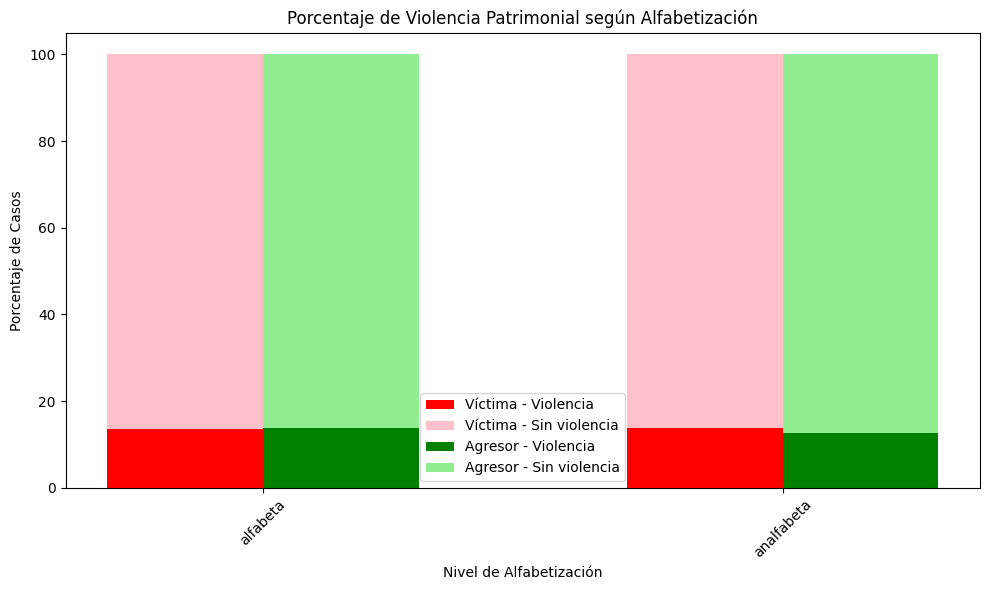

In [84]:
alfabeta_map = {
    "alfabeta": 0,
    "analfabeta": 1
}

# Función para calcular porcentaje de violencia
def get_percentage(df, col_esc, name, tipo_violencia):
    ct = pd.crosstab(df[col_esc], df[tipo_violencia]) / df.shape[0] * 100
    return [ct.values[0][1], ct.values[0][0], name]  # [% violencia, % no violencia, persona]

# Recorremos cada tipo de violencia
for violence_type in ['VIOLENCIA_FISICA', 'VIOLENCIA_PSICOLOGICA', 'VIOLENCIA_SEXUAL','VIOLENCIA_PATRIMONIAL']:
    print(pd.crosstab(df[violence_type], df["VIC_ALFAB"]))
    print(pd.crosstab(df[violence_type], df["VIC_ALFAB"])/df.shape[0]*100)
    # La violencia patrimonial y que la victima sea alfabeta se presenta en un 10.54% de los casos
    print(pd.crosstab(df[violence_type], df["AGR_ALFAB"]))
    print(pd.crosstab(df[violence_type], df["AGR_ALFAB"])/df.shape[0]*100)
    # La violencia patrimonial y que la victima sea analfabeta se presenta en un 2.58% de los casos
    print(pd.crosstab(df_vic_alfab[violence_type], df_vic_alfab["VIC_ALFAB"])/df_vic_alfab.shape[0]*100)
    # Dado que la victima es alfabeta la violencia patrimonial se presenta en un 13.11% de los casos
    print(pd.crosstab(df_vic_analfab[violence_type], df_vic_analfab["VIC_ALFAB"])/df_vic_analfab.shape[0]*100)
    # Dado que la victima es analfabeta la violencia patrimonial se presenta en un 13.76% de los casos
    print(pd.crosstab(df_ag_alfab[violence_type], df_ag_alfab["AGR_ALFAB"])/df_ag_alfab.shape[0]*100)
    # Dado que el agresor es alfabeta la violencia patrimonial se presenta en un 13.46% de los casos
    print(pd.crosstab(df_ag_analfab[violence_type], df_ag_analfab["AGR_ALFAB"])/df_ag_analfab.shape[0]*100)
    # Dado que el agresor es analfabeta la violencia patrimonial se presenta en un 12.45% de los casos
    # Recolectar datos
    data = []
    data += [["alfabeta"] + get_percentage(df_vic_alfab, "VIC_ALFAB", "víctima", violence_type)]
    data += [["analfabeta"] + get_percentage(df_vic_analfab, "VIC_ALFAB", "víctima", violence_type)]
    data += [["alfabeta"] + get_percentage(df_ag_alfab, "AGR_ALFAB", "agresor", violence_type)]
    data += [["analfabeta"] + get_percentage(df_ag_analfab, "AGR_ALFAB", "agresor", violence_type)]

    # Crear DataFrame
    plot_df = pd.DataFrame(data, columns=[
        "alfabetizacion_nivel",
        "porcentaje_violencia_presente", 
        "porcentaje_violencia_no_presente", 
        "persona"
    ])
    
    # Parámetros de posición
    alfabetos = list(alfabeta_map.keys())
    x = np.arange(len(alfabetos))  # Posiciones base para alfabeta/analfabeta
    width = 0.3  # Ancho de barras

    # Separar víctimas y agresores
    vic_df = plot_df[plot_df["persona"] == "víctima"].set_index("alfabetizacion_nivel").loc[alfabetos]
    ag_df = plot_df[plot_df["persona"] == "agresor"].set_index("alfabetizacion_nivel").loc[alfabetos]

    # Crear gráfico
    plt.figure(figsize=(10, 6))
    plt.bar(x - width/2, vic_df["porcentaje_violencia_presente"], width, label="Víctima - Violencia", color='red')
    plt.bar(x - width/2, vic_df["porcentaje_violencia_no_presente"], width,
            bottom=vic_df["porcentaje_violencia_presente"], label="Víctima - Sin violencia", color='pink')

    plt.bar(x + width/2, ag_df["porcentaje_violencia_presente"], width, label="Agresor - Violencia", color='green')
    plt.bar(x + width/2, ag_df["porcentaje_violencia_no_presente"], width,
            bottom=ag_df["porcentaje_violencia_presente"], label="Agresor - Sin violencia", color='lightgreen')

    # Etiquetas y diseño
    plt.xticks(x, alfabetos, rotation=45)
    plt.xlabel("Nivel de Alfabetización")
    plt.ylabel("Porcentaje de Casos")
    plt.title(f"Porcentaje de Violencia {violence_type.replace('VIOLENCIA_', '').capitalize()} según Alfabetización")
    plt.legend()
    plt.tight_layout()
    plt.show()


In [85]:
del df_vic_alfab
del df_vic_analfab
del df_ag_alfab
del df_ag_analfab

#### Tipo de agresion y escolaridad

In [86]:
df_vic_prim = df[df["VIC_NIV_ESCOLARIDAD"]=="primaria"]
df_vic_bas = df[df["VIC_NIV_ESCOLARIDAD"]=="basicos"]
df_vic_nin = df[df["VIC_NIV_ESCOLARIDAD"]=="ninguno"]
df_vic_diver = df[df["VIC_NIV_ESCOLARIDAD"]=="diversificado"]
df_vic_uni = df[df["VIC_NIV_ESCOLARIDAD"]=="universidad"]
df_ag_prim = df[df["AGR_NIV_ESCOLARIDAD"]=="primaria"]
df_ag_bas = df[df["AGR_NIV_ESCOLARIDAD"]=="basicos"]
df_ag_nin = df[df["AGR_NIV_ESCOLARIDAD"]=="ninguno"]
df_ag_diver = df[df["AGR_NIV_ESCOLARIDAD"]=="diversificado"]
df_ag_uni = df[df["AGR_NIV_ESCOLARIDAD"]=="universidad"]

0 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



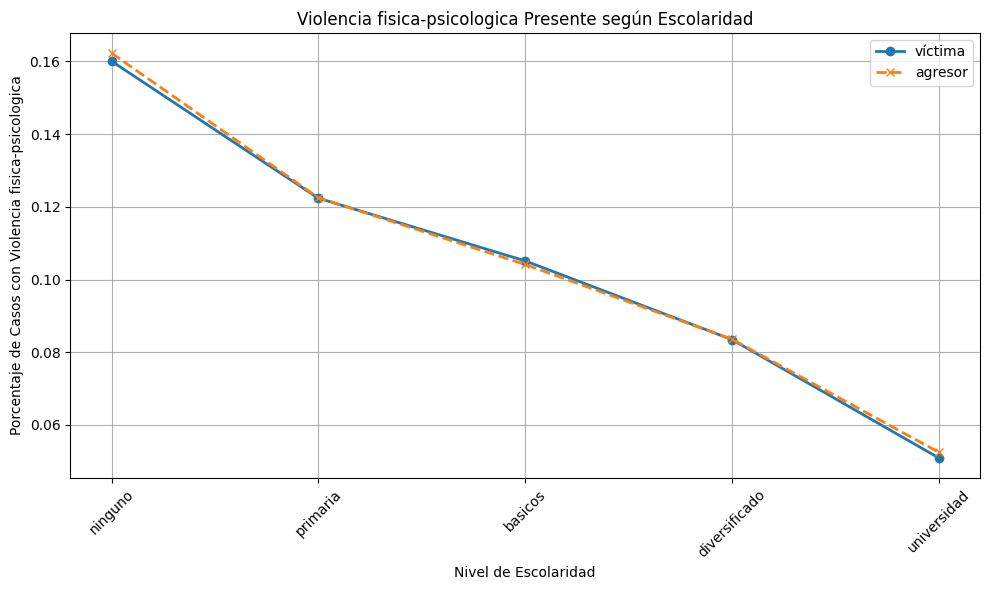

1 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

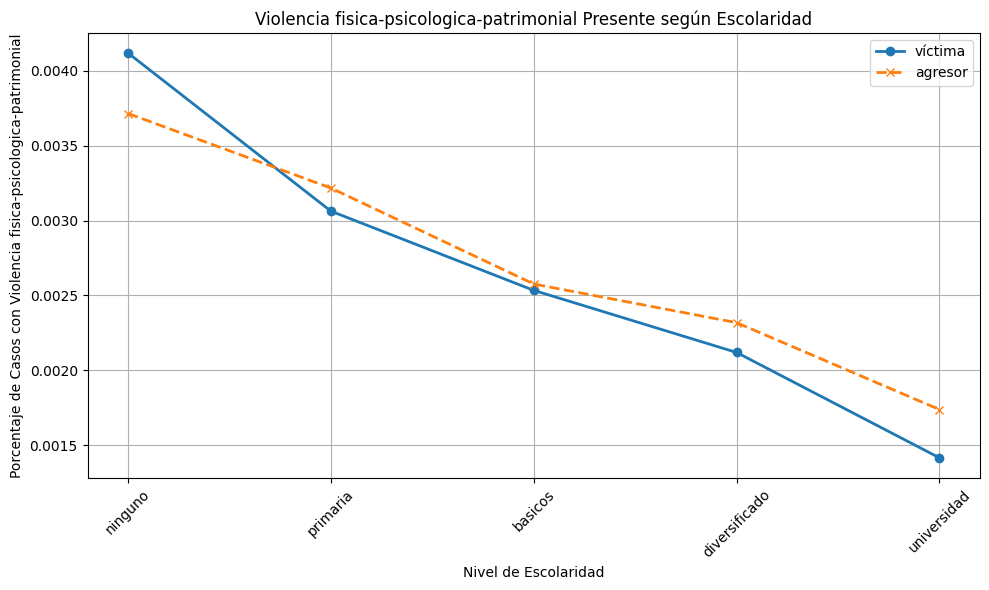

2 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

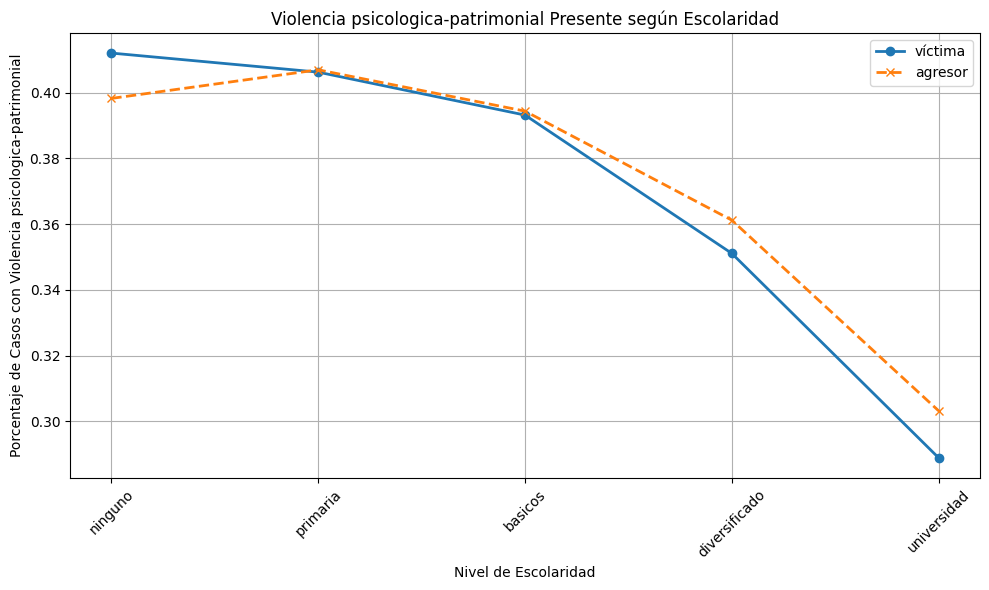

3 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

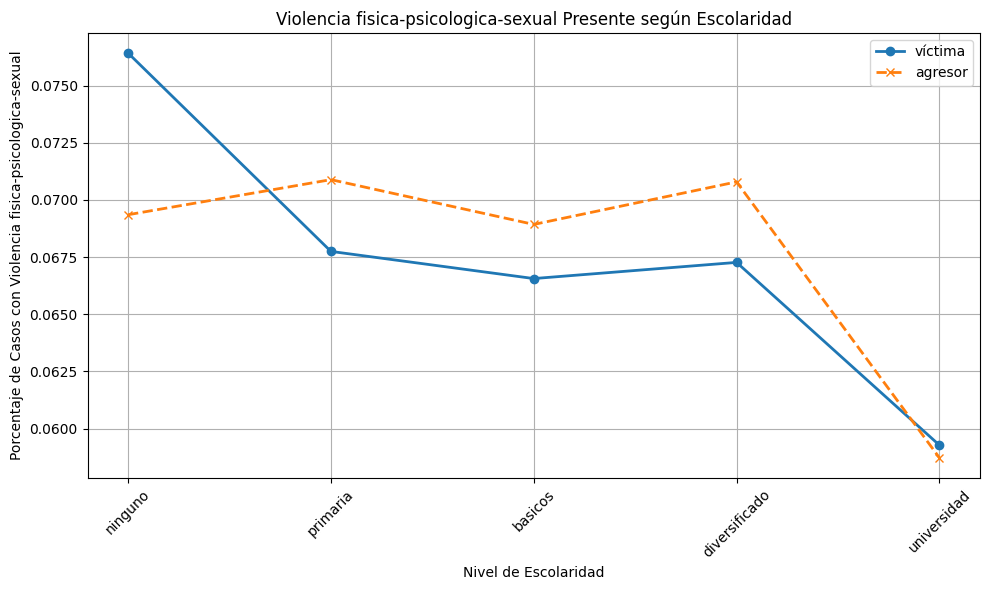

4 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

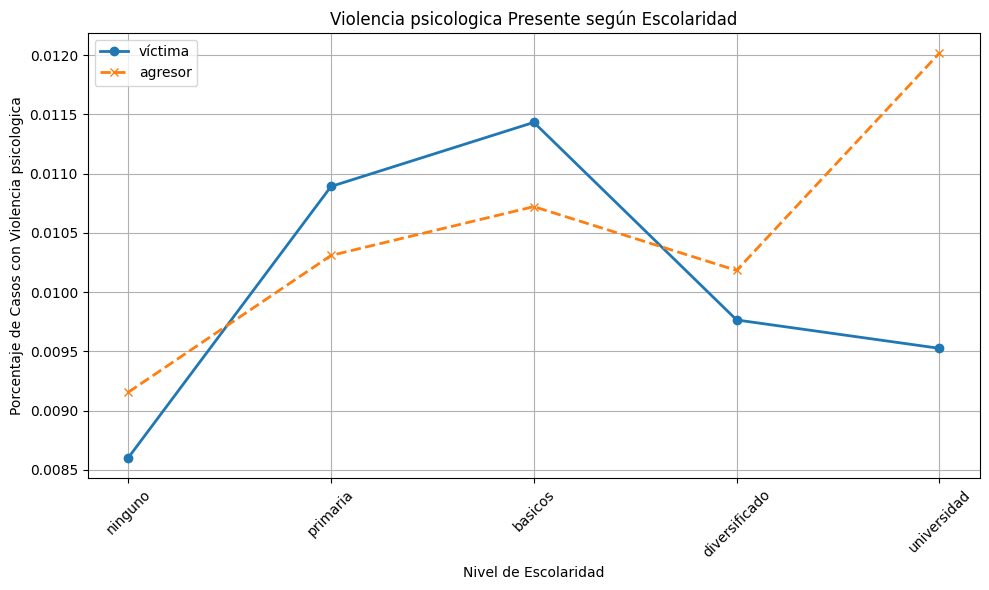

5 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

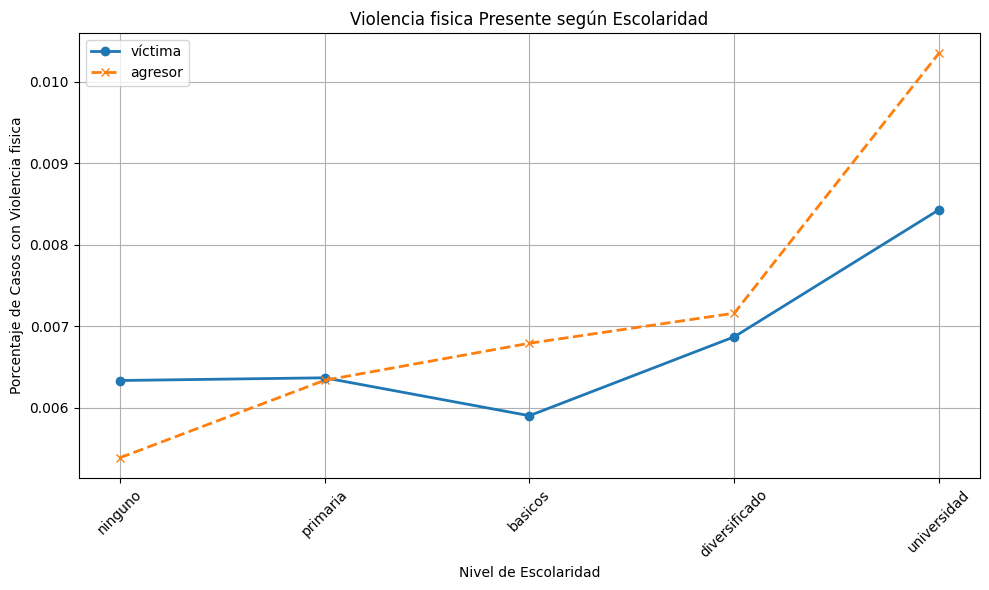

6 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

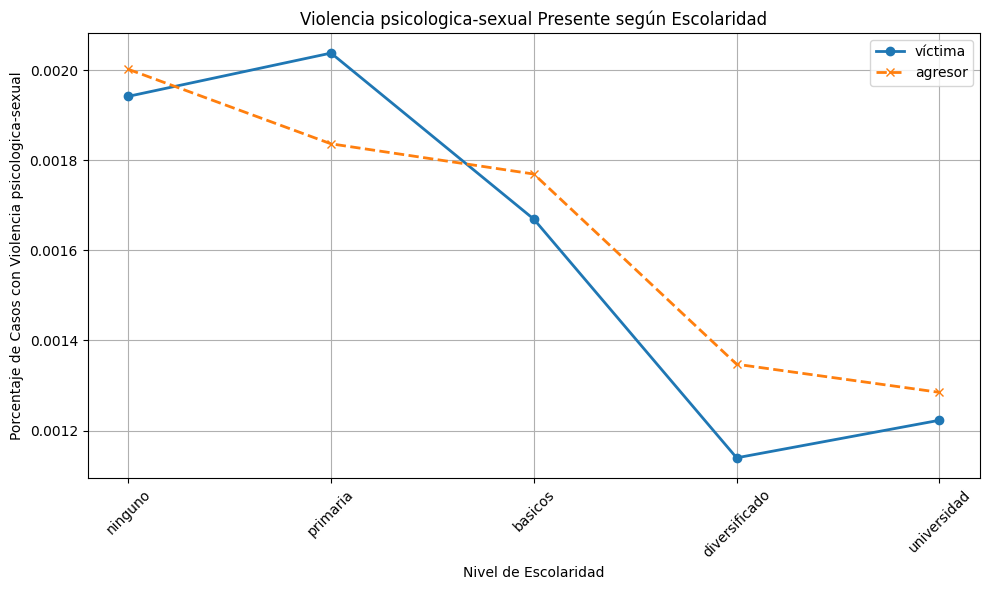

7 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

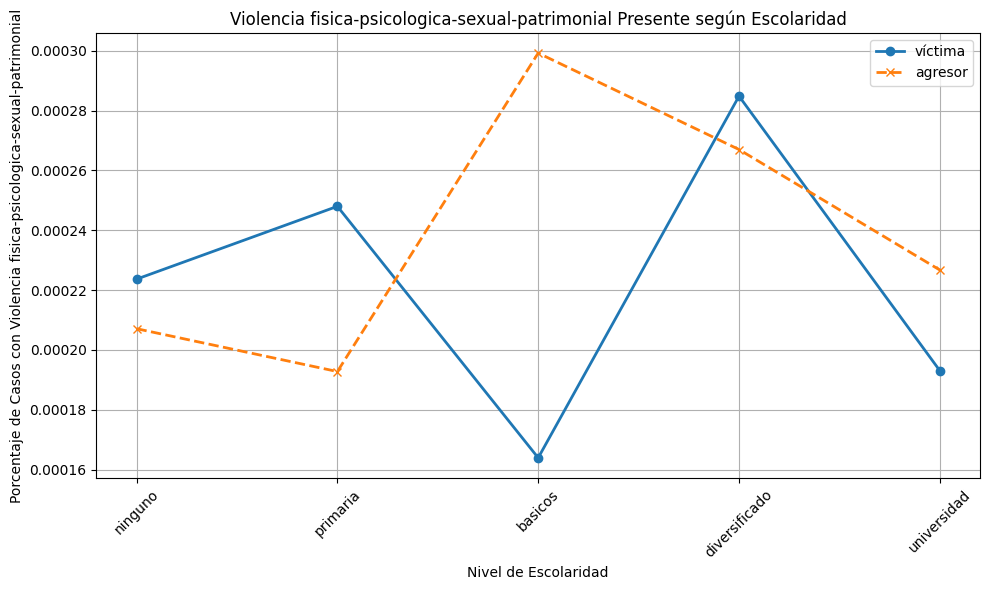

8 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

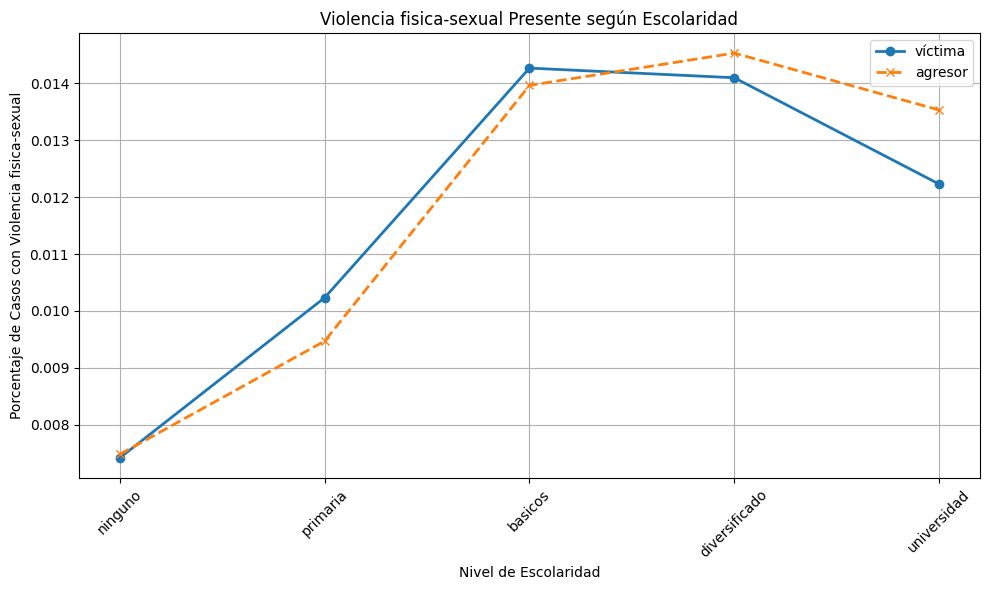

9 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   



<Figure size 1000x600 with 0 Axes>

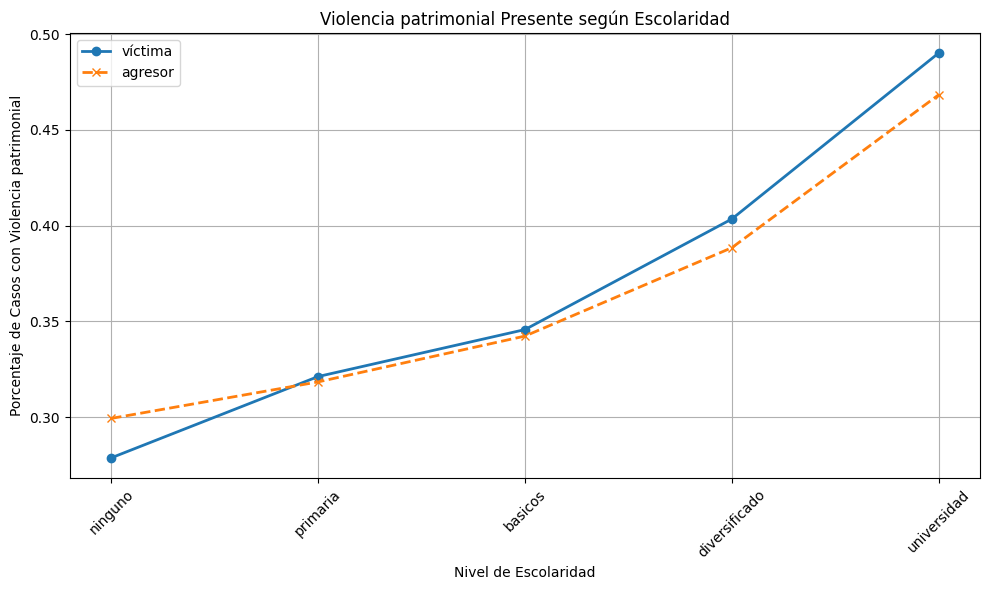

10 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   


<Figure size 1000x600 with 0 Axes>

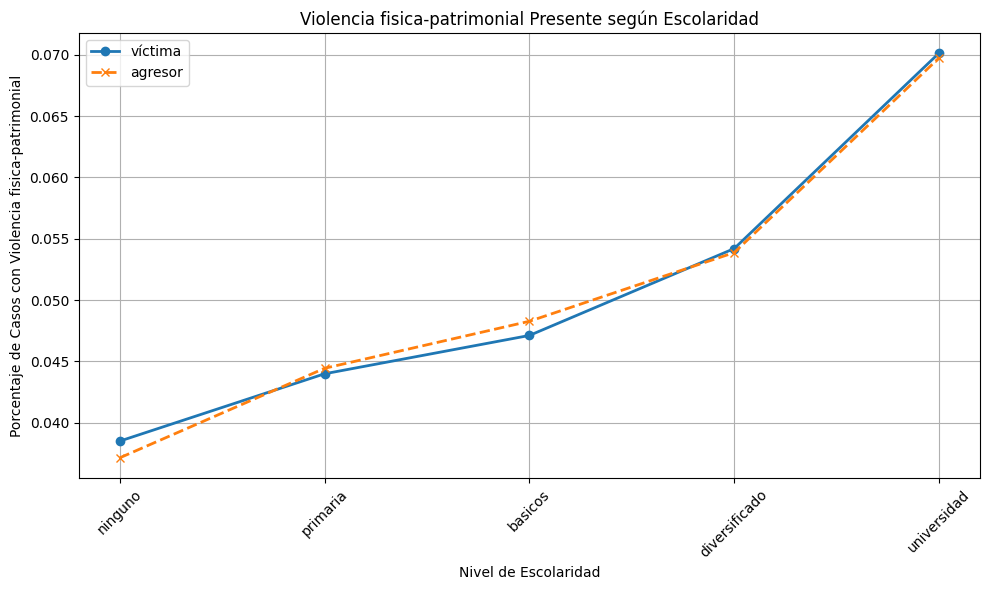

11 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   


<Figure size 1000x600 with 0 Axes>

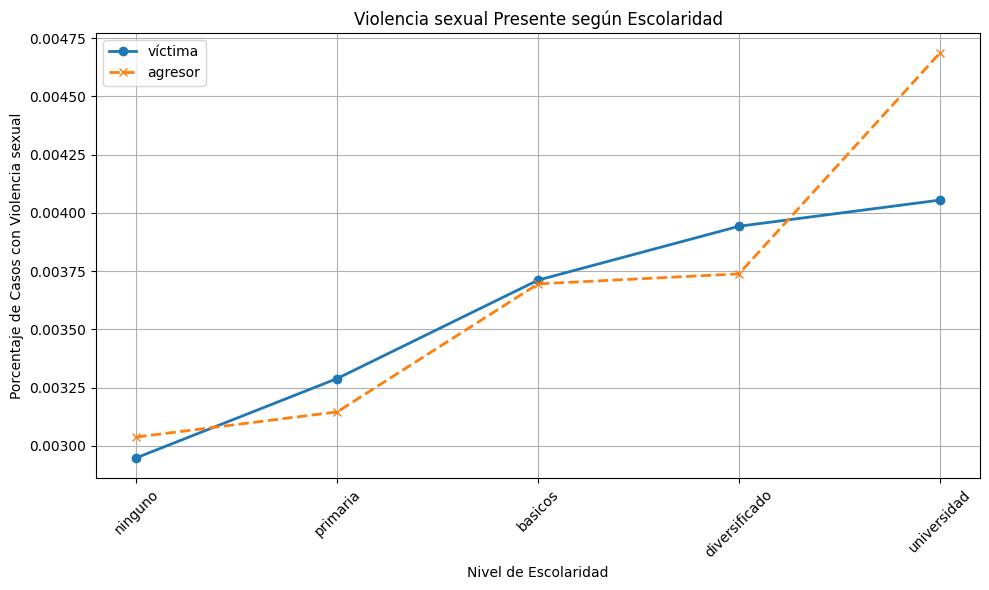

12 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   


<Figure size 1000x600 with 0 Axes>

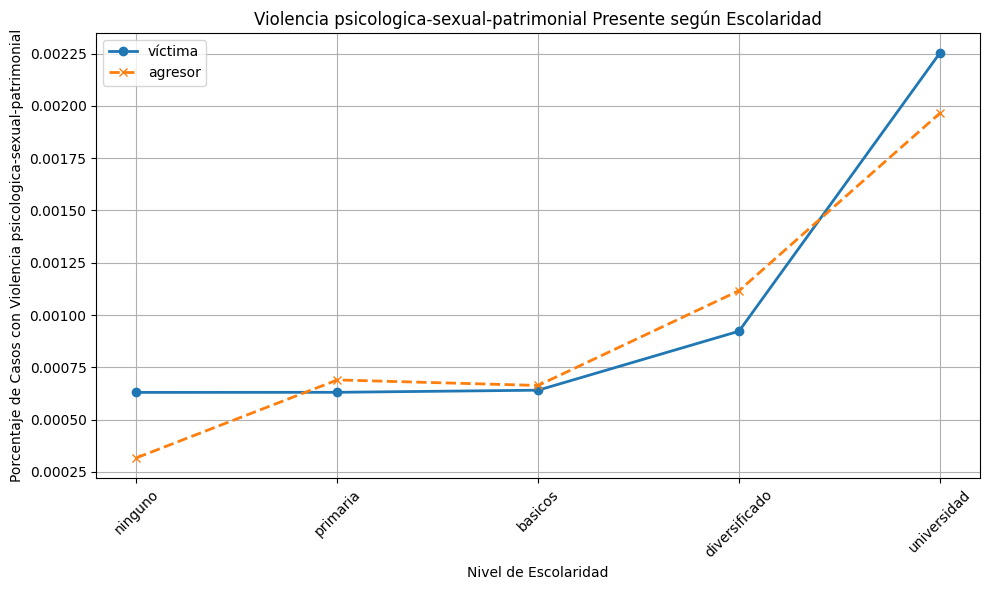

13 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   


<Figure size 1000x600 with 0 Axes>

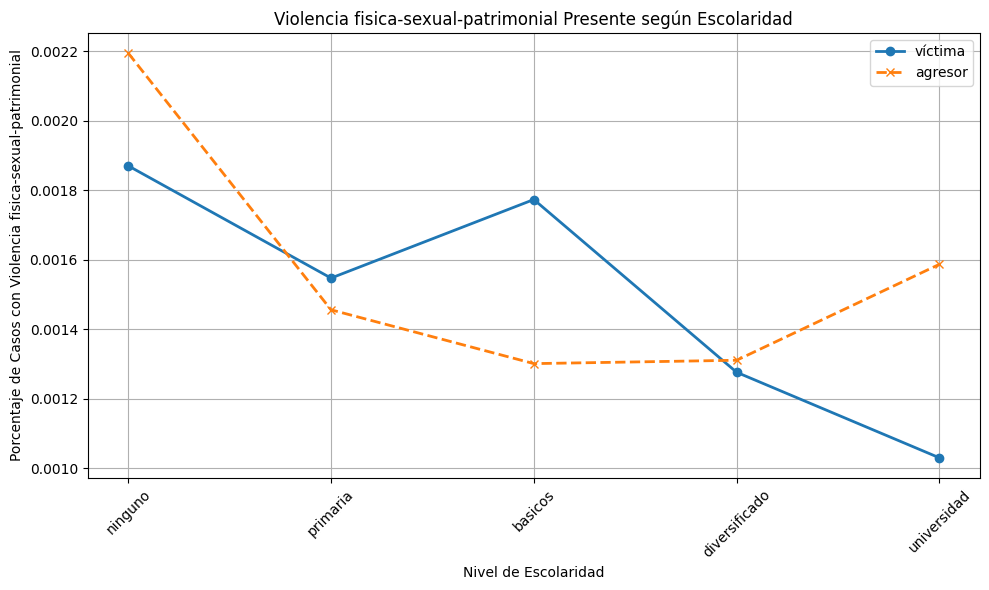

14 HEC_TIPAGRE            fisica  fisica-patrimonial  fisica-psicologica  \
VIC_NIV_ESCOLARIDAD                                                     
ninguno              0.160048            0.004118            0.412056   

HEC_TIPAGRE          fisica-psicologica-patrimonial  \
VIC_NIV_ESCOLARIDAD                                   
ninguno                                    0.076425   

HEC_TIPAGRE          fisica-psicologica-sexual  \
VIC_NIV_ESCOLARIDAD                              
ninguno                               0.008601   

HEC_TIPAGRE          fisica-psicologica-sexual-patrimonial  fisica-sexual  \
VIC_NIV_ESCOLARIDAD                                                         
ninguno                                           0.006334       0.001942   

HEC_TIPAGRE          fisica-sexual-patrimonial  patrimonial  psicologica  \
VIC_NIV_ESCOLARIDAD                                                        
ninguno                               0.000224     0.007422     0.278706   


<Figure size 1000x600 with 0 Axes>

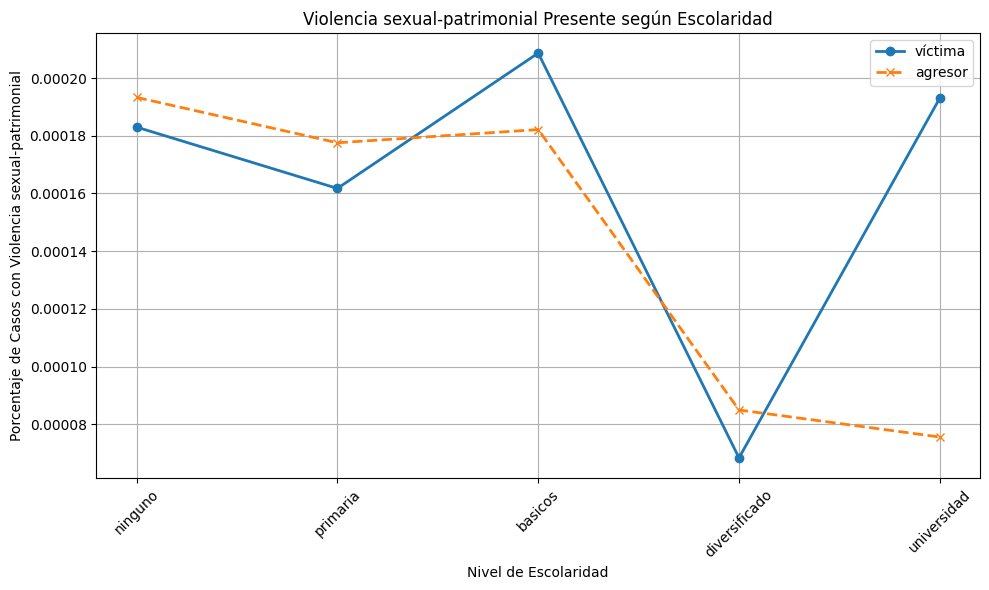

<Figure size 1000x600 with 0 Axes>

In [87]:
# print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_ESCOLARIDAD"]))
# print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_ESCOLARIDAD"])/df.shape[0]*100)
# La mayoría de los casos se distribuyen en física, física-psicológica y psicológica.
# En los casos de agresiones físicas 
    # el 5.60% sucede con una escolaridad de la víctima en básicos
    # el 6.16% ocurre con la víctima llegando a diversificado
    # el 3.32% ocurre cuando la víctima no tiene estudios
    # el 4.82% se explica con la víctima alcanzando la primaria
    # el 0.17% ocurre cuando la víctima llega a la universidad
# En los casos de agresiones física-psicológica
    # el 5.60% sucede cuando la víctima alcanza básicos
    # el 6.16 sucede cuando la víctima alcanza diversificado
    # el 8.29% ocurre cuando la víctima no tiene estudios
    # el 15.53% ocurre cuando la víctima alcanza la primaria
    # el 0.95% ocurre cuando la víctima alcanza la universidad
# En los casos de agresiones psicológicas
    # el 5.29% ocurre cuando la víctima alcanza b
# print(pd.crosstab(df["HEC_TIPAGRE"], df["AGR_ESCOLARIDAD"]))
# print(pd.crosstab(df["HEC_TIPAGRE"], df["AGR_ESCOLARIDAD"])/df.shape[0]*100)
# print(pd.crosstab(df["HEC_TIPAGRE"], [df["VIC_ESCOLARIDAD"], df["AGR_ESCOLARIDAD"]]))
# print(pd.crosstab(df["HEC_TIPAGRE"], [df["VIC_ESCOLARIDAD"], df["AGR_ESCOLARIDAD"]])/df.shape[0]*100)
# Define escolaridad en orden numérico
escolaridad_map = {
    "ninguno": 0,
    "primaria": 1,
    "basicos": 2,
    "diversificado": 3,
    "universidad": 4
}
# Extraer los porcentajes de violencia física (valor 1 en la columna)
def get_percentage(df, col_esc, name, tipo_violencia, index):
    ct = pd.crosstab(df[col_esc], df[tipo_violencia], normalize='all')
    print(index, ct)
    return [escolaridad_map[ct.index[0]], ct.values[0][index], name]  # [nivel, % violencia, % no violencia, tipo persona]
    
for index, tipo_agre in enumerate(df["HEC_TIPAGRE"].unique()):
    # Construir lista de puntos para víctimas y agresores
    data = []
    data += [get_percentage(df_vic_nin, "VIC_NIV_ESCOLARIDAD", "víctima", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_vic_prim, "VIC_NIV_ESCOLARIDAD", "víctima", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_vic_bas, "VIC_NIV_ESCOLARIDAD", "víctima", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_vic_diver, "VIC_NIV_ESCOLARIDAD", "víctima", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_vic_uni, "VIC_NIV_ESCOLARIDAD", "víctima", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_ag_nin, "AGR_NIV_ESCOLARIDAD", "agresor", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_ag_prim, "AGR_NIV_ESCOLARIDAD", "agresor", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_ag_bas, "AGR_NIV_ESCOLARIDAD", "agresor", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_ag_diver, "AGR_NIV_ESCOLARIDAD", "agresor", "HEC_TIPAGRE", index)]
    data += [get_percentage(df_ag_uni, "AGR_NIV_ESCOLARIDAD", "agresor", "HEC_TIPAGRE", index)]
    # Crear DataFrame para graficar
    plot_df = pd.DataFrame(data, columns=[
        "escolaridad_nivel", 
        "porcentaje_violencia_presente", 
        "persona"
    ])
    # print(plot_df)
    # Primer gráfico: Porcentaje de violencia psicológica PRESENTE
    plt.figure(figsize=(10, 6))
    subset = plot_df[plot_df["persona"] == "víctima"].sort_values("escolaridad_nivel")
    plt.plot(subset["escolaridad_nivel"], subset["porcentaje_violencia_presente"],
                 marker='o', label=f"víctima", linestyle='-', linewidth=2)
    subset = plot_df[plot_df["persona"] == "agresor"].sort_values("escolaridad_nivel")
    plt.plot(subset["escolaridad_nivel"], subset["porcentaje_violencia_presente"],
                 marker='x', label=f"agresor", linestyle='--', linewidth=2)
    plt.xticks(list(escolaridad_map.values()), list(escolaridad_map.keys()), rotation=45)
    plt.xlabel("Nivel de Escolaridad")
    plt.ylabel(f"Porcentaje de Casos con Violencia {tipo_agre}")
    plt.title(f"Violencia {tipo_agre} Presente según Escolaridad")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.figure(figsize=(10, 6))

VIC_NIV_ESCOLARIDAD  basicos  diversificado  ignorado  ninguno  primaria  \
VIOLENCIA_FISICA                                                           
no presente            27738          41949      4932    32483     70670   
presente               39357          45818      6856    65875    114806   

VIC_NIV_ESCOLARIDAD  universidad  
VIOLENCIA_FISICA                  
no presente                 9013  
presente                    6525  
VIC_NIV_ESCOLARIDAD   basicos  diversificado  ignorado    ninguno   primaria  \
VIOLENCIA_FISICA                                                               
no presente          5.952080       9.001506  1.058319   6.970272  15.164520   
presente             8.445309       9.831725  1.471175  14.135599  24.635318   

VIC_NIV_ESCOLARIDAD  universidad  
VIOLENCIA_FISICA                  
no presente             1.934029  
presente                1.400148  
AGR_NIV_ESCOLARIDAD  basicos  diversificado  ignorado  ninguno  primaria  \
VIOLENCIA_FISICA  

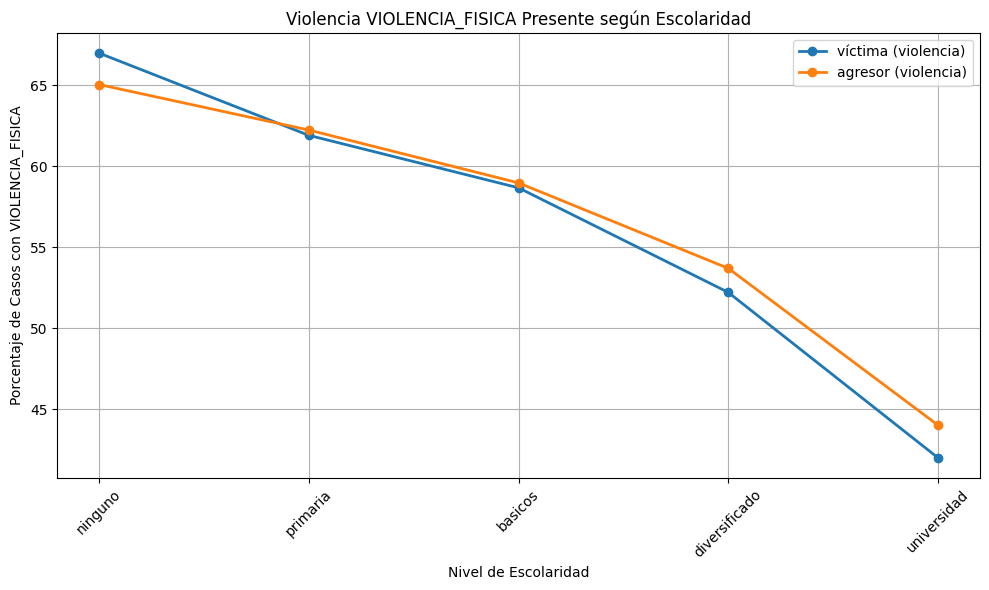

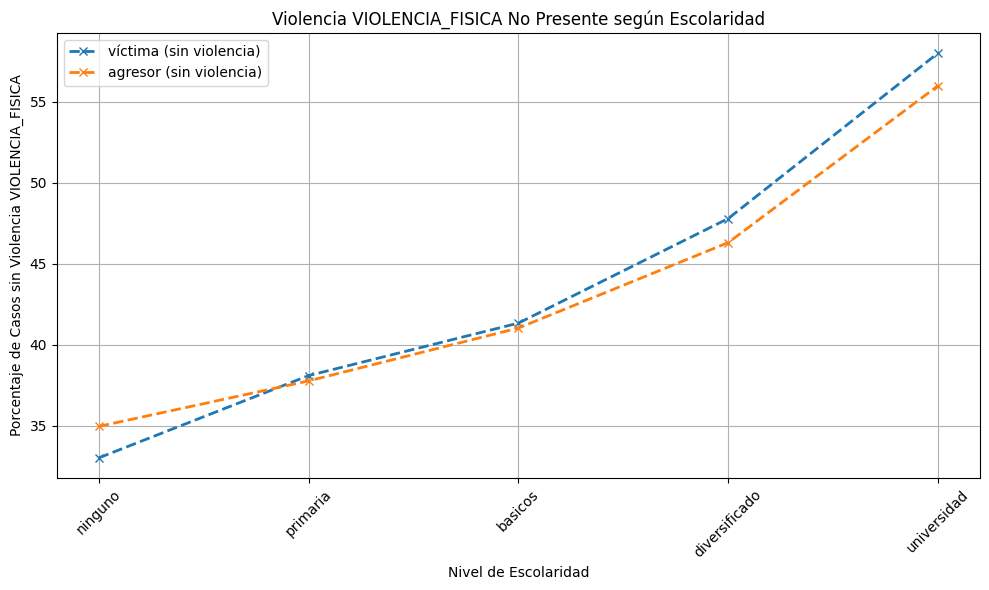

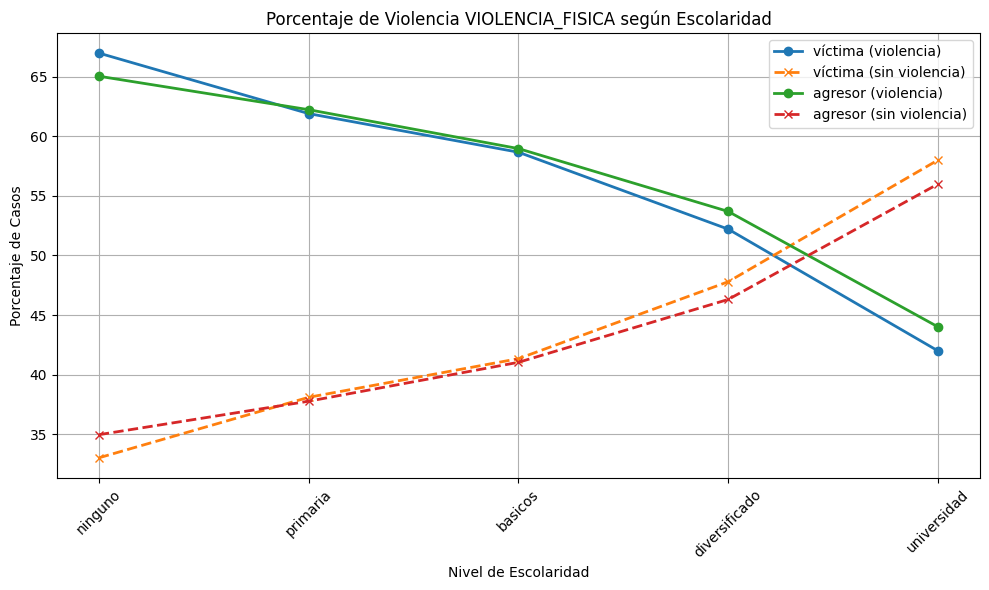

VIC_NIV_ESCOLARIDAD    basicos  diversificado  ignorado  ninguno  primaria  \
VIOLENCIA_PSICOLOGICA                                                        
no presente               8437           8994      2120    17292     25903   
presente                 58658          78773      9668    81066    159573   

VIC_NIV_ESCOLARIDAD    universidad  
VIOLENCIA_PSICOLOGICA               
no presente                   1045  
presente                     14493  
VIC_NIV_ESCOLARIDAD      basicos  diversificado  ignorado    ninguno  \
VIOLENCIA_PSICOLOGICA                                                  
no presente             1.810430       1.929952  0.454914   3.710554   
presente               12.586959      16.903279  2.074580  17.395316   

VIC_NIV_ESCOLARIDAD     primaria  universidad  
VIOLENCIA_PSICOLOGICA                          
no presente             5.558321     0.224238  
presente               34.241516     3.109939  
AGR_NIV_ESCOLARIDAD    basicos  diversificado  ignorado  n

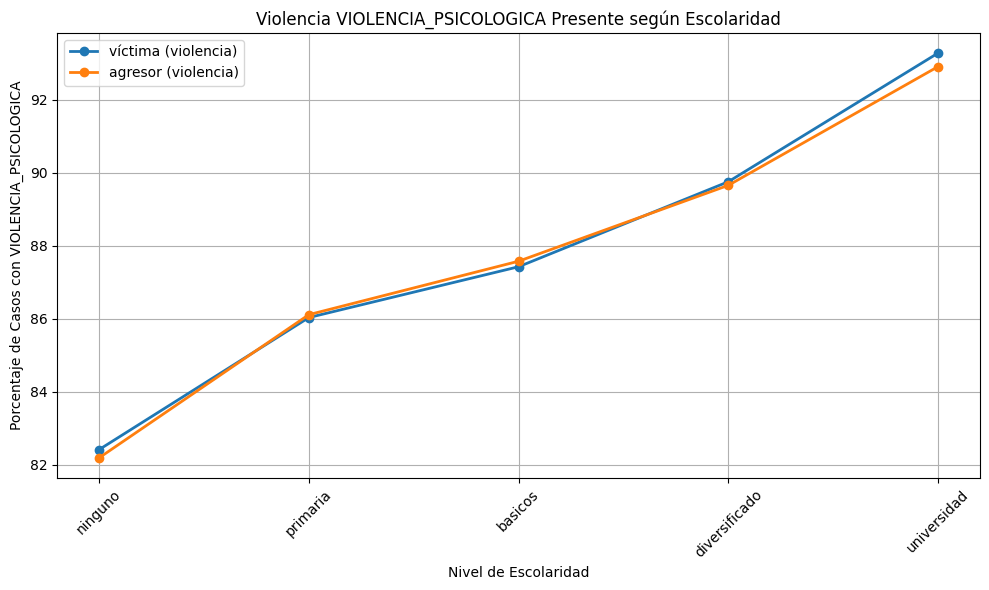

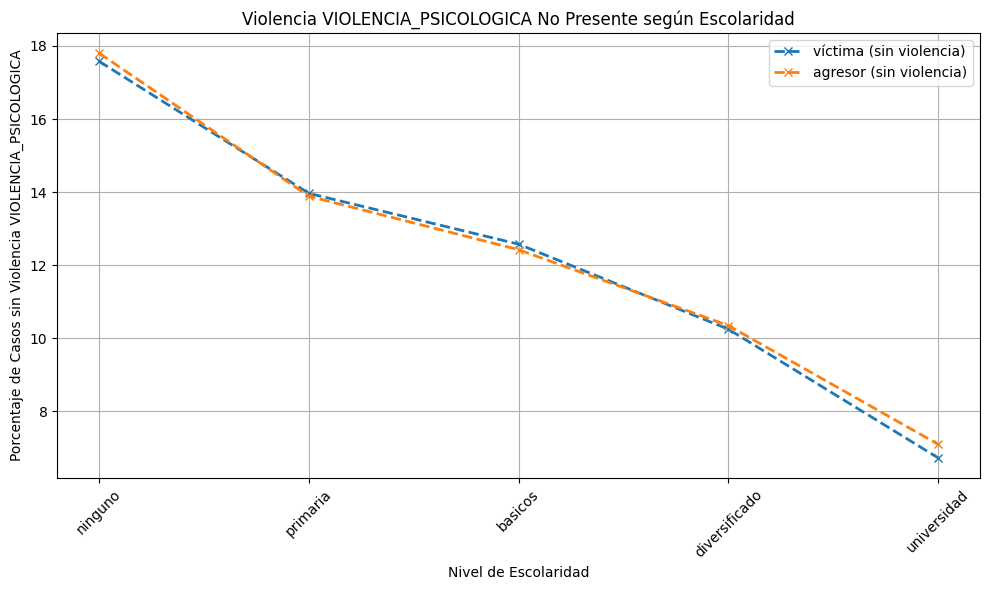

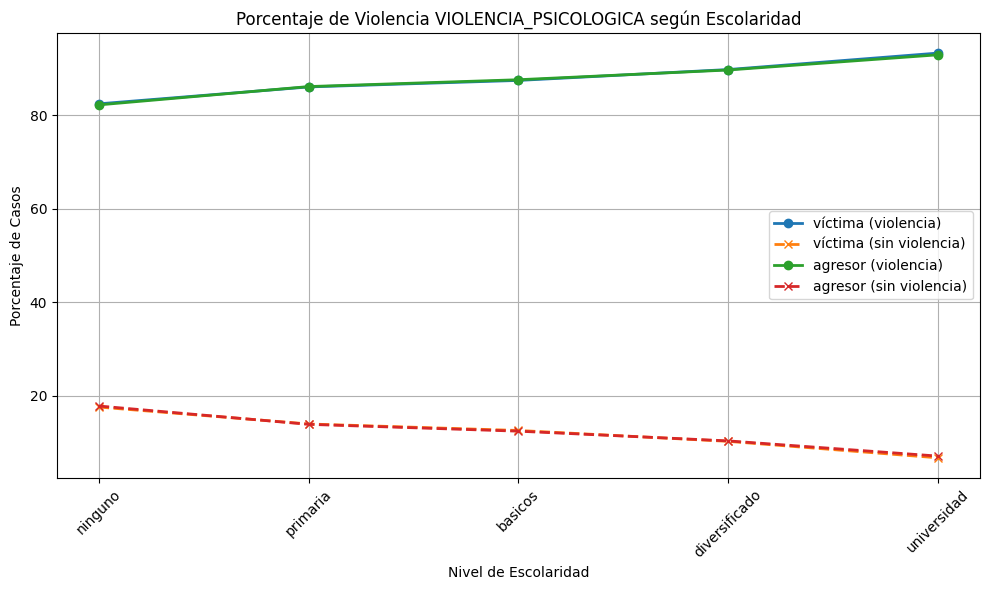

VIC_NIV_ESCOLARIDAD  basicos  diversificado  ignorado  ninguno  primaria  \
VIOLENCIA_SEXUAL                                                           
no presente            65384          85637     11540    96122    180807   
presente                1711           2130       248     2236      4669   

VIC_NIV_ESCOLARIDAD  universidad  
VIOLENCIA_SEXUAL                  
no presente                15120  
presente                     418  
VIC_NIV_ESCOLARIDAD    basicos  diversificado  ignorado    ninguno   primaria  \
VIOLENCIA_SEXUAL                                                                
no presente          14.030239      18.376171  2.476278  20.626065  38.797954   
presente              0.367150       0.457060  0.053216   0.479806   1.001884   

VIC_NIV_ESCOLARIDAD  universidad  
VIOLENCIA_SEXUAL                  
no presente             3.244482  
presente                0.089695  
AGR_NIV_ESCOLARIDAD  basicos  diversificado  ignorado  ninguno  primaria  \
VIOLENCIA_SEXU

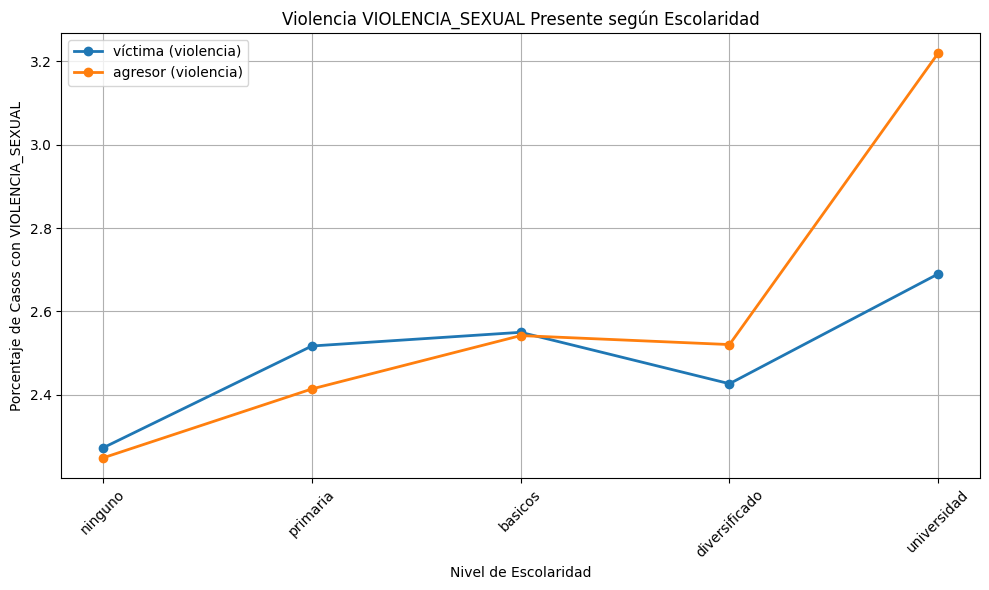

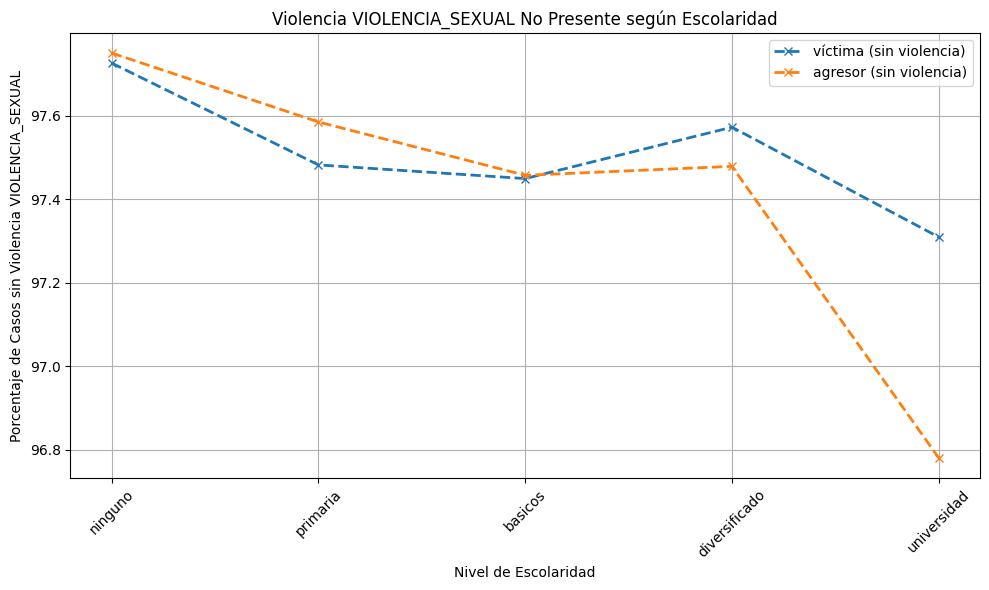

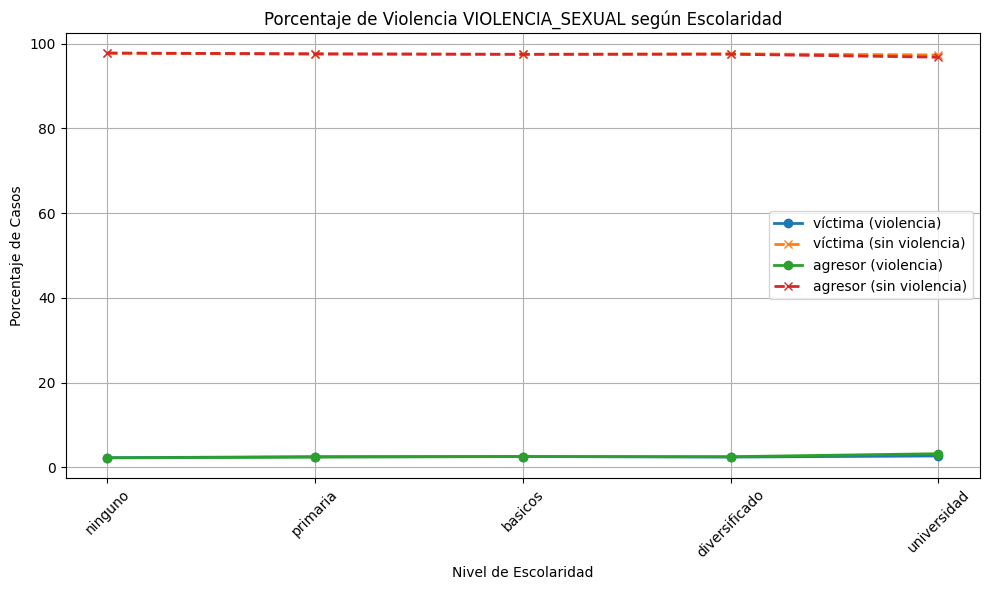

VIC_NIV_ESCOLARIDAD    basicos  diversificado  ignorado  ninguno  primaria  \
VIOLENCIA_PATRIMONIAL                                                        
no presente              57877          74968     10872    85195    160912   
presente                  9218          12799       916    13163     24564   

VIC_NIV_ESCOLARIDAD    universidad  
VIOLENCIA_PATRIMONIAL               
no presente                  13143  
presente                      2395  
VIC_NIV_ESCOLARIDAD      basicos  diversificado  ignorado    ninguno  \
VIOLENCIA_PATRIMONIAL                                                  
no presente            12.419371      16.086794  2.332937  18.281326   
presente                1.978018       2.746437  0.196557   2.824545   

VIC_NIV_ESCOLARIDAD     primaria  universidad  
VIOLENCIA_PATRIMONIAL                          
no presente            34.528842     2.820253  
presente                5.270996     0.513924  
AGR_NIV_ESCOLARIDAD    basicos  diversificado  ignorado  n

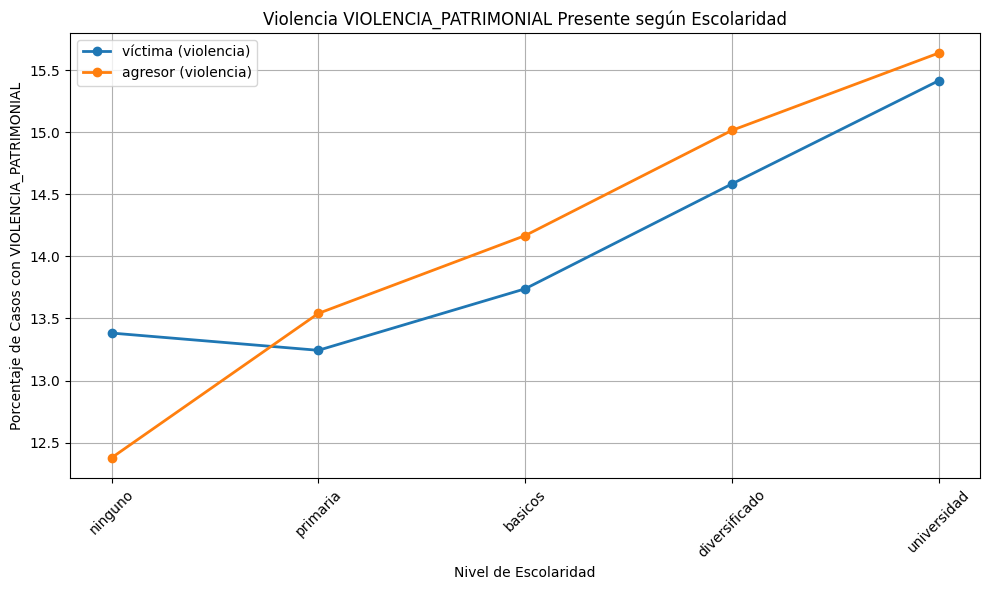

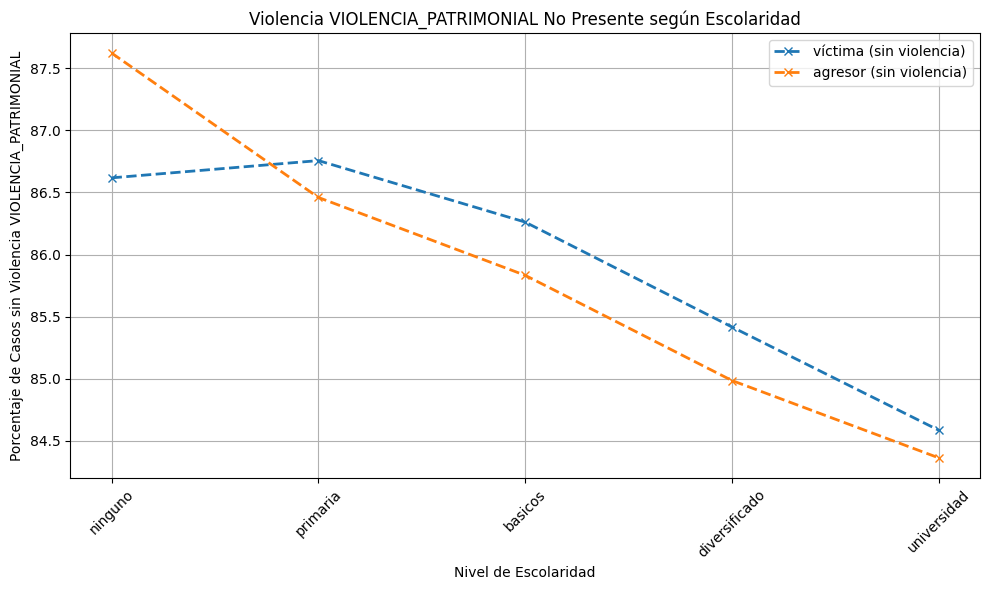

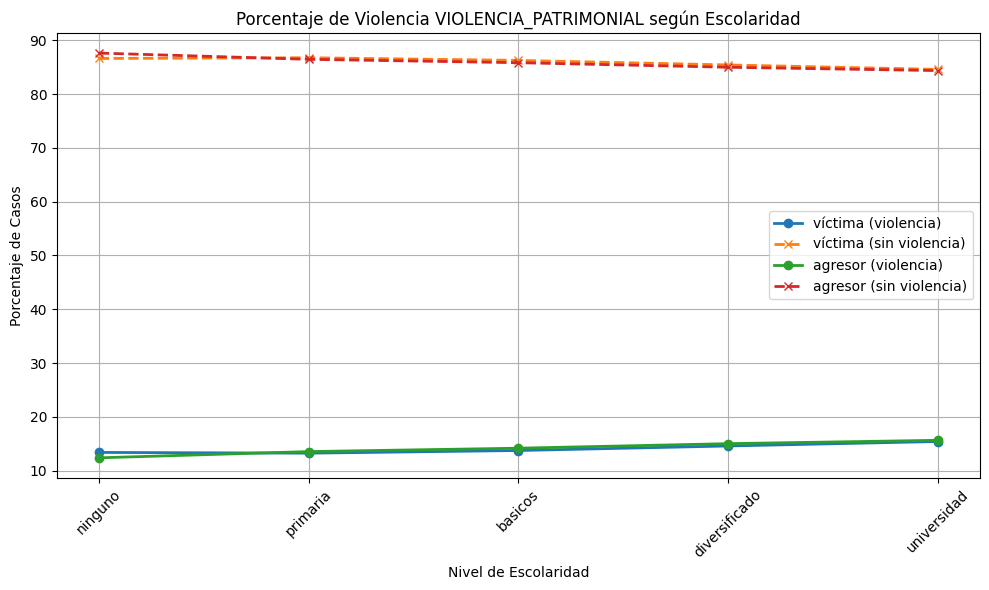

In [88]:
for violence_type in ['VIOLENCIA_FISICA', 'VIOLENCIA_PSICOLOGICA', 'VIOLENCIA_SEXUAL','VIOLENCIA_PATRIMONIAL']:
    print(pd.crosstab(df[violence_type], df["VIC_NIV_ESCOLARIDAD"]))
    print(pd.crosstab(df[violence_type], df["VIC_NIV_ESCOLARIDAD"])/df.shape[0]*100)
    print(pd.crosstab(df[violence_type], df["AGR_NIV_ESCOLARIDAD"]))
    print(pd.crosstab(df[violence_type], df["AGR_NIV_ESCOLARIDAD"])/df.shape[0]*100)
    print(pd.crosstab(df[violence_type], [df["VIC_NIV_ESCOLARIDAD"], df["AGR_NIV_ESCOLARIDAD"]]))
    print(pd.crosstab(df[violence_type], [df["VIC_NIV_ESCOLARIDAD"], df["AGR_NIV_ESCOLARIDAD"]])/df.shape[0]*100)
    print(pd.crosstab(df_vic_prim["VIC_NIV_ESCOLARIDAD"], df_vic_prim[violence_type])/df_vic_prim.shape[0]*100)
    print(pd.crosstab(df_ag_prim["AGR_NIV_ESCOLARIDAD"], df_ag_prim[violence_type])/df_ag_prim.shape[0]*100)
    # Cuando el agresor o la víctima tiene un nivel de escolaridad de primaria ocurriran casos de violencia psicológica un 85% de las veces
    print(pd.crosstab(df_vic_bas["VIC_NIV_ESCOLARIDAD"], df_vic_bas[violence_type])/df_vic_bas.shape[0]*100)
    print(pd.crosstab(df_ag_bas["AGR_ESCOLARIDAD"], df_ag_bas[violence_type])/df_ag_bas.shape[0]*100)
    # Cuando el agresor o la víctima tiene un nivel de escolaridad de primaria ocurriran casos de violencia psicológica un 85% de las veces
    print(pd.crosstab(df_vic_diver["VIC_NIV_ESCOLARIDAD"], df_vic_diver[violence_type])/df_vic_diver.shape[0]*100)
    print(pd.crosstab(df_ag_diver["AGR_NIV_ESCOLARIDAD"], df_ag_diver[violence_type])/df_ag_diver.shape[0]*100)
    # 
    print(pd.crosstab(df_vic_uni["VIC_NIV_ESCOLARIDAD"], df_vic_uni[violence_type])/df_vic_uni.shape[0]*100)
    print(pd.crosstab(df_ag_uni["AGR_NIV_ESCOLARIDAD"], df_ag_uni[violence_type])/df_ag_uni.shape[0]*100)
    print(pd.crosstab(df_vic_nin["VIC_NIV_ESCOLARIDAD"], df_vic_nin[violence_type])/df_vic_nin.shape[0]*100)
    print(pd.crosstab(df_ag_nin["AGR_NIV_ESCOLARIDAD"], df_ag_nin[violence_type])/df_ag_nin.shape[0]*100)
    
    # Define escolaridad en orden numérico
    escolaridad_map = {
        "ninguno": 0,
        "primaria": 1,
        "basicos": 2,
        "diversificado": 3,
        "universidad": 4
    }
    
    # Extraer los porcentajes de violencia física (valor 1 en la columna)
    def get_percentage(df, col_esc, name, tipo_violencia):
        ct = pd.crosstab(df[col_esc], df[tipo_violencia])/df.shape[0]*100
        return [escolaridad_map[ct.index[0]], ct.values[0][1], ct.values[0][0], name]  # [nivel, % violencia, % no violencia, tipo persona]
    
    # Construir lista de puntos para víctimas y agresores
    data = []
    data += [get_percentage(df_vic_nin, "VIC_NIV_ESCOLARIDAD", "víctima", violence_type)]
    data += [get_percentage(df_vic_prim, "VIC_NIV_ESCOLARIDAD", "víctima", violence_type)]
    data += [get_percentage(df_vic_bas, "VIC_NIV_ESCOLARIDAD", "víctima", violence_type)]
    data += [get_percentage(df_vic_diver, "VIC_NIV_ESCOLARIDAD", "víctima", violence_type)]
    data += [get_percentage(df_vic_uni, "VIC_NIV_ESCOLARIDAD", "víctima", violence_type)]
    data += [get_percentage(df_ag_nin, "AGR_NIV_ESCOLARIDAD", "agresor", violence_type)]
    data += [get_percentage(df_ag_prim, "AGR_NIV_ESCOLARIDAD", "agresor", violence_type)]
    data += [get_percentage(df_ag_bas, "AGR_NIV_ESCOLARIDAD", "agresor", violence_type)]
    data += [get_percentage(df_ag_diver, "AGR_NIV_ESCOLARIDAD", "agresor", violence_type)]
    data += [get_percentage(df_ag_uni, "AGR_NIV_ESCOLARIDAD", "agresor", violence_type)]
    
    # Crear DataFrame para graficar
    plot_df = pd.DataFrame(data, columns=[
        "escolaridad_nivel", 
        "porcentaje_violencia_presente", 
        "porcentaje_violencia_no_presente", 
        "persona"
    ])
    
    # Primer gráfico: Porcentaje de violencia psicológica PRESENTE
    plt.figure(figsize=(10, 6))
    for tipo in plot_df["persona"].unique():
        subset = plot_df[plot_df["persona"] == tipo].sort_values("escolaridad_nivel")
        plt.plot(subset["escolaridad_nivel"], subset["porcentaje_violencia_presente"],
                 marker='o', label=f"{tipo} (violencia)", linestyle='-', linewidth=2)
    
    plt.xticks(list(escolaridad_map.values()), list(escolaridad_map.keys()), rotation=45)
    plt.xlabel("Nivel de Escolaridad")
    plt.ylabel(f"Porcentaje de Casos con {violence_type}")
    plt.title(f"Violencia {violence_type} Presente según Escolaridad")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    
    # Segundo gráfico: Porcentaje de violencia psicológica NO PRESENTE
    plt.figure(figsize=(10, 6))
    for tipo in plot_df["persona"].unique():
        subset = plot_df[plot_df["persona"] == tipo].sort_values("escolaridad_nivel")
        plt.plot(subset["escolaridad_nivel"], subset["porcentaje_violencia_no_presente"],
                 marker='x', label=f"{tipo} (sin violencia)", linestyle='--', linewidth=2)
    
    plt.xticks(list(escolaridad_map.values()), list(escolaridad_map.keys()), rotation=45)
    plt.xlabel("Nivel de Escolaridad")
    plt.ylabel(f"Porcentaje de Casos sin Violencia {violence_type}")
    plt.title(f"Violencia {violence_type} No Presente según Escolaridad")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    # Graficar
    plt.figure(figsize=(10, 6))
    
    
    # Dibujar scatter + líneas por tipo de persona
    for tipo in plot_df["persona"].unique():
        subset = plot_df[plot_df["persona"] == tipo].sort_values("escolaridad_nivel")
        # Línea para % con violencia
        plt.plot(subset["escolaridad_nivel"], subset["porcentaje_violencia_presente"], 
                 marker='o', label=f"{tipo} (violencia)", linestyle='-', linewidth=2)
        # Línea para % sin violencia
        plt.plot(subset["escolaridad_nivel"], subset["porcentaje_violencia_no_presente"], 
                 marker='x', label=f"{tipo} (sin violencia)", linestyle='--', linewidth=2)
    
    plt.xticks(list(escolaridad_map.values()), list(escolaridad_map.keys()), rotation=45)
    plt.xlabel("Nivel de Escolaridad")
    plt.ylabel("Porcentaje de Casos")
    plt.title(f"Porcentaje de Violencia {violence_type} según Escolaridad")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [89]:
del df_vic_prim 
del df_vic_bas 
del df_vic_nin 
del df_vic_diver
del df_vic_uni 
del df_ag_prim 
del df_ag_bas 
del df_ag_nin 
del df_ag_diver
del df_ag_uni
del escolaridad_map

#### Tipo de agresion y grupo etnico

In [90]:
df_vic_lad = df[df["VIC_GRUPET"]=='ladinos(as)']
df_vic_may = df[df["VIC_GRUPET"]=='maya']
df_vic_otr = df[df["VIC_GRUPET"]=='otro']
df_vic_xink = df[df["VIC_GRUPET"]=='xinka']
df_vic_gar = df[df["VIC_GRUPET"]=='garifuna']
df_ag_lad = df[df["AGR_GRUPET"]=='ladinos(as)']
df_ag_may = df[df["AGR_GRUPET"]=='maya']
df_ag_otr = df[df["AGR_GRUPET"]=='otro']
df_ag_xink = df[df["AGR_GRUPET"]=='xinka']
df_ag_gar = df[df["AGR_GRUPET"]=='garifuna']

dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='VIC_GRUPET')
dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='AGR_GRUPET')


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.loc[grupo][1],
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ct.loc[grupo][0], name])
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.lo

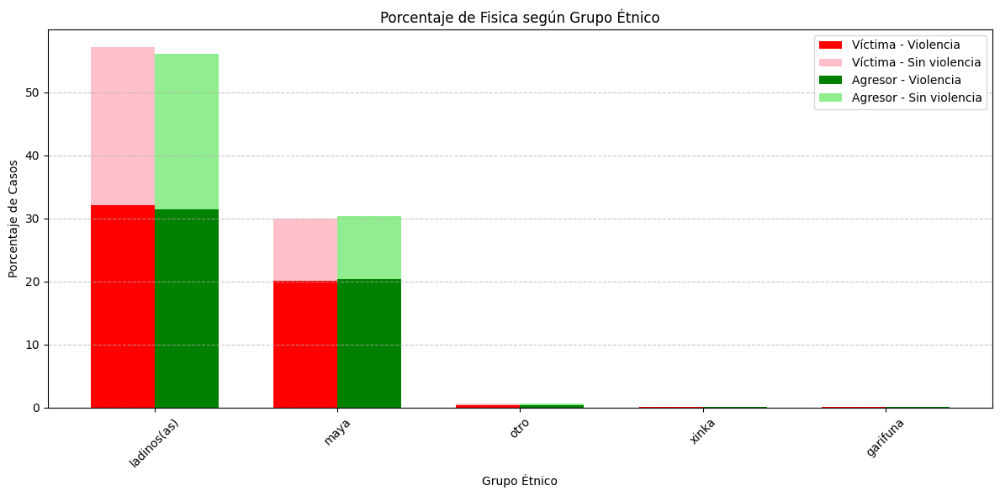

dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='VIC_GRUPET')
dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='AGR_GRUPET')


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.loc[grupo][1],
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ct.loc[grupo][0], name])
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.lo

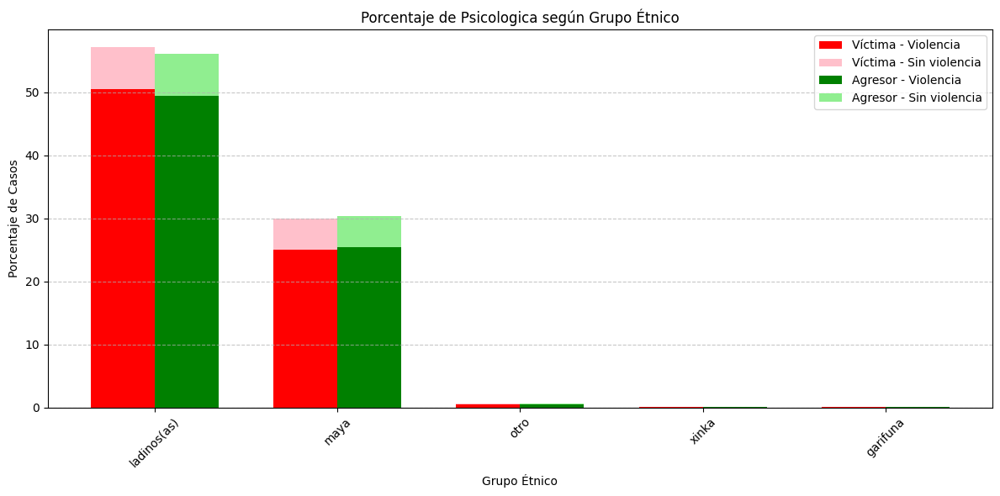

dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='VIC_GRUPET')
dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='AGR_GRUPET')


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.loc[grupo][1],
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ct.loc[grupo][0], name])
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.lo

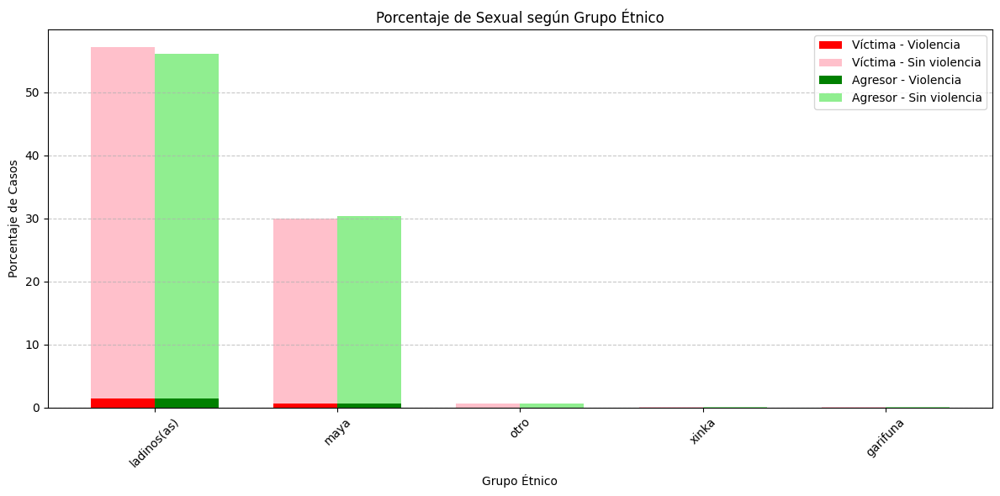

dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='VIC_GRUPET')
dict_keys(['ladinos(as)', 'maya', 'otro', 'xinka', 'garifuna'])
Index(['garifuna', 'ignorado', 'ladinos(as)', 'maya', 'no indica', 'otro',
       'xinka'],
      dtype='object', name='AGR_GRUPET')


C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.loc[grupo][1],
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ct.loc[grupo][0], name])
C:\Users\diego\AppData\Local\Temp\ipykernel_10884\1522652198.py:19: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results.append([grupo, ct.lo

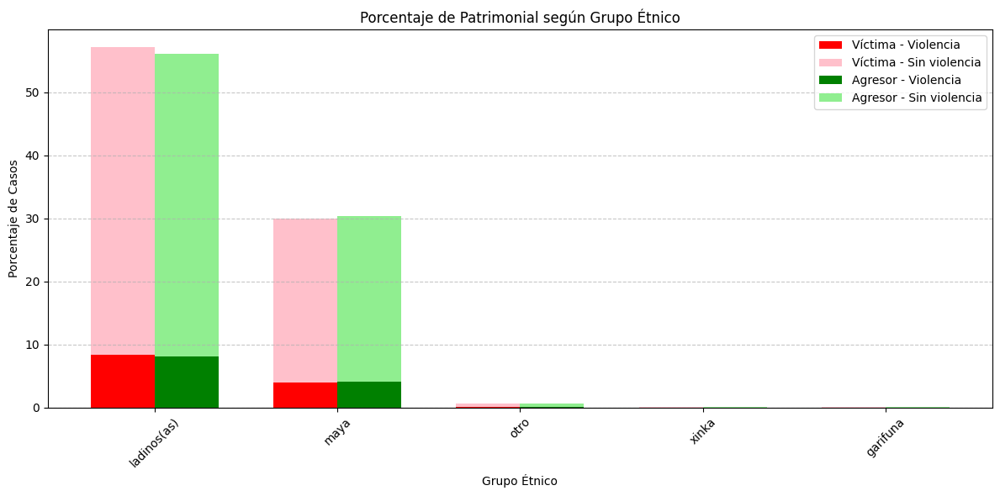

In [91]:
# Mapeo del grupo étnico
grupoet_map = {
    "ladinos(as)": 0,
    "maya": 1,
    "otro": 2,
    "xinka": 3,
    "garifuna": 4,
}

# Función para calcular porcentaje de violencia por grupo
def get_percentage(df, col_grupo, name, tipo_violencia):
    ct = pd.crosstab(df[col_grupo], df[tipo_violencia]) / df.shape[0] * 100
    results = []
    print(grupoet_map.keys())
    print(ct.index)
    for grupo in grupoet_map.keys():
        if grupo in ct.index:
            
            results.append([grupo, ct.loc[grupo][1],
                            ct.loc[grupo][0], name])
        else:
            results.append([grupo, 0, 0, name])
    return results

# Recorremos cada tipo de violencia
for violence_type in ['VIOLENCIA_FISICA', 'VIOLENCIA_PSICOLOGICA', 'VIOLENCIA_SEXUAL','VIOLENCIA_PATRIMONIAL']:
    data = []
    data += get_percentage(df, "VIC_GRUPET", "víctima", violence_type)
    data += get_percentage(df, "AGR_GRUPET", "agresor", violence_type)
    # print(data)
    # Crear DataFrame
    plot_df = pd.DataFrame(data, columns=[
        "grupo_etnico",
        "porcentaje_violencia_presente", 
        "porcentaje_violencia_no_presente", 
        "persona"
    ])

    # Posiciones y configuración
    grupos = list(grupoet_map.keys())
    x = np.arange(len(grupos))
    width = 0.35

    # Separar por rol
    vic_df = plot_df[plot_df["persona"] == "víctima"].set_index("grupo_etnico").loc[grupos]
    ag_df = plot_df[plot_df["persona"] == "agresor"].set_index("grupo_etnico").loc[grupos]

    # Crear gráfico
    plt.figure(figsize=(12, 6))
    plt.bar(x - width/2, vic_df["porcentaje_violencia_presente"], width, label="Víctima - Violencia", color='red')
    plt.bar(x - width/2, vic_df["porcentaje_violencia_no_presente"], width,
            bottom=vic_df["porcentaje_violencia_presente"], label="Víctima - Sin violencia", color='pink')

    plt.bar(x + width/2, ag_df["porcentaje_violencia_presente"], width, label="Agresor - Violencia", color='green')
    plt.bar(x + width/2, ag_df["porcentaje_violencia_no_presente"], width,
            bottom=ag_df["porcentaje_violencia_presente"], label="Agresor - Sin violencia", color='lightgreen')

    # Etiquetas y diseño
    plt.xticks(x, grupos, rotation=45)
    plt.xlabel("Grupo Étnico")
    plt.ylabel("Porcentaje de Casos")
    plt.title(f"Porcentaje de {violence_type.replace('VIOLENCIA_', '').capitalize()} según Grupo Étnico")
    plt.legend()
    plt.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


In [92]:
print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_GRUPET"]))
print(pd.crosstab(df["HEC_TIPAGRE"], df["VIC_GRUPET"])/df.shape[0]*100)
print(pd.crosstab(df["HEC_TIPAGRE"], df["AGR_GRUPET"]))
print(pd.crosstab(df["HEC_TIPAGRE"], df["AGR_GRUPET"])/df.shape[0]*100)
print(pd.crosstab(df["HEC_TIPAGRE"], [df["VIC_GRUPET"], df["AGR_GRUPET"]]))
print(pd.crosstab(df["HEC_TIPAGRE"], [df["VIC_GRUPET"], df["AGR_GRUPET"]])/df.shape[0]*100)

VIC_GRUPET                             garifuna  ignorado  ladinos(as)   maya  \
HEC_TIPAGRE                                                                     
fisica                                       54      1123        25558  20763   
fisica-patrimonial                            1        36          659    526   
fisica-psicologica                          223      2614        99557  58927   
fisica-psicologica-patrimonial               96       322        18302  11172   
fisica-psicologica-sexual                    12        82         2984   1185   
fisica-psicologica-sexual-patrimonial         8        63         1853    862   
fisica-sexual                                 0        21          496    216   
fisica-sexual-patrimonial                     0         0           64     29   
patrimonial                                   2        50         3743    824   
psicologica                                 214      2723        97239  38932   
psicologica-patrimonial     

In [93]:
df.columns[58:92]

Index(['ESTACIONES_DE_BOMBEROS_POR_DEPARTAMENTO',
       'CANTIDAD_PNC_POR_DEPARTAMENTO',
       'CANTIDAD_ORGANISMO_JUDICIAL_POR_DEPARTAMENTO',
       'CANTIDAD_IDDP_POR_DEPARTAMENTO', 'CANTIDAD_SALAS_MIXTAS',
       'CANTIDAD_TRIBUNALES_DE_SENTENCIA',
       'CANTIDAD_JUZGADOS_PRIMERA_INSTANCIA_PENAL',
       'CANTIDAD_JUZGADOS_PRIMERA_INSTANCIA_PENAL_NARCOACTIVIDAD_DELITOS_AMBIENTE',
       'CANTIDAD_JUZGADOS_ADOLESCENTES_Y_NINEZ', 'CANTIDAD_JUZGADOS_EJECUCION',
       'CANTIDAD_JUZGADOS_PAZ_PENAL_COMUNITARIOS',
       'CANTIDAD_JUZGADOS_VIOLENCIA_CONTRA_MUJ_FEMINICIDIO',
       'CANTIDAD_TRIBUNALES_SENTENCIA_VIOLENCIA_CONTRA_MUJ_FEMINICIDIO',
       'CANTIDAD_JUZGADOS_TRIBUNALES_MAYOR_RIESGO',
       'CANTIDAD_FISCALIAS_REGIONALES', 'CANTIDAD_FISCALIAS_DISTRITALES',
       'CANTIDAD_FISCALIAS_MUNICIPALES', 'CANTIDAD_AGENCIAS_FISCALES',
       'CANTIDAD_COORDINADORA_DEPARTAMENTAL',
       'CANTIDAD_COORDINADORA_MUNICIPAL', 'CANTIDAD_SECCIONES_ESPECIALES',
       'CANTIDAD_COMISARIAS

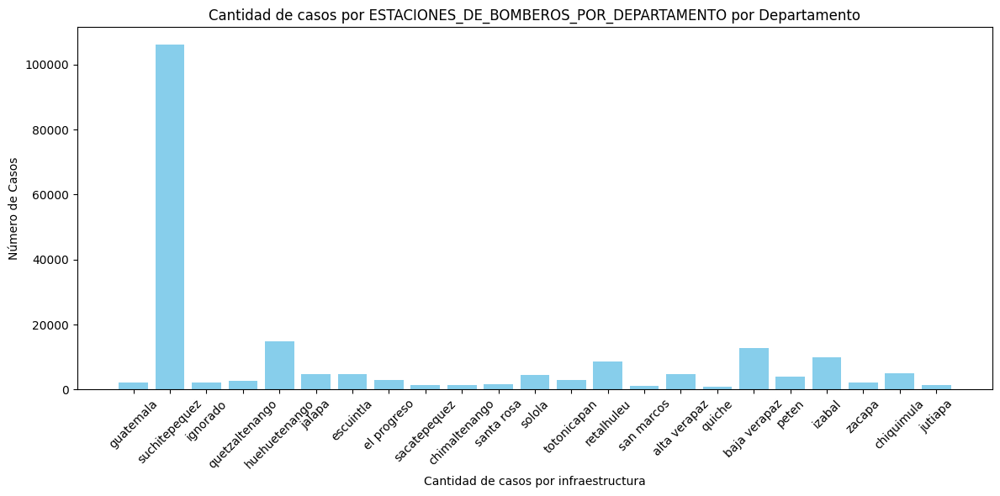

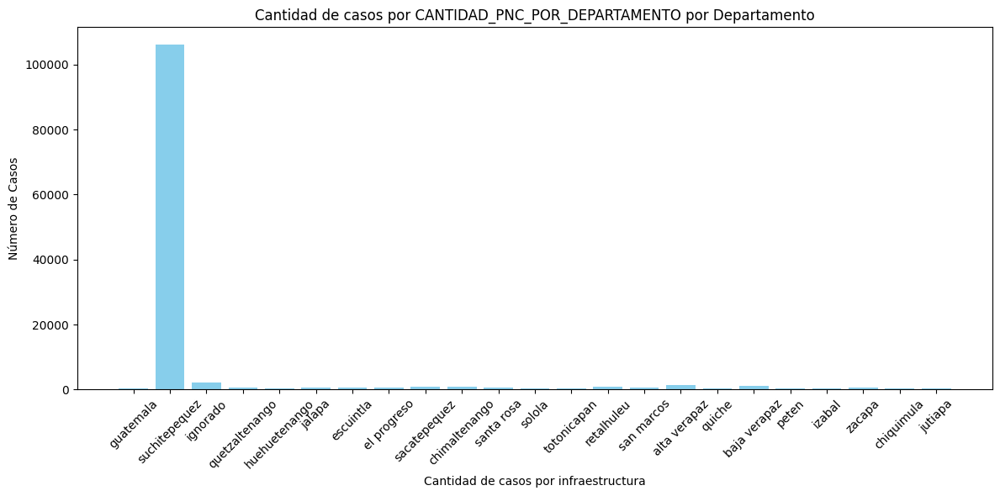

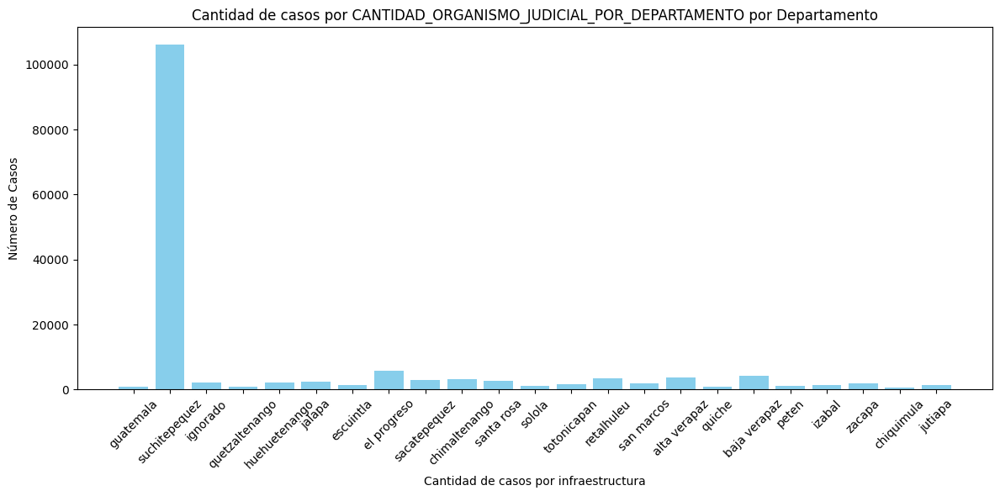

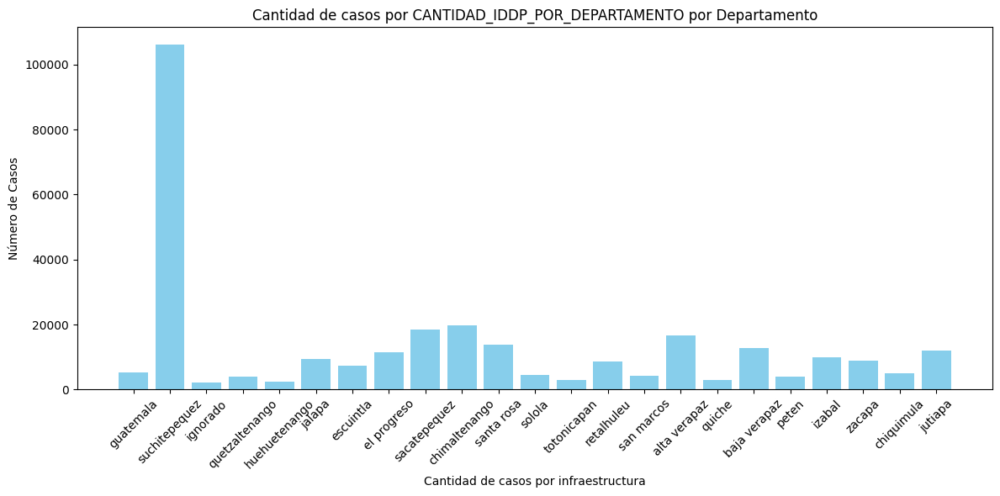

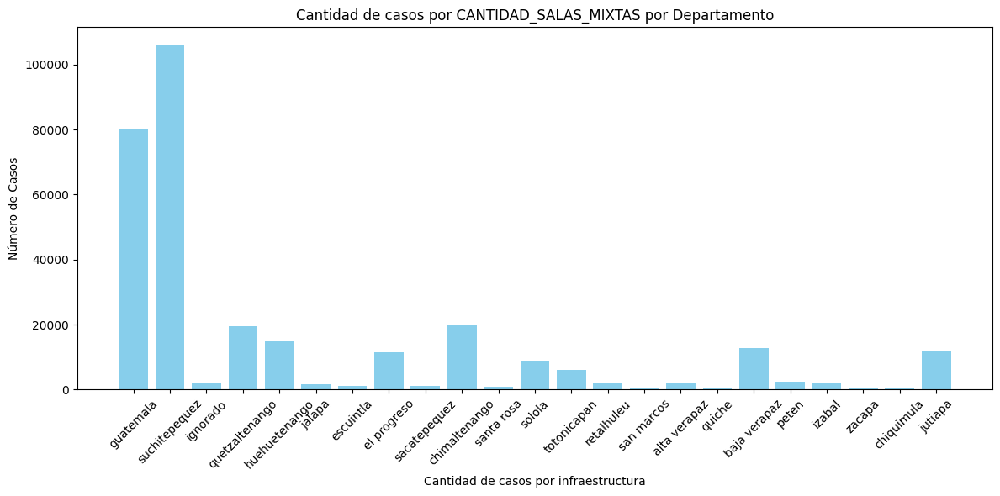

...

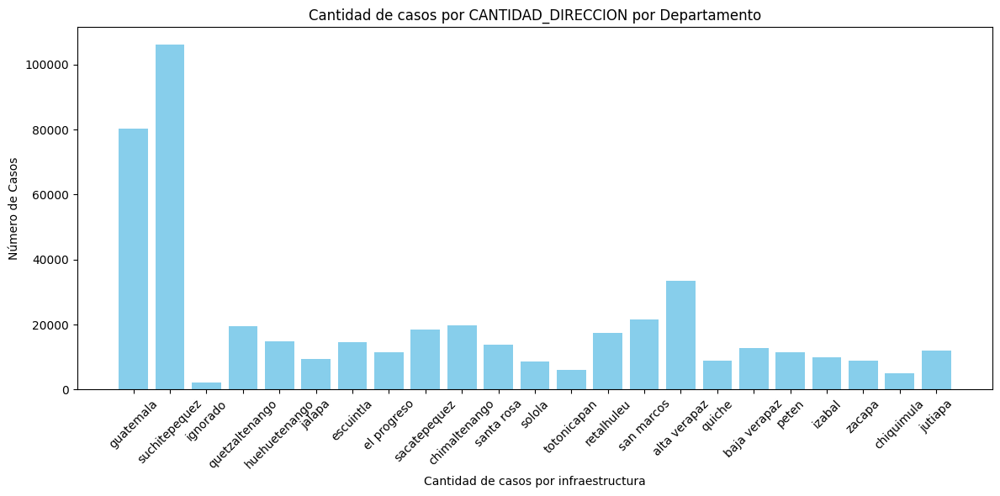

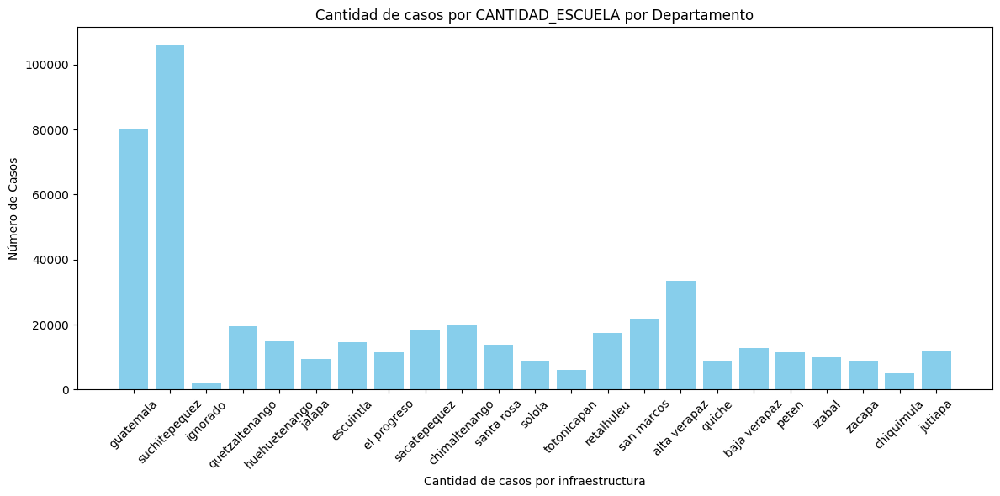

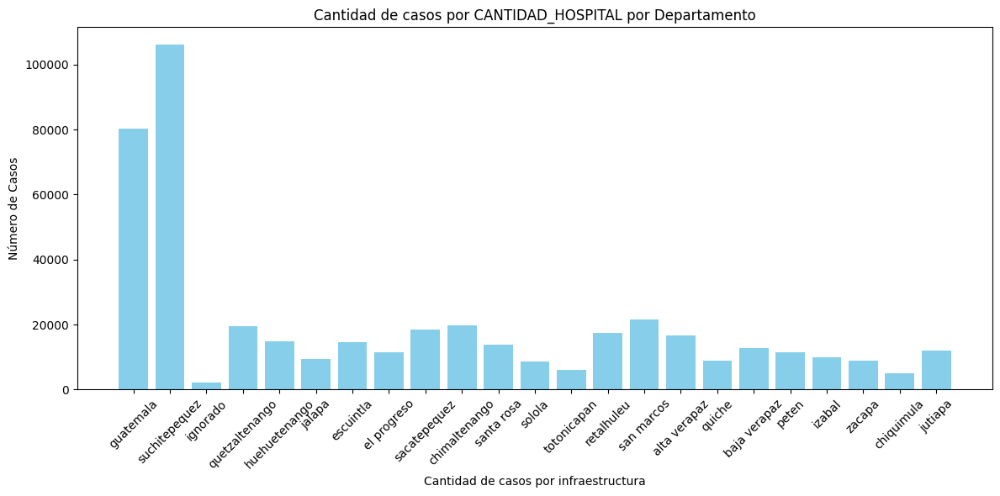

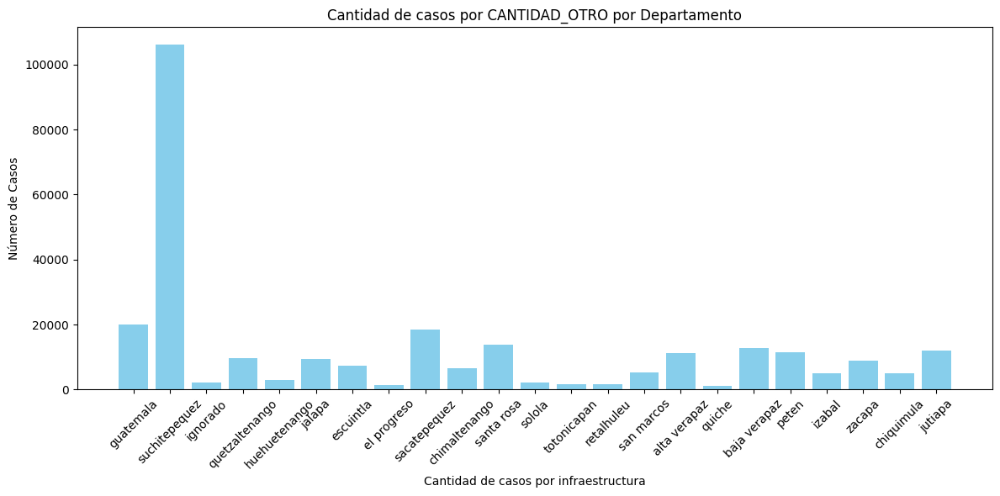

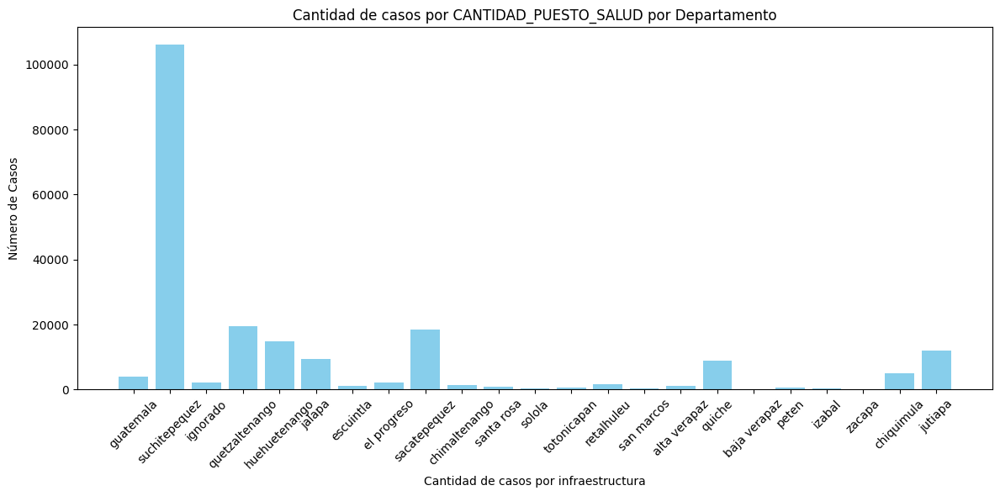

In [94]:
for col in df.columns[58:92]:
    temp_df = df[[col, 'HEC_DEPTO']].drop_duplicates().merge(
        df['HEC_DEPTO'].value_counts().reset_index(),
        on='HEC_DEPTO'
    )
    temp_df['Cantidad_Casos_Por'+col] = temp_df.apply(lambda row: row['count']/row[col] if row[col]!= 0 else row['count'], axis=1)
    plt.figure(figsize=(12, 6))
    plt.bar(temp_df['HEC_DEPTO'], temp_df['Cantidad_Casos_Por'+col], color='skyblue')
    plt.title(f'Cantidad de casos por {col} por Departamento')
    plt.xlabel('Cantidad de casos por infraestructura')
    plt.ylabel('Número de Casos')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [95]:
category_types = df.select_dtypes(exclude=["number", "float64", "int64", np.number]).columns
df[category_types] = df[category_types].astype(str)
encoders = {}
for col in category_types:
    le = LabelEncoder()
    df[f'{col}_ENC'] = le.fit_transform(df[col])
    encoders[col] = le
joblib.dump(encoders, './dataset/label_encoders.pkl')

['./dataset/label_encoders.pkl']

In [96]:
df.to_csv(f"./dataset/violenciaIntrafamiliarGuatemala2008_2023_v4.csv", index=False)